In [1]:
import pandas as pd

In [2]:
import seaborn as sns

In [3]:
import matplotlib.pyplot as plt

In [4]:
from sklearn.preprocessing import LabelEncoder

In [5]:
from sklearn.ensemble import RandomForestClassifier

In [6]:
from sklearn.linear_model import LogisticRegression

In [7]:
from sklearn.model_selection import train_test_split,GridSearchCV

In [8]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [9]:
df=pd.read_csv("Student Attitude and Behavior.csv")


In [10]:
df

,Certification Course,Gender,Department,Height(CM),Weight(KG),10th Mark,12th Mark,college mark,hobbies,daily studing time,prefer to study in,salary expectation,Do you like your degree?,willingness to pursue a career based on their degree,social medai & video,Travelling Time,Stress Level,Financial Status,part-time job
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,0 - 30 minute,Morning,40000,No,50%,1.30 - 2 hour,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,30 - 60 minute,Morning,15000,Yes,75%,1 - 1.30 hour,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,1 - 2 Hour,Anytime,13000,Yes,50%,More than 2 hour,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,1 - 2 Hour,Anytime,1500000,No,50%,1.30 - 2 hour,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,30 - 60 minute,Morning,50000,Yes,25%,1.30 - 2 hour,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,30 - 60 minute,Morning,7000,Yes,50%,More than 2 hour,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,2 - 3 hour,Anytime,25000,Yes,75%,30 - 60 Minute,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,30 - 60 minute,Night,20000,Yes,50%,30 - 60 Minute,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,0 - 30 minute,Anytime,20000,Yes,75%,More than 2 hour,2.30 - 3 hour,Awful,good,No


In [11]:
df.rename(columns={"Certification Course":"certification","Gender":"gender",
                   "Department":"dep","Height(CM)":"height","Weight(KG)":"weight",
                   "10th Mark":"mark10th","12th Mark":"mark12th","college mark":"collegemark",
                   "daily studing time":"studytime","prefer to study in":"prefertime","salary expectation":"salexpect",
                   "Do you like your degree?":"likedegree","willingness to pursue a career based on their degree  ":"carrer_willing",
                   "social medai & video":"smtime","Travelling Time ":"travel","Stress Level ":"stress","Financial Status":"financial",
                   "part-time job":"parttime"
                  },inplace=True)

In [12]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,0 - 30 minute,Morning,40000,No,50%,1.30 - 2 hour,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,30 - 60 minute,Morning,15000,Yes,75%,1 - 1.30 hour,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,1 - 2 Hour,Anytime,13000,Yes,50%,More than 2 hour,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,1 - 2 Hour,Anytime,1500000,No,50%,1.30 - 2 hour,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,30 - 60 minute,Morning,50000,Yes,25%,1.30 - 2 hour,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,30 - 60 minute,Morning,7000,Yes,50%,More than 2 hour,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,2 - 3 hour,Anytime,25000,Yes,75%,30 - 60 Minute,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,30 - 60 minute,Night,20000,Yes,50%,30 - 60 Minute,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,0 - 30 minute,Anytime,20000,Yes,75%,More than 2 hour,2.30 - 3 hour,Awful,good,No


In [13]:
df.isnull().sum()

certification     0
gender            0
dep               0
height            0
weight            0
mark10th          0
mark12th          0
collegemark       0
hobbies           0
studytime         0
prefertime        0
salexpect         0
likedegree        0
carrer_willing    0
smtime            0
travel            0
stress            0
financial         0
parttime          0
dtype: int64

In [14]:
df.describe()

,height,weight,mark10th,mark12th,collegemark,salexpect
count,235.000000,235.000000,235.000000,235.000000,235.000000,2.350000e+02
mean,157.402128,60.803830,76.848511,68.775872,70.660553,3.248168e+04
std,21.510805,14.895844,13.047560,11.018192,15.727446,1.113146e+05
min,4.500000,20.000000,7.400000,45.000000,1.000000,0.000000e+00
25%,152.000000,50.000000,70.000000,60.000000,60.000000,1.500000e+04
50%,160.000000,60.000000,80.000000,69.000000,70.000000,2.000000e+04
75%,170.000000,70.000000,86.250000,76.000000,80.000000,2.500000e+04
max,192.000000,106.000000,98.000000,94.000000,100.000000,1.500000e+06


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 235 entries, 0 to 234
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   certification   235 non-null    object 
 1   gender          235 non-null    object 
 2   dep             235 non-null    object 
 3   height          235 non-null    float64
 4   weight          235 non-null    float64
 5   mark10th        235 non-null    float64
 6   mark12th        235 non-null    float64
 7   collegemark     235 non-null    float64
 8   hobbies         235 non-null    object 
 9   studytime       235 non-null    object 
 10  prefertime      235 non-null    object 
 11  salexpect       235 non-null    int64  
 12  likedegree      235 non-null    object 
 13  carrer_willing  235 non-null    object 
 14  smtime          235 non-null    object 
 15  travel          235 non-null    object 
 16  stress          235 non-null    object 
 17  financial       235 non-null    obj

In [16]:
df.columns

Index(['certification', 'gender', 'dep', 'height', 'weight', 'mark10th',
       'mark12th', 'collegemark', 'hobbies', 'studytime', 'prefertime',
       'salexpect', 'likedegree', 'carrer_willing', 'smtime', 'travel',
       'stress', 'financial', 'parttime'],
      dtype='object')

In [17]:
df.shape

(235, 19)

In [18]:
df.columns

Index(['certification', 'gender', 'dep', 'height', 'weight', 'mark10th',
       'mark12th', 'collegemark', 'hobbies', 'studytime', 'prefertime',
       'salexpect', 'likedegree', 'carrer_willing', 'smtime', 'travel',
       'stress', 'financial', 'parttime'],
      dtype='object')

In [19]:
df["studytime"].unique()


array(['0 - 30 minute', '30 - 60 minute', '1 - 2 Hour', '2 - 3 hour',
       '3 - 4 hour', 'More Than 4 hour'], dtype=object)

In [20]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,0 - 30 minute,Morning,40000,No,50%,1.30 - 2 hour,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,30 - 60 minute,Morning,15000,Yes,75%,1 - 1.30 hour,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,1 - 2 Hour,Anytime,13000,Yes,50%,More than 2 hour,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,1 - 2 Hour,Anytime,1500000,No,50%,1.30 - 2 hour,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,30 - 60 minute,Morning,50000,Yes,25%,1.30 - 2 hour,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,30 - 60 minute,Morning,7000,Yes,50%,More than 2 hour,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,2 - 3 hour,Anytime,25000,Yes,75%,30 - 60 Minute,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,30 - 60 minute,Night,20000,Yes,50%,30 - 60 Minute,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,0 - 30 minute,Anytime,20000,Yes,75%,More than 2 hour,2.30 - 3 hour,Awful,good,No


In [21]:
def studyTime(x):
    x=x.split()
    time =[]
    for i in x:
        if i.isnumeric():
            time.append(int(i))
    print(time)
    if len(time) == 1:
        return time[0]*60
    elif len(time) == 2 and (("Hour" in x) or ("hour" in x)):
        return ((time[0]*60 + time[1]*60)/2)
    elif len(time) == 2:
        return (sum(time)/len(time))

In [22]:
df["studytime"]=df["studytime"].apply(studyTime)


[0, 30]
[30, 60]
[1, 2]
[1, 2]
[30, 60]
[30, 60]
[1, 2]
[1, 2]
[0, 30]
[0, 30]
[1, 2]
[2, 3]
[30, 60]
[0, 30]
[30, 60]
[30, 60]
[1, 2]
[0, 30]
[0, 30]
[30, 60]
[30, 60]
[1, 2]
[1, 2]
[1, 2]
[0, 30]
[30, 60]
[1, 2]
[0, 30]
[30, 60]
[30, 60]
[0, 30]
[30, 60]
[0, 30]
[1, 2]
[30, 60]
[0, 30]
[2, 3]
[0, 30]
[30, 60]
[30, 60]
[30, 60]
[1, 2]
[0, 30]
[3, 4]
[0, 30]
[1, 2]
[30, 60]
[0, 30]
[1, 2]
[1, 2]
[1, 2]
[1, 2]
[4]
[1, 2]
[1, 2]
[30, 60]
[2, 3]
[1, 2]
[1, 2]
[3, 4]
[30, 60]
[30, 60]
[4]
[30, 60]
[0, 30]
[1, 2]
[2, 3]
[30, 60]
[1, 2]
[30, 60]
[30, 60]
[2, 3]
[0, 30]
[0, 30]
[3, 4]
[30, 60]
[1, 2]
[1, 2]
[30, 60]
[30, 60]
[1, 2]
[4]
[0, 30]
[30, 60]
[3, 4]
[30, 60]
[0, 30]
[1, 2]
[30, 60]
[0, 30]
[3, 4]
[2, 3]
[2, 3]
[1, 2]
[3, 4]
[30, 60]
[30, 60]
[2, 3]
[0, 30]
[0, 30]
[0, 30]
[2, 3]
[1, 2]
[30, 60]
[1, 2]
[30, 60]
[2, 3]
[0, 30]
[1, 2]
[0, 30]
[30, 60]
[30, 60]
[30, 60]
[0, 30]
[1, 2]
[30, 60]
[0, 30]
[30, 60]
[1, 2]
[0, 30]
[2, 3]
[30, 60]
[30, 60]
[30, 60]
[0, 30]
[30, 60]
[0, 30]
[3,

In [23]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50%,1.30 - 2 hour,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75%,1 - 1.30 hour,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50%,More than 2 hour,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50%,1.30 - 2 hour,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25%,1.30 - 2 hour,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50%,More than 2 hour,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75%,30 - 60 Minute,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50%,30 - 60 Minute,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75%,More than 2 hour,2.30 - 3 hour,Awful,good,No


In [24]:
df["carrer_willing"] = df["carrer_willing"].str.replace("%","")


In [25]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50,1.30 - 2 hour,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75,1 - 1.30 hour,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50,More than 2 hour,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50,1.30 - 2 hour,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25,1.30 - 2 hour,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50,More than 2 hour,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75,30 - 60 Minute,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50,30 - 60 Minute,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75,More than 2 hour,2.30 - 3 hour,Awful,good,No


In [26]:
df["carrer_willing"] = df["carrer_willing"].astype("float")


In [27]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,1.30 - 2 hour,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,1 - 1.30 hour,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,More than 2 hour,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,1.30 - 2 hour,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,1.30 - 2 hour,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,More than 2 hour,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,30 - 60 Minute,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,30 - 60 Minute,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,More than 2 hour,2.30 - 3 hour,Awful,good,No


In [28]:
# smtime
df["smtime"].unique()

array(['1.30 - 2 hour', '1 - 1.30 hour', 'More than 2 hour',
       '30 - 60 Minute', '1 - 30 Minute', '0 Minute'], dtype=object)

In [29]:
def socialTime(x):
    x=x.split()
    time =[]
    for i in x:
        try:
            time.append(float(i))
        except ValueError:
            pass
    if len(time) == 1:
        return time[0]*60
    elif len(time) == 2 and (("Hour" in x) or ("hour" in x)):
        return (((time[0]*60) + (time[1]*60))/2)
    elif len(time) == 2:
        return (sum(time)/len(time))


In [30]:
df["smtime"] = df["smtime"].apply(socialTime)


In [31]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,30 - 60 minutes,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,0 - 30 minutes,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,30 - 60 minutes,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,0 - 30 minutes,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,30 - 60 minutes,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,30 - 60 minutes,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,30 - 60 minutes,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,2.30 - 3 hour,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,2.30 - 3 hour,Awful,good,No


In [32]:
# travel
df["travel"].unique()

array(['30 - 60 minutes', '0 - 30 minutes', '1 - 1.30 hour',
       '2 - 2.30 hour', '1.30 - 2 hour', 'more than 3 hour',
       '2.30 - 3 hour'], dtype=object)

In [33]:
df["travel"] = df["travel"].apply(socialTime)


In [34]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='certification', ylabel='count'>

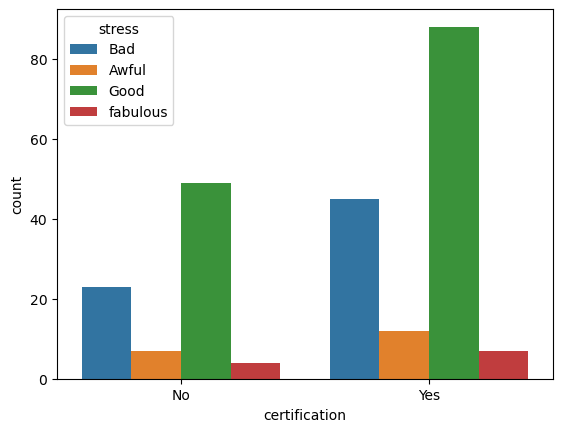

In [35]:
sns.countplot(x=df['certification'],data=df,hue=df['stress'])

In [36]:
label_df=df.groupby(["stress","certification"]).size().index



In [37]:
val_df=df.groupby(["stress","certification"]).size().values


In [38]:
val_df

array([ 7, 12, 23, 45, 49, 88,  4,  7], dtype=int64)

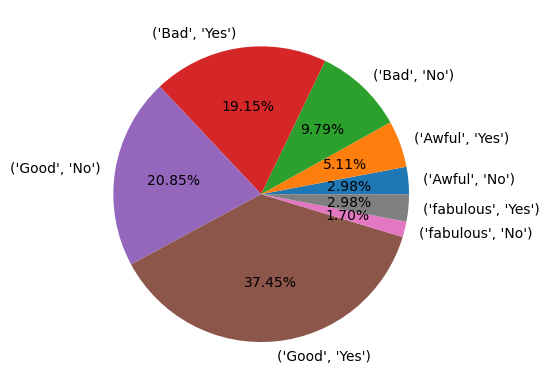

In [39]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='gender', ylabel='count'>

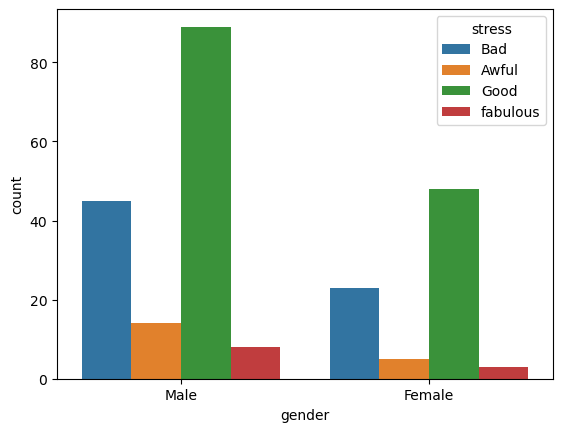

In [40]:
sns.countplot(x=df['gender'],data=df,hue=df['stress'])

In [41]:
label_df=df.groupby(["stress","gender"]).size().index



In [42]:
label_df

MultiIndex([(   'Awful', 'Female'),
            (   'Awful',   'Male'),
            (     'Bad', 'Female'),
            (     'Bad',   'Male'),
            (    'Good', 'Female'),
            (    'Good',   'Male'),
            ('fabulous', 'Female'),
            ('fabulous',   'Male')],
           names=['stress', 'gender'])

In [43]:
val_df=df.groupby(["stress","gender"]).size().values


In [44]:
val_df

array([ 5, 14, 23, 45, 48, 89,  3,  8], dtype=int64)

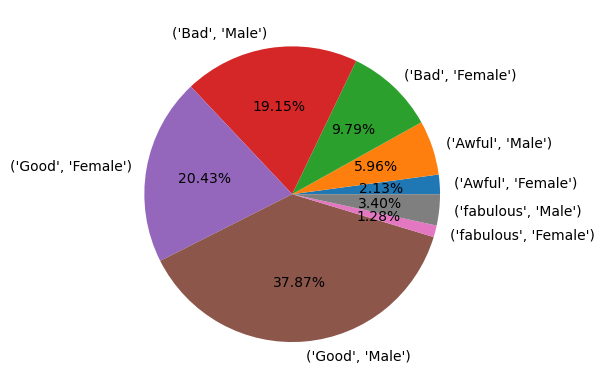

In [45]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

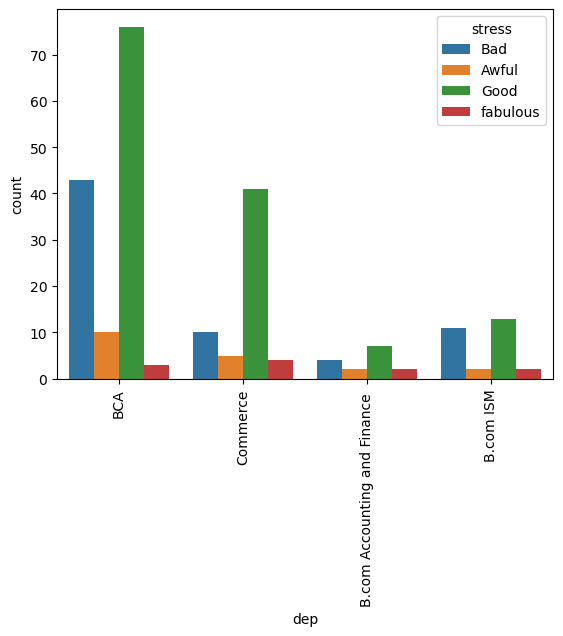

In [46]:
plt.xticks(rotation=90)
sns.countplot(x=df['dep'],data=df,hue=df['stress'])
plt.show()

In [47]:
label_df=df.groupby(["stress","dep"]).size().index



In [48]:
label_df

MultiIndex([(   'Awful', 'B.com Accounting and Finance '),
            (   'Awful',                     'B.com ISM'),
            (   'Awful',                           'BCA'),
            (   'Awful',                      'Commerce'),
            (     'Bad', 'B.com Accounting and Finance '),
            (     'Bad',                     'B.com ISM'),
            (     'Bad',                           'BCA'),
            (     'Bad',                      'Commerce'),
            (    'Good', 'B.com Accounting and Finance '),
            (    'Good',                     'B.com ISM'),
            (    'Good',                           'BCA'),
            (    'Good',                      'Commerce'),
            ('fabulous', 'B.com Accounting and Finance '),
            ('fabulous',                     'B.com ISM'),
            ('fabulous',                           'BCA'),
            ('fabulous',                      'Commerce')],
           names=['stress', 'dep'])

In [49]:
val_df=df.groupby(["stress","dep"]).size().values


In [50]:
val_df

array([ 2,  2, 10,  5,  4, 11, 43, 10,  7, 13, 76, 41,  2,  2,  3,  4],
      dtype=int64)

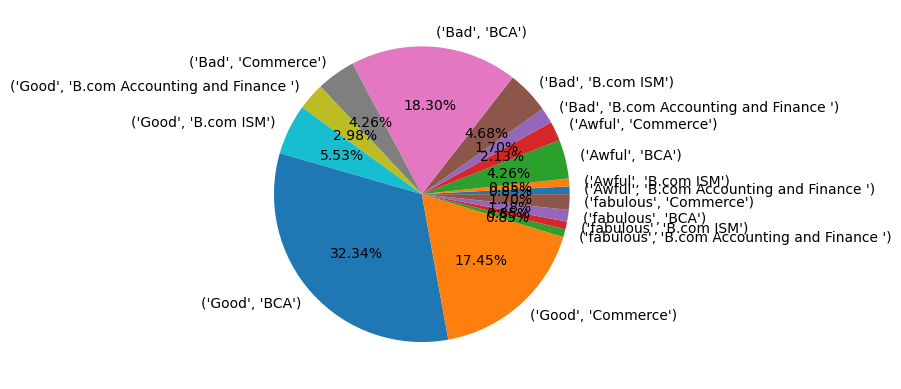

In [51]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

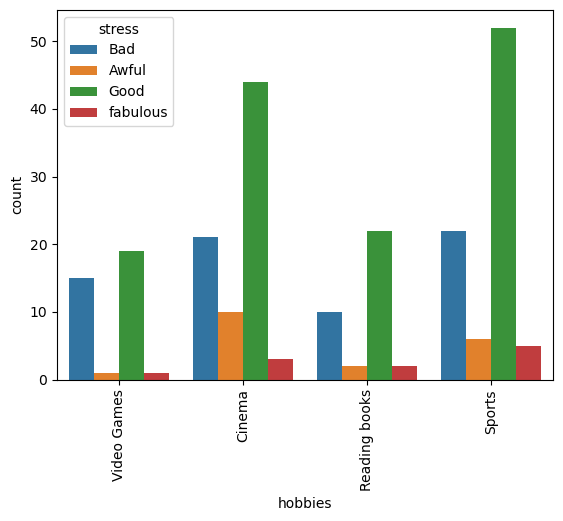

In [52]:

plt.xticks(rotation=90)
sns.countplot(x=df['hobbies'],data=df,hue=df['stress'])
plt.show()

In [53]:
label_df=df.groupby(["stress","hobbies"]).size().index



In [54]:
label_df

MultiIndex([(   'Awful',        'Cinema'),
            (   'Awful', 'Reading books'),
            (   'Awful',        'Sports'),
            (   'Awful',   'Video Games'),
            (     'Bad',        'Cinema'),
            (     'Bad', 'Reading books'),
            (     'Bad',        'Sports'),
            (     'Bad',   'Video Games'),
            (    'Good',        'Cinema'),
            (    'Good', 'Reading books'),
            (    'Good',        'Sports'),
            (    'Good',   'Video Games'),
            ('fabulous',        'Cinema'),
            ('fabulous', 'Reading books'),
            ('fabulous',        'Sports'),
            ('fabulous',   'Video Games')],
           names=['stress', 'hobbies'])

In [55]:
val_df=df.groupby(["stress","hobbies"]).size().values


In [56]:
val_df

array([10,  2,  6,  1, 21, 10, 22, 15, 44, 22, 52, 19,  3,  2,  5,  1],
      dtype=int64)

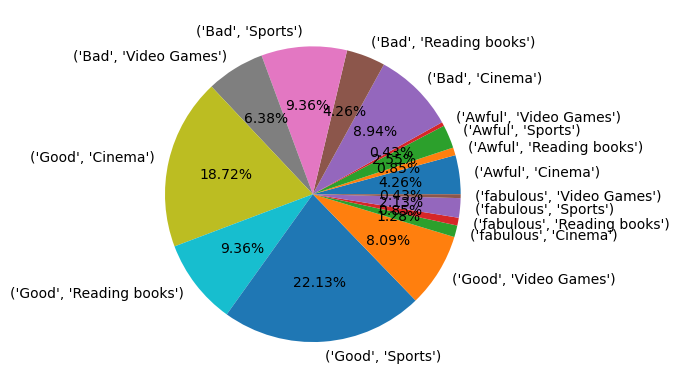

In [57]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

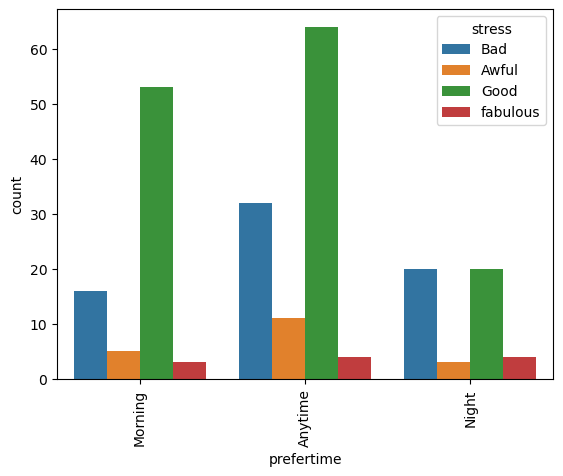

In [58]:
plt.xticks(rotation=90)
sns.countplot(x=df['prefertime'],data=df,hue=df['stress'])
plt.show()

In [59]:
label_df=df.groupby(["stress","prefertime"]).size().index



In [60]:
label_df

MultiIndex([(   'Awful', 'Anytime'),
            (   'Awful', 'Morning'),
            (   'Awful',   'Night'),
            (     'Bad', 'Anytime'),
            (     'Bad', 'Morning'),
            (     'Bad',   'Night'),
            (    'Good', 'Anytime'),
            (    'Good', 'Morning'),
            (    'Good',   'Night'),
            ('fabulous', 'Anytime'),
            ('fabulous', 'Morning'),
            ('fabulous',   'Night')],
           names=['stress', 'prefertime'])

In [61]:
val_df=df.groupby(["stress","prefertime"]).size().values


In [62]:
val_df

array([11,  5,  3, 32, 16, 20, 64, 53, 20,  4,  3,  4], dtype=int64)

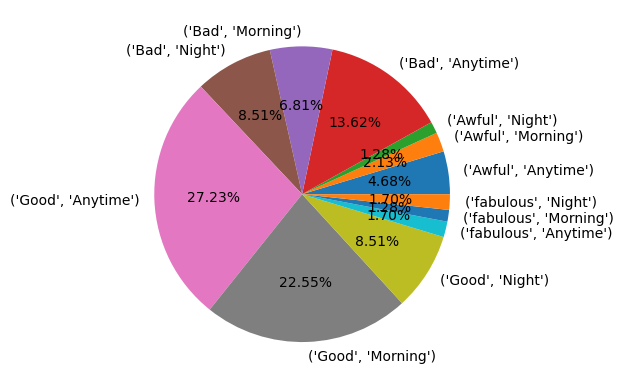

In [63]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

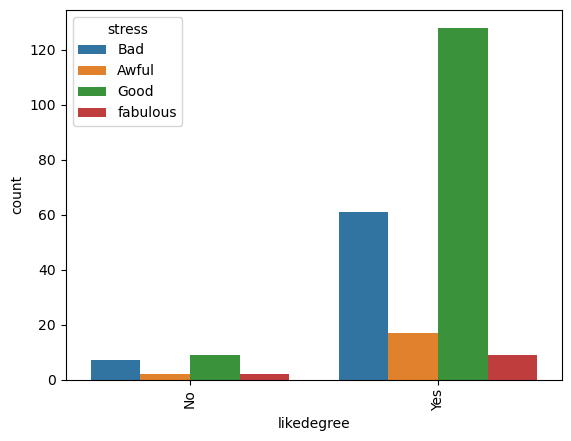

In [64]:

plt.xticks(rotation=90)
sns.countplot(x=df['likedegree'],data=df,hue=df['stress'])
plt.show()

In [65]:
label_df=df.groupby(["stress","likedegree"]).size().index



In [66]:
label_df

MultiIndex([(   'Awful',  'No'),
            (   'Awful', 'Yes'),
            (     'Bad',  'No'),
            (     'Bad', 'Yes'),
            (    'Good',  'No'),
            (    'Good', 'Yes'),
            ('fabulous',  'No'),
            ('fabulous', 'Yes')],
           names=['stress', 'likedegree'])

In [67]:
val_df=df.groupby(["stress","likedegree"]).size().values


In [68]:
val_df

array([  2,  17,   7,  61,   9, 128,   2,   9], dtype=int64)

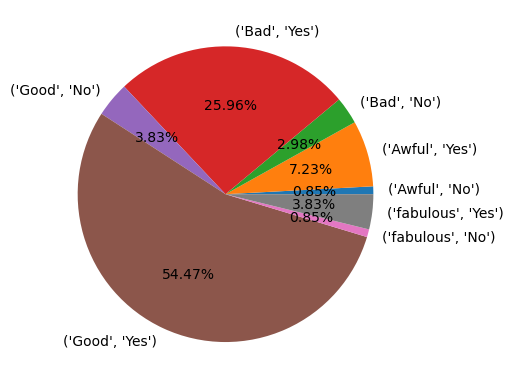

In [69]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

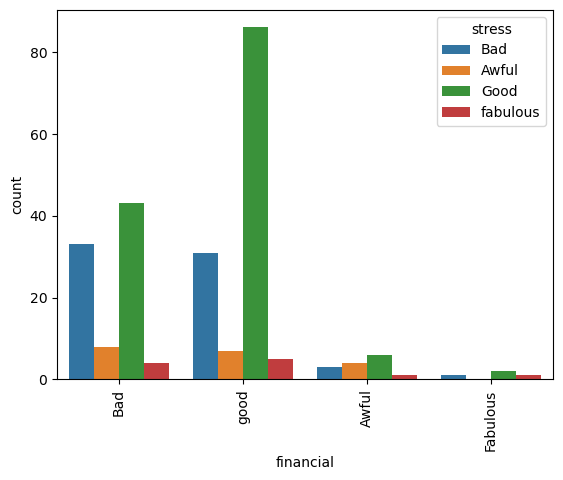

In [70]:
plt.xticks(rotation=90)
sns.countplot(x=df['financial'],data=df,hue=df['stress'])
plt.show()

In [71]:
label_df=df.groupby(["stress","financial"]).size().index



In [72]:
label_df

MultiIndex([(   'Awful',    'Awful'),
            (   'Awful',      'Bad'),
            (   'Awful',     'good'),
            (     'Bad',    'Awful'),
            (     'Bad',      'Bad'),
            (     'Bad', 'Fabulous'),
            (     'Bad',     'good'),
            (    'Good',    'Awful'),
            (    'Good',      'Bad'),
            (    'Good', 'Fabulous'),
            (    'Good',     'good'),
            ('fabulous',    'Awful'),
            ('fabulous',      'Bad'),
            ('fabulous', 'Fabulous'),
            ('fabulous',     'good')],
           names=['stress', 'financial'])

In [73]:
val_df=df.groupby(["stress","financial"]).size().values


In [74]:
val_df

array([ 4,  8,  7,  3, 33,  1, 31,  6, 43,  2, 86,  1,  4,  1,  5],
      dtype=int64)

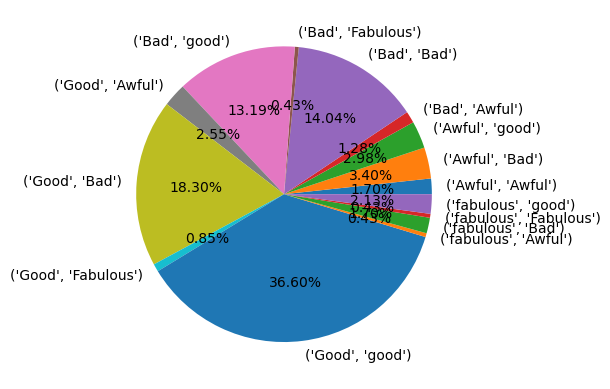

In [75]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

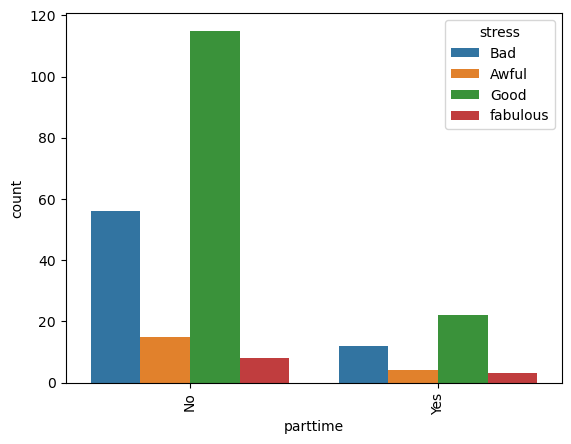

In [76]:
plt.xticks(rotation=90)
sns.countplot(x=df['parttime'],data=df,hue=df['stress'])
plt.show()

In [77]:
label_df=df.groupby(["stress","parttime"]).size().index



In [78]:
label_df

MultiIndex([(   'Awful',  'No'),
            (   'Awful', 'Yes'),
            (     'Bad',  'No'),
            (     'Bad', 'Yes'),
            (    'Good',  'No'),
            (    'Good', 'Yes'),
            ('fabulous',  'No'),
            ('fabulous', 'Yes')],
           names=['stress', 'parttime'])

In [79]:
val_df=df.groupby(["stress","parttime"]).size().values


In [80]:
val_df

array([ 15,   4,  56,  12, 115,  22,   8,   3], dtype=int64)

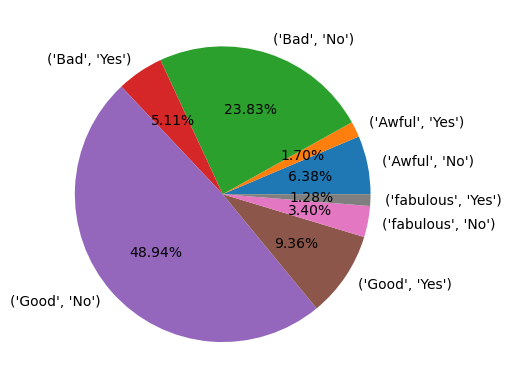

In [81]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

In [82]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

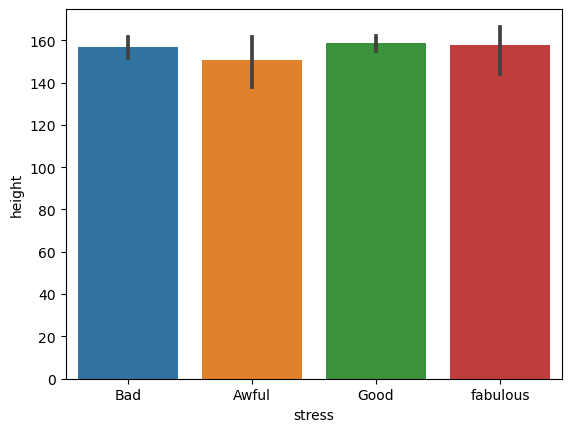

In [83]:
sns.barplot(x=df['stress'],y=df['height'],)

<Axes: xlabel='stress', ylabel='weight'>

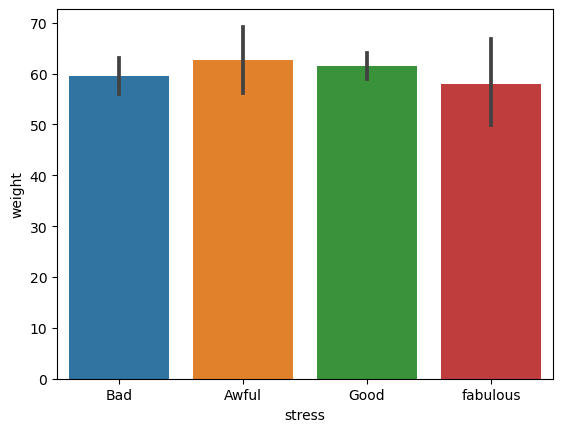

In [84]:
sns.barplot(x=df['stress'],y=df['weight'])

<Axes: xlabel='stress', ylabel='mark10th'>

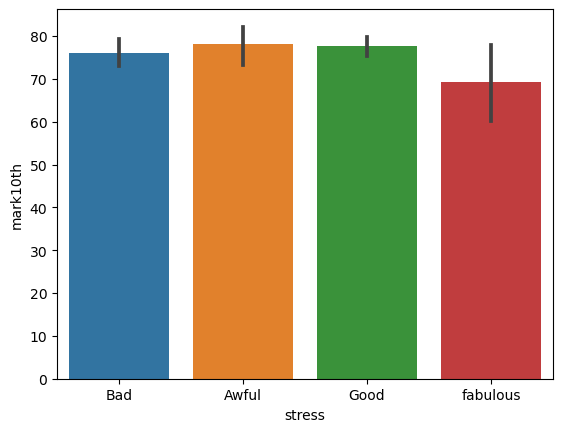

In [85]:

sns.barplot(x=df['stress'],y=df['mark10th'])

<Axes: xlabel='stress', ylabel='mark12th'>

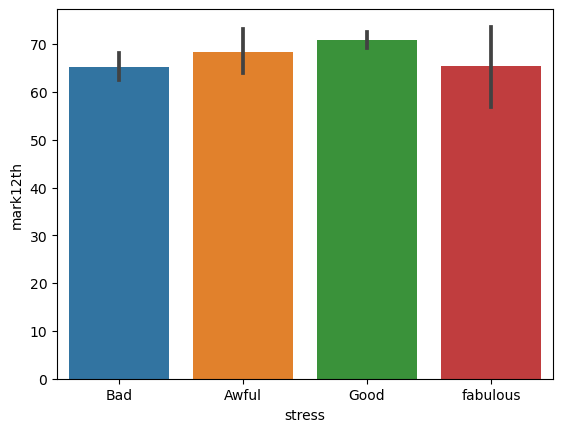

In [86]:
sns.barplot(x=df['stress'],y=df['mark12th'])

<Axes: xlabel='stress', ylabel='collegemark'>

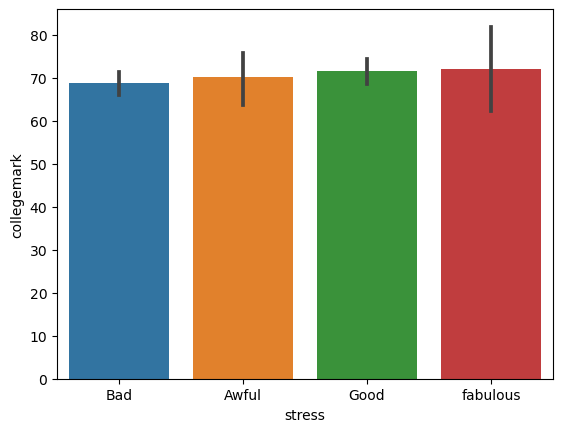

In [87]:
sns.barplot(x=df['stress'],y=df['collegemark'])

<Axes: xlabel='stress', ylabel='studytime'>

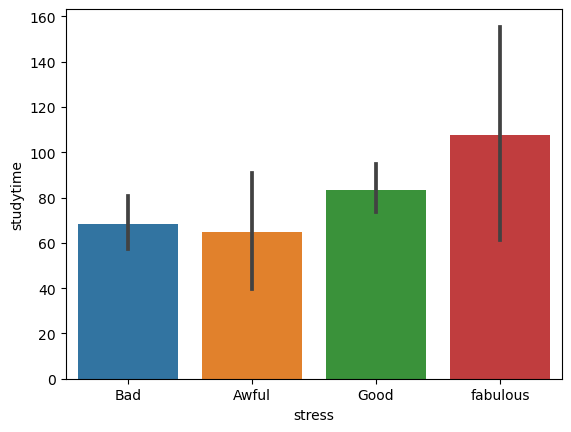

In [88]:
sns.barplot(x=df['stress'],y=df['studytime'])

<Axes: xlabel='stress', ylabel='salexpect'>

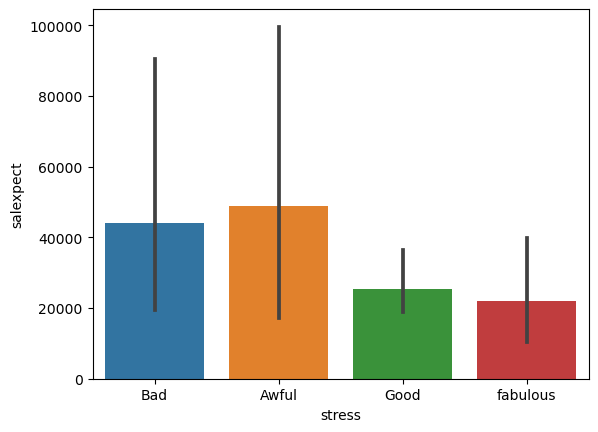

In [89]:
sns.barplot(x=df['stress'],y=df['salexpect'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

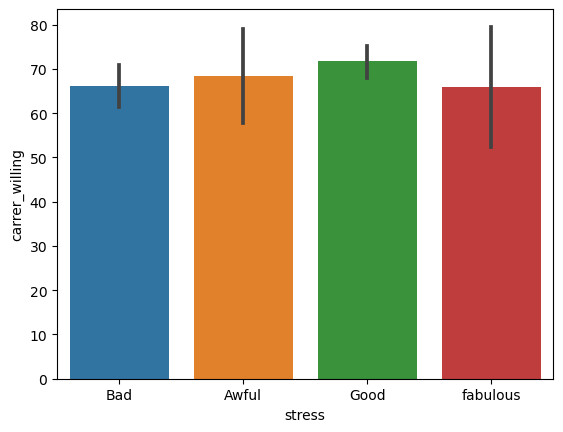

In [90]:

sns.barplot(x=df['stress'],y=df['carrer_willing'])

<Axes: xlabel='stress', ylabel='smtime'>

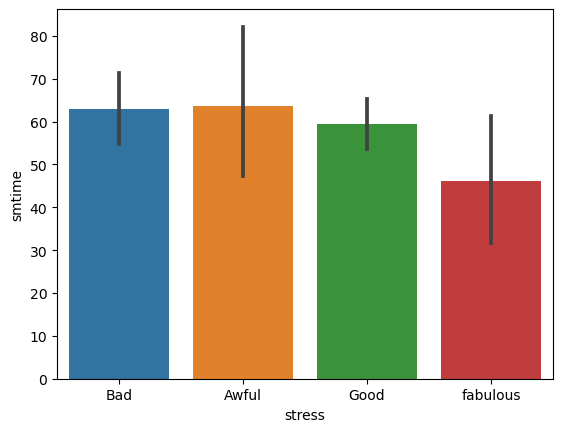

In [91]:


sns.barplot(x=df['stress'],y=df['smtime'])

<Axes: xlabel='stress', ylabel='travel'>

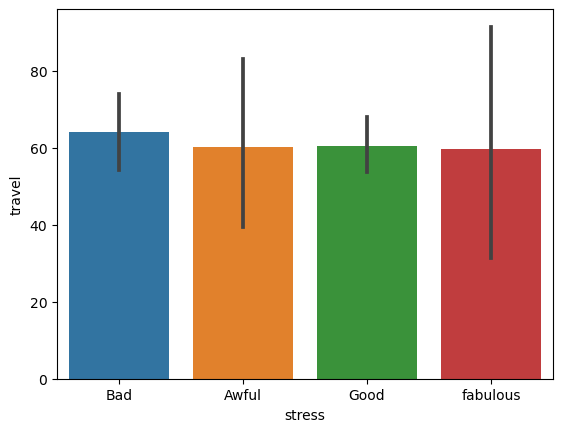

In [92]:
sns.barplot(x=df['stress'],y=df['travel'])

<Axes: xlabel='stress', ylabel='height'>

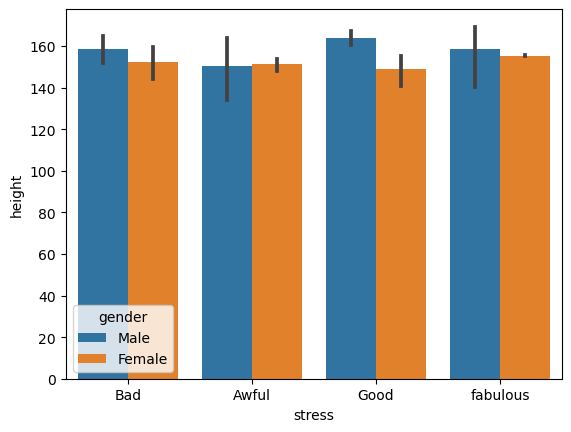

In [93]:
sns.barplot(x=df['stress'],y=df['height'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='height'>

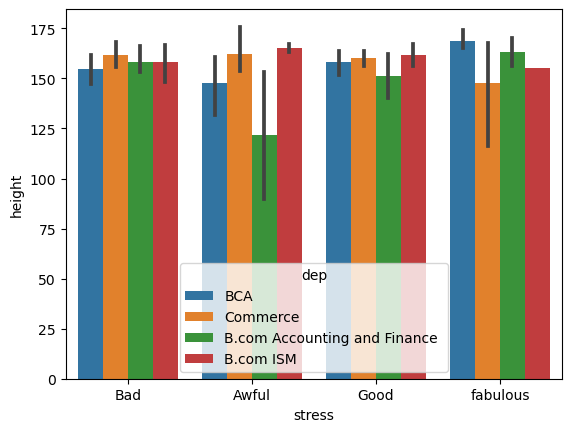

In [94]:
sns.barplot(x=df['stress'],y=df['height'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='height'>

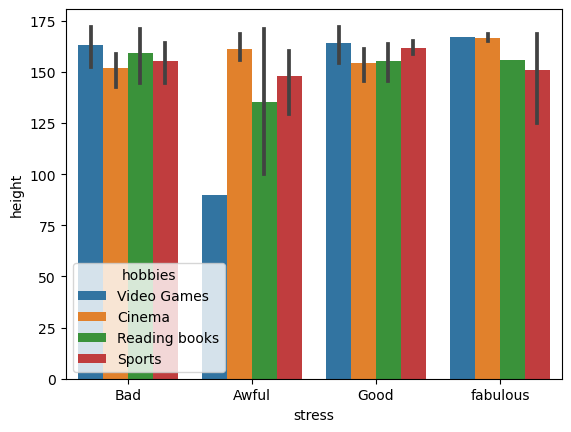

In [95]:

sns.barplot(x=df['stress'],y=df['height'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='height'>

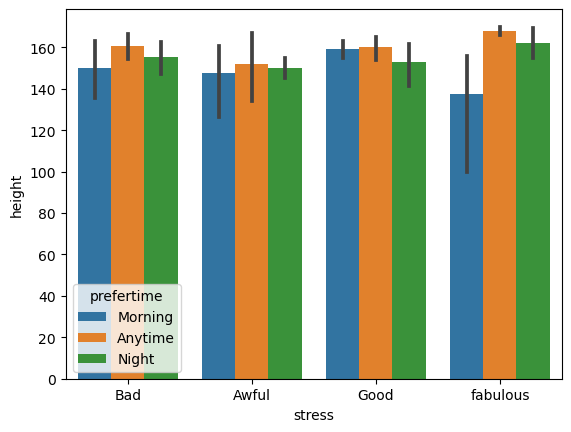

In [96]:


sns.barplot(x=df['stress'],y=df['height'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='height'>

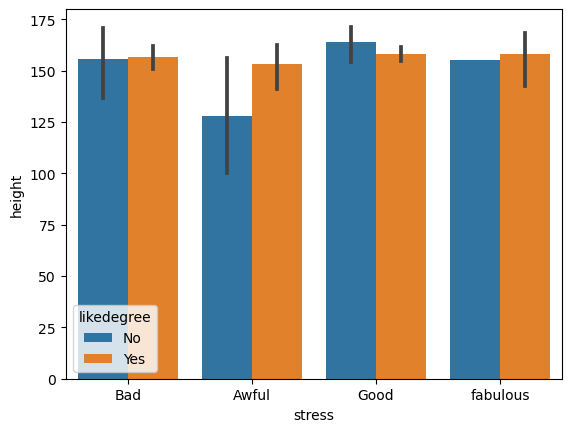

In [97]:
sns.barplot(x=df['stress'],y=df['height'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='height'>

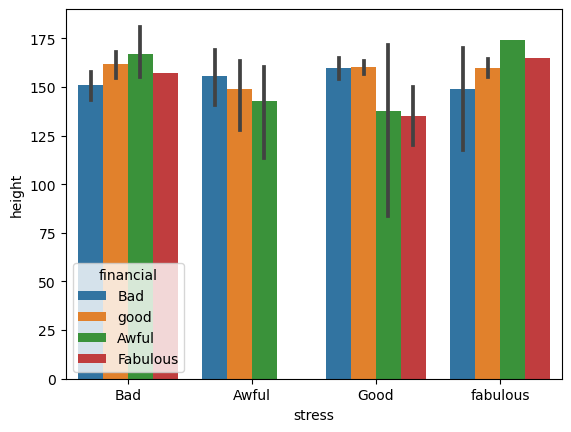

In [98]:

sns.barplot(x=df['stress'],y=df['height'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='height'>

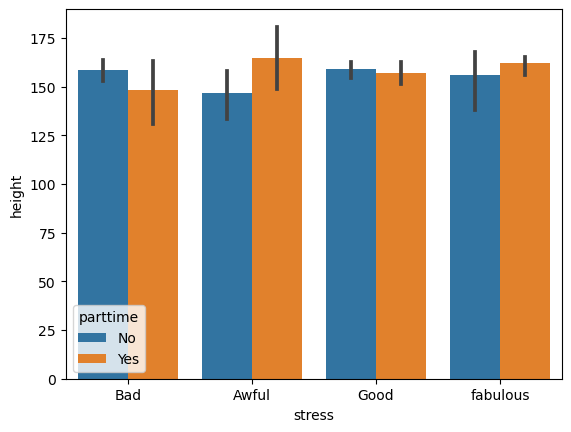

In [99]:
sns.barplot(x=df['stress'],y=df['height'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='weight'>

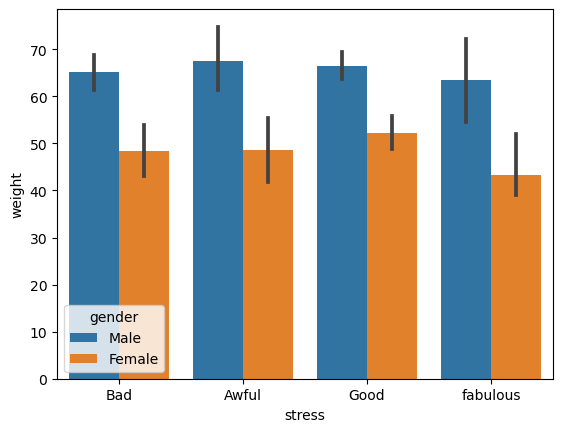

In [100]:
sns.barplot(x=df['stress'],y=df['weight'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='weight'>

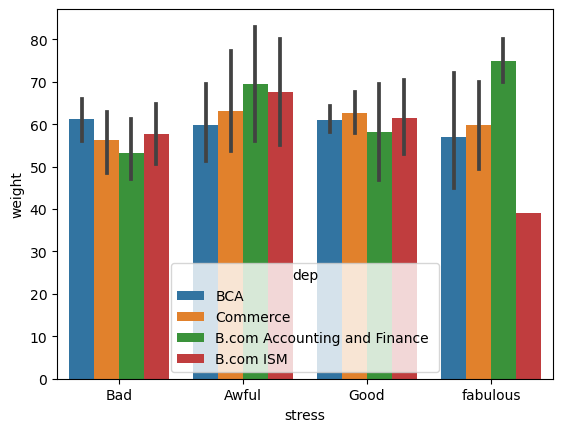

In [101]:
sns.barplot(x=df['stress'],y=df['weight'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='weight'>

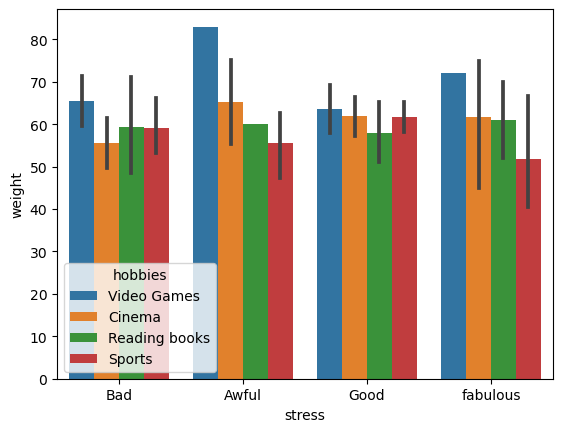

In [102]:

sns.barplot(x=df['stress'],y=df['weight'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='weight'>

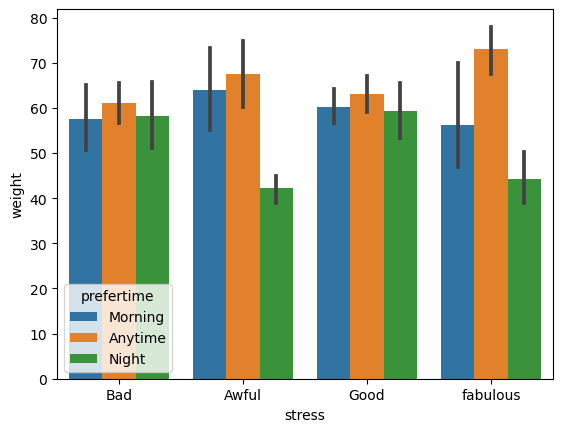

In [103]:


sns.barplot(x=df['stress'],y=df['weight'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='weight'>

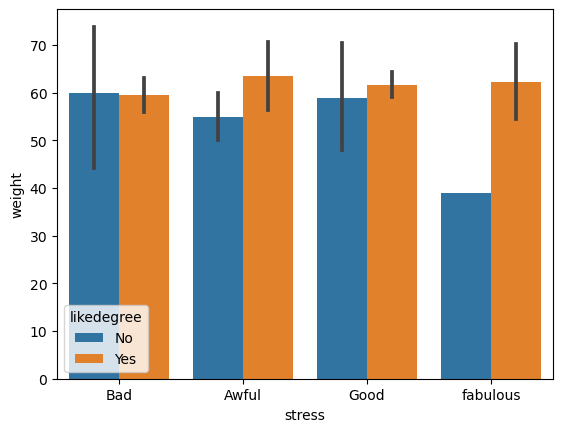

In [104]:
sns.barplot(x=df['stress'],y=df['weight'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='weight'>

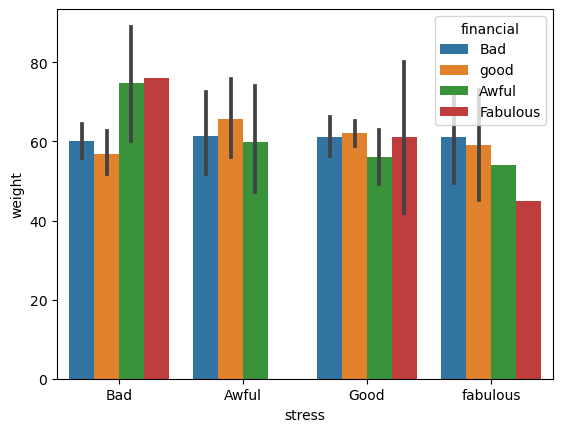

In [105]:

sns.barplot(x=df['stress'],y=df['weight'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='weight'>

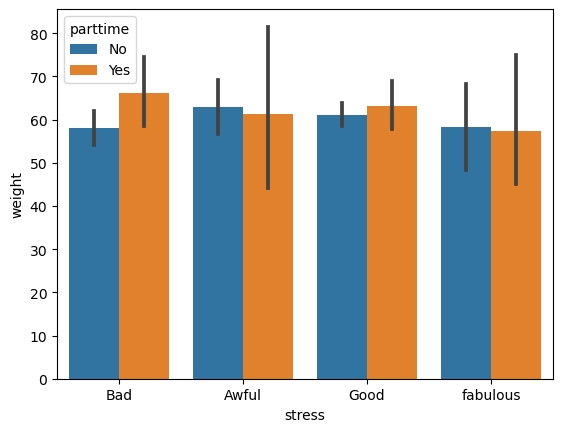

In [106]:
sns.barplot(x=df['stress'],y=df['weight'],hue=df['parttime'])

In [107]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='mark10th'>

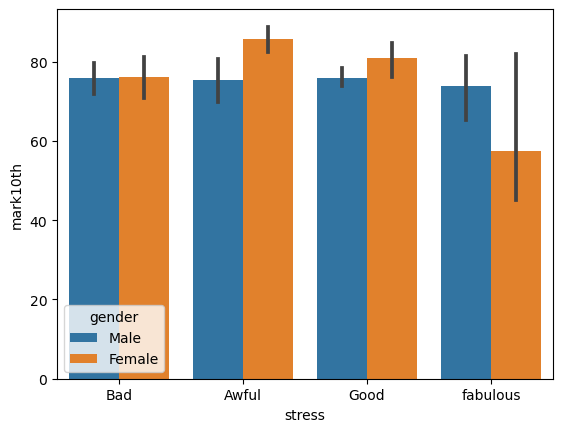

In [108]:
sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['gender'])

In [109]:
label_df=df.groupby(["stress","gender"])['mark10th'].mean().sort_values(ascending=False).index


In [110]:
val_df=df.groupby(["stress","gender"])['mark10th'].mean().sort_values(ascending=False).values


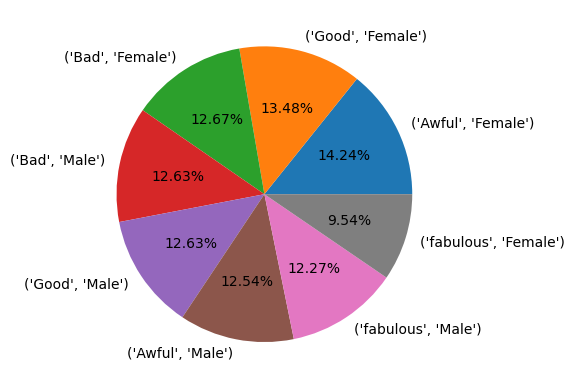

In [111]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark10th'>

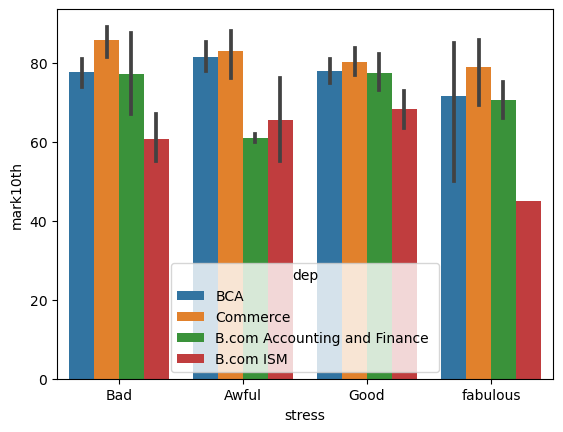

In [112]:
sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['dep'])

In [113]:
label_df=df.groupby(["stress","dep"])['mark10th'].mean().sort_values(ascending=False).index


In [114]:
val_df=df.groupby(["stress","dep"])['mark10th'].mean().sort_values(ascending=False).values


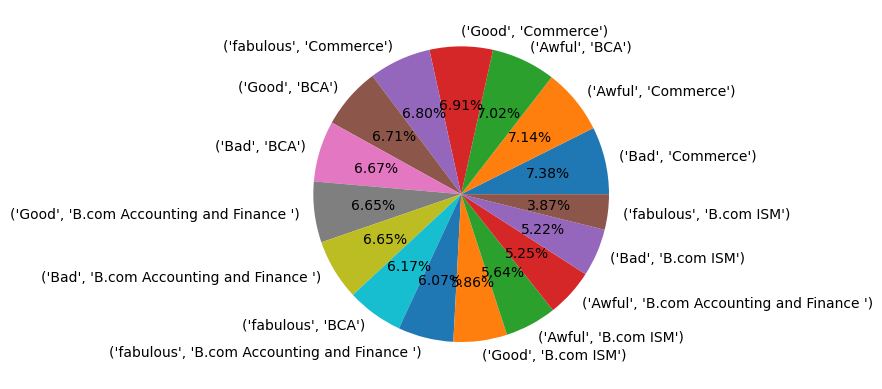

In [115]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark10th'>

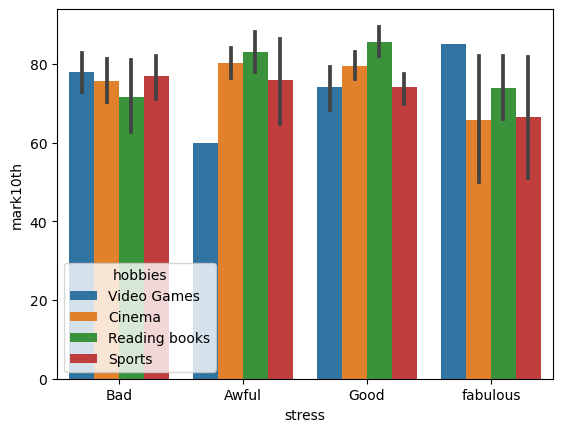

In [116]:

sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['hobbies'])

In [117]:
label_df=df.groupby(["stress","hobbies"])['mark10th'].mean().sort_values(ascending=False).index


In [118]:
val_df=df.groupby(["stress","hobbies"])['mark10th'].mean().sort_values(ascending=False).values


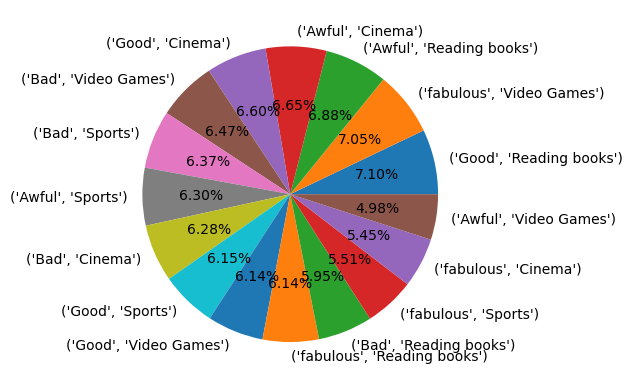

In [119]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark10th'>

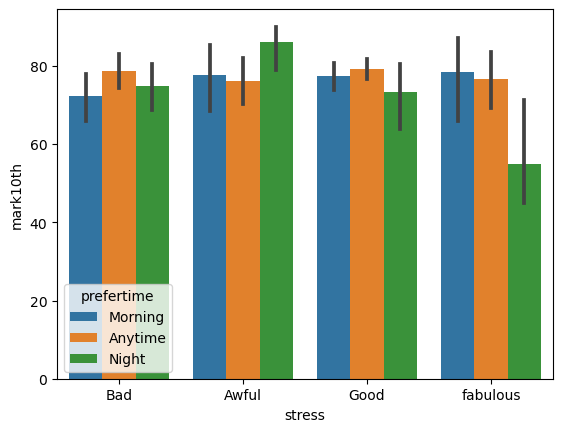

In [120]:
sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['prefertime'])

In [121]:
label_df=df.groupby(["stress","prefertime"])['mark10th'].mean().sort_values(ascending=False).index


In [122]:
val_df=df.groupby(["stress","prefertime"])['mark10th'].mean().sort_values(ascending=False).values


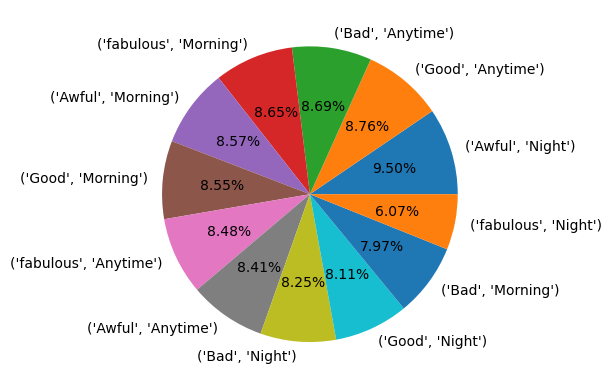

In [123]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark10th'>

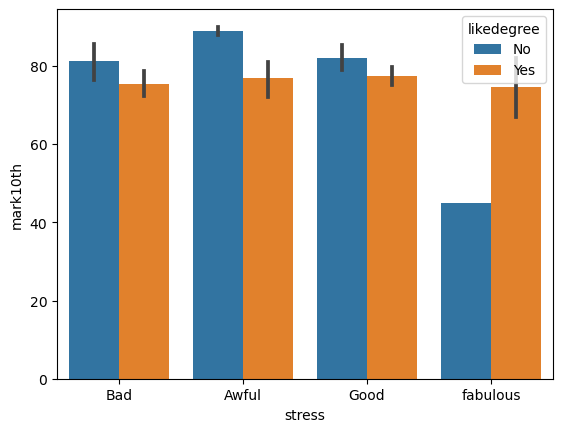

In [124]:
sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['likedegree'])

In [125]:
label_df=df.groupby(["stress","likedegree"])['mark10th'].mean().sort_values(ascending=False).index


In [126]:
val_df=df.groupby(["stress","likedegree"])['mark10th'].mean().sort_values(ascending=False).values


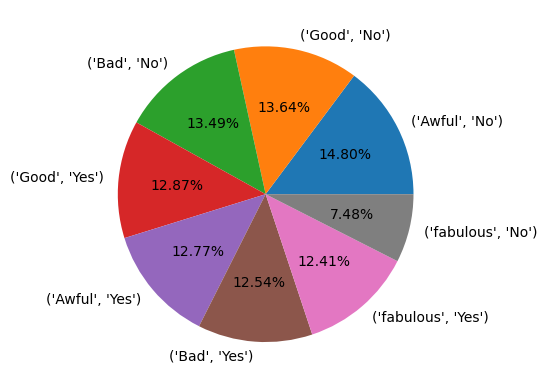

In [127]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark10th'>

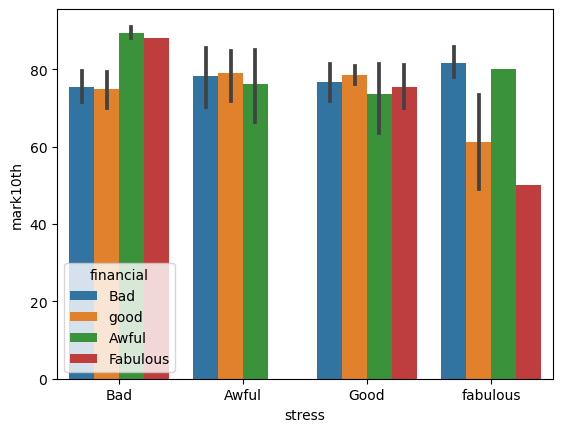

In [128]:

sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['financial'])

In [129]:
label_df=df.groupby(["stress","financial"])['mark10th'].mean().sort_values(ascending=False).index


In [130]:
val_df=df.groupby(["stress","financial"])['mark10th'].mean().sort_values(ascending=False).values


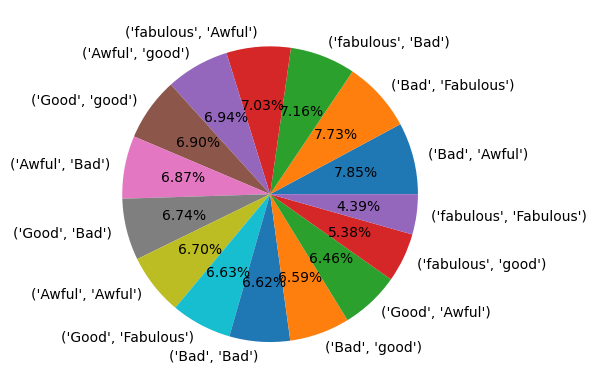

In [131]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark10th'>

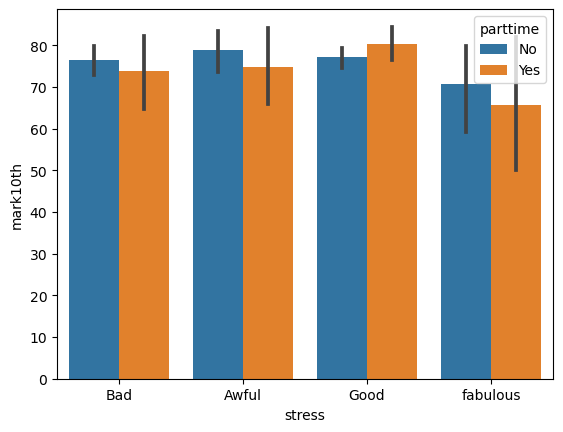

In [132]:
sns.barplot(x=df['stress'],y=df['mark10th'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='mark12th'>

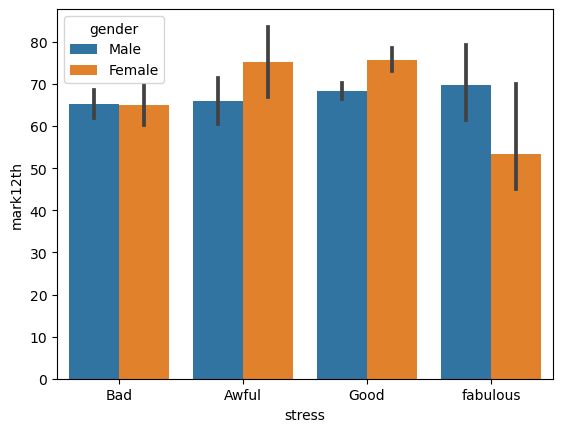

In [133]:
sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['gender'])

In [134]:
label_df=df.groupby(["stress","gender"])['mark12th'].mean().sort_values(ascending=False).index


In [135]:
val_df=df.groupby(["stress","gender"])['mark12th'].mean().sort_values(ascending=False).values


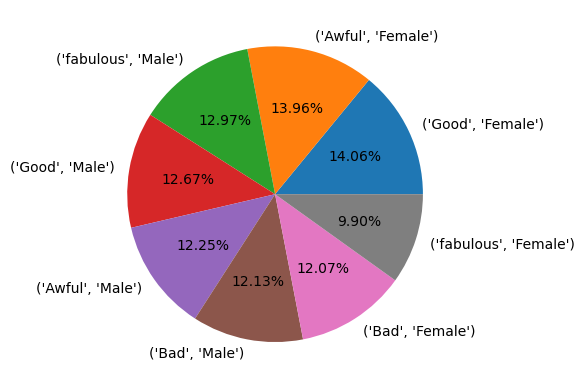

In [136]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark12th'>

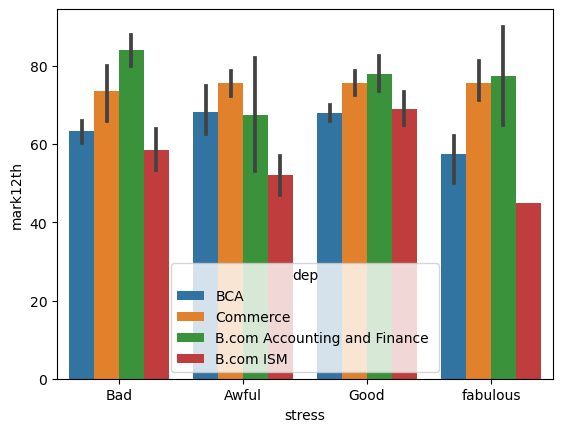

In [137]:
sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['dep'])

In [138]:
label_df=df.groupby(["stress","dep"])['mark12th'].mean().sort_values(ascending=False).index


In [139]:
val_df=df.groupby(["stress","dep"])['mark12th'].mean().sort_values(ascending=False).values


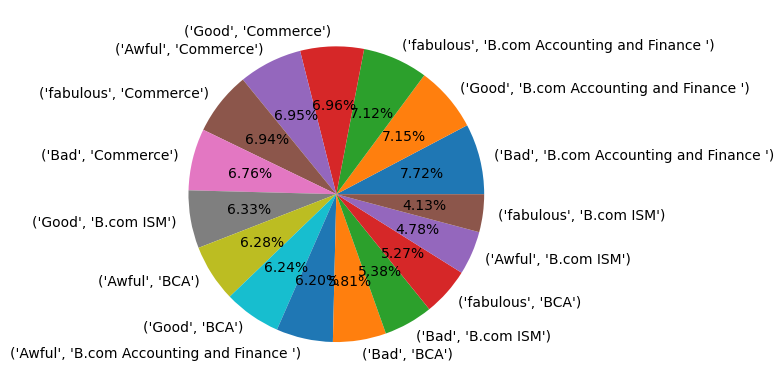

In [140]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark12th'>

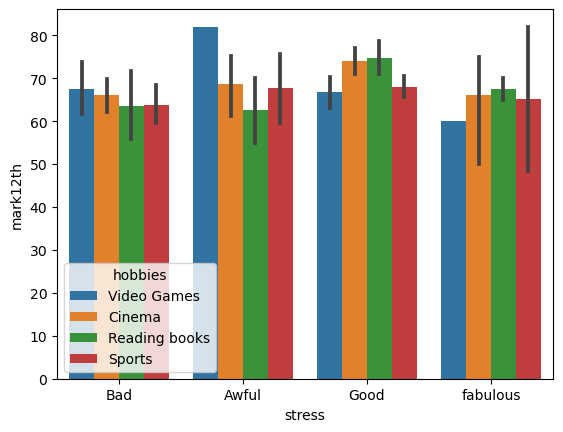

In [141]:
sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['hobbies'])

In [142]:
label_df=df.groupby(["stress","hobbies"])['mark12th'].mean().sort_values(ascending=False).index


In [143]:
val_df=df.groupby(["stress","hobbies"])['mark12th'].mean().sort_values(ascending=False).values


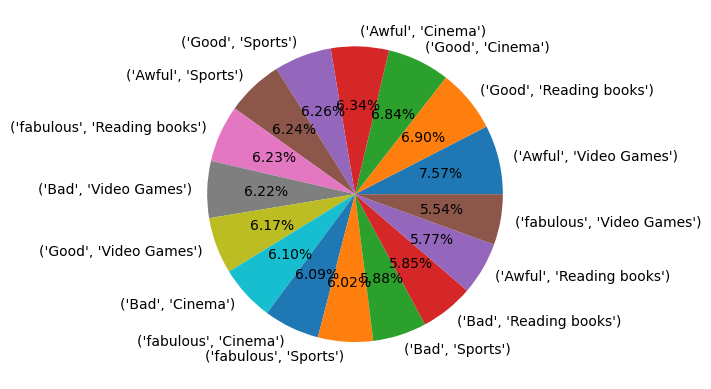

In [144]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark12th'>

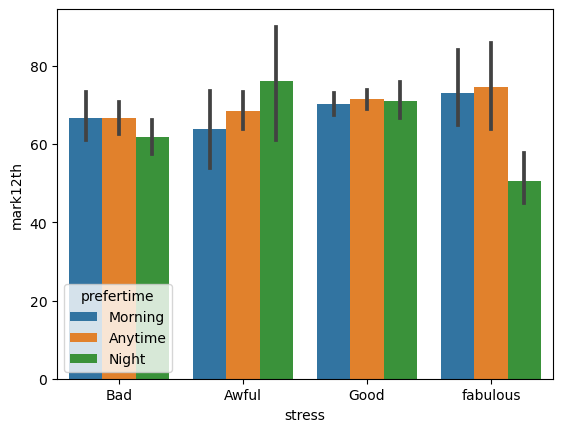

In [145]:
sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['prefertime'])

In [146]:
label_df=df.groupby(["stress","prefertime"])['mark12th'].mean().sort_values(ascending=False).index


In [147]:
val_df=df.groupby(["stress","prefertime"])['mark12th'].mean().sort_values(ascending=False).values


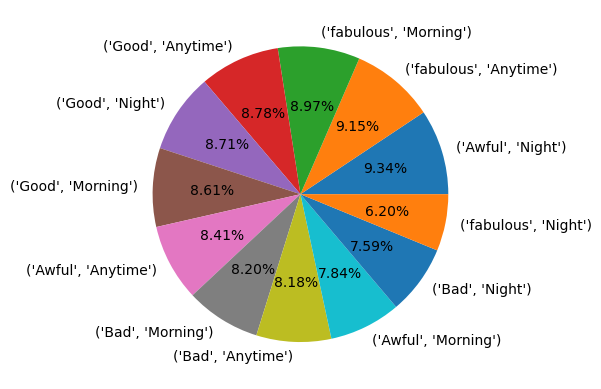

In [148]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark12th'>

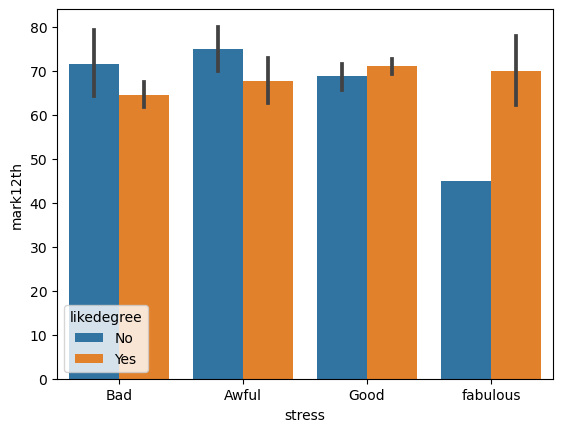

In [149]:
sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['likedegree'])

In [150]:
label_df=df.groupby(["stress","likedegree"])['mark12th'].mean().sort_values(ascending=False).index


In [151]:
val_df=df.groupby(["stress","likedegree"])['mark12th'].mean().sort_values(ascending=False).values


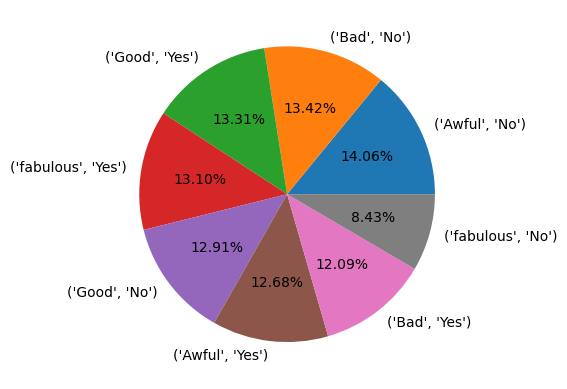

In [152]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark12th'>

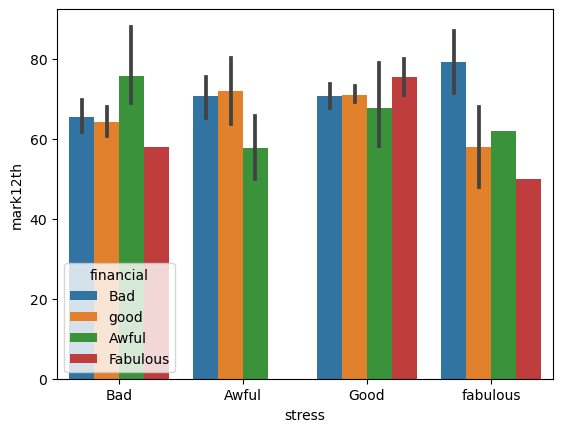

In [153]:

sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['financial'])

In [154]:
label_df=df.groupby(["stress","financial"])['mark12th'].mean().sort_values(ascending=False).index


In [155]:
val_df=df.groupby(["stress","financial"])['mark12th'].mean().sort_values(ascending=False).values


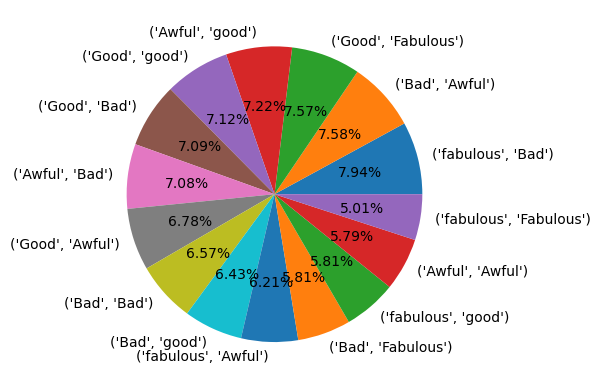

In [156]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

<Axes: xlabel='stress', ylabel='mark12th'>

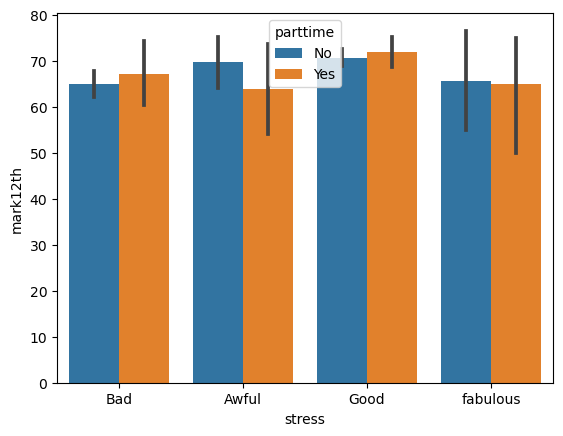

In [157]:
sns.barplot(x=df['stress'],y=df['mark12th'],hue=df['parttime'])

In [158]:
label_df=df.groupby(["stress","parttime"])['mark12th'].mean().sort_values(ascending=False).index


In [159]:
val_df=df.groupby(["stress","parttime"])['mark12th'].mean().sort_values(ascending=False).values


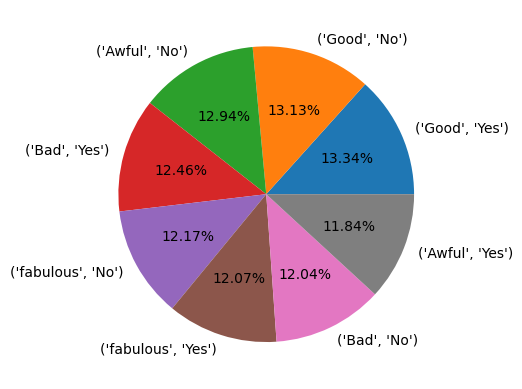

In [160]:
plt.pie(x=val_df,labels=label_df,autopct="%1.2f%%")
plt.show()

In [161]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='collegemark'>

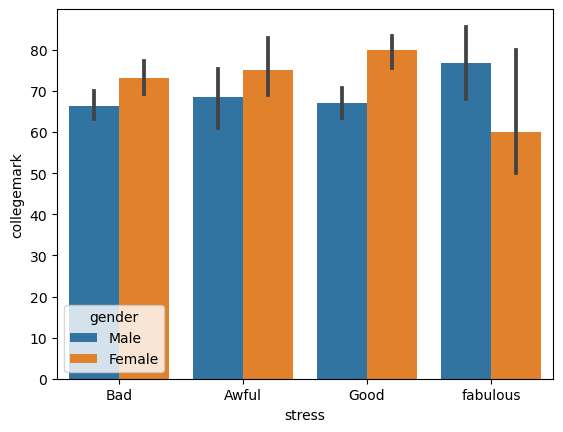

In [162]:
sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='collegemark'>

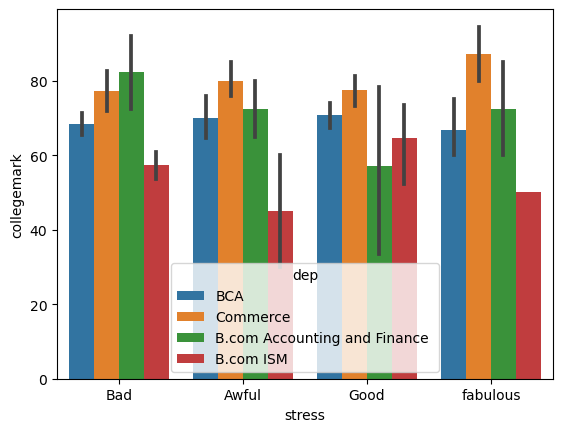

In [163]:
sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='collegemark'>

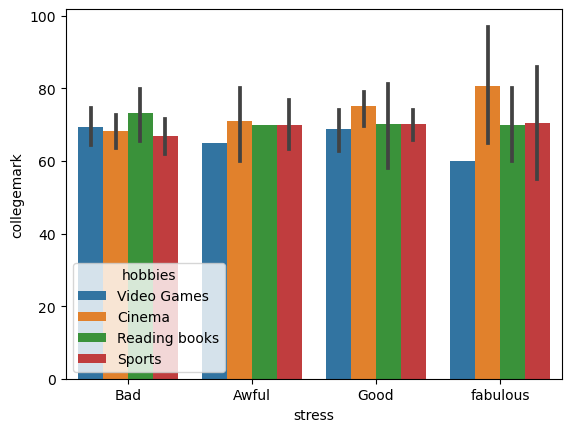

In [164]:

sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='collegemark'>

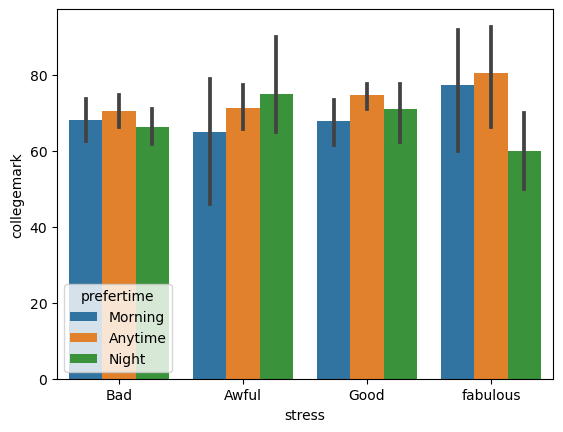

In [165]:


sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='collegemark'>

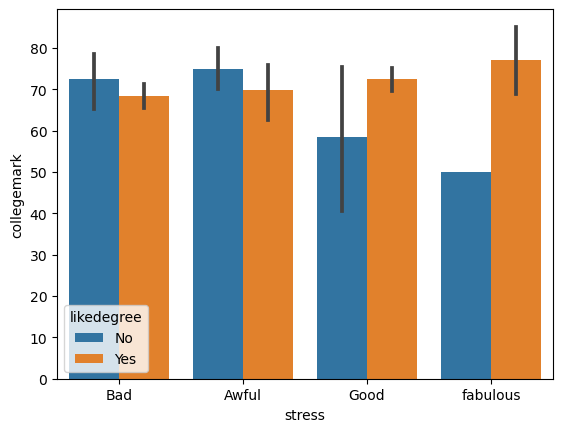

In [166]:
sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='collegemark'>

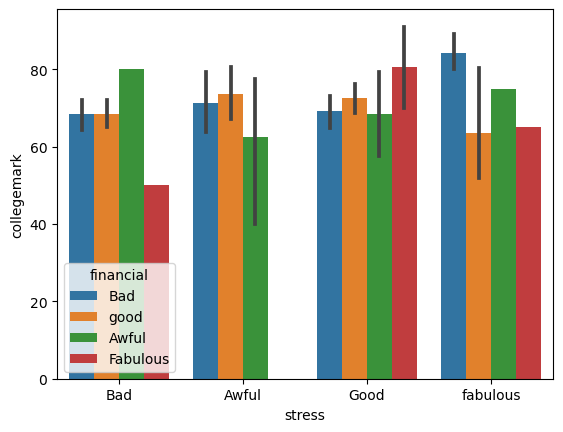

In [167]:

sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='collegemark'>

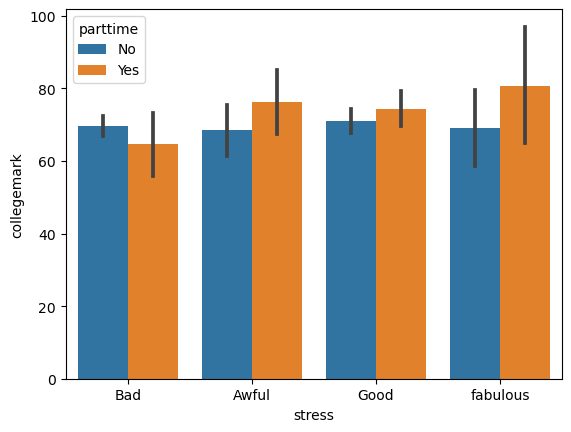

In [168]:
sns.barplot(x=df['stress'],y=df['collegemark'],hue=df['parttime'])

In [169]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='studytime'>

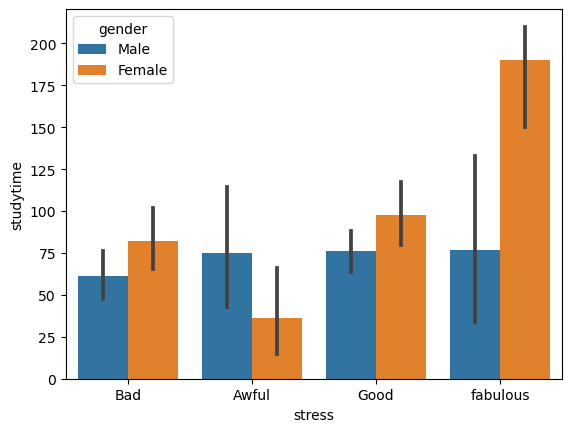

In [170]:
sns.barplot(x=df['stress'],y=df['studytime'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='studytime'>

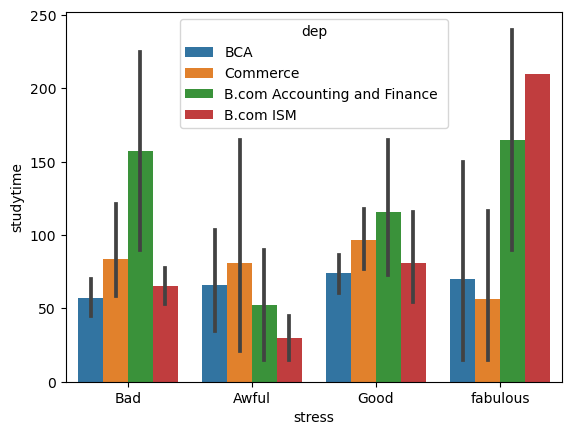

In [171]:
sns.barplot(x=df['stress'],y=df['studytime'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='studytime'>

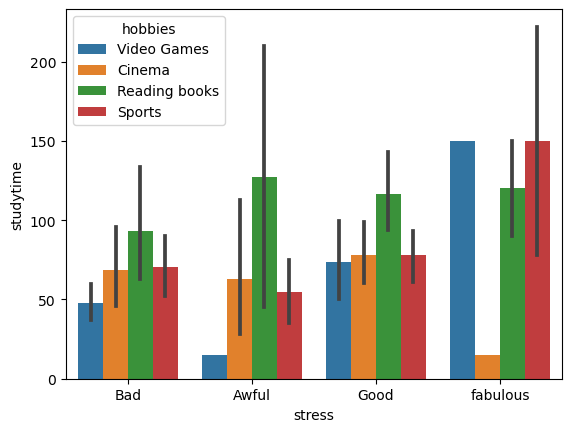

In [172]:

sns.barplot(x=df['stress'],y=df['studytime'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='studytime'>

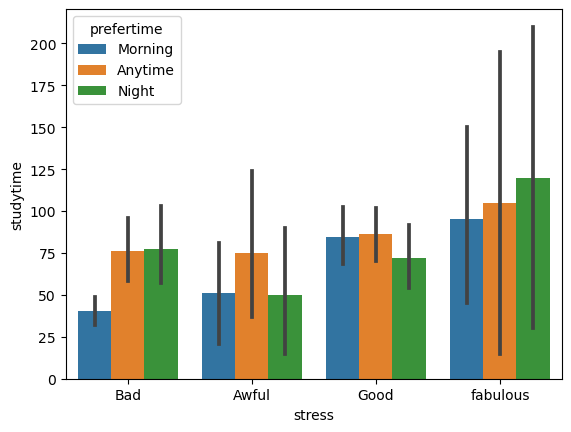

In [173]:


sns.barplot(x=df['stress'],y=df['studytime'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='studytime'>

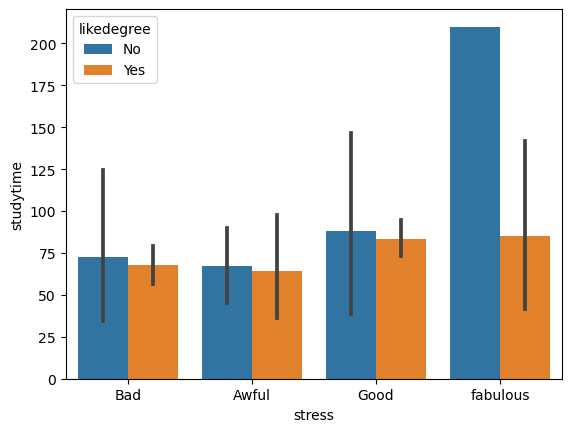

In [174]:
sns.barplot(x=df['stress'],y=df['studytime'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='studytime'>

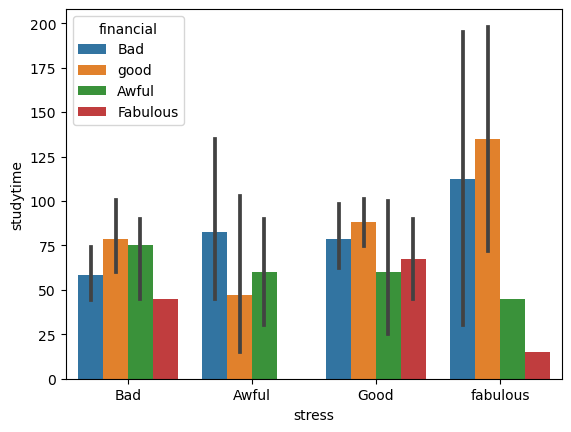

In [175]:

sns.barplot(x=df['stress'],y=df['studytime'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='studytime'>

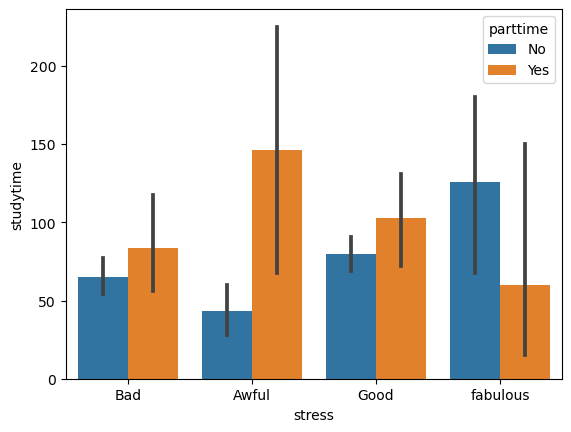

In [176]:
sns.barplot(x=df['stress'],y=df['studytime'],hue=df['parttime'])

In [177]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='salexpect'>

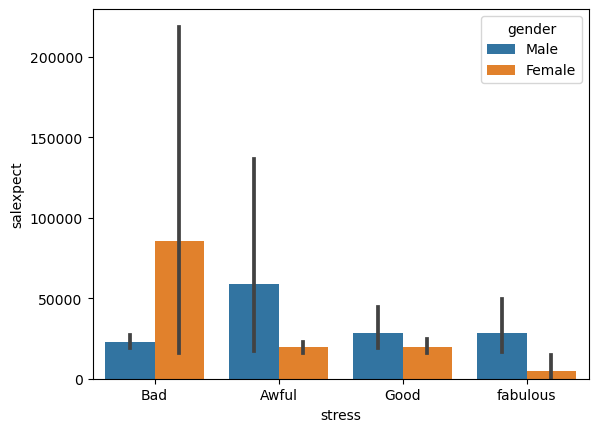

In [178]:
sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='salexpect'>

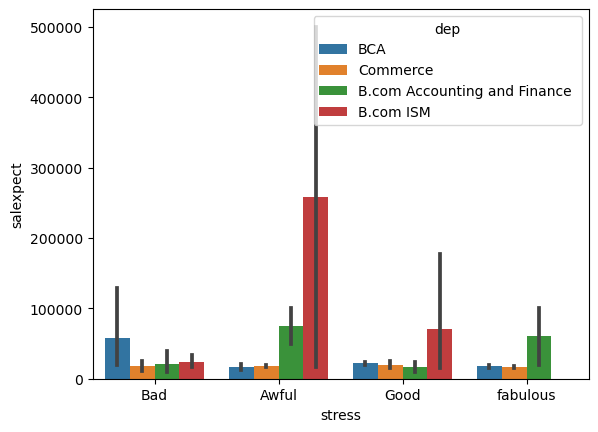

In [179]:
sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='salexpect'>

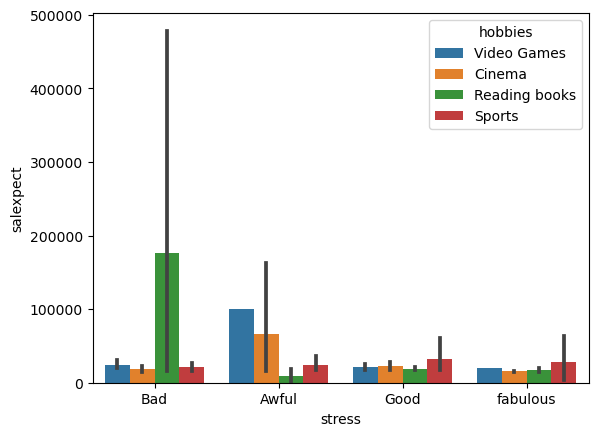

In [180]:

sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='salexpect'>

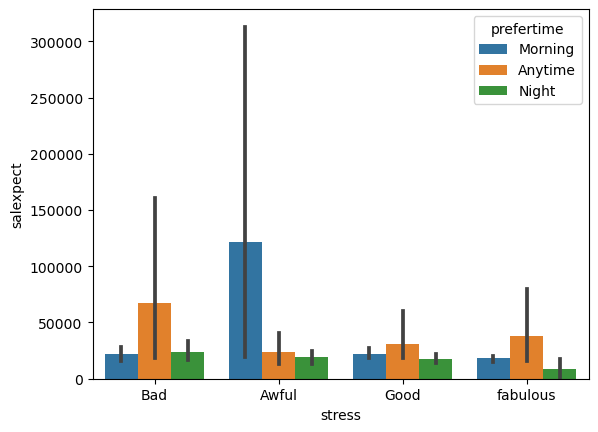

In [181]:


sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='salexpect'>

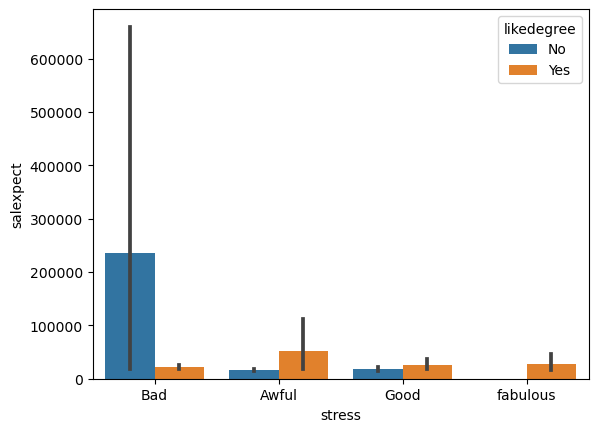

In [182]:
sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='salexpect'>

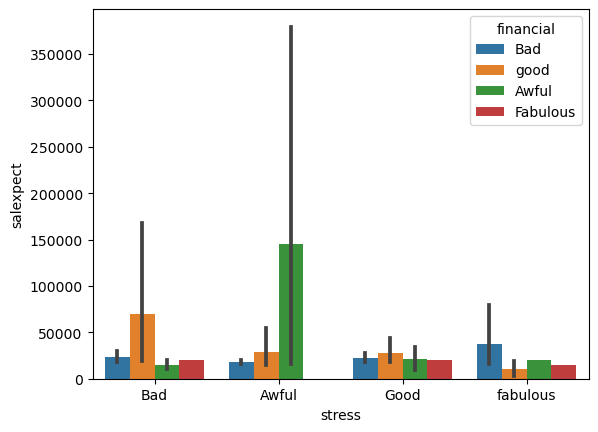

In [183]:

sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='salexpect'>

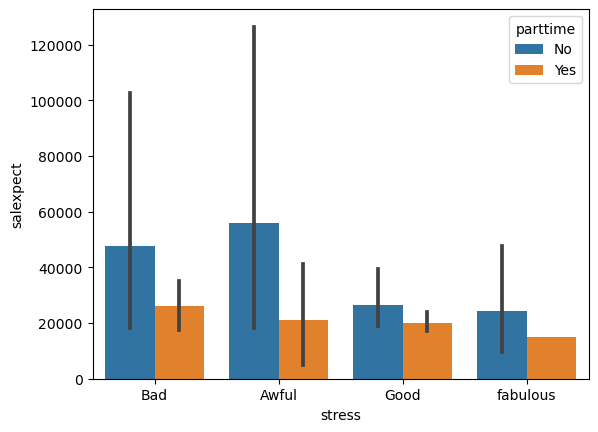

In [184]:
sns.barplot(x=df['stress'],y=df['salexpect'],hue=df['parttime'])

In [185]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='carrer_willing'>

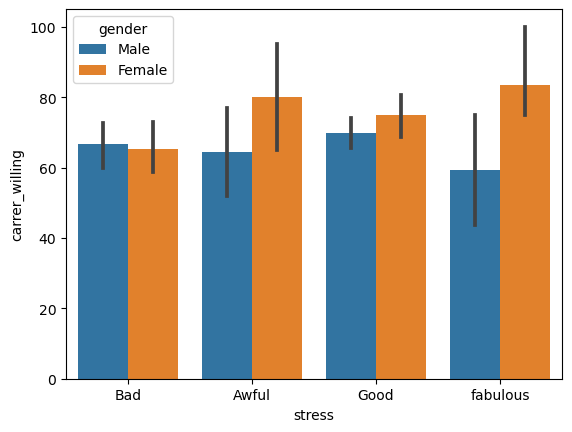

In [186]:
sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

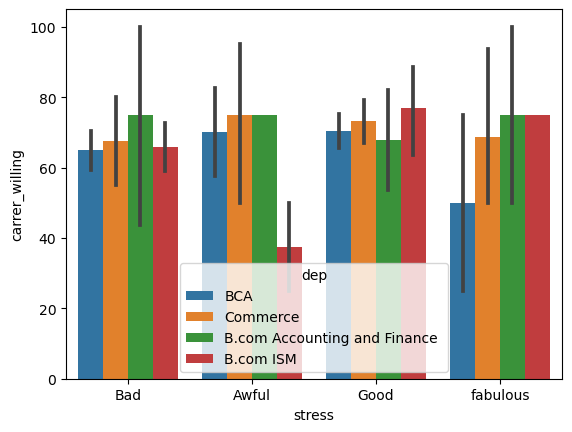

In [187]:
sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

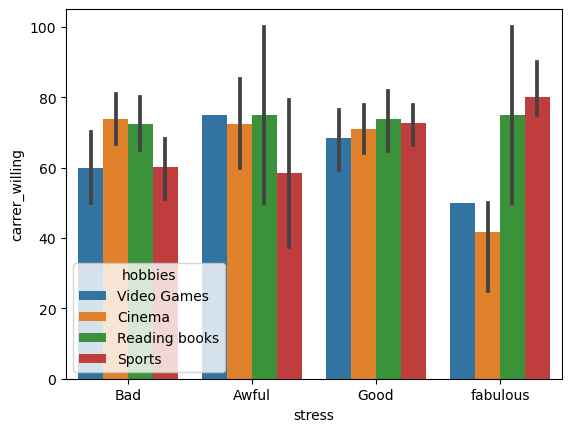

In [188]:

sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

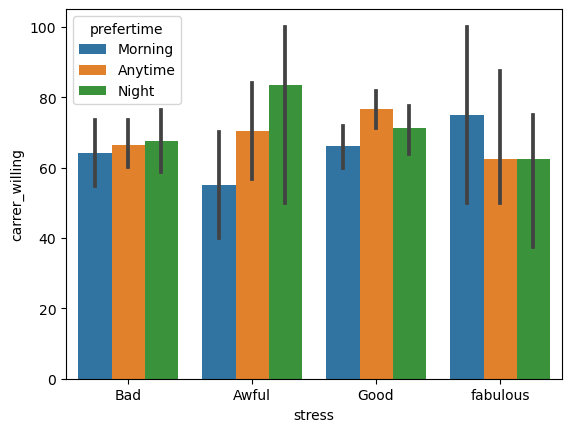

In [189]:


sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

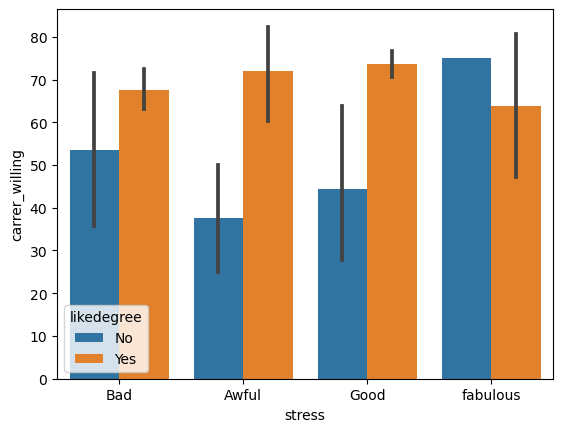

In [190]:
sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

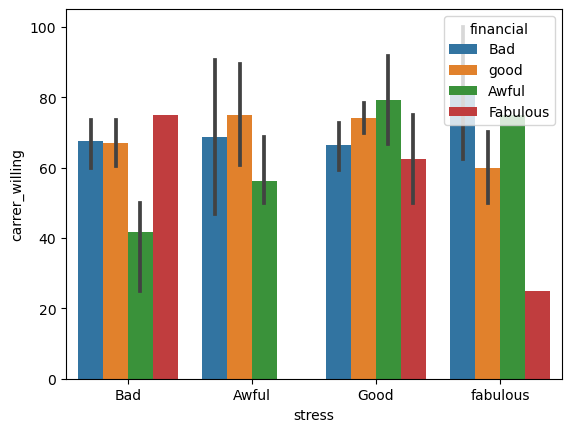

In [191]:

sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

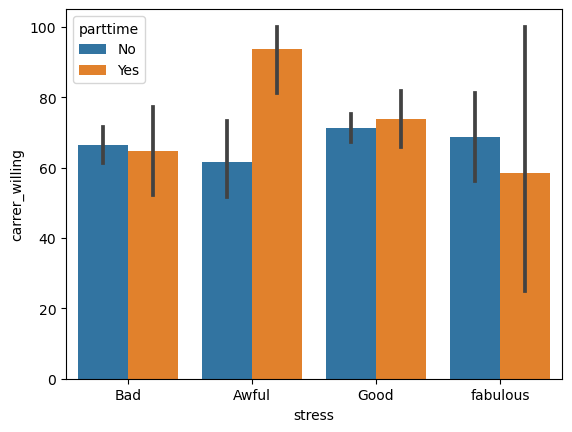

In [192]:
sns.barplot(x=df['stress'],y=df['carrer_willing'],hue=df['parttime'])

In [193]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='smtime'>

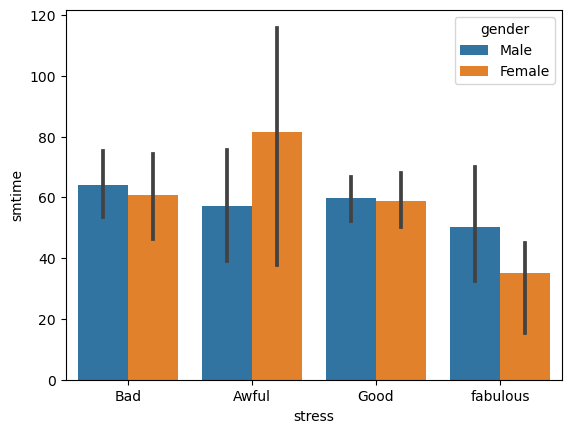

In [194]:
sns.barplot(x=df['stress'],y=df['smtime'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='smtime'>

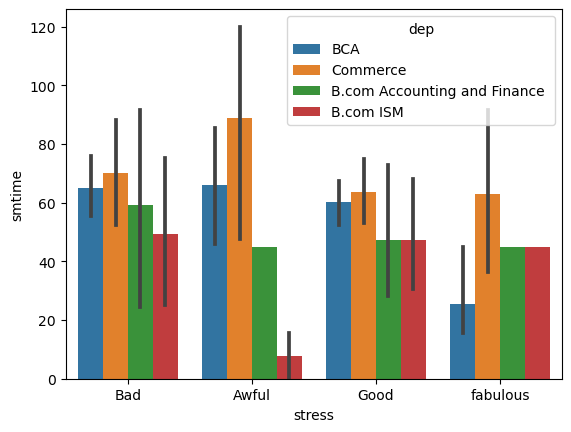

In [195]:
sns.barplot(x=df['stress'],y=df['smtime'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='smtime'>

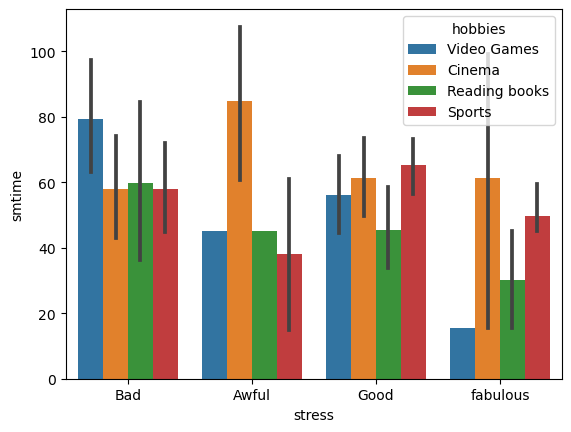

In [196]:

sns.barplot(x=df['stress'],y=df['smtime'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='smtime'>

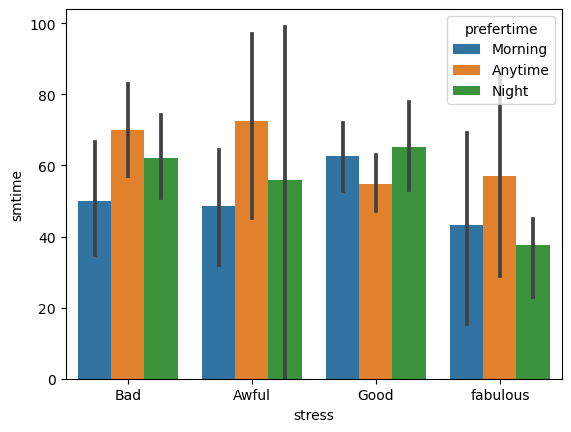

In [197]:


sns.barplot(x=df['stress'],y=df['smtime'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='smtime'>

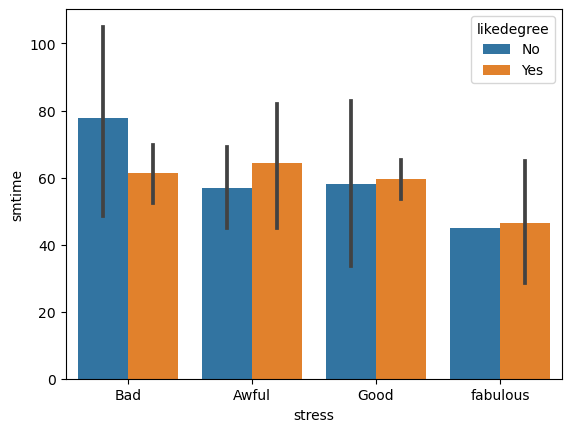

In [198]:
sns.barplot(x=df['stress'],y=df['smtime'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='smtime'>

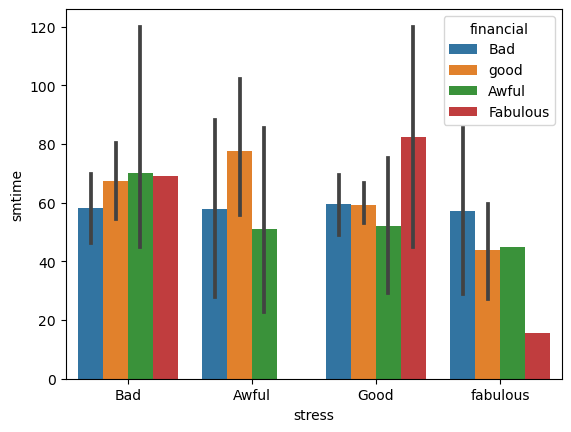

In [199]:

sns.barplot(x=df['stress'],y=df['smtime'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='smtime'>

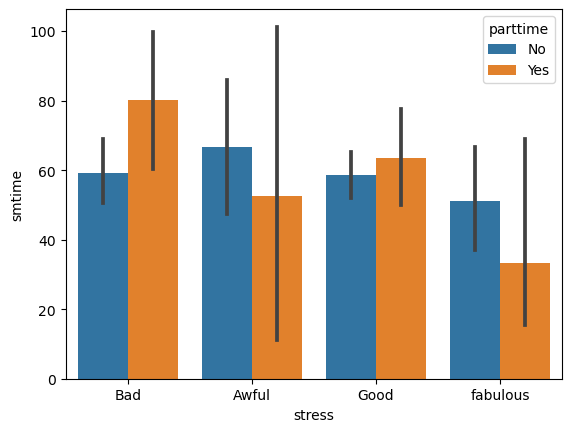

In [200]:
sns.barplot(x=df['stress'],y=df['smtime'],hue=df['parttime'])

In [201]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='travel'>

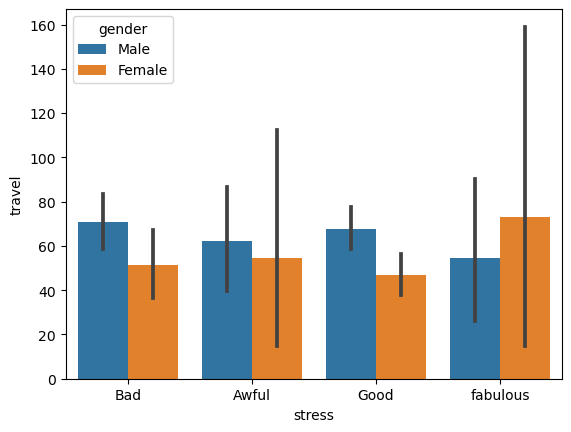

In [202]:
sns.barplot(x=df['stress'],y=df['travel'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='travel'>

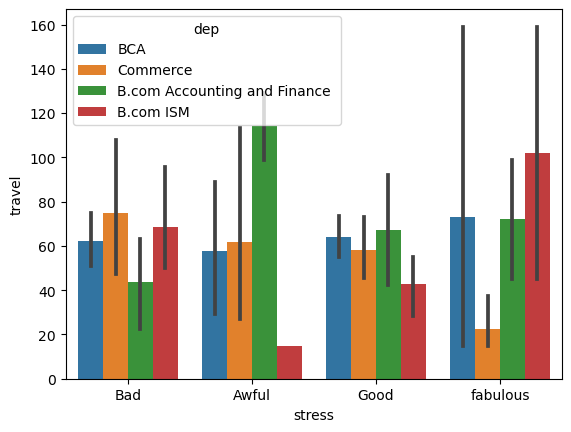

In [203]:
sns.barplot(x=df['stress'],y=df['travel'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='travel'>

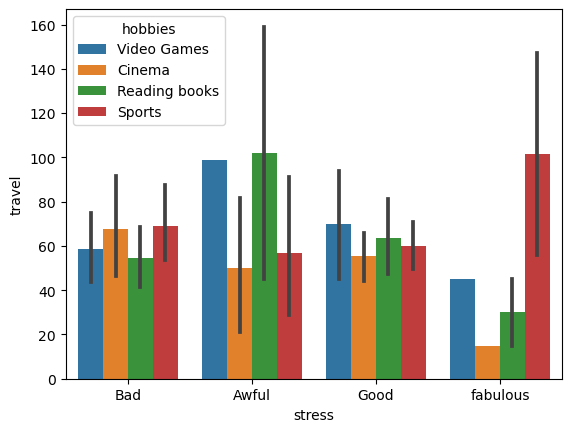

In [204]:

sns.barplot(x=df['stress'],y=df['travel'],hue=df['hobbies'])

<Axes: xlabel='stress', ylabel='travel'>

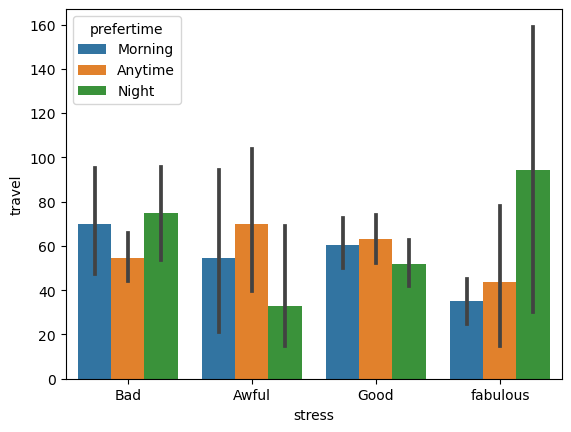

In [205]:


sns.barplot(x=df['stress'],y=df['travel'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='travel'>

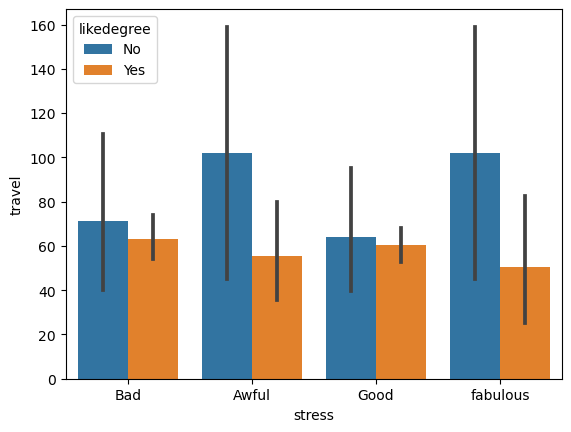

In [206]:
sns.barplot(x=df['stress'],y=df['travel'],hue=df['likedegree'])

<Axes: xlabel='stress', ylabel='travel'>

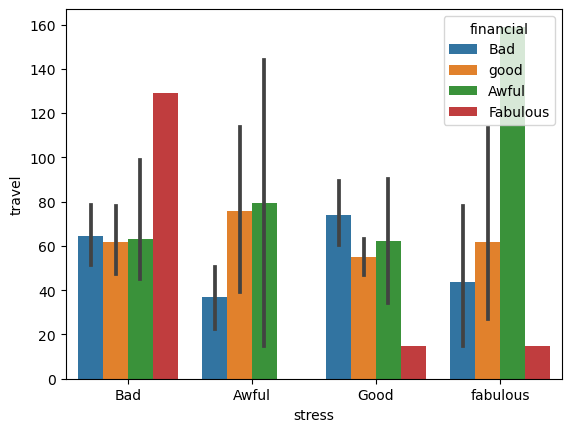

In [207]:

sns.barplot(x=df['stress'],y=df['travel'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='travel'>

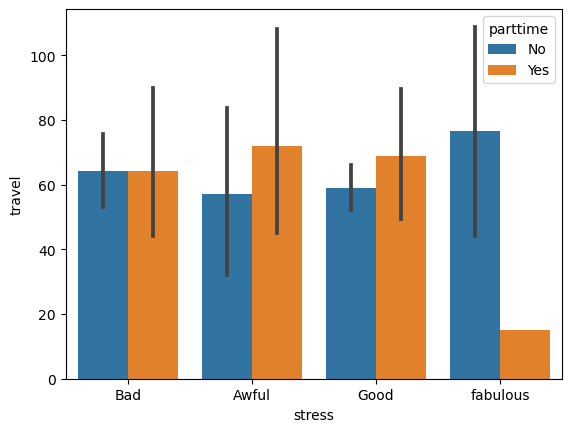

In [208]:
sns.barplot(x=df['stress'],y=df['travel'],hue=df['parttime'])

In [209]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

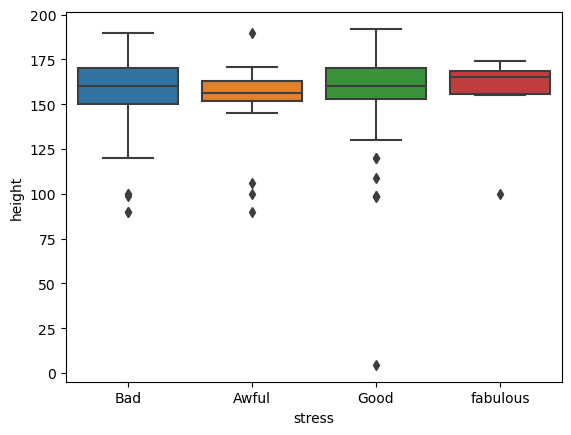

In [210]:
sns.boxplot(data=df,x=df['stress'],y=df['height'])

<Axes: xlabel='stress', ylabel='weight'>

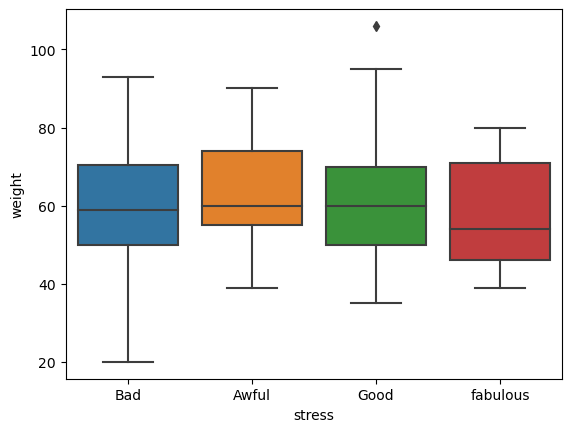

In [211]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'])

<Axes: xlabel='stress', ylabel='mark10th'>

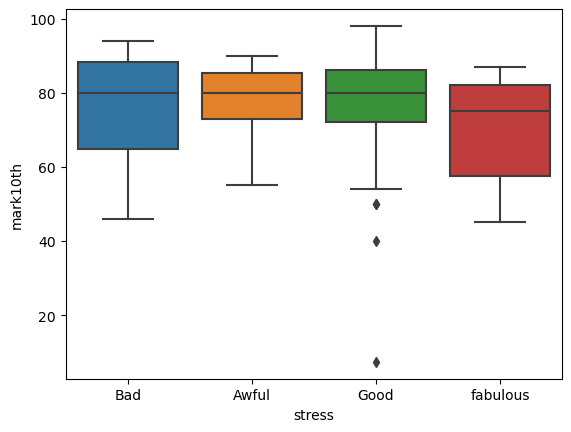

In [212]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'])

<Axes: xlabel='stress', ylabel='mark12th'>

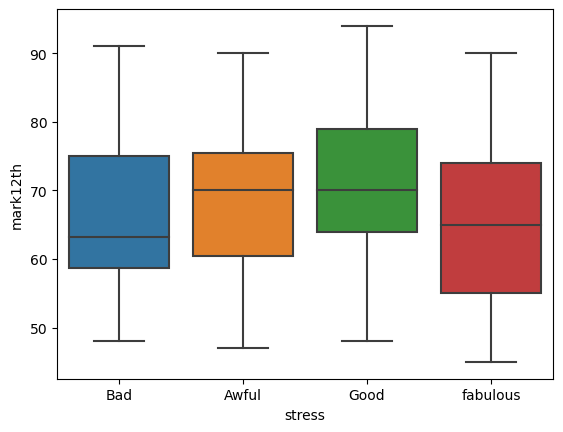

In [213]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'])

<Axes: xlabel='stress', ylabel='collegemark'>

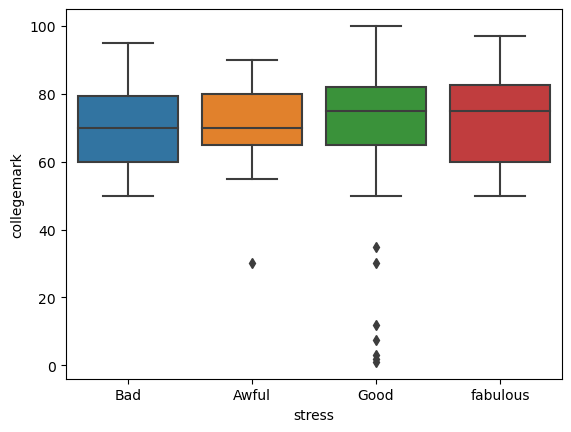

In [214]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'])

<Axes: xlabel='stress', ylabel='studytime'>

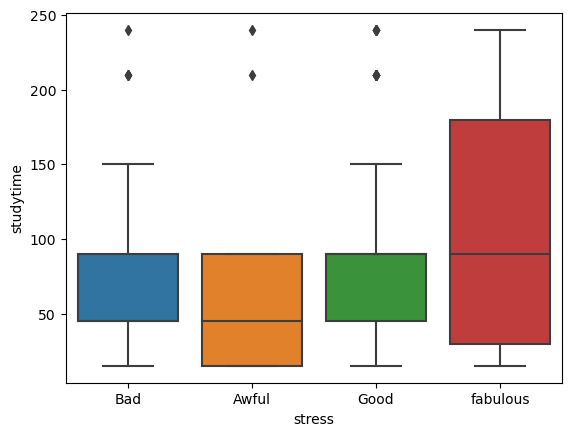

In [215]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'])

<Axes: xlabel='stress', ylabel='salexpect'>

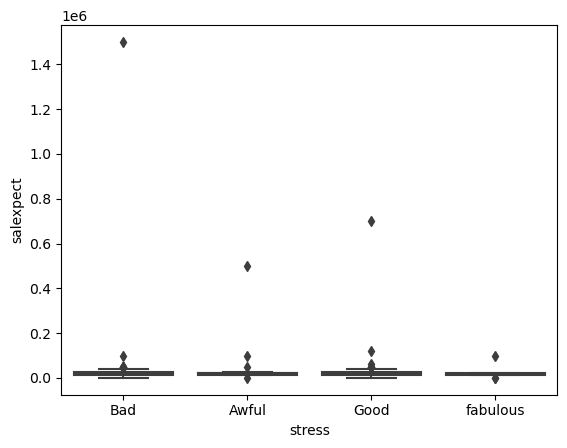

In [216]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

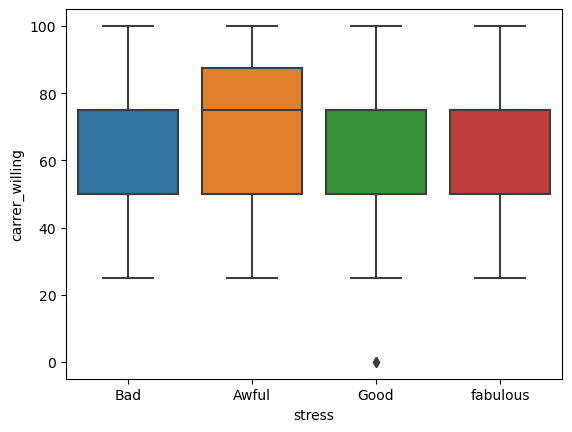

In [217]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'])

<Axes: xlabel='stress', ylabel='travel'>

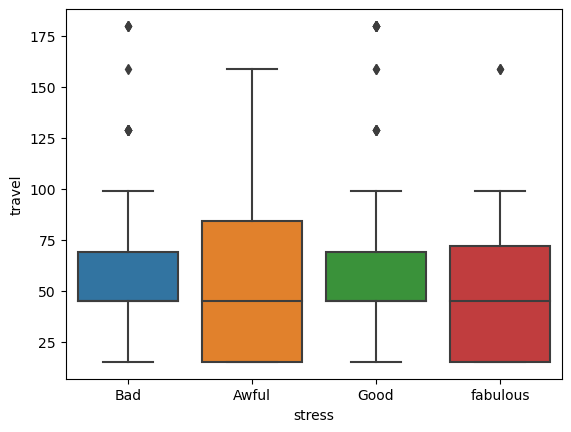

In [218]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'])

In [219]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

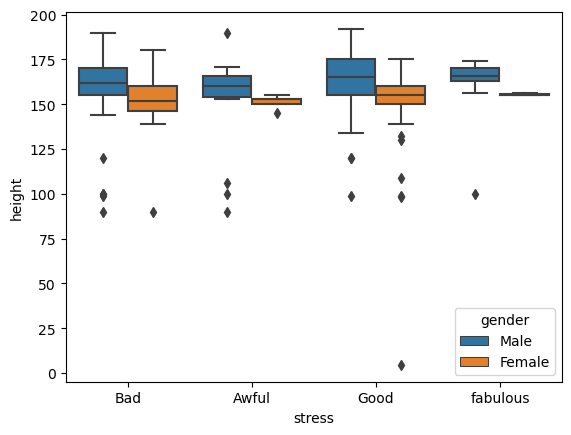

In [220]:
sns.boxplot(data=df,x=df['stress'],y=df['height'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='weight'>

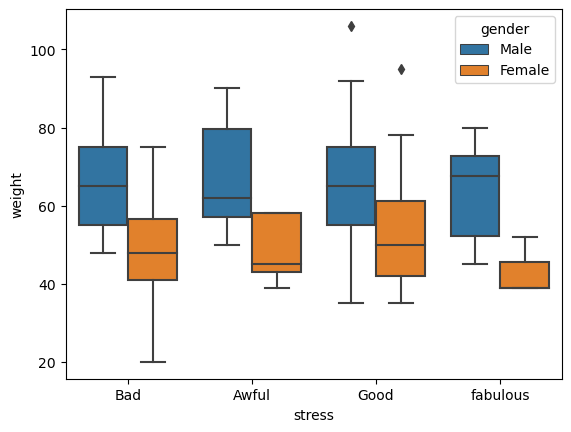

In [221]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='mark10th'>

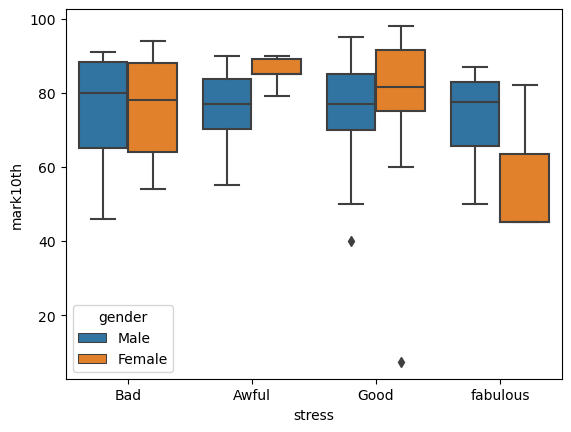

In [222]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='mark12th'>

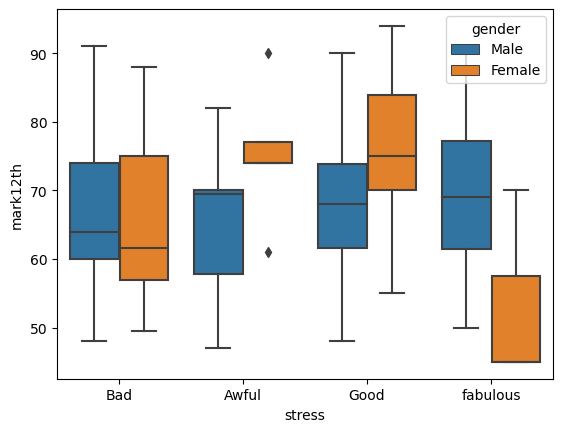

In [223]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='collegemark'>

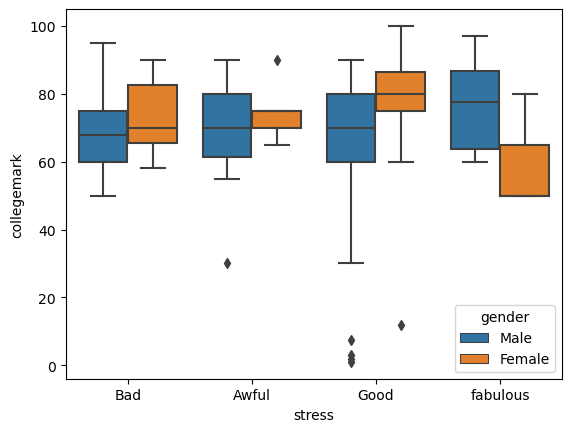

In [224]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='studytime'>

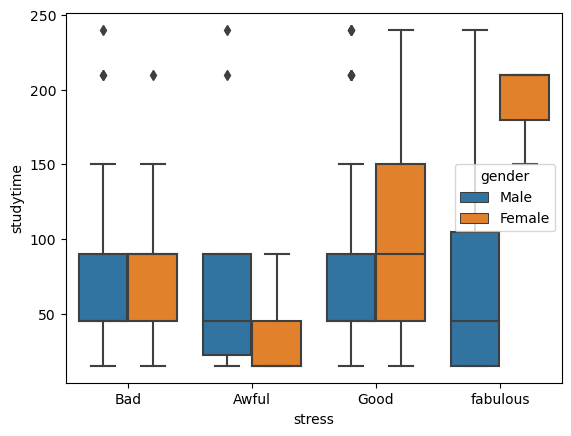

In [225]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='salexpect'>

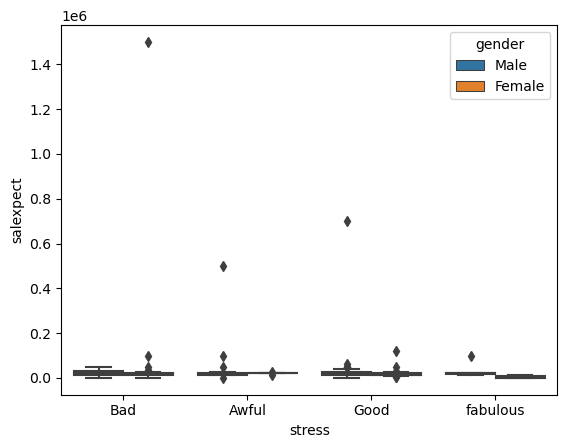

In [226]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

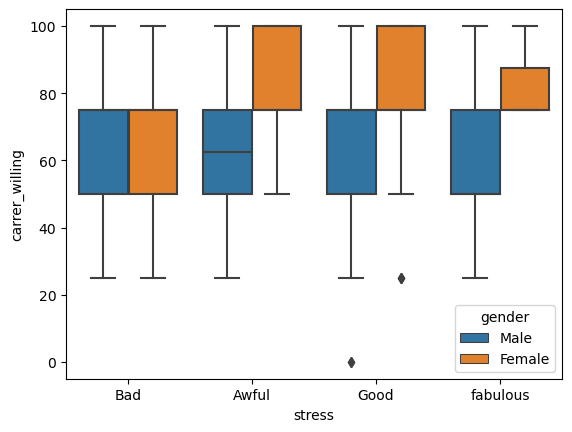

In [227]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'],hue=df['gender'])

<Axes: xlabel='stress', ylabel='travel'>

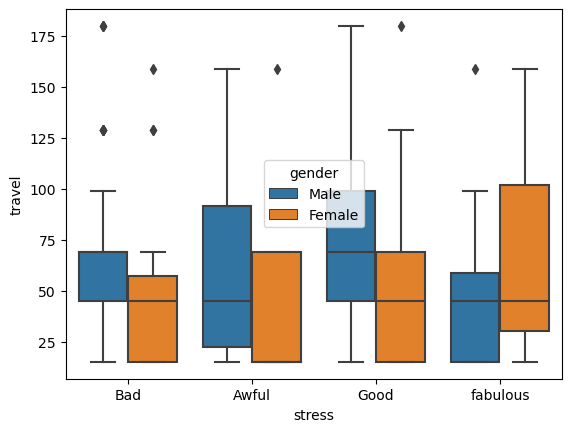

In [228]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'],hue=df['gender'])

In [229]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

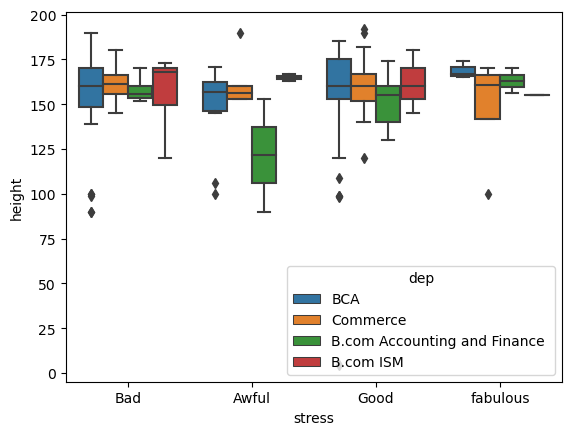

In [230]:
sns.boxplot(data=df,x=df['stress'],y=df['height'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='weight'>

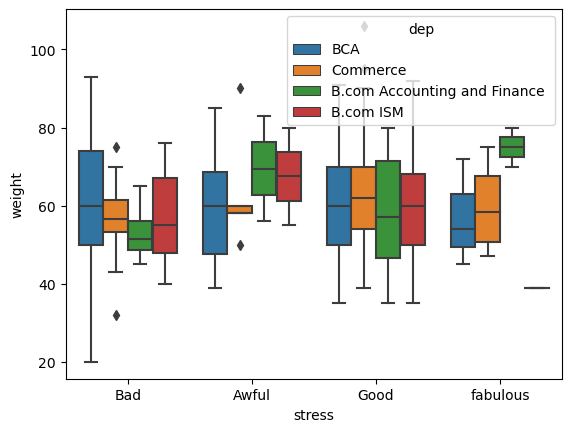

In [231]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='mark10th'>

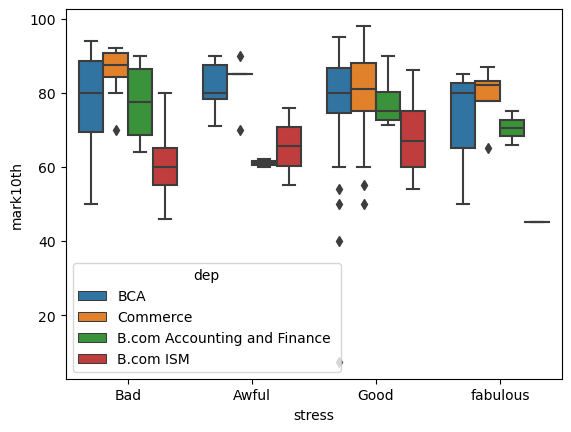

In [232]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='mark12th'>

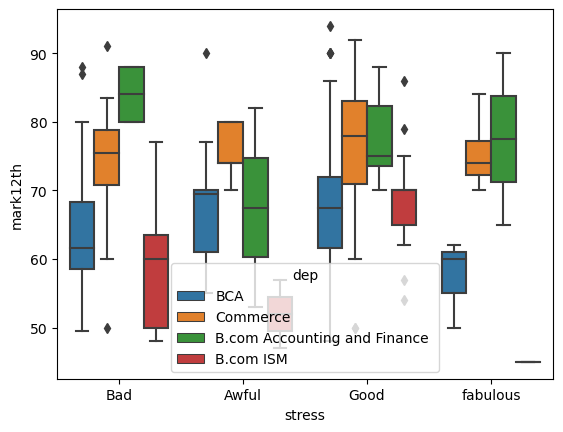

In [233]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='collegemark'>

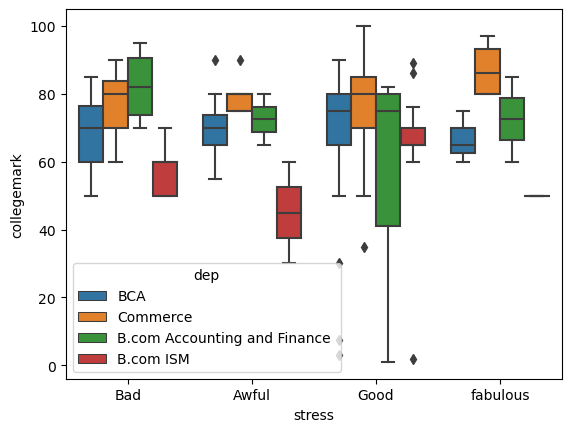

In [234]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='studytime'>

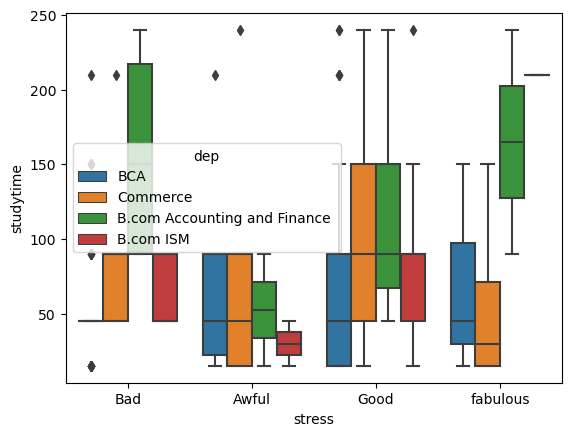

In [235]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='salexpect'>

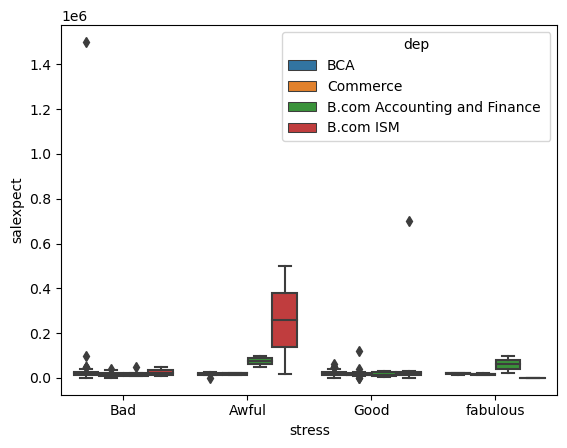

In [236]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

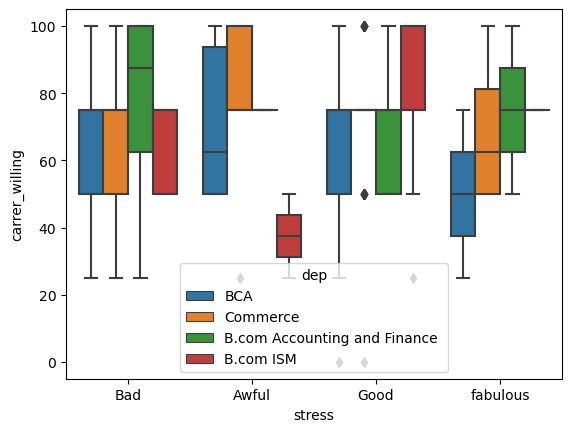

In [237]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'],hue=df['dep'])

<Axes: xlabel='stress', ylabel='travel'>

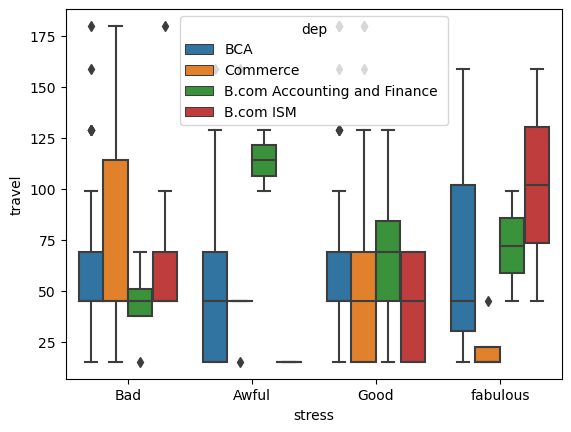

In [238]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'],hue=df['dep'])

In [239]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

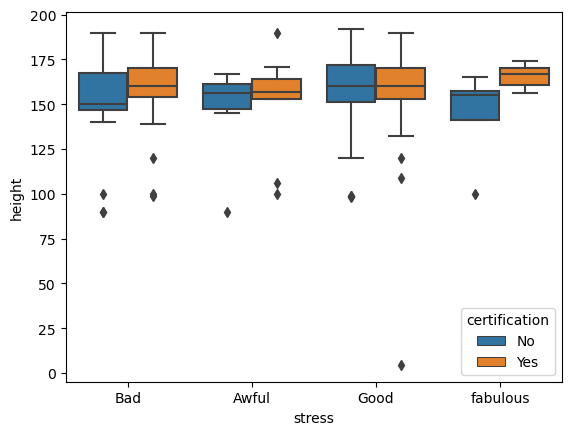

In [240]:
sns.boxplot(data=df,x=df['stress'],y=df['height'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='weight'>

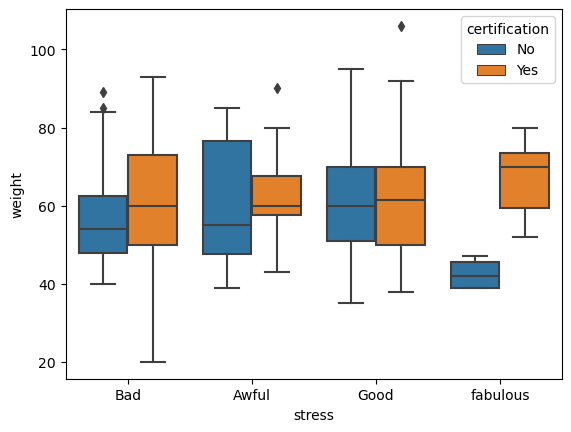

In [241]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='mark10th'>

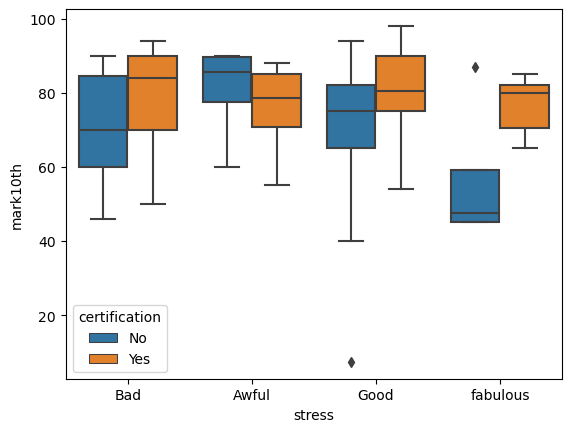

In [242]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='mark12th'>

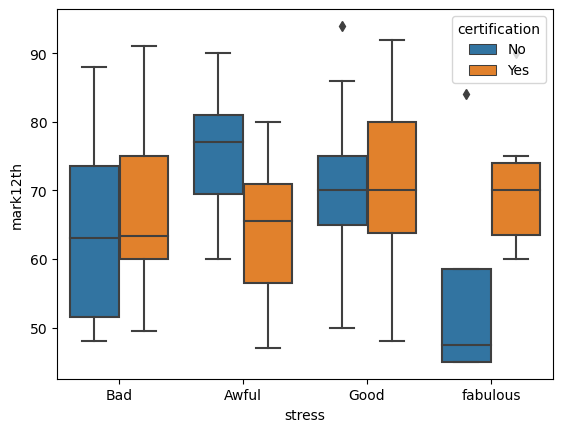

In [243]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='collegemark'>

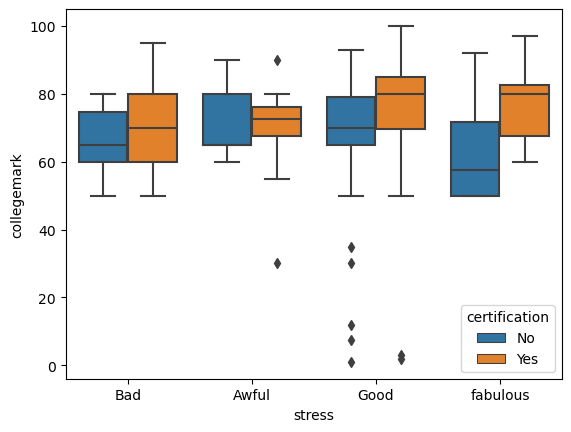

In [244]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='studytime'>

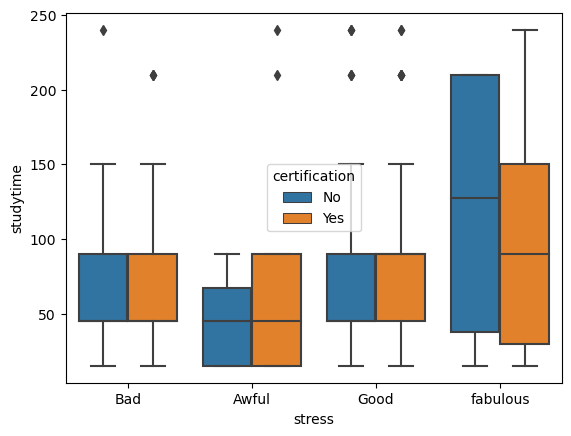

In [245]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='salexpect'>

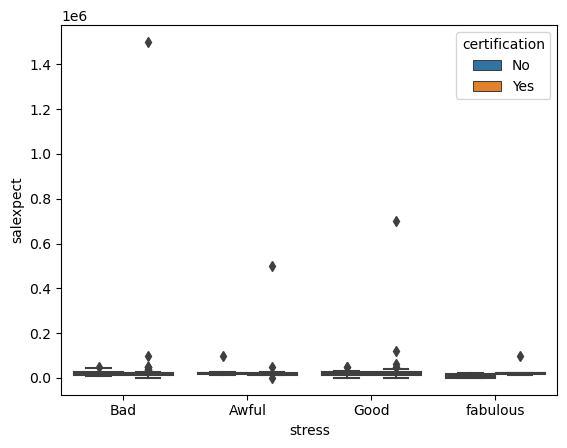

In [246]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

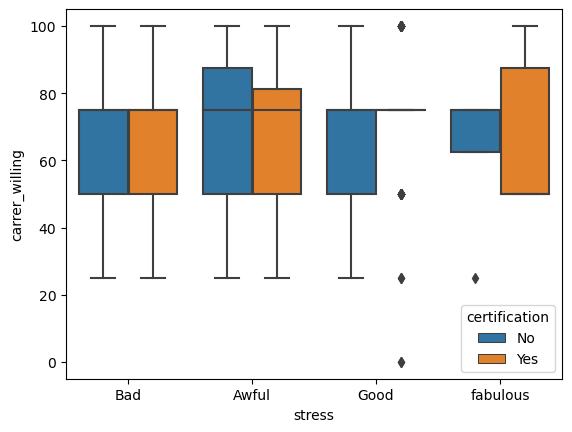

In [247]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'],hue=df['certification'])

<Axes: xlabel='stress', ylabel='travel'>

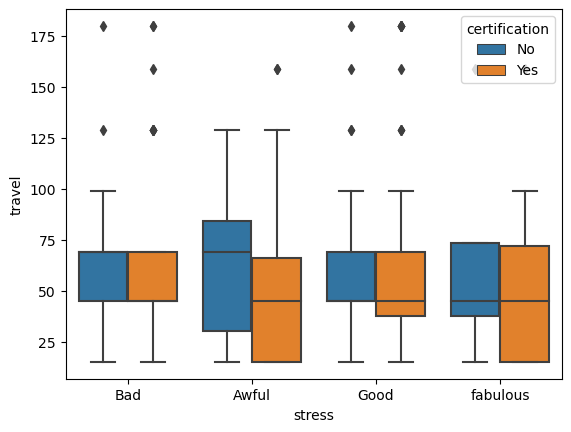

In [248]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'],hue=df['certification'])

In [249]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

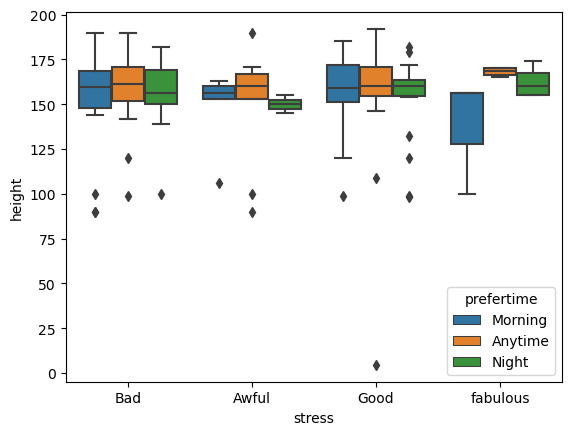

In [250]:
sns.boxplot(data=df,x=df['stress'],y=df['height'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='weight'>

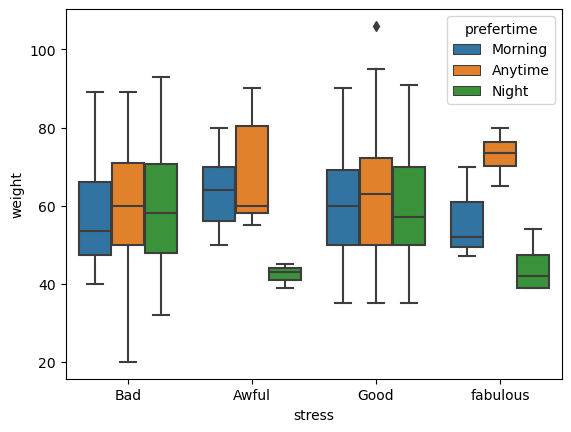

In [251]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='mark10th'>

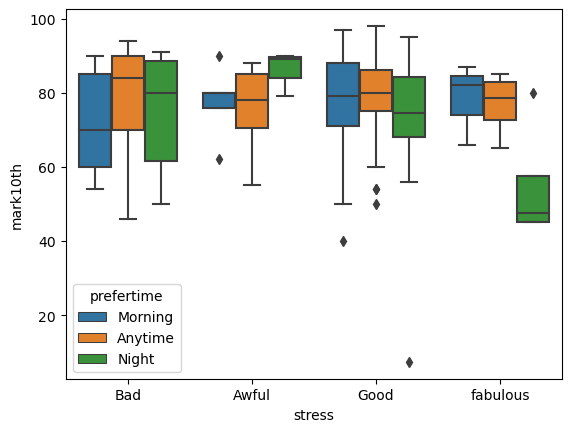

In [252]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='mark12th'>

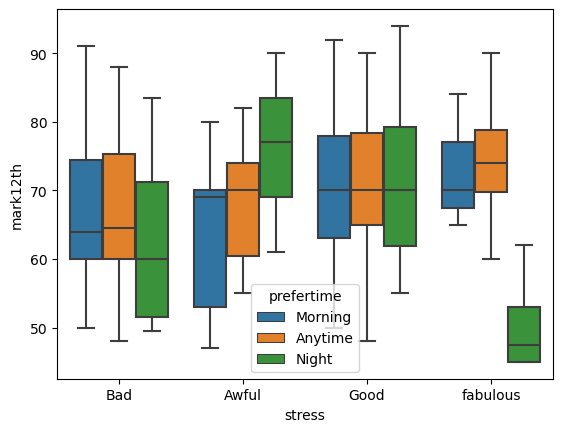

In [253]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='collegemark'>

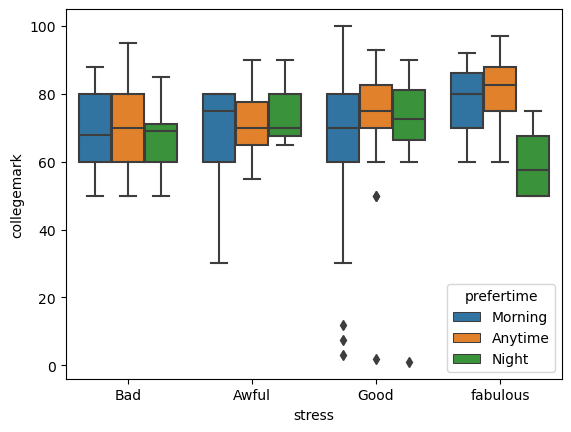

In [254]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='studytime'>

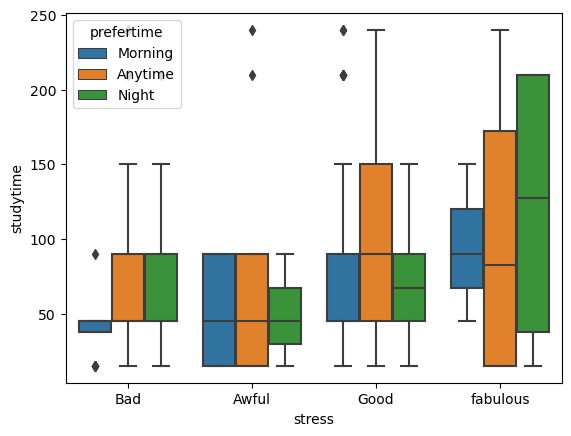

In [255]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='salexpect'>

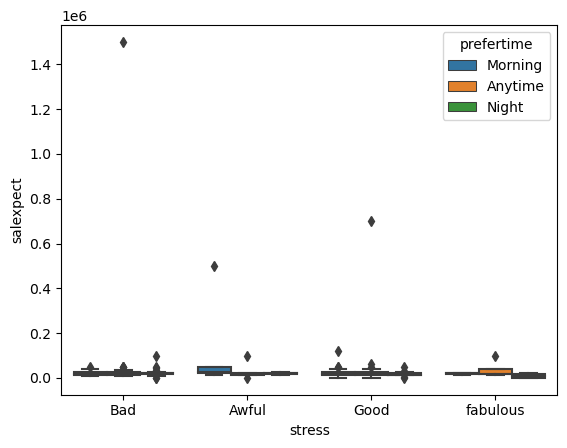

In [256]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

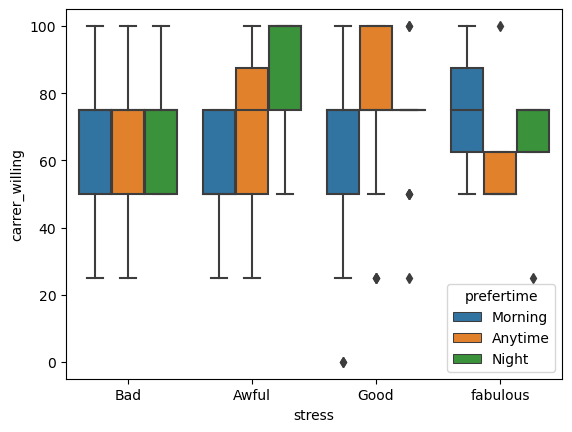

In [257]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'],hue=df['prefertime'])

<Axes: xlabel='stress', ylabel='travel'>

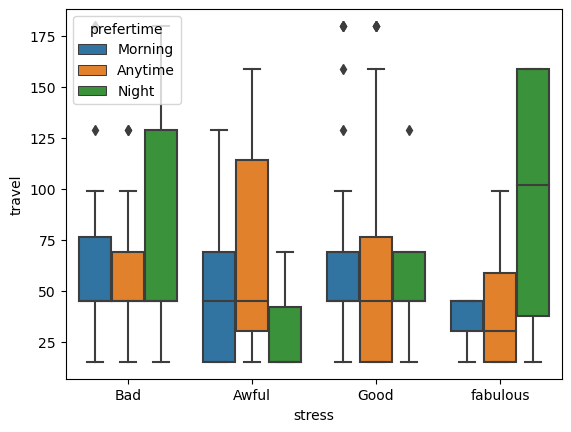

In [258]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'],hue=df['prefertime'])

In [259]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

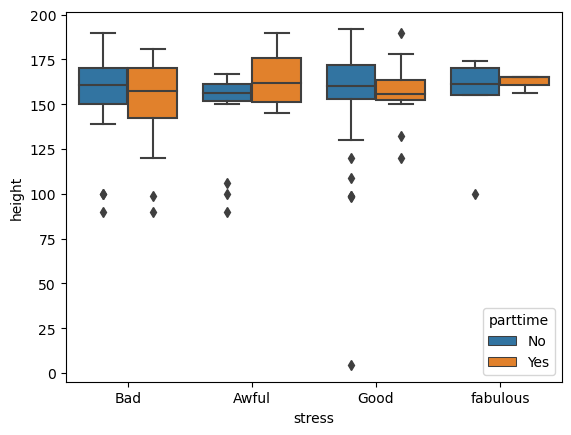

In [260]:
sns.boxplot(data=df,x=df['stress'],y=df['height'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='weight'>

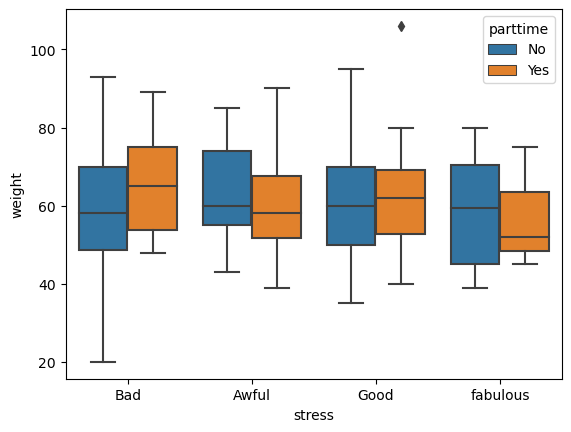

In [261]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='mark10th'>

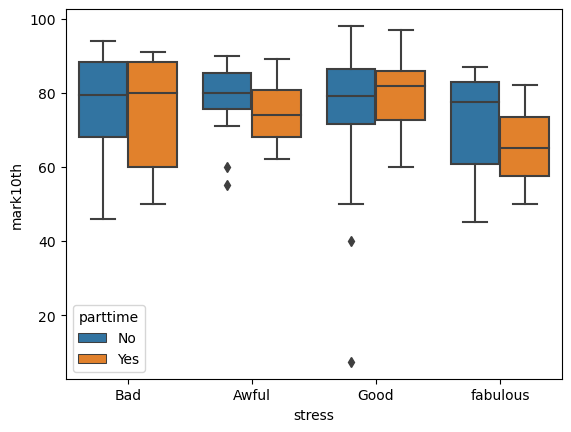

In [262]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='mark12th'>

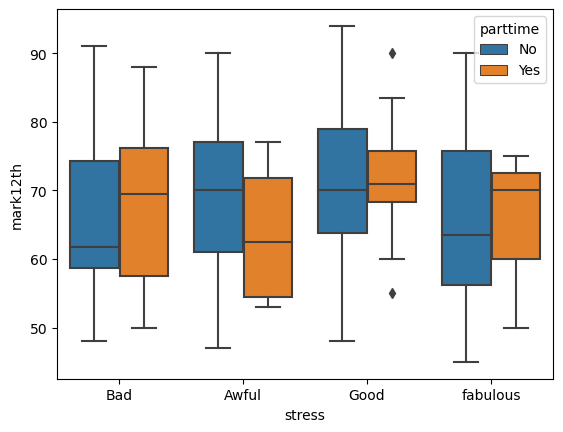

In [263]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='collegemark'>

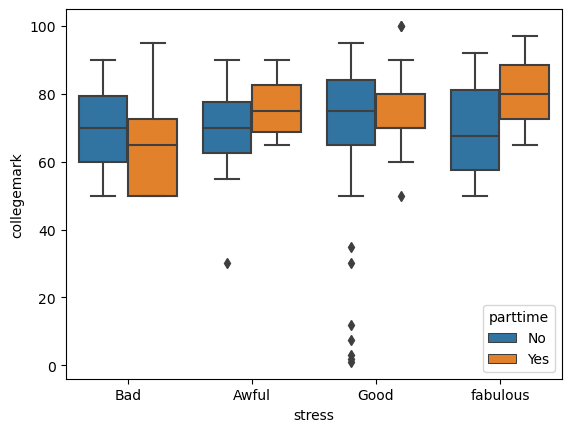

In [264]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='studytime'>

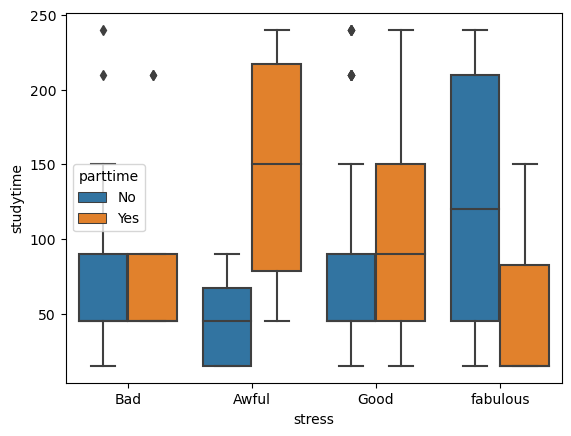

In [265]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='salexpect'>

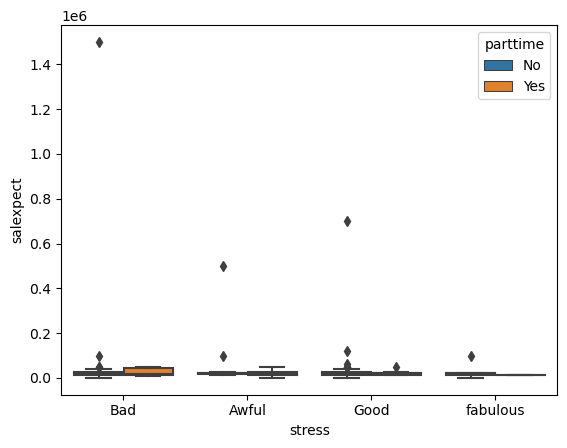

In [266]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

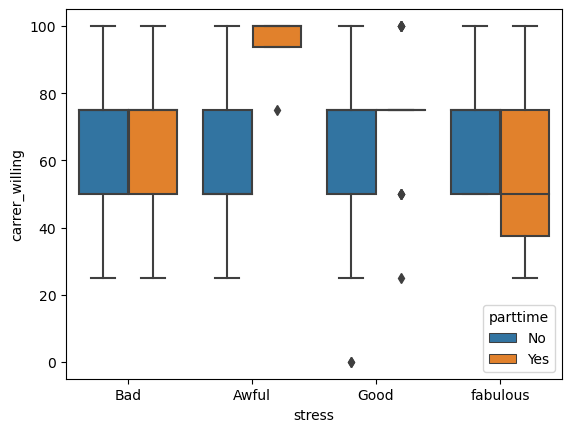

In [267]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'],hue=df['parttime'])

<Axes: xlabel='stress', ylabel='travel'>

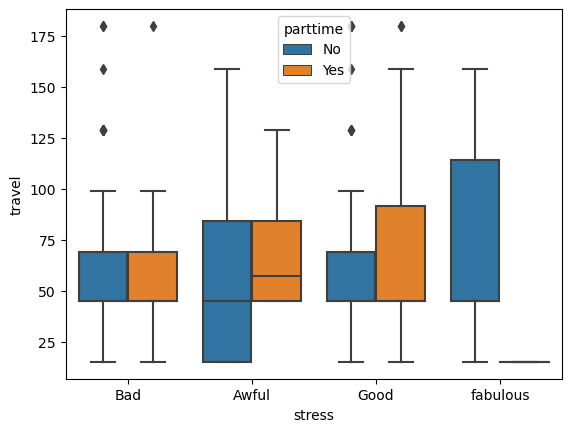

In [268]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'],hue=df['parttime'])

In [269]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


<Axes: xlabel='stress', ylabel='height'>

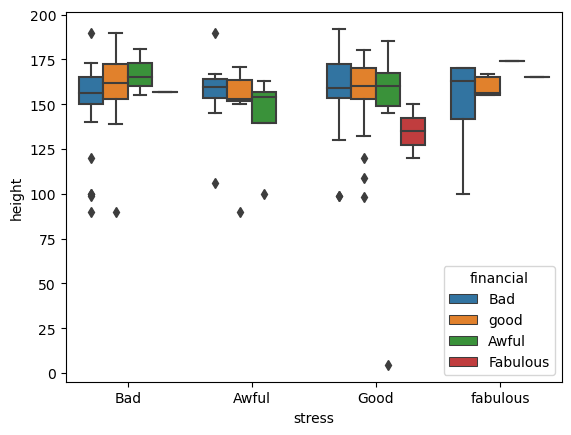

In [270]:
sns.boxplot(data=df,x=df['stress'],y=df['height'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='weight'>

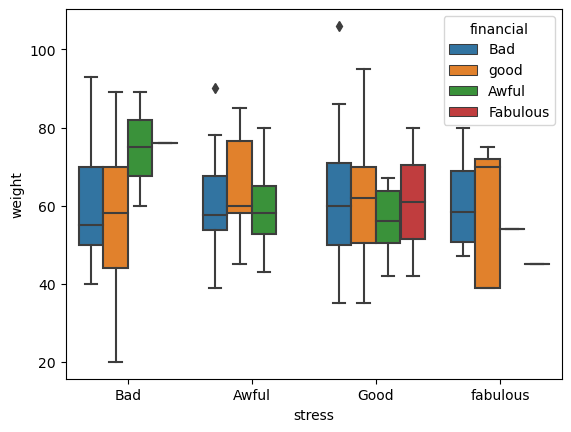

In [271]:
sns.boxplot(data=df,x=df['stress'],y=df['weight'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='mark10th'>

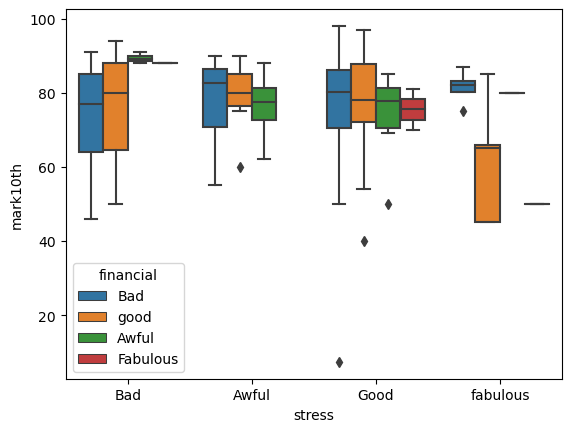

In [272]:

sns.boxplot(data=df,x=df['stress'],y=df['mark10th'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='mark12th'>

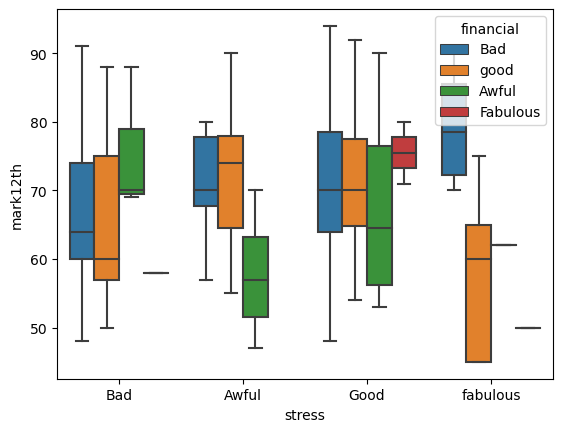

In [273]:
sns.boxplot(data=df,x=df['stress'],y=df['mark12th'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='collegemark'>

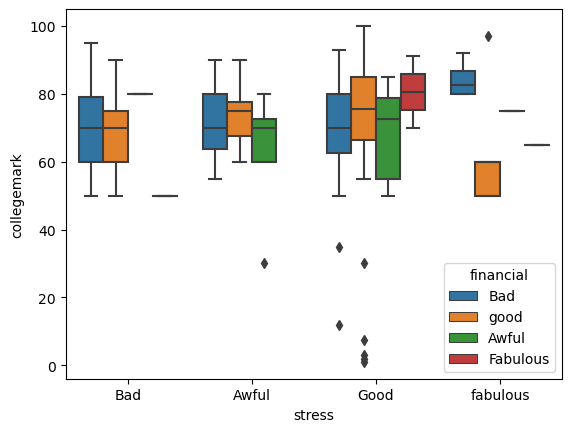

In [274]:
sns.boxplot(data=df,x=df['stress'],y=df['collegemark'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='studytime'>

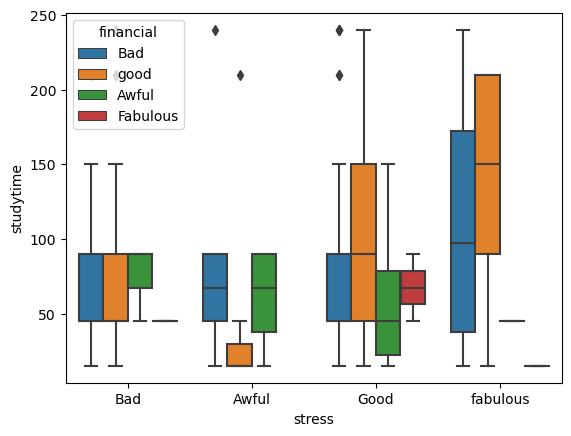

In [275]:

sns.boxplot(data=df,x=df['stress'],y=df['studytime'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='salexpect'>

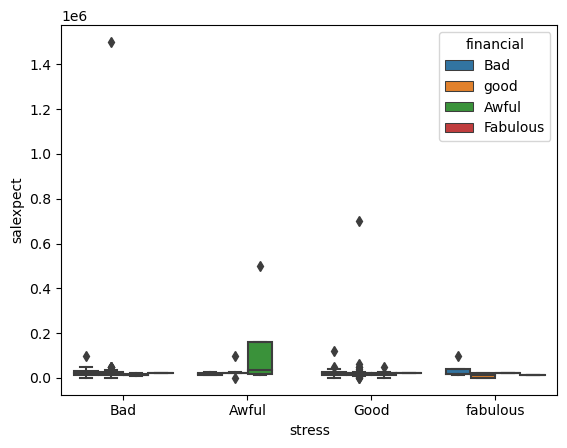

In [276]:
sns.boxplot(data=df,x=df['stress'],y=df['salexpect'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='carrer_willing'>

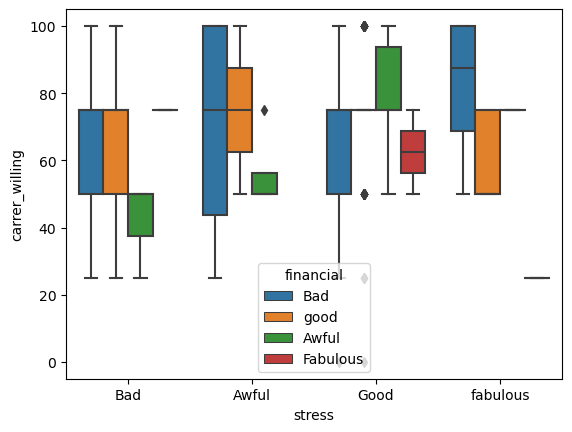

In [277]:
sns.boxplot(data=df,x=df['stress'],y=df['carrer_willing'],hue=df['financial'])

<Axes: xlabel='stress', ylabel='travel'>

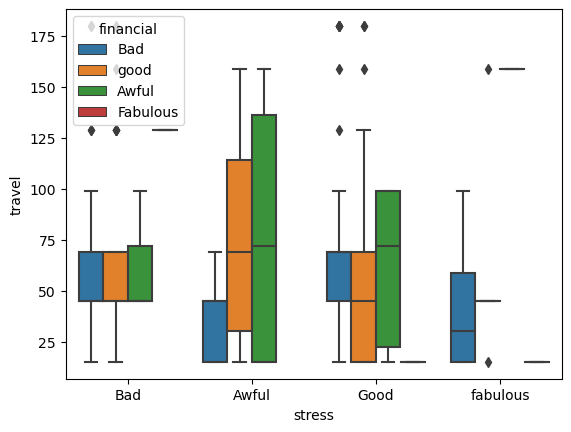

In [278]:

sns.boxplot(data=df,x=df['stress'],y=df['travel'],hue=df['financial'])

In [279]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating

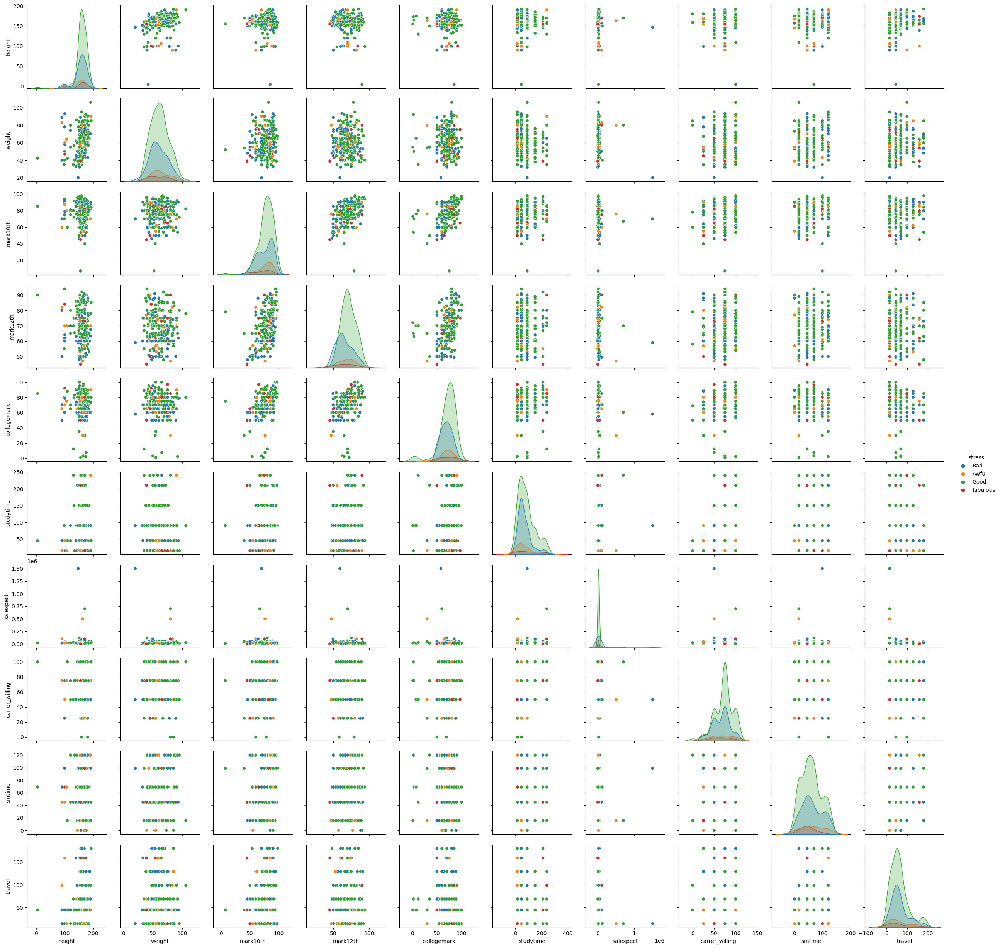

In [280]:
sns.pairplot(data=df,hue='stress')

In [281]:
numeric_columns = df.select_dtypes(include=['number'])

In [282]:
numeric_columns

,height,weight,mark10th,mark12th,collegemark,studytime,salexpect,carrer_willing,smtime,travel
0,100.0,58.0,79.0,64.0,80.0,15.0,40000,50.0,99.0,45.0
1,90.0,40.0,70.0,80.0,70.0,45.0,15000,75.0,69.0,15.0
2,159.0,78.0,71.0,61.0,55.0,90.0,13000,50.0,120.0,45.0
3,147.0,20.0,70.0,59.0,58.0,90.0,1500000,50.0,99.0,15.0
4,170.0,54.0,40.0,65.0,30.0,45.0,50000,25.0,99.0,45.0
...,...,...,...,...,...,...,...,...,...,...
230,170.0,76.0,72.0,67.0,65.0,45.0,7000,50.0,120.0,45.0
231,172.0,52.0,72.0,70.0,76.0,150.0,25000,75.0,45.0,45.0
232,139.0,33.0,90.0,75.0,70.0,45.0,20000,50.0,45.0,159.0
233,153.0,58.0,85.0,74.0,75.0,15.0,20000,75.0,120.0,159.0


<Axes: >

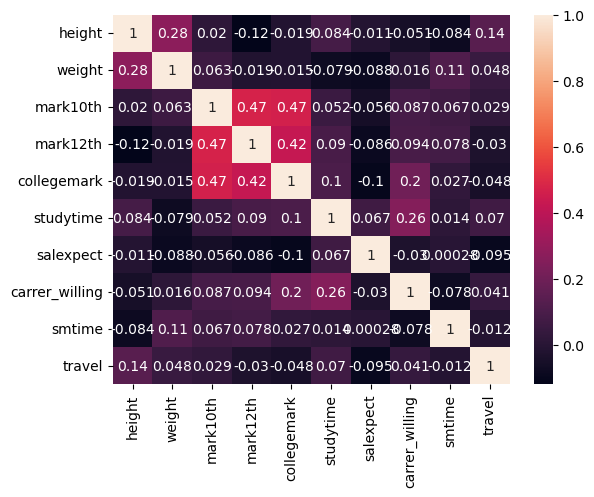

In [283]:
sns.heatmap(numeric_columns.corr(),annot=True)

C:\Users\himan\AppData\Local\Temp\ipykernel_15808\2115768055.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[column])
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\AppData\Local\Temp\ipykernel_15808\2115768055.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) 

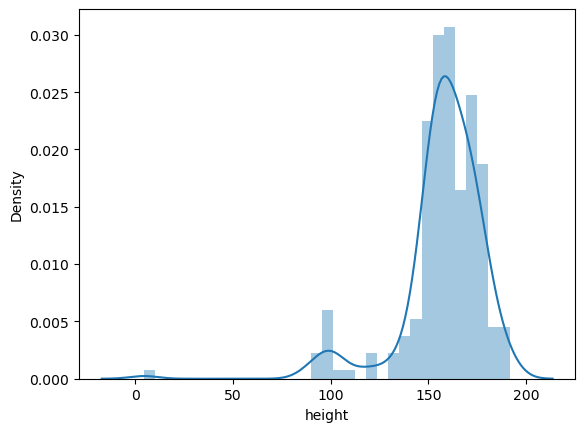

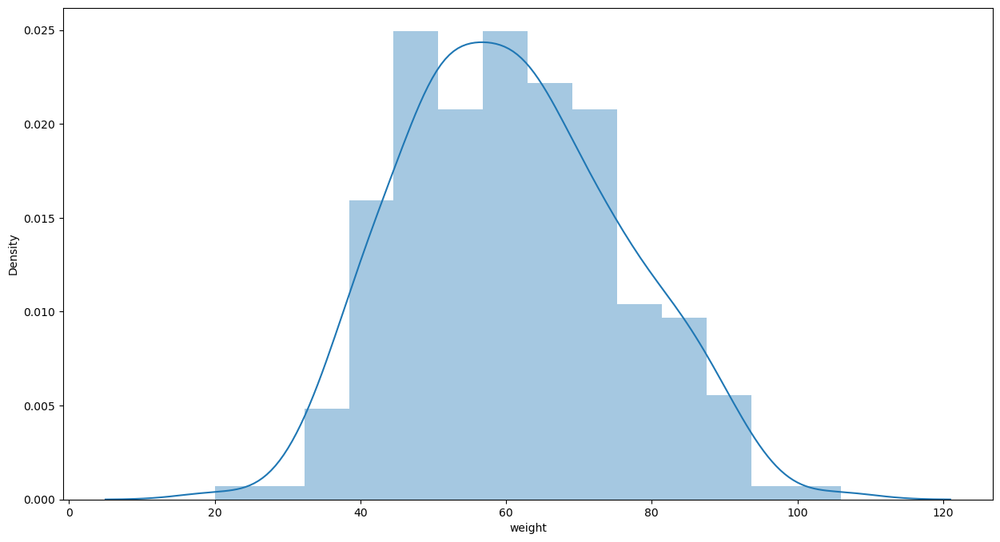

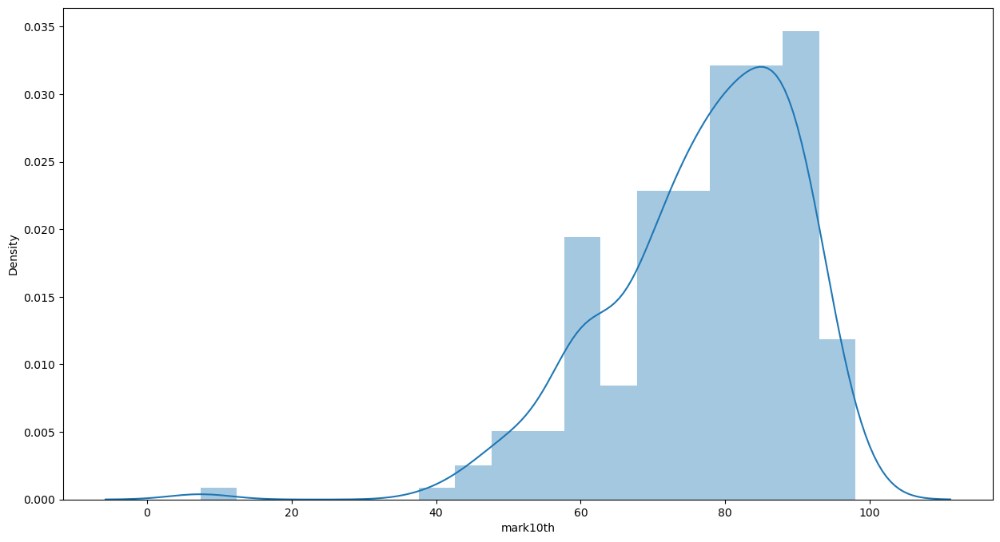

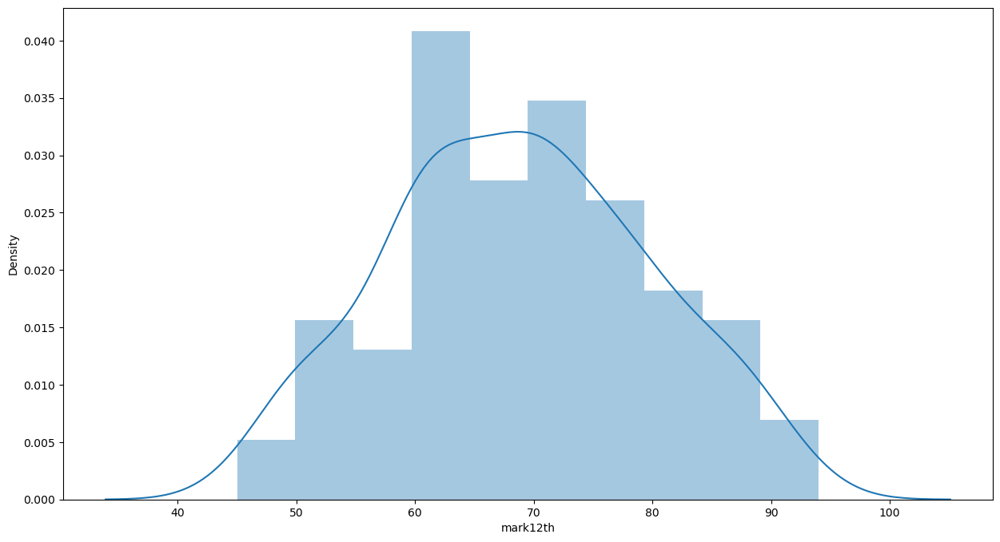

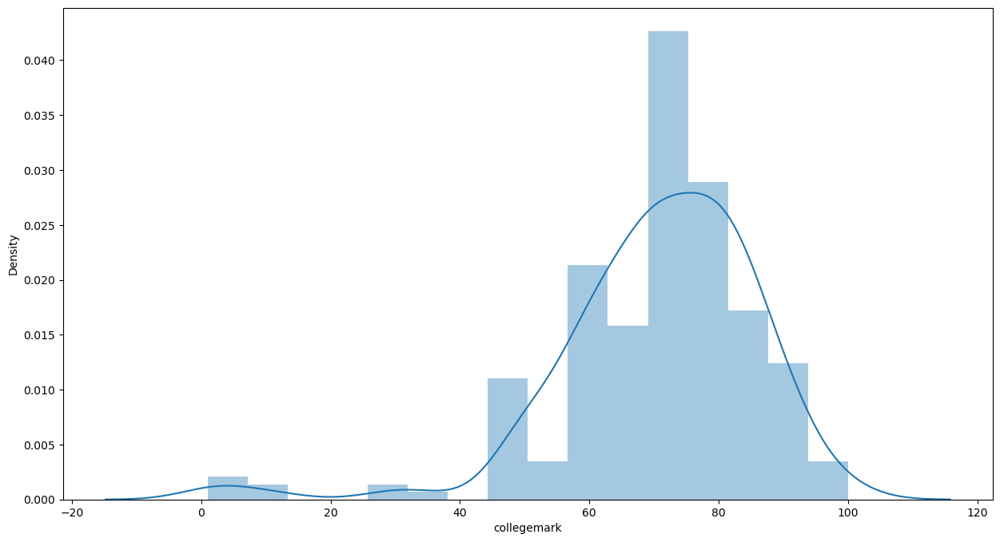

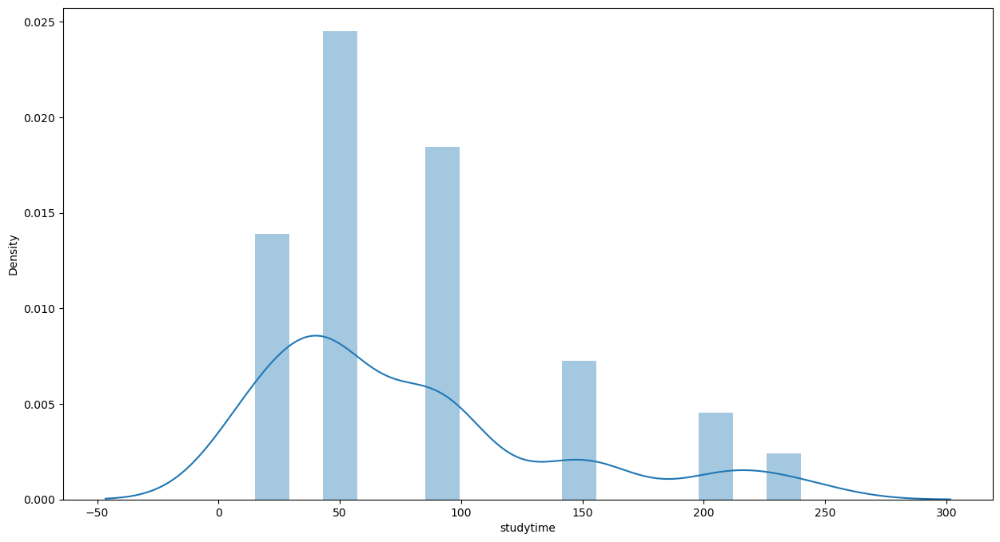

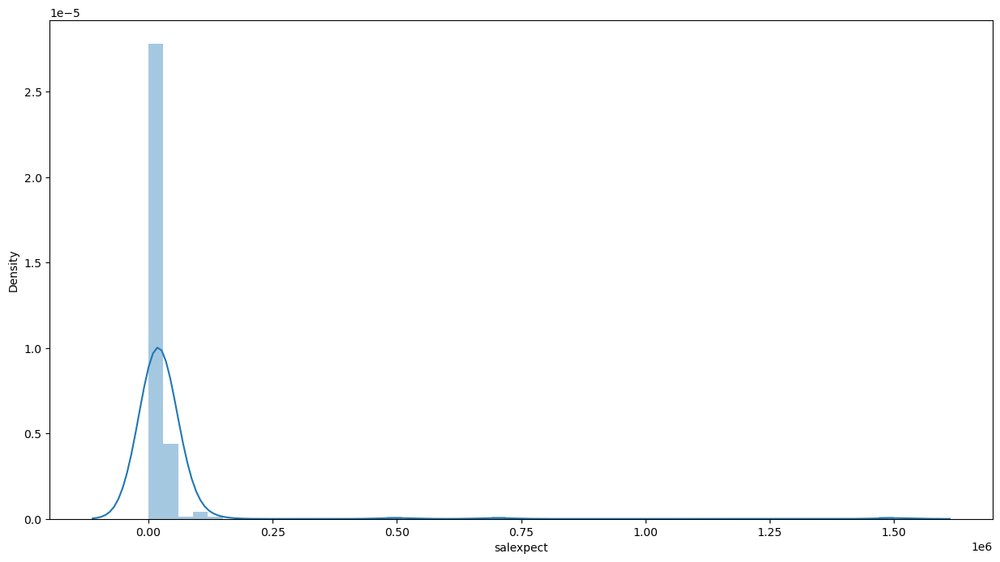

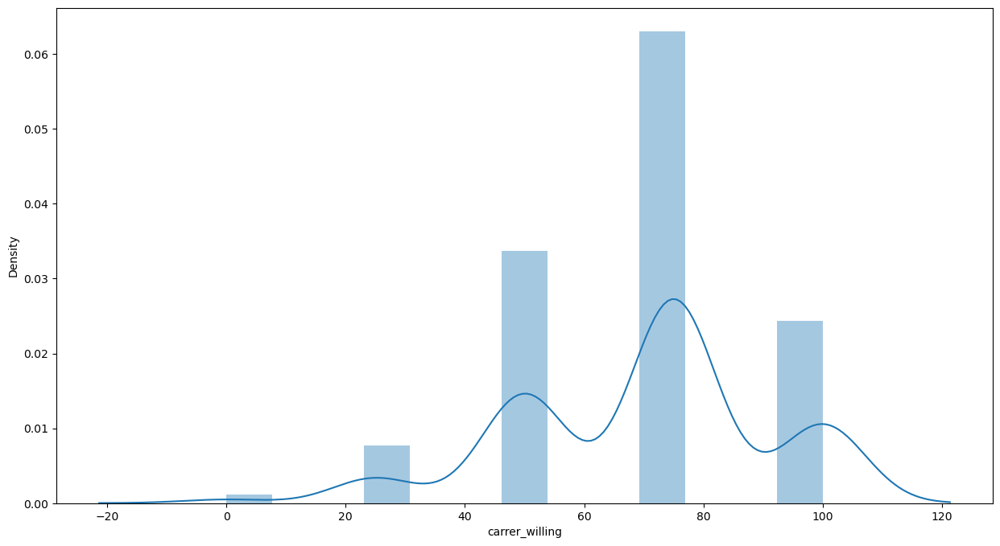

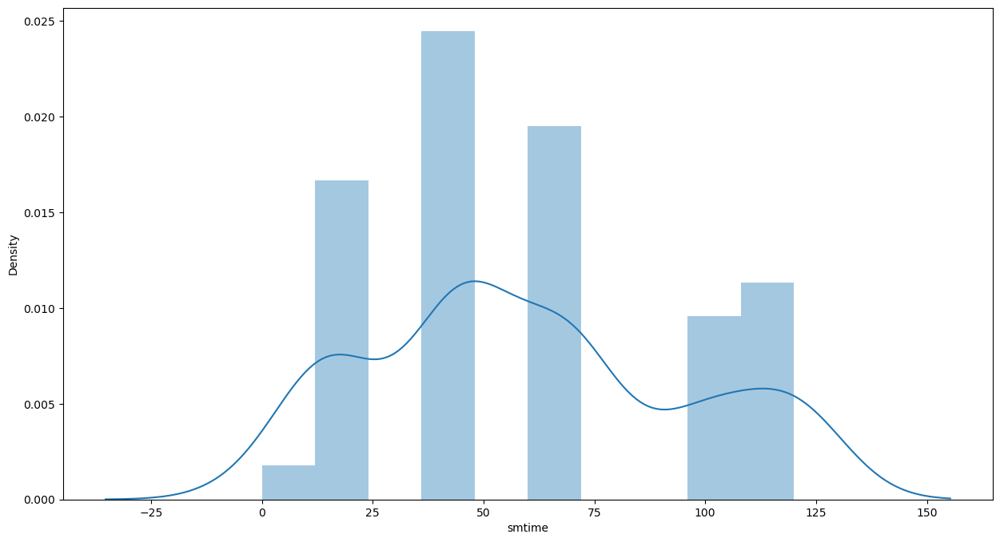

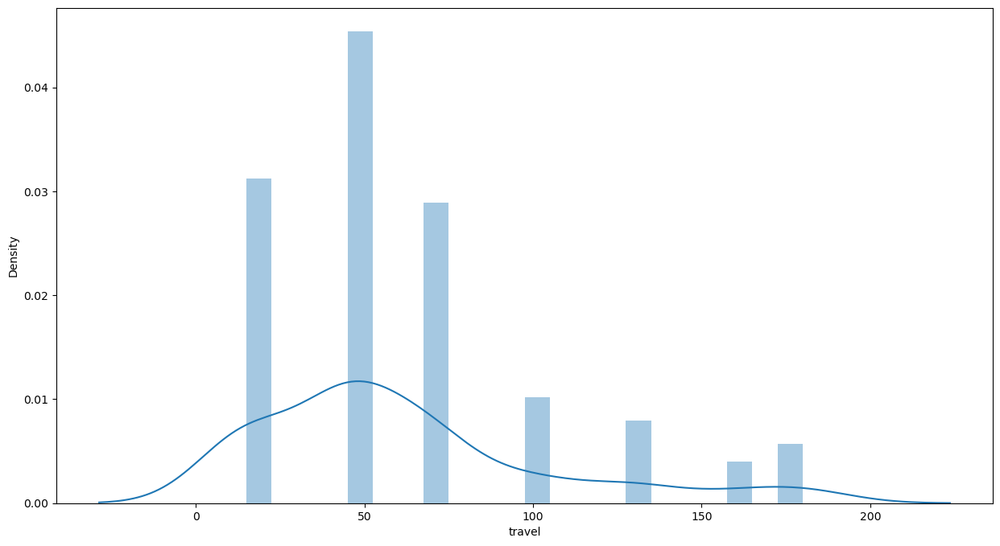

<Figure size 1500x800 with 0 Axes>

In [284]:
for column in numeric_columns:
    sns.distplot(df[column])
    plt.figure(figsize=(15,8))
plt.show()

C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating

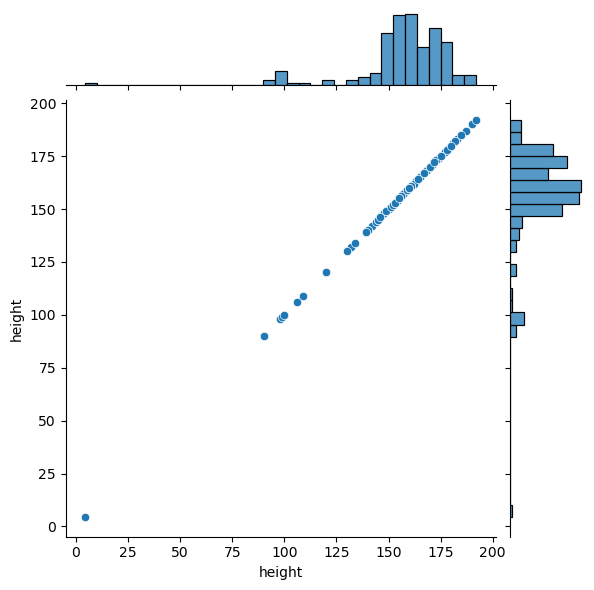

<Figure size 1500x800 with 0 Axes>

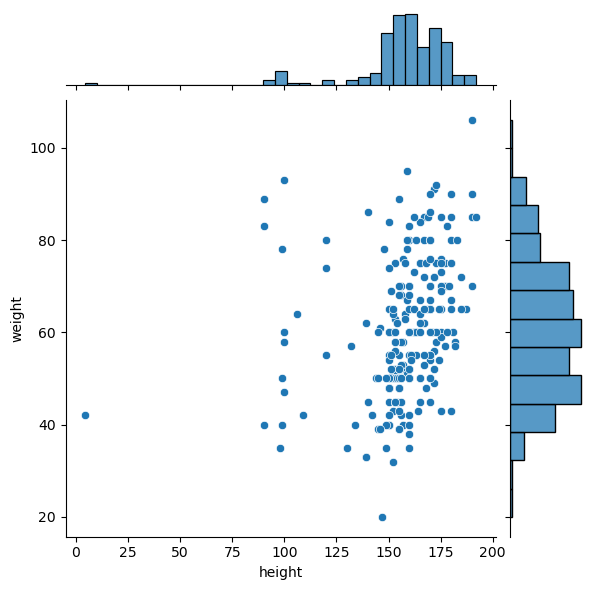

<Figure size 1500x800 with 0 Axes>

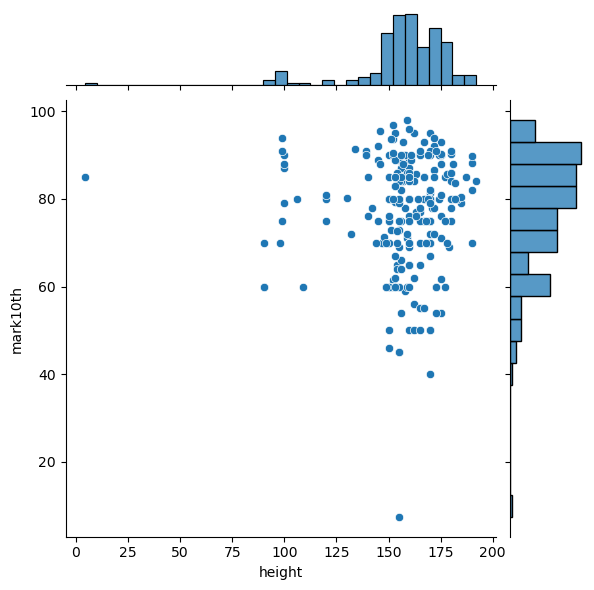

<Figure size 1500x800 with 0 Axes>

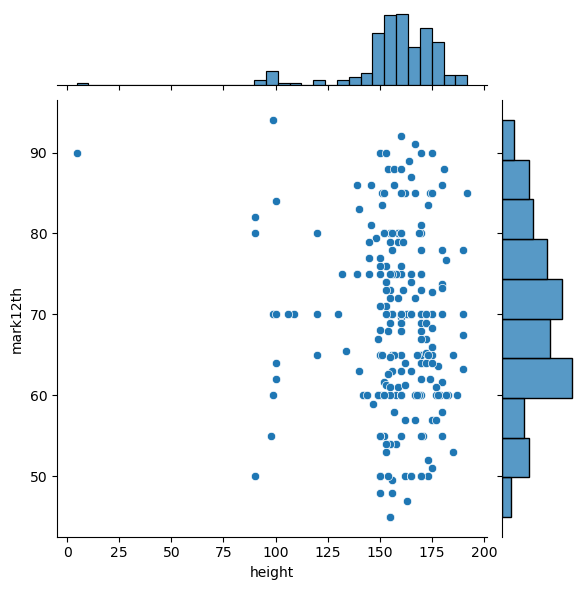

<Figure size 1500x800 with 0 Axes>

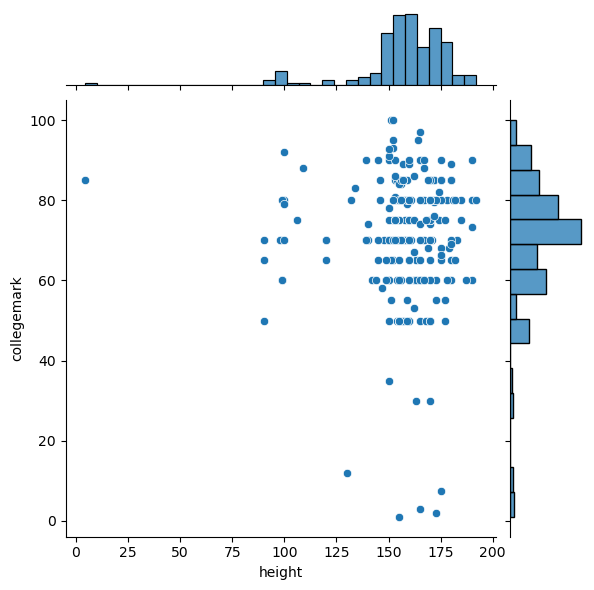

<Figure size 1500x800 with 0 Axes>

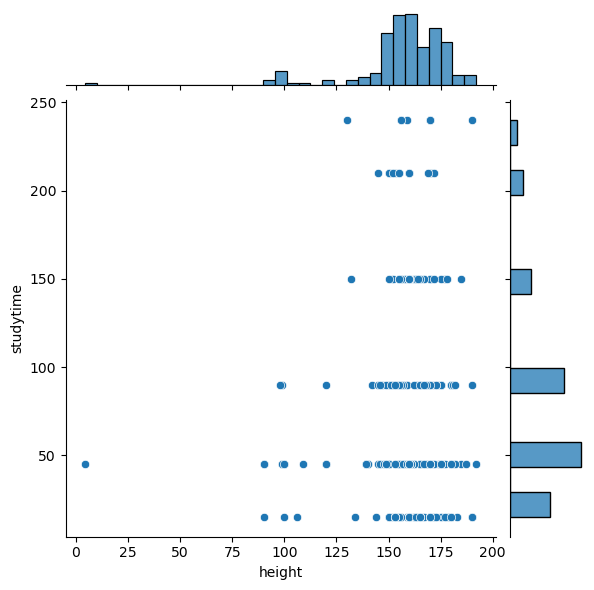

<Figure size 1500x800 with 0 Axes>

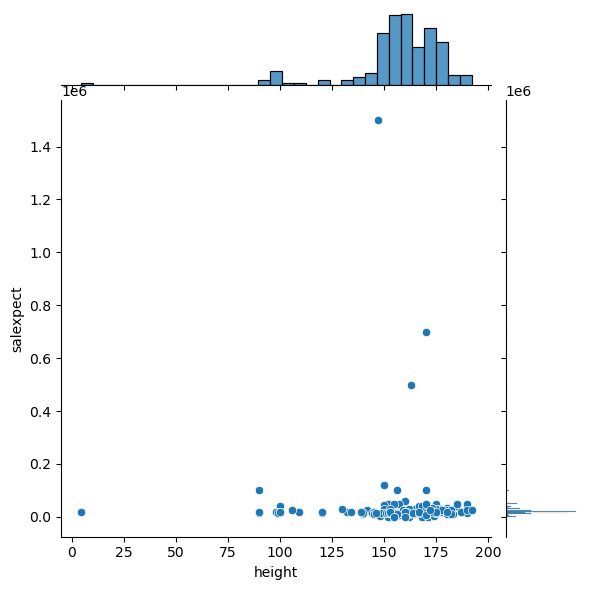

<Figure size 1500x800 with 0 Axes>

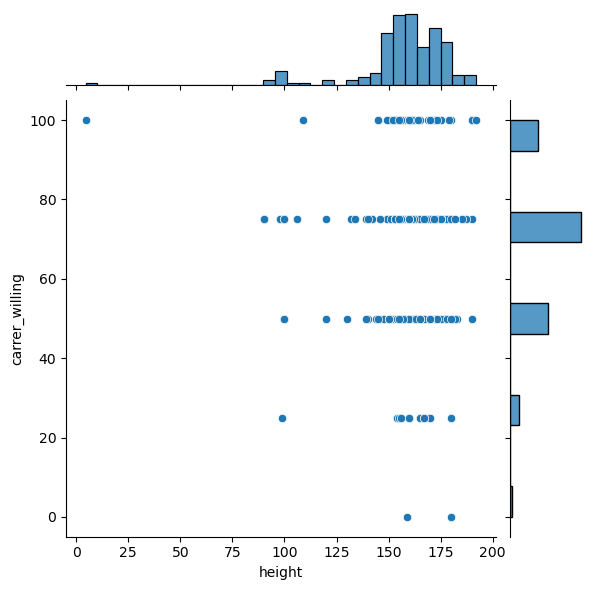

<Figure size 1500x800 with 0 Axes>

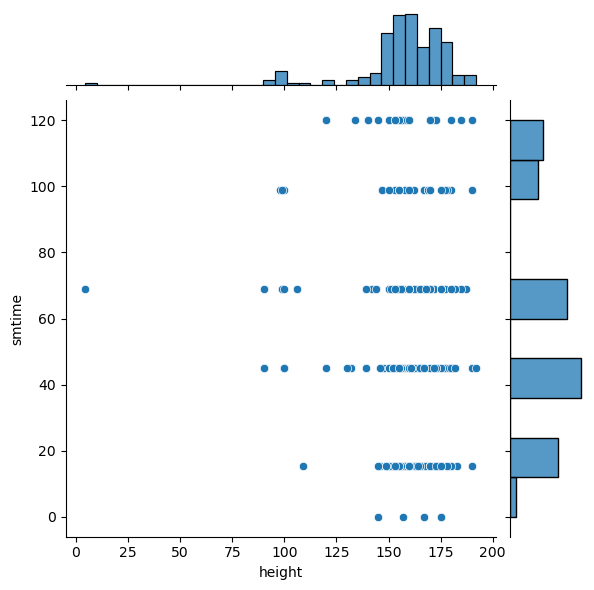

<Figure size 1500x800 with 0 Axes>

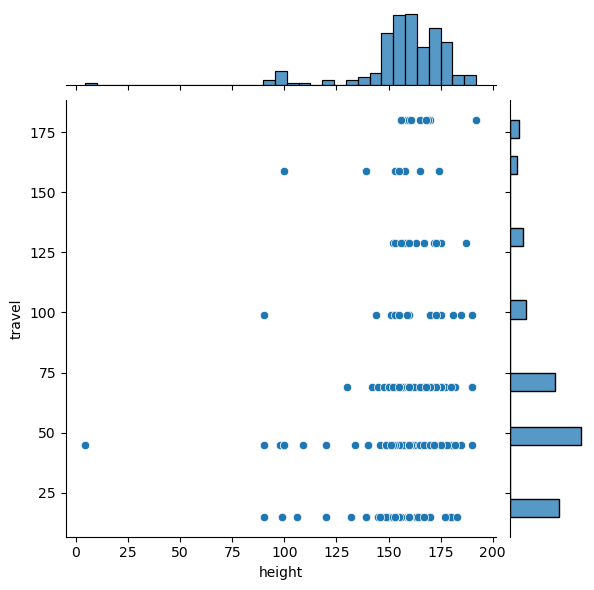

<Figure size 1500x800 with 0 Axes>

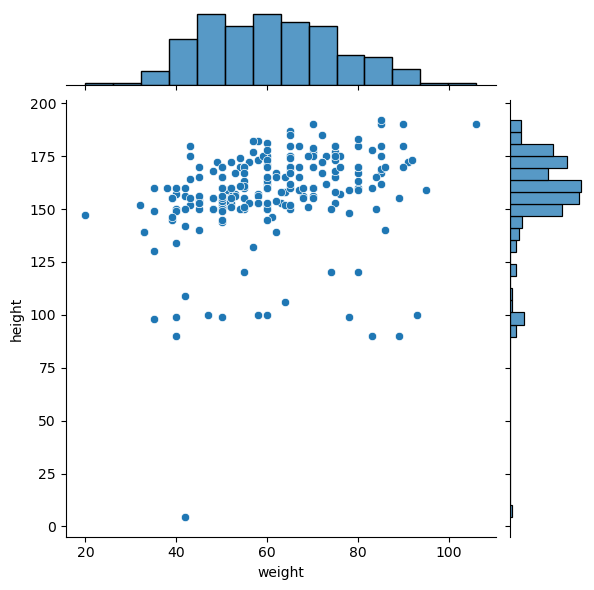

<Figure size 1500x800 with 0 Axes>

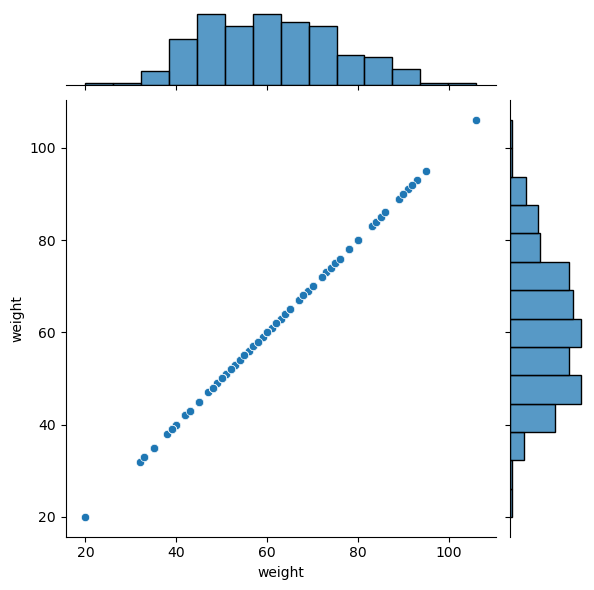

<Figure size 1500x800 with 0 Axes>

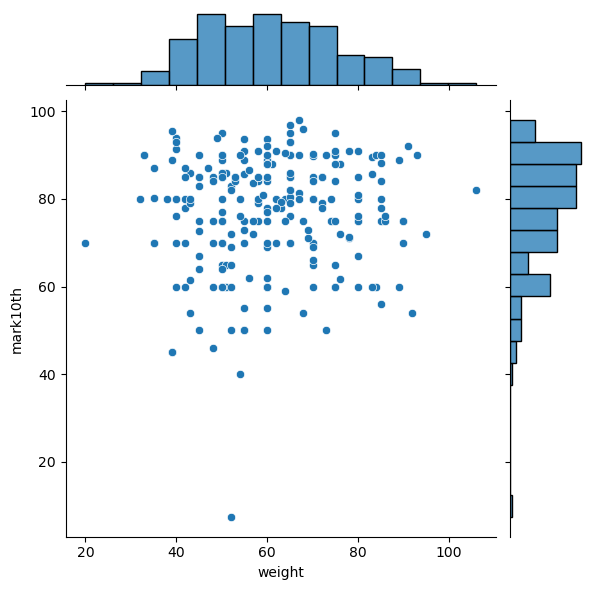

<Figure size 1500x800 with 0 Axes>

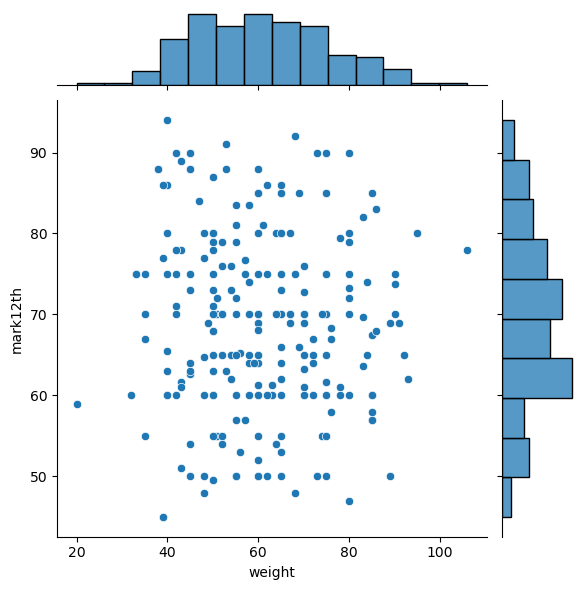

<Figure size 1500x800 with 0 Axes>

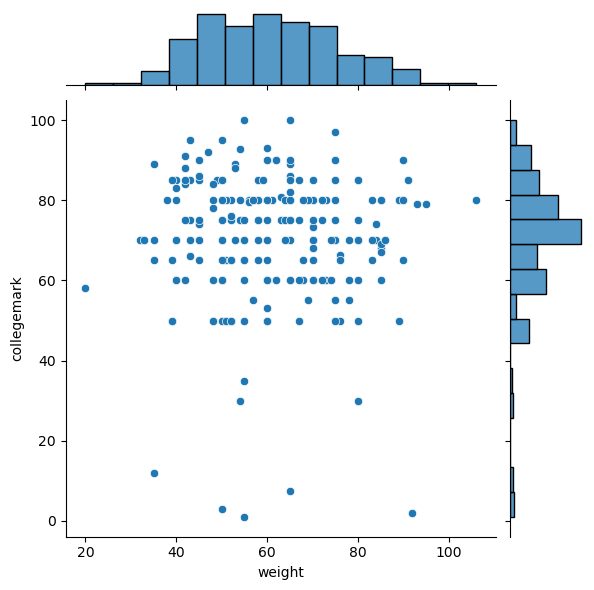

<Figure size 1500x800 with 0 Axes>

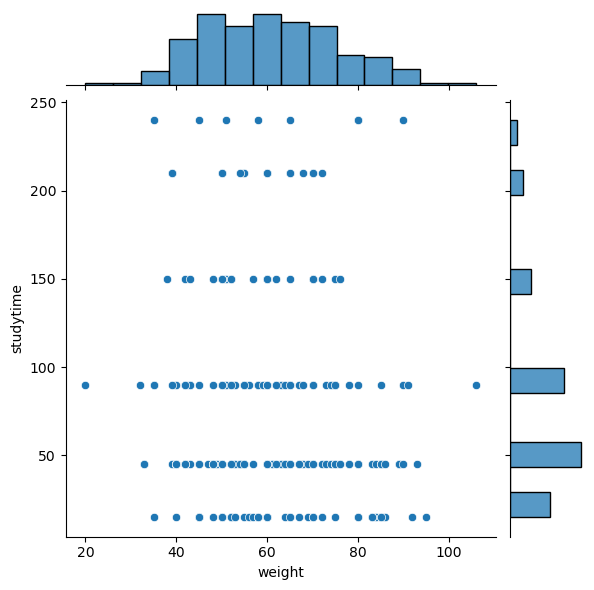

<Figure size 1500x800 with 0 Axes>

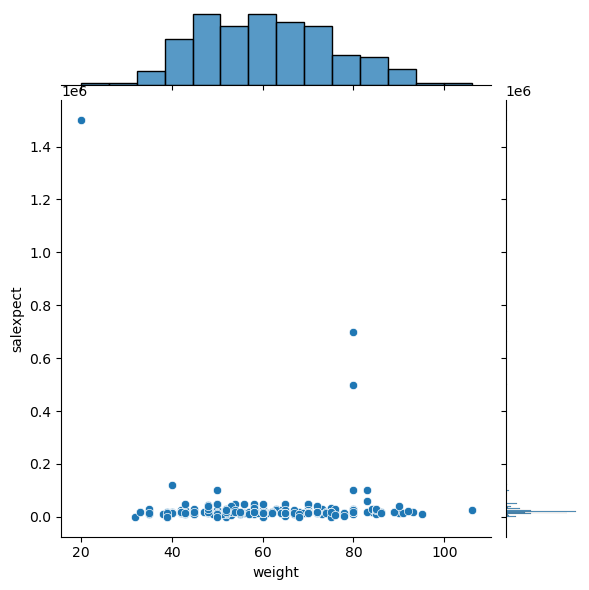

<Figure size 1500x800 with 0 Axes>

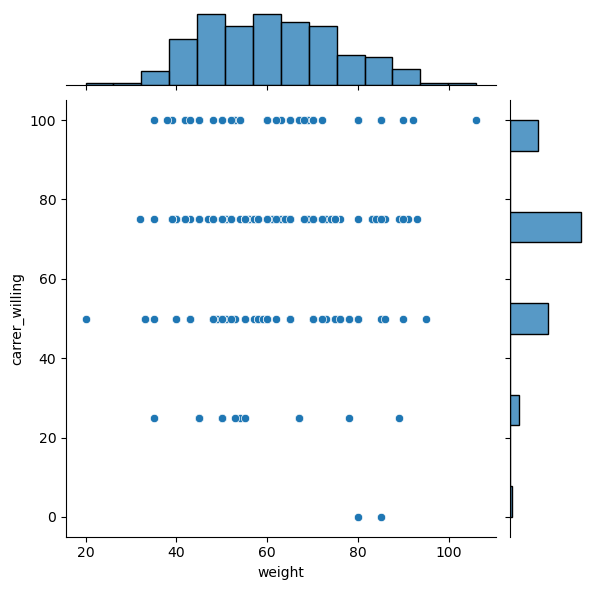

<Figure size 1500x800 with 0 Axes>

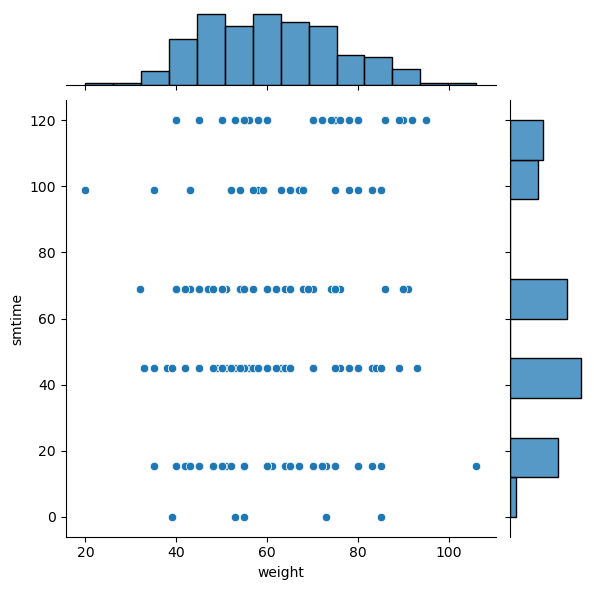

<Figure size 1500x800 with 0 Axes>

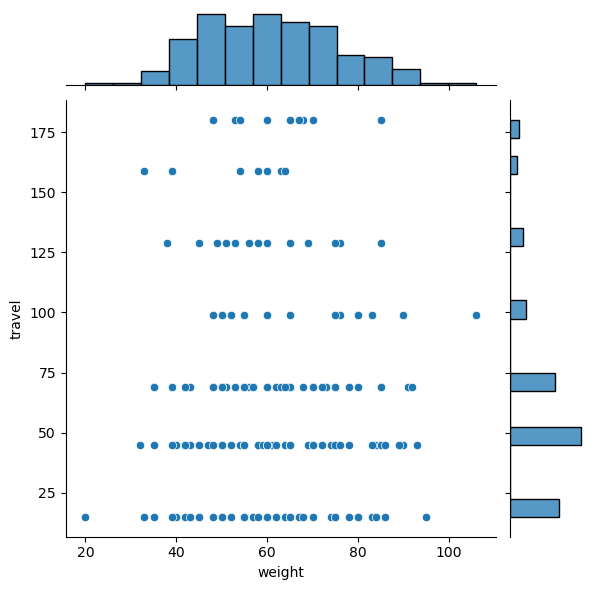

<Figure size 1500x800 with 0 Axes>

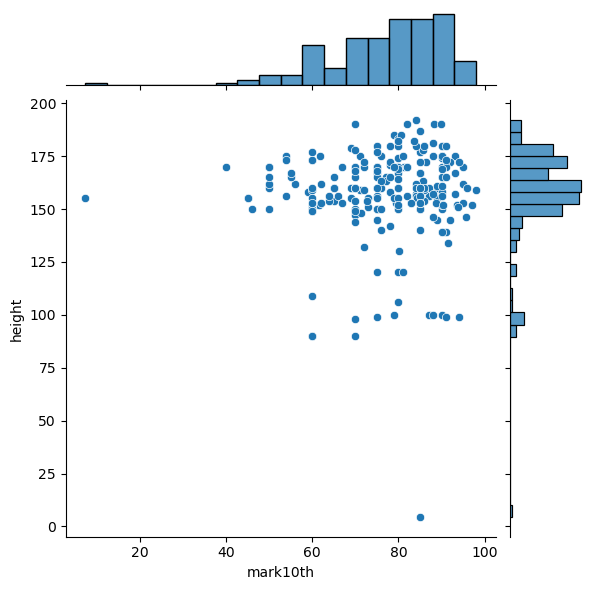

<Figure size 1500x800 with 0 Axes>

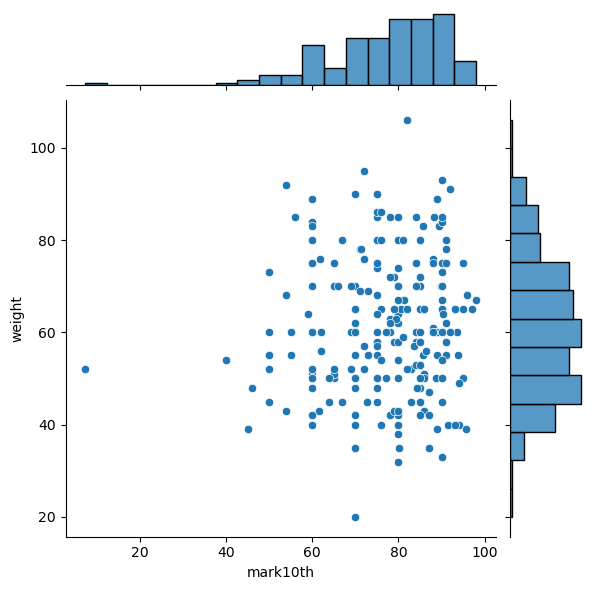

<Figure size 1500x800 with 0 Axes>

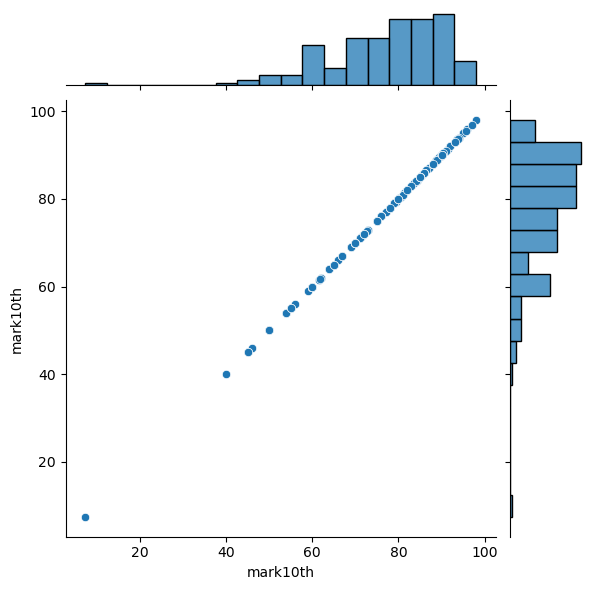

<Figure size 1500x800 with 0 Axes>

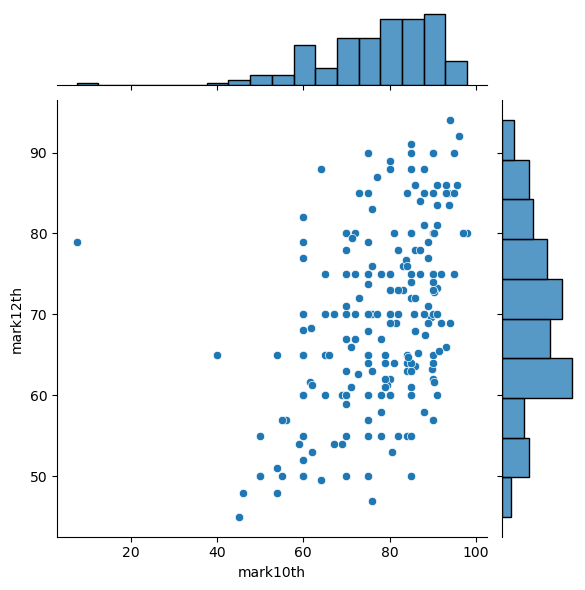

<Figure size 1500x800 with 0 Axes>

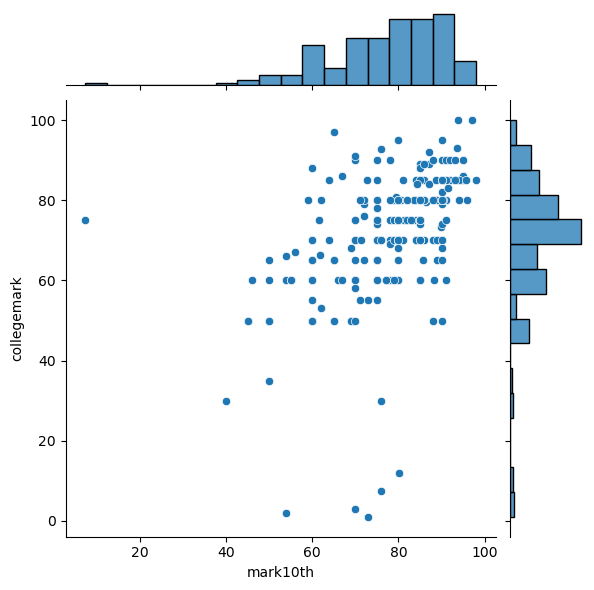

<Figure size 1500x800 with 0 Axes>

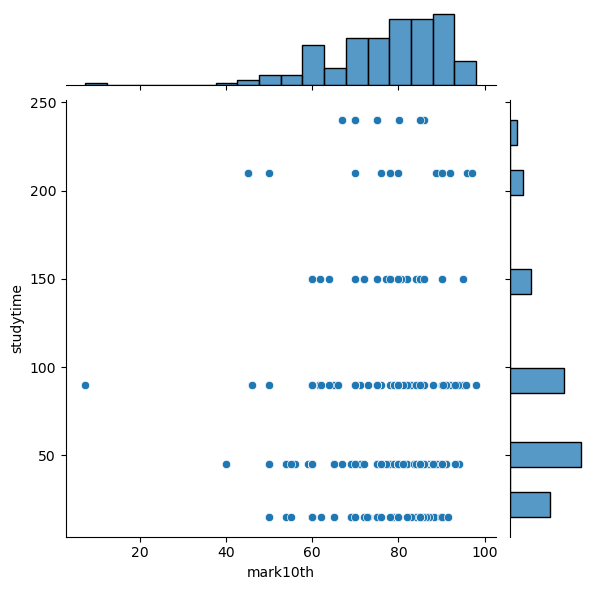

<Figure size 1500x800 with 0 Axes>

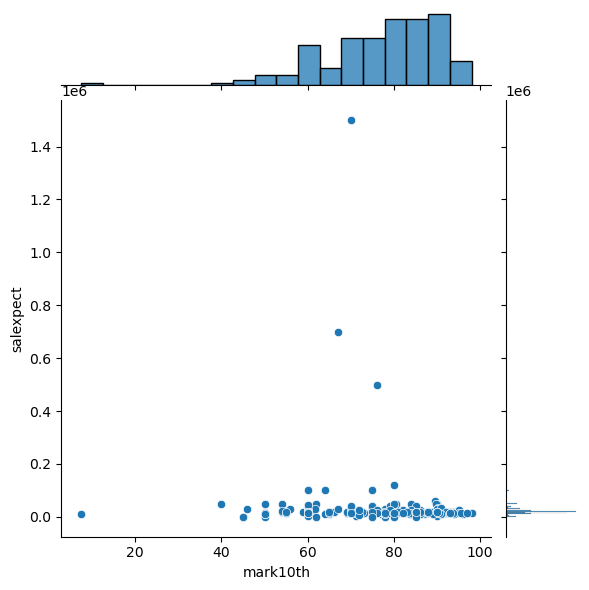

<Figure size 1500x800 with 0 Axes>

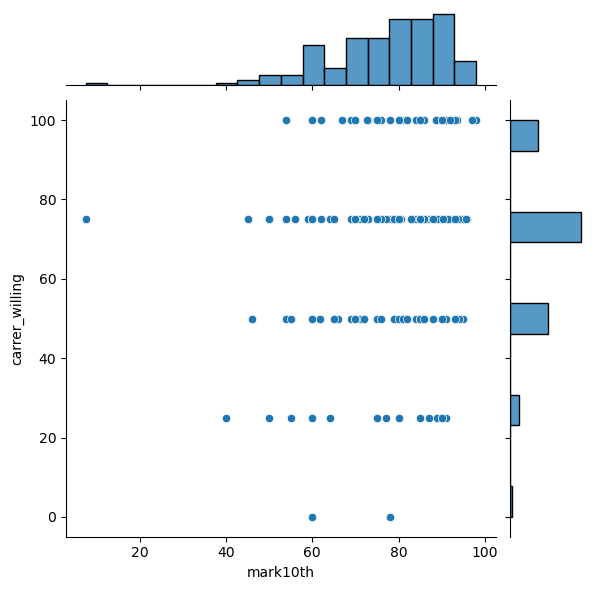

<Figure size 1500x800 with 0 Axes>

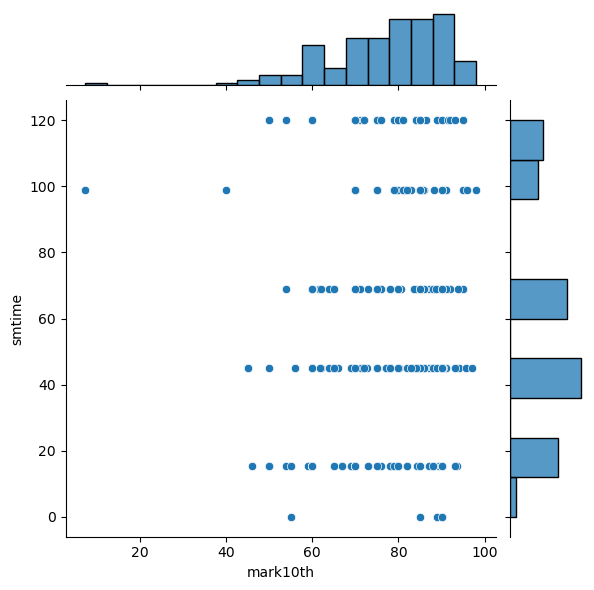

<Figure size 1500x800 with 0 Axes>

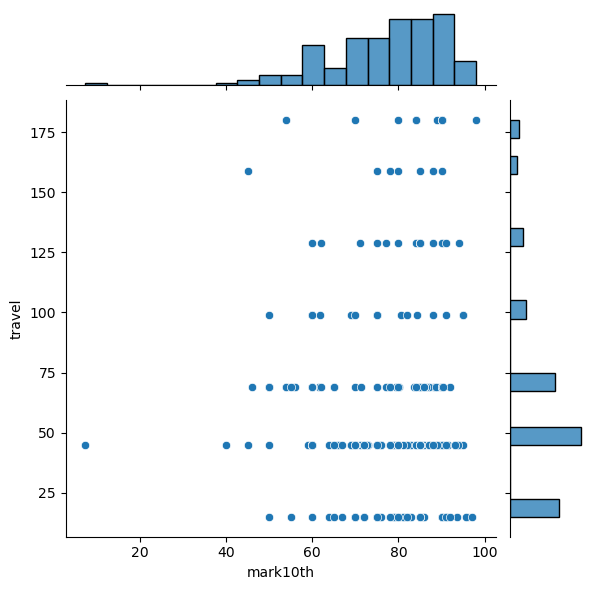

<Figure size 1500x800 with 0 Axes>

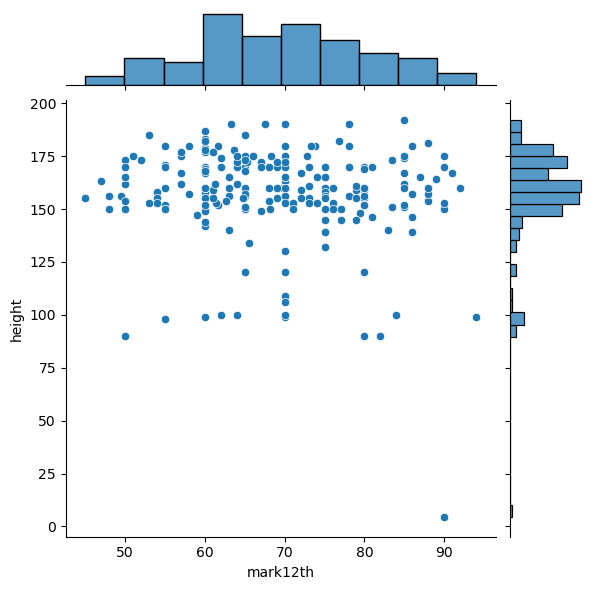

<Figure size 1500x800 with 0 Axes>

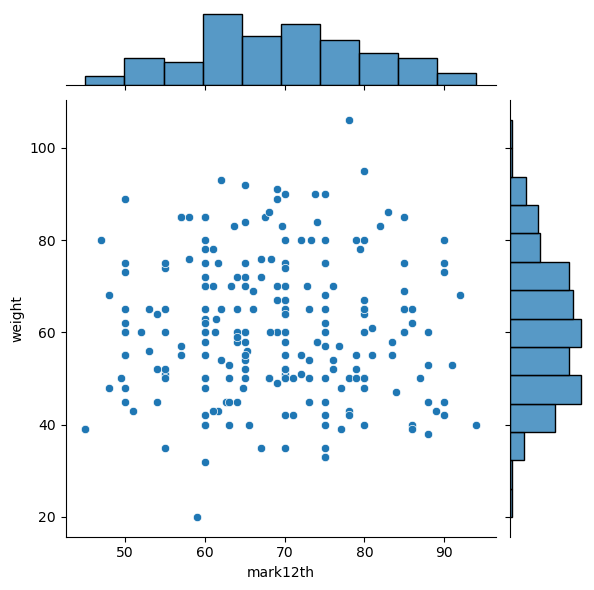

<Figure size 1500x800 with 0 Axes>

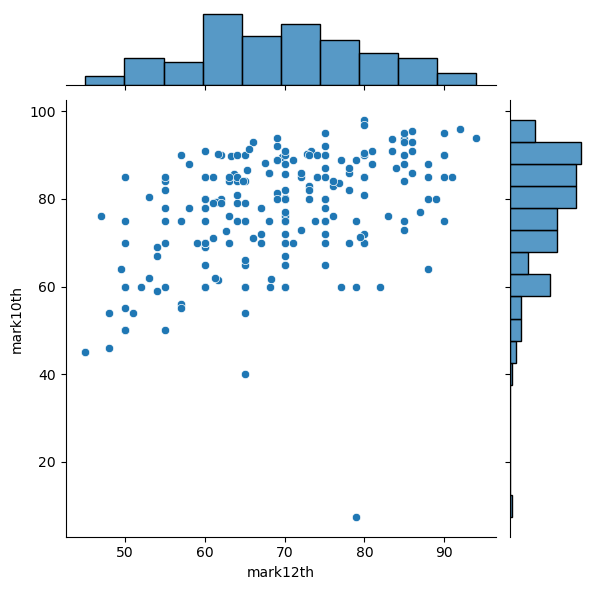

<Figure size 1500x800 with 0 Axes>

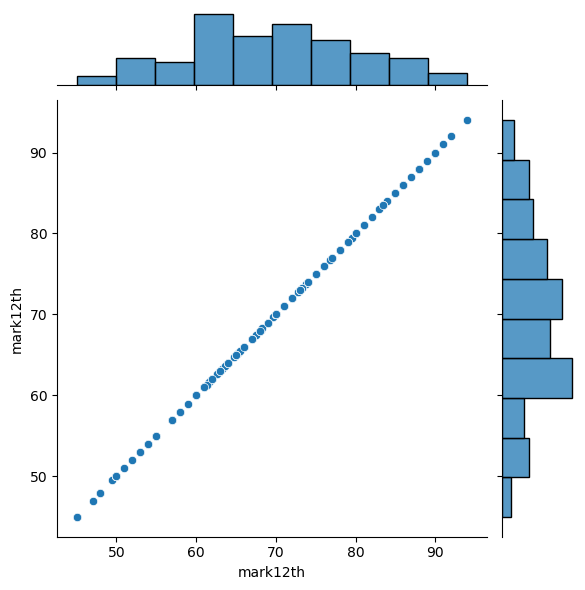

<Figure size 1500x800 with 0 Axes>

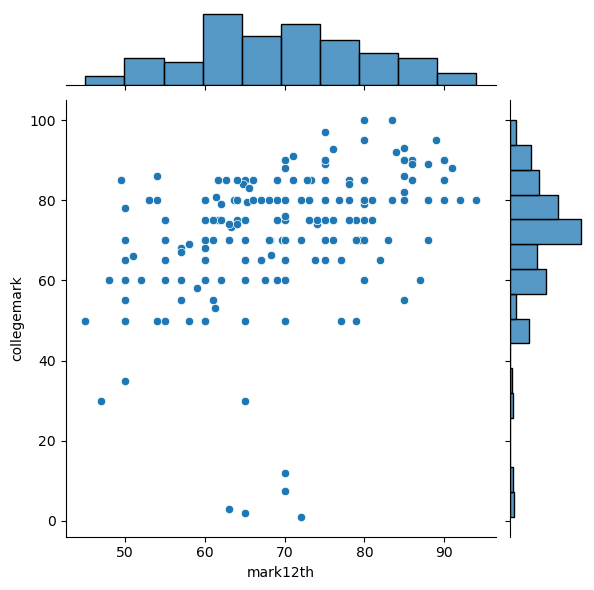

<Figure size 1500x800 with 0 Axes>

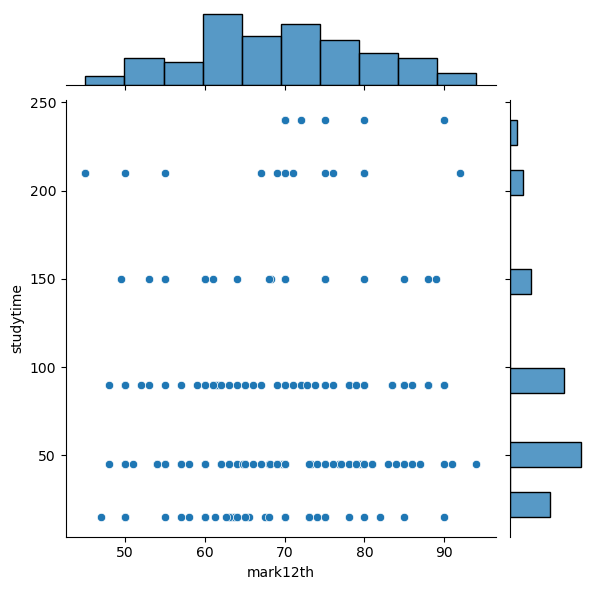

<Figure size 1500x800 with 0 Axes>

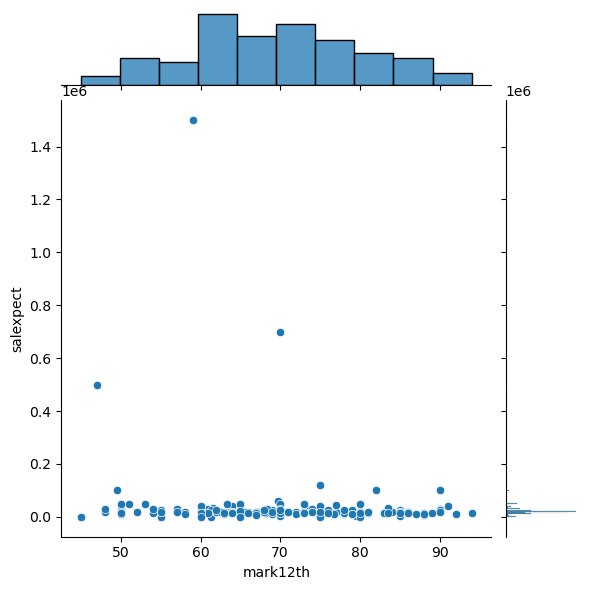

<Figure size 1500x800 with 0 Axes>

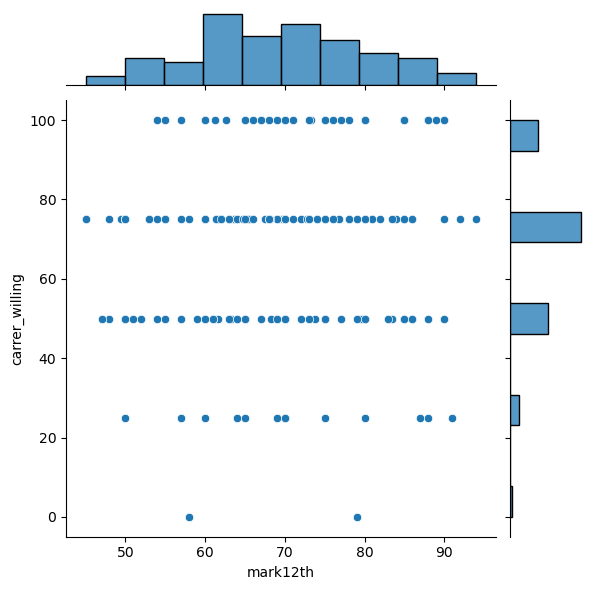

<Figure size 1500x800 with 0 Axes>

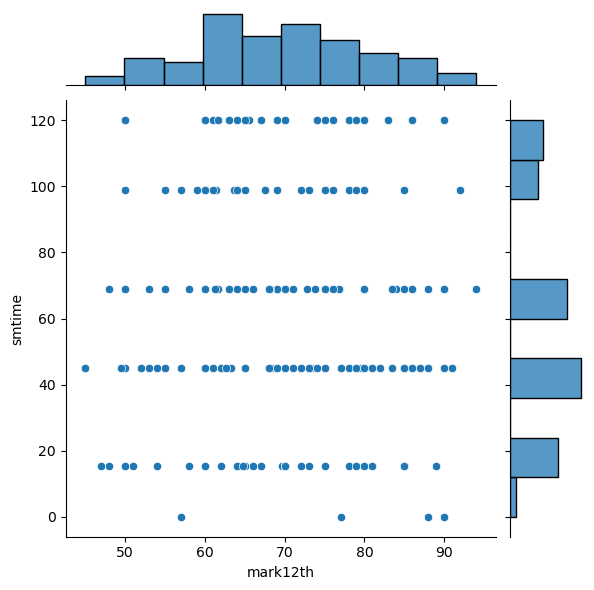

<Figure size 1500x800 with 0 Axes>

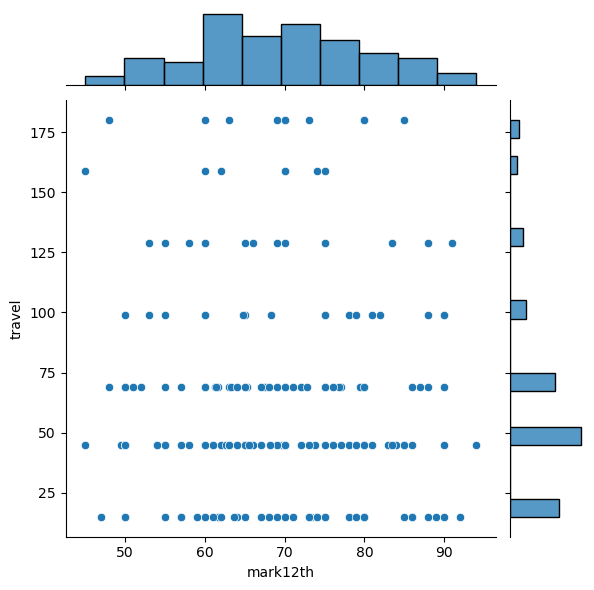

<Figure size 1500x800 with 0 Axes>

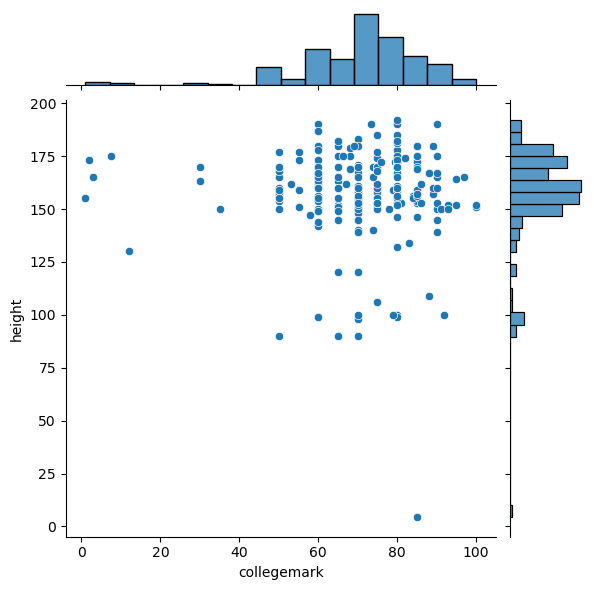

<Figure size 1500x800 with 0 Axes>

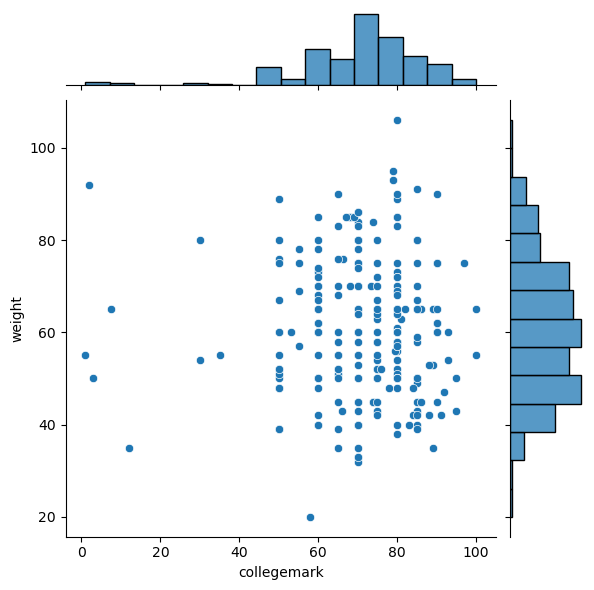

<Figure size 1500x800 with 0 Axes>

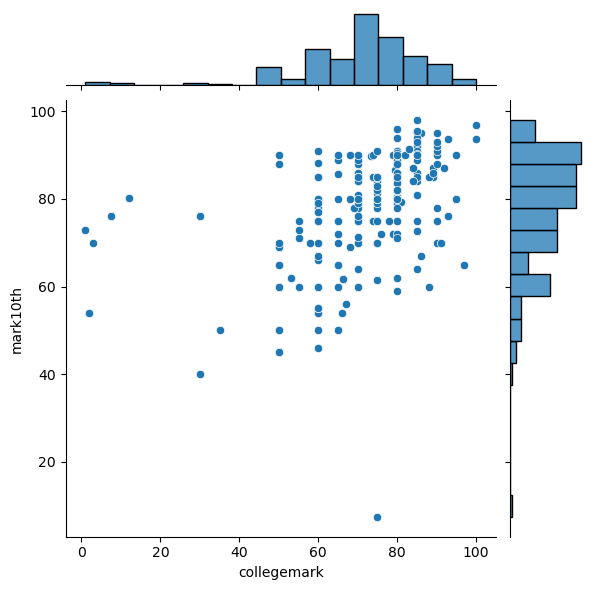

<Figure size 1500x800 with 0 Axes>

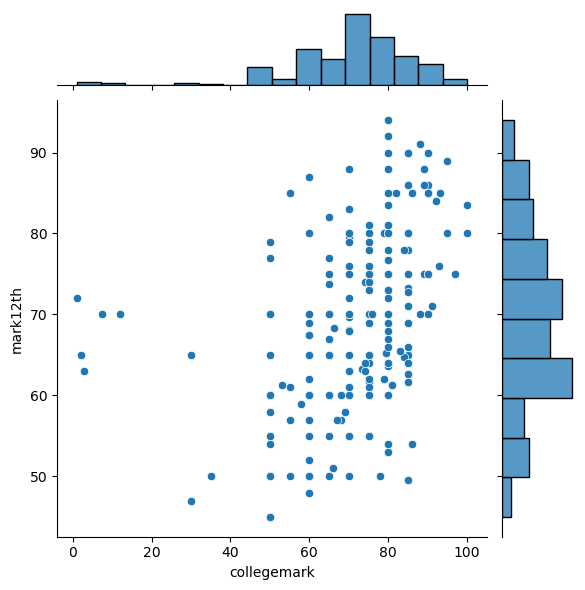

<Figure size 1500x800 with 0 Axes>

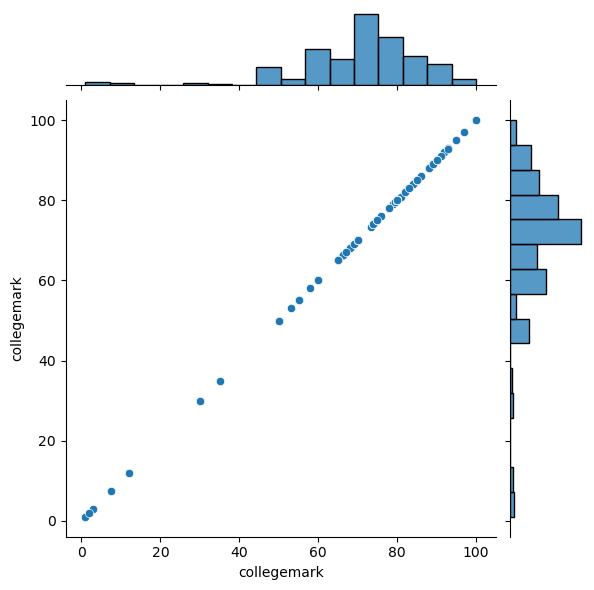

<Figure size 1500x800 with 0 Axes>

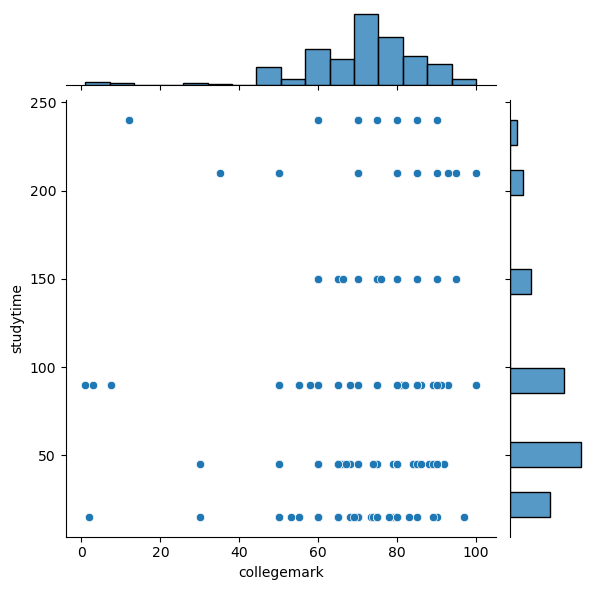

<Figure size 1500x800 with 0 Axes>

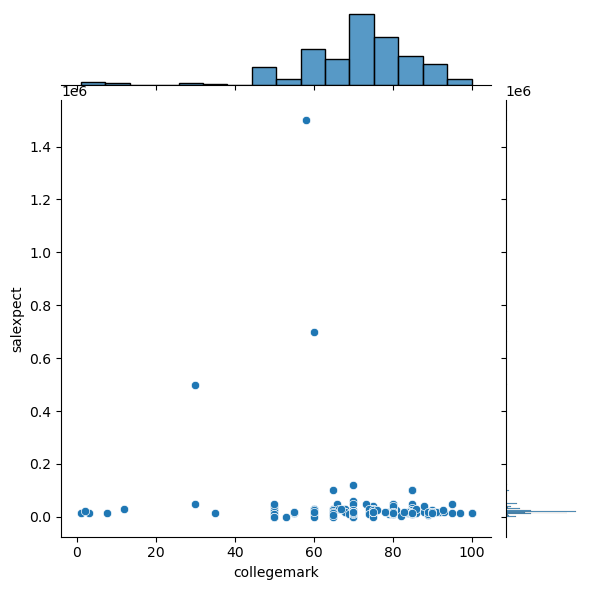

<Figure size 1500x800 with 0 Axes>

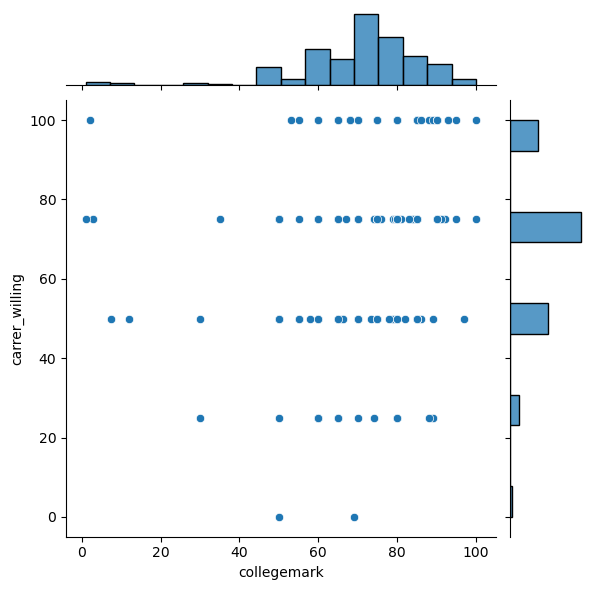

<Figure size 1500x800 with 0 Axes>

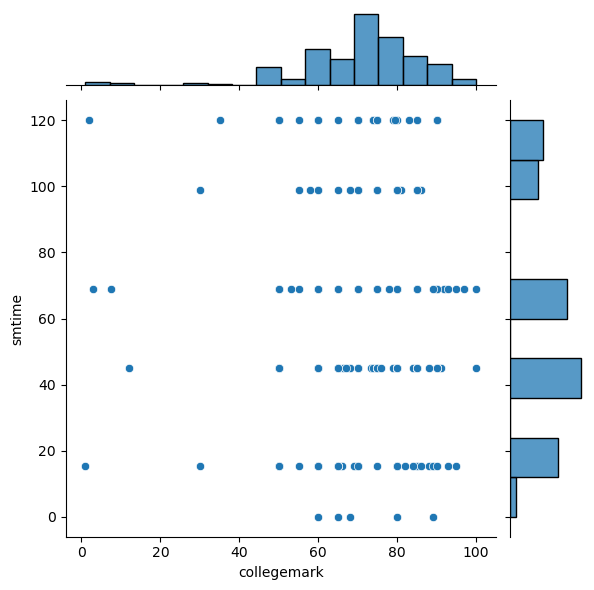

<Figure size 1500x800 with 0 Axes>

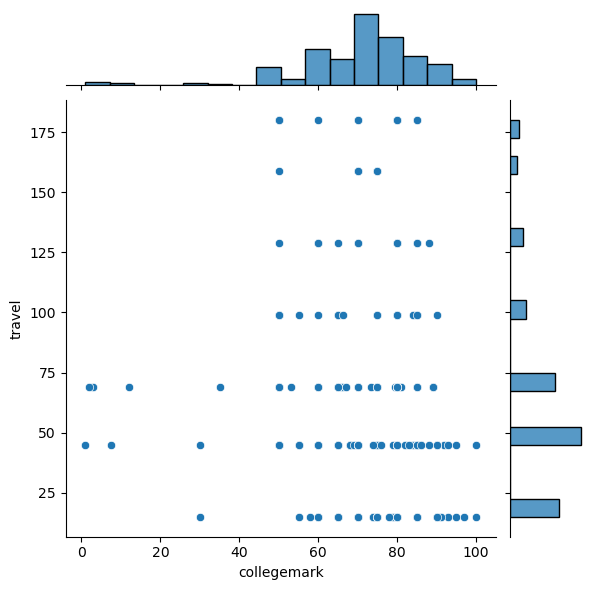

<Figure size 1500x800 with 0 Axes>

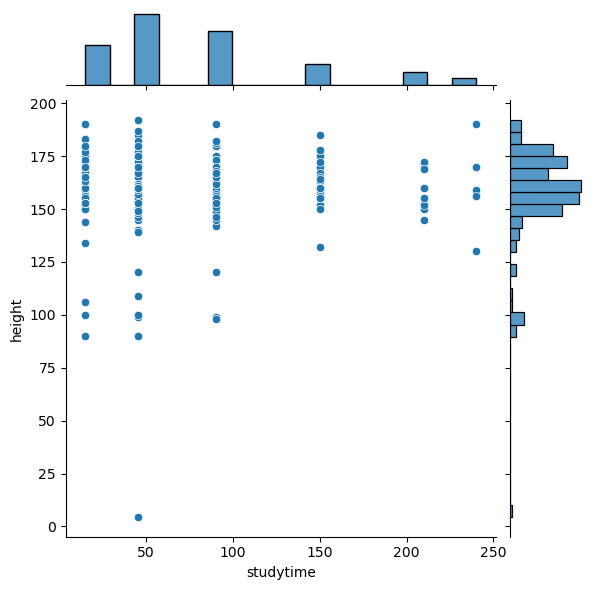

<Figure size 1500x800 with 0 Axes>

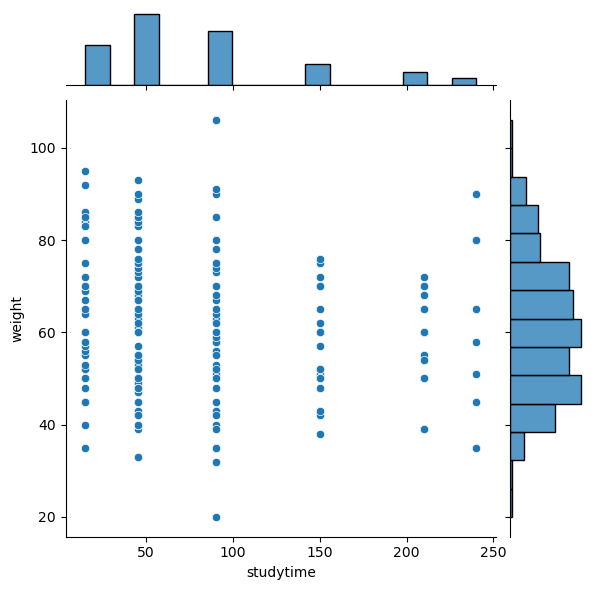

<Figure size 1500x800 with 0 Axes>

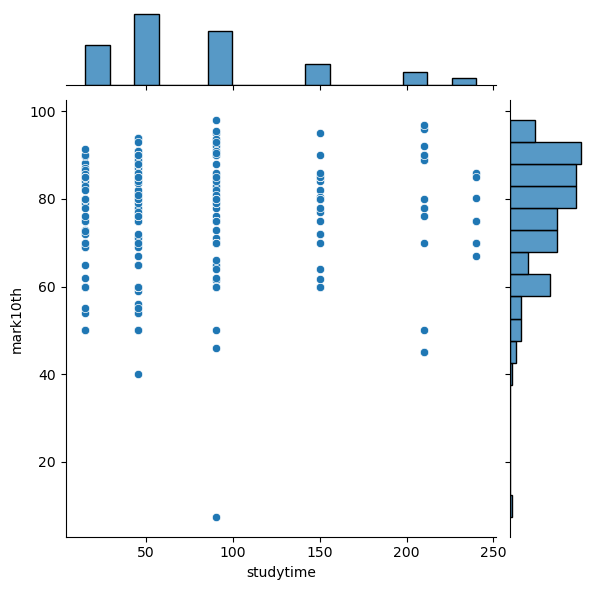

<Figure size 1500x800 with 0 Axes>

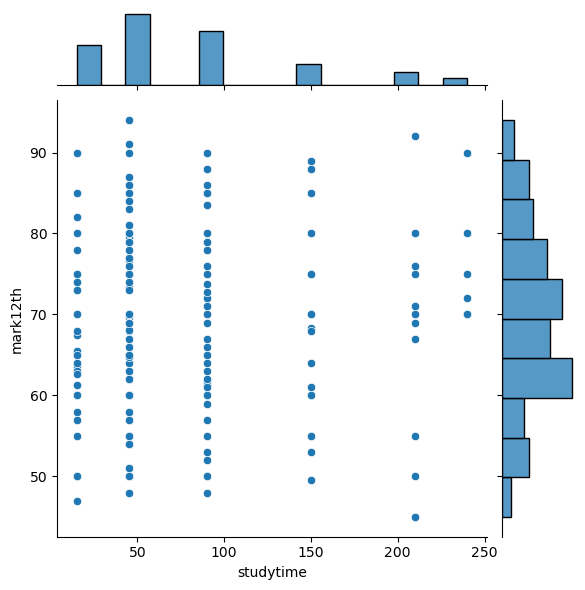

<Figure size 1500x800 with 0 Axes>

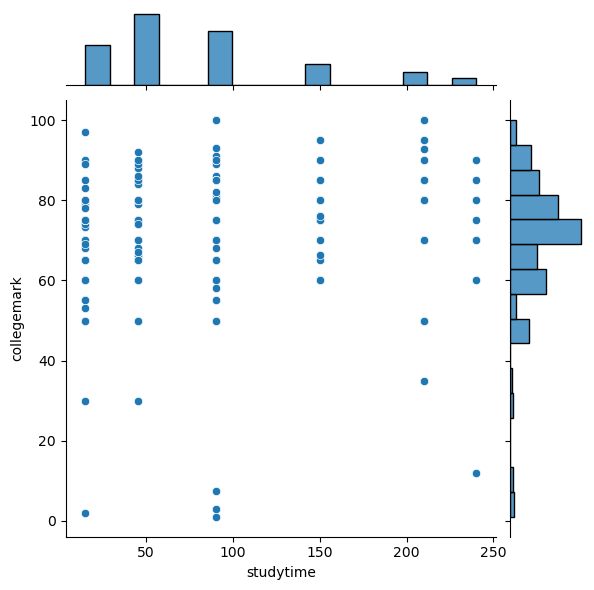

<Figure size 1500x800 with 0 Axes>

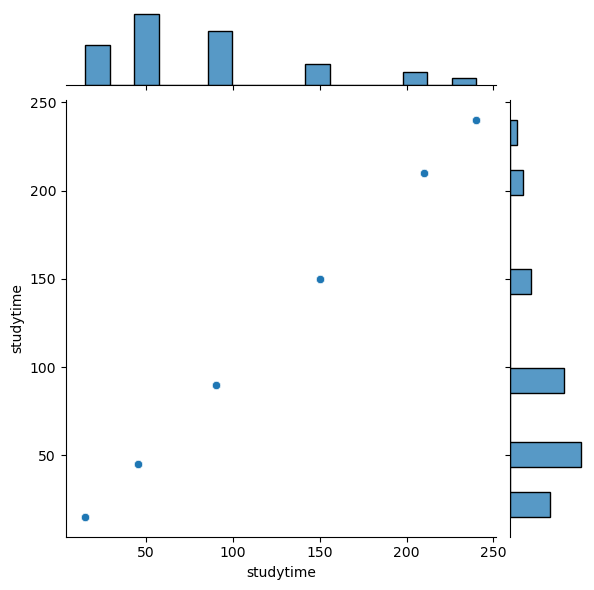

<Figure size 1500x800 with 0 Axes>

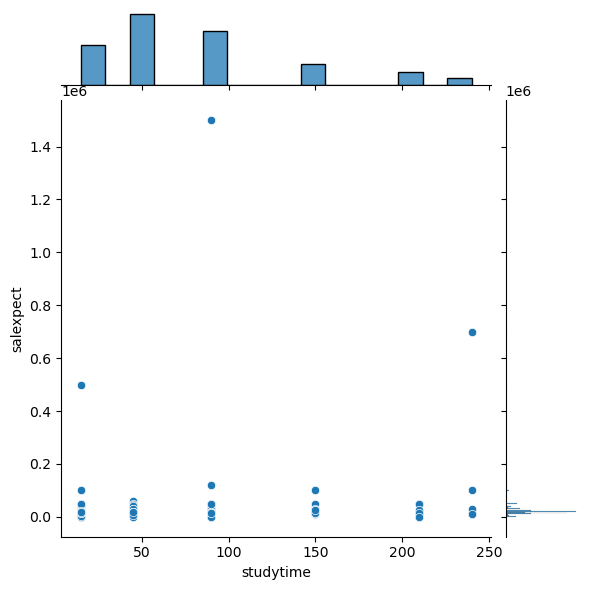

<Figure size 1500x800 with 0 Axes>

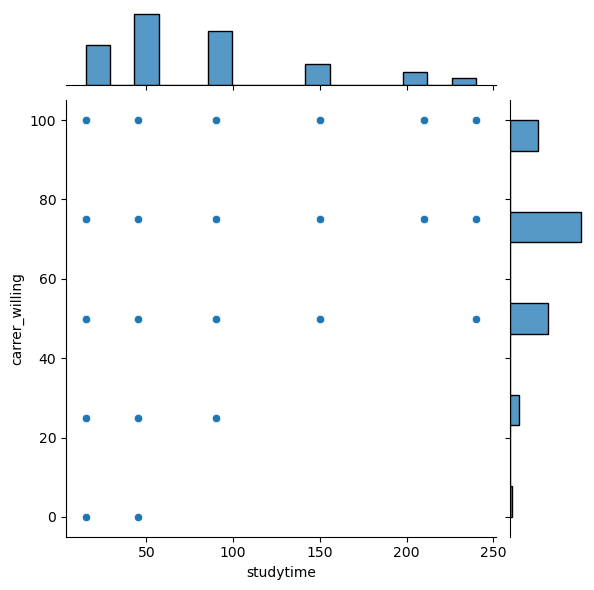

<Figure size 1500x800 with 0 Axes>

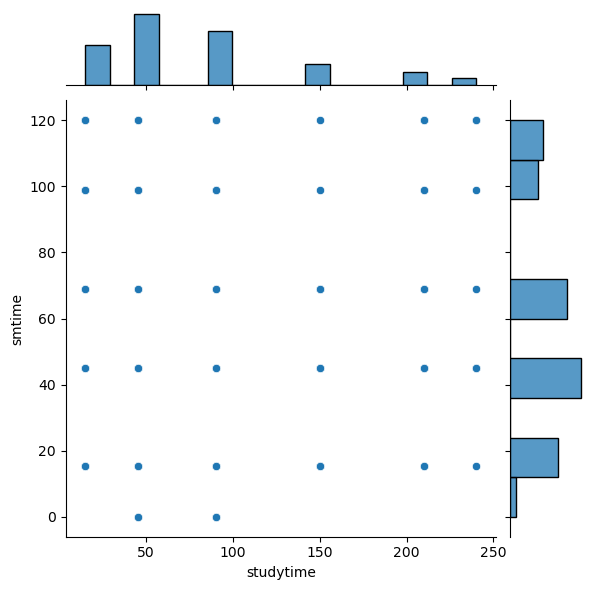

<Figure size 1500x800 with 0 Axes>

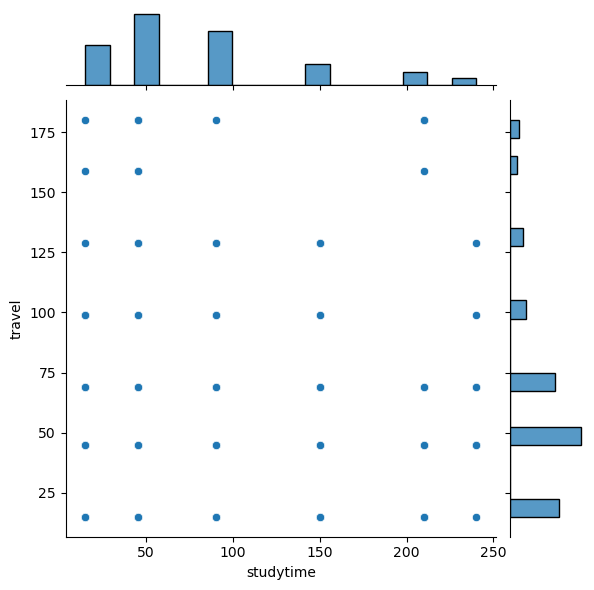

<Figure size 1500x800 with 0 Axes>

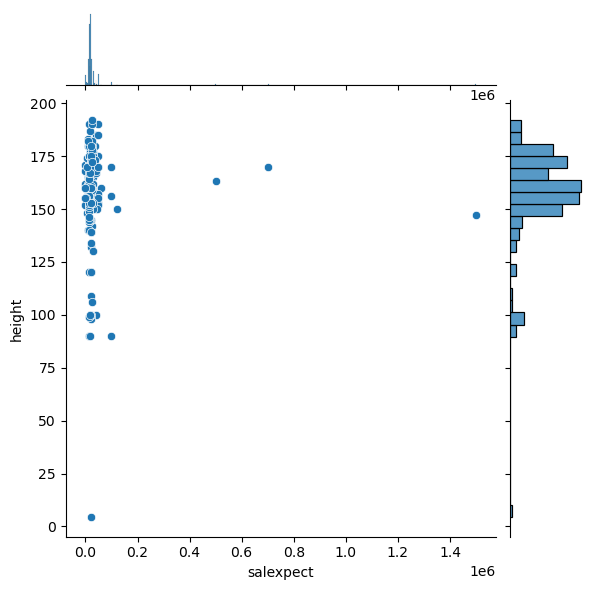

<Figure size 1500x800 with 0 Axes>

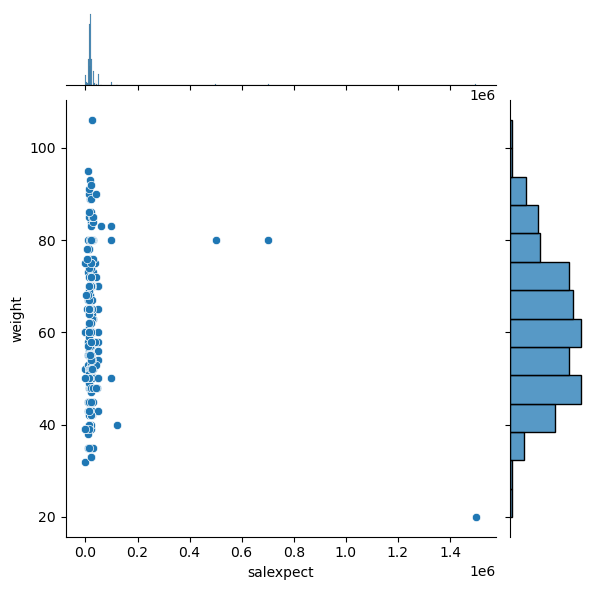

<Figure size 1500x800 with 0 Axes>

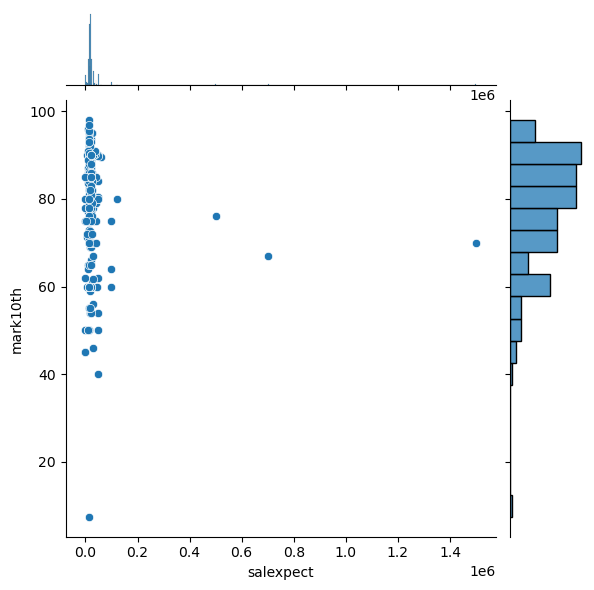

<Figure size 1500x800 with 0 Axes>

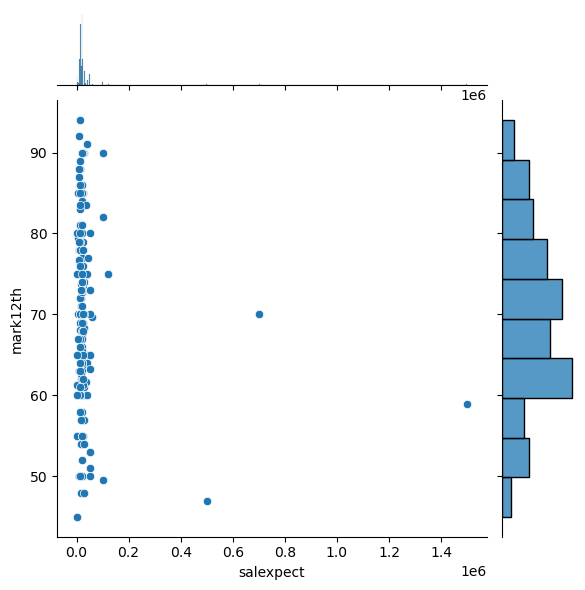

<Figure size 1500x800 with 0 Axes>

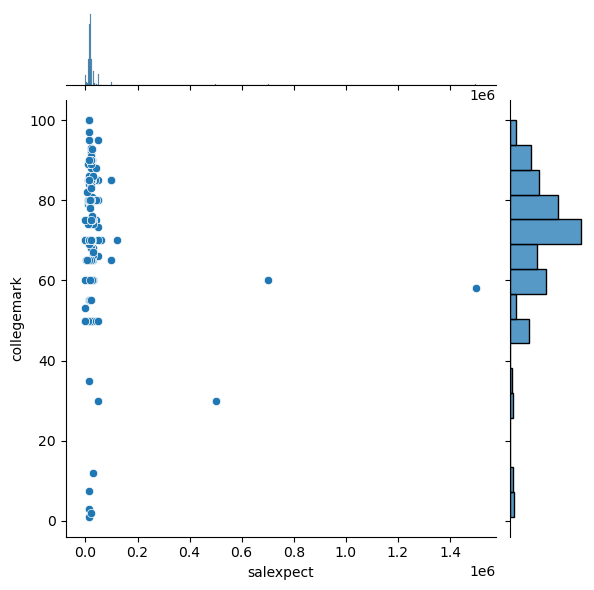

<Figure size 1500x800 with 0 Axes>

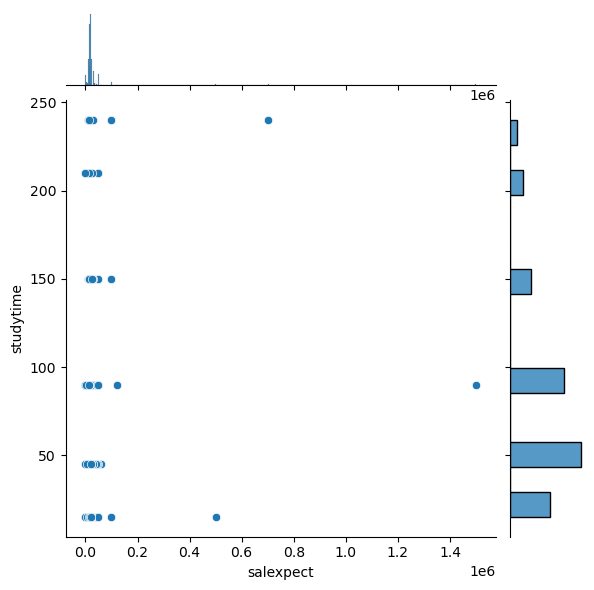

<Figure size 1500x800 with 0 Axes>

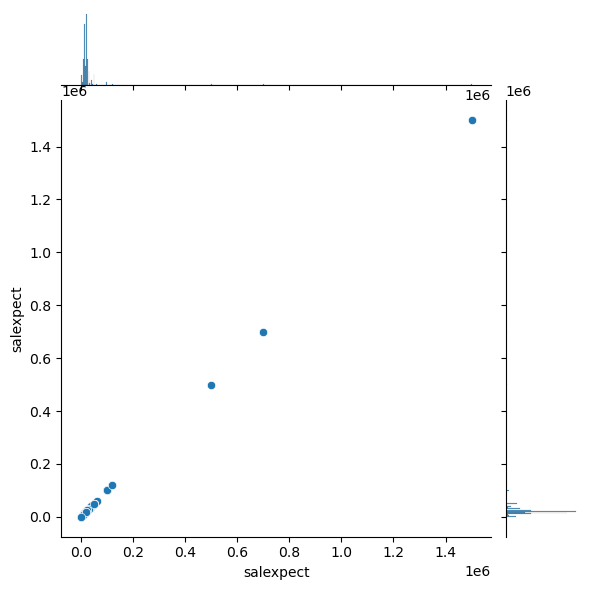

<Figure size 1500x800 with 0 Axes>

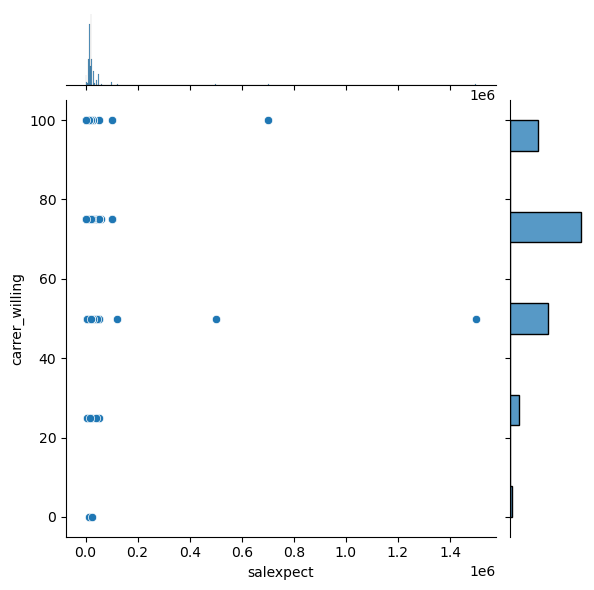

<Figure size 1500x800 with 0 Axes>

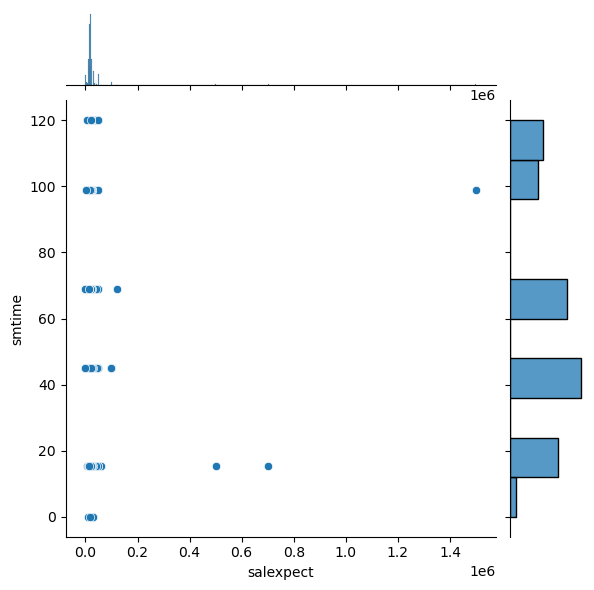

<Figure size 1500x800 with 0 Axes>

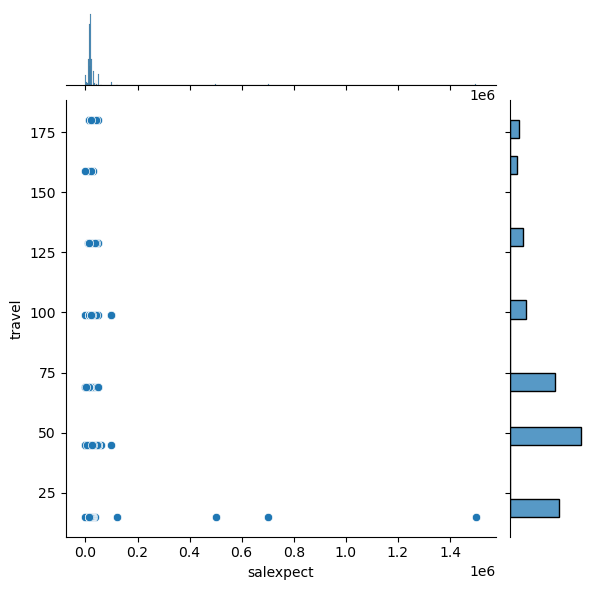

<Figure size 1500x800 with 0 Axes>

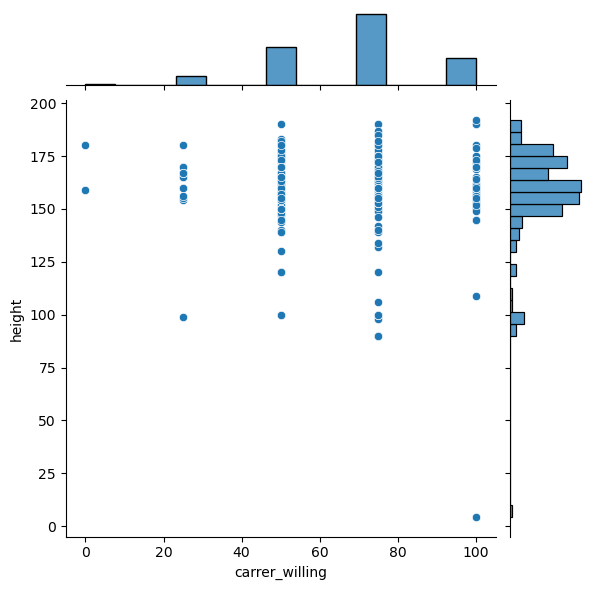

<Figure size 1500x800 with 0 Axes>

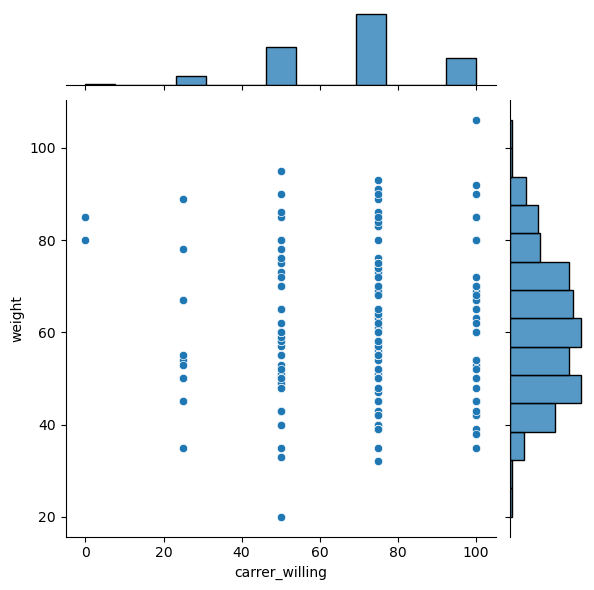

<Figure size 1500x800 with 0 Axes>

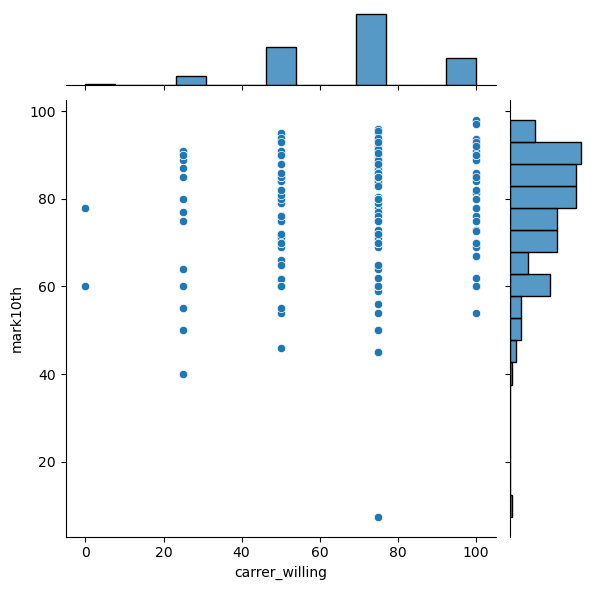

<Figure size 1500x800 with 0 Axes>

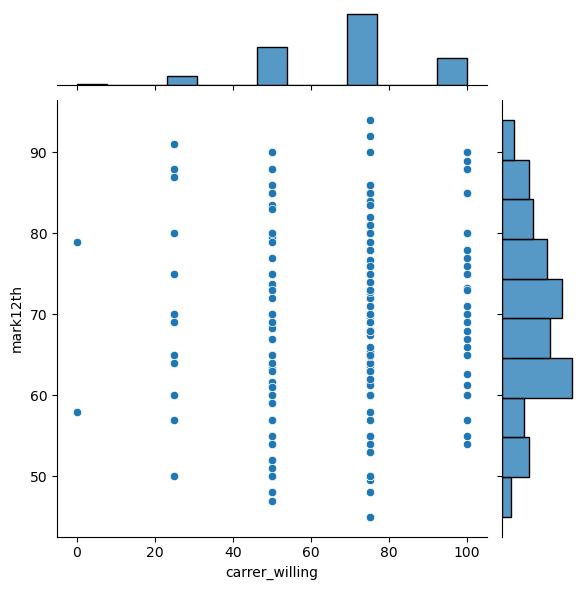

<Figure size 1500x800 with 0 Axes>

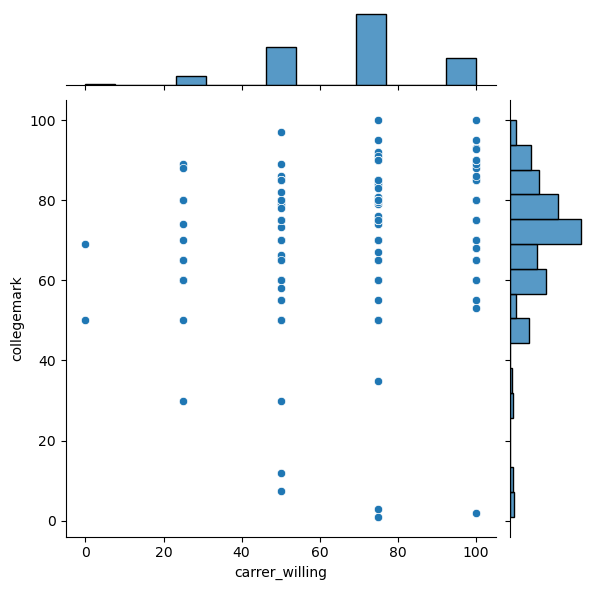

<Figure size 1500x800 with 0 Axes>

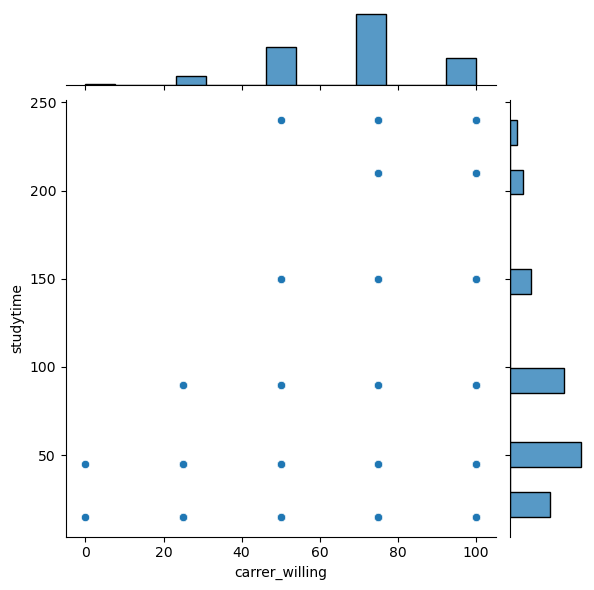

<Figure size 1500x800 with 0 Axes>

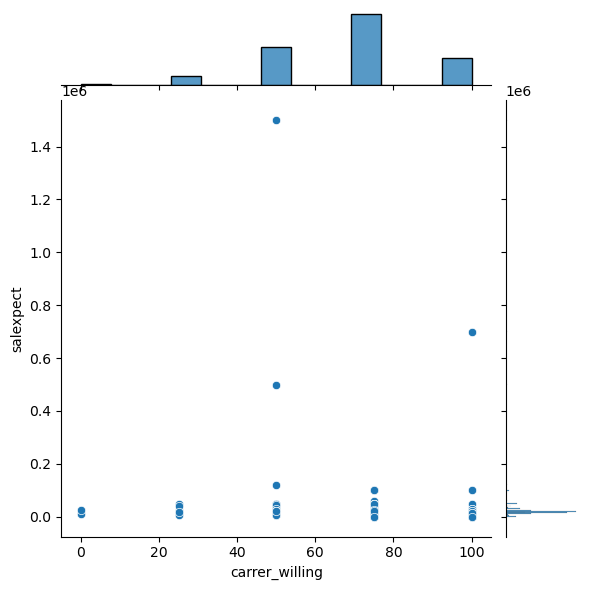

<Figure size 1500x800 with 0 Axes>

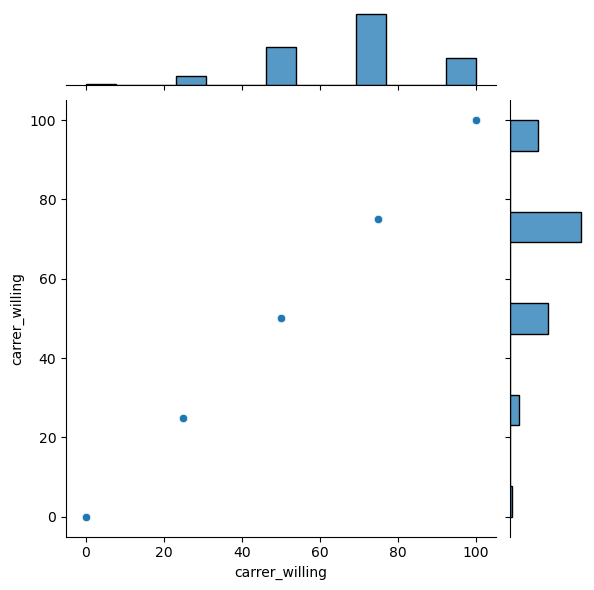

<Figure size 1500x800 with 0 Axes>

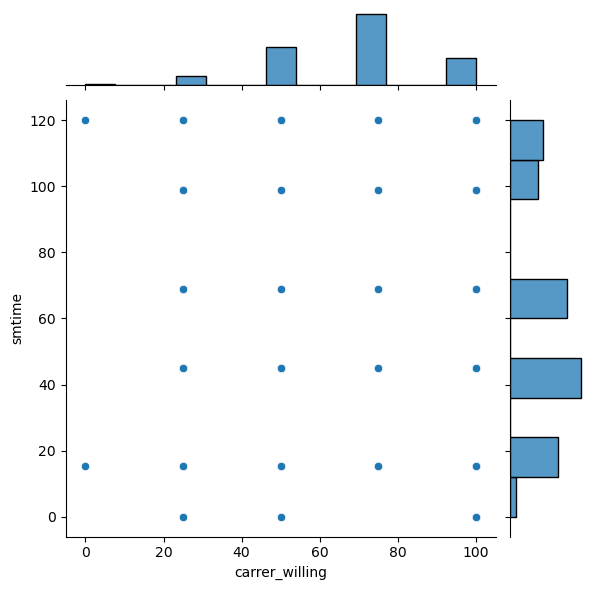

<Figure size 1500x800 with 0 Axes>

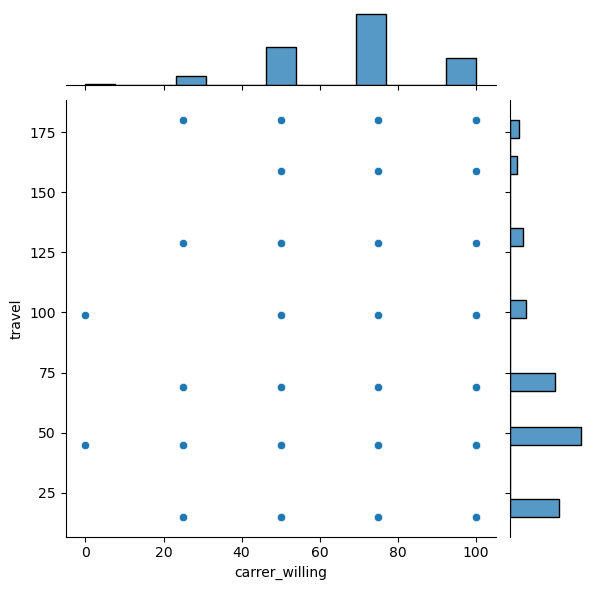

<Figure size 1500x800 with 0 Axes>

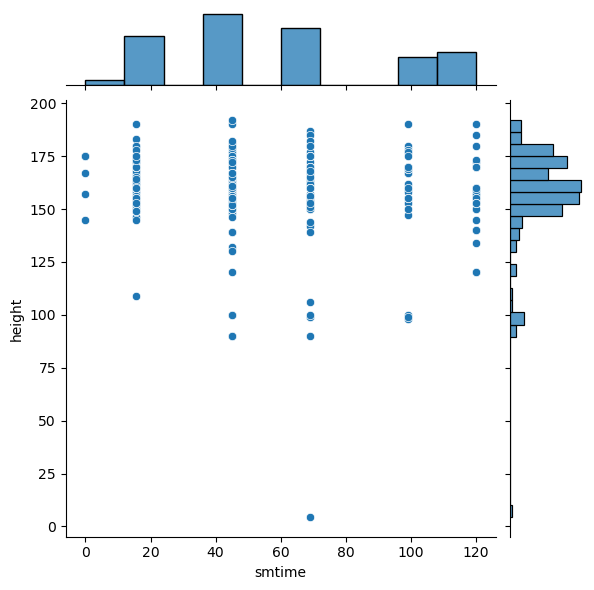

<Figure size 1500x800 with 0 Axes>

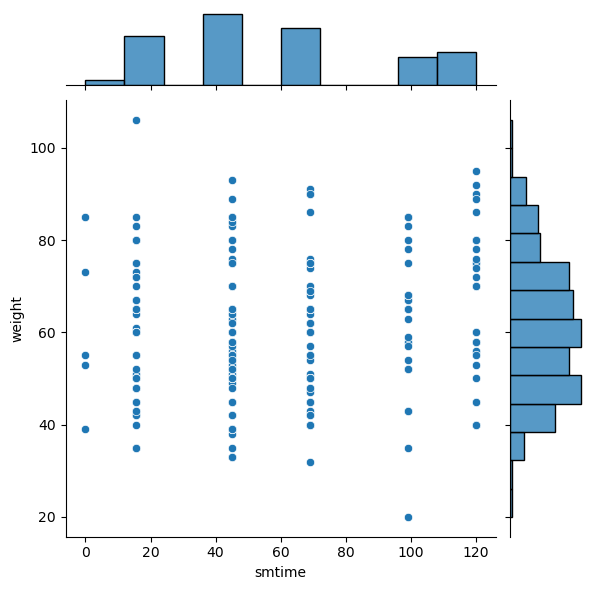

<Figure size 1500x800 with 0 Axes>

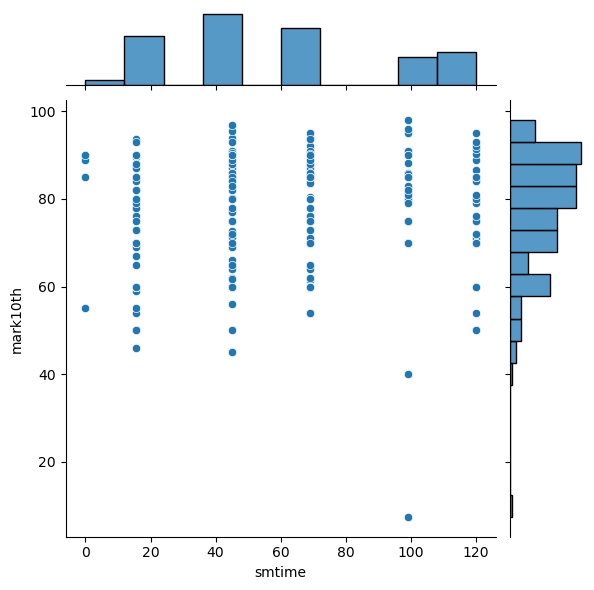

<Figure size 1500x800 with 0 Axes>

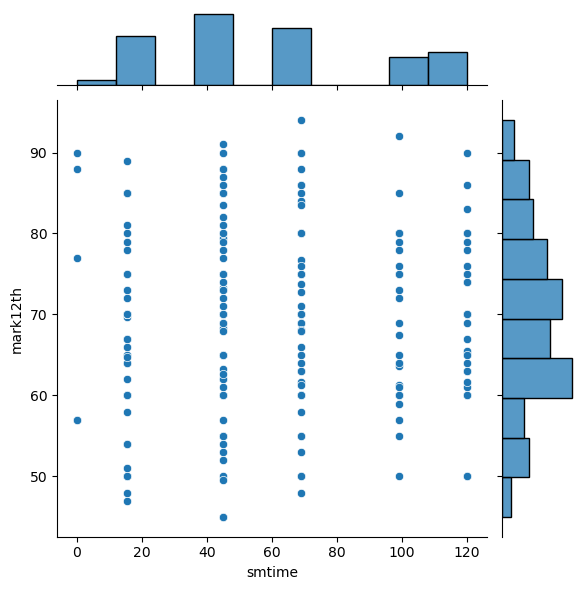

<Figure size 1500x800 with 0 Axes>

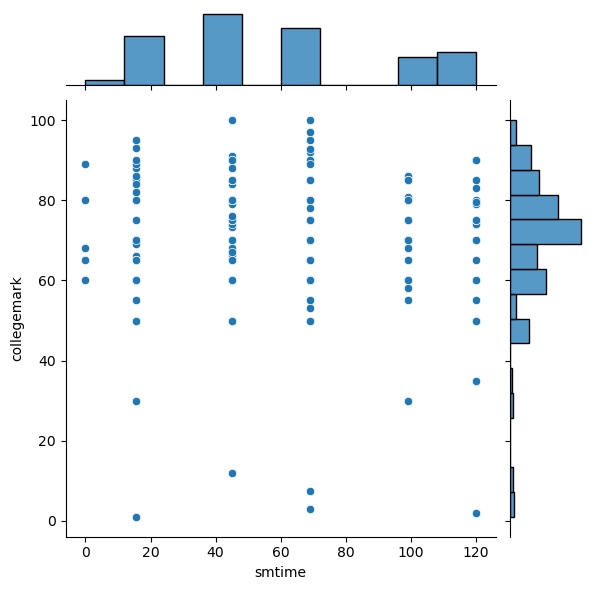

<Figure size 1500x800 with 0 Axes>

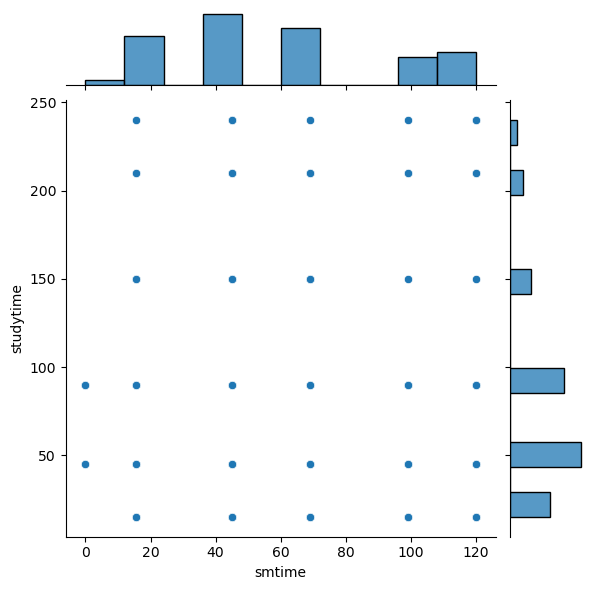

<Figure size 1500x800 with 0 Axes>

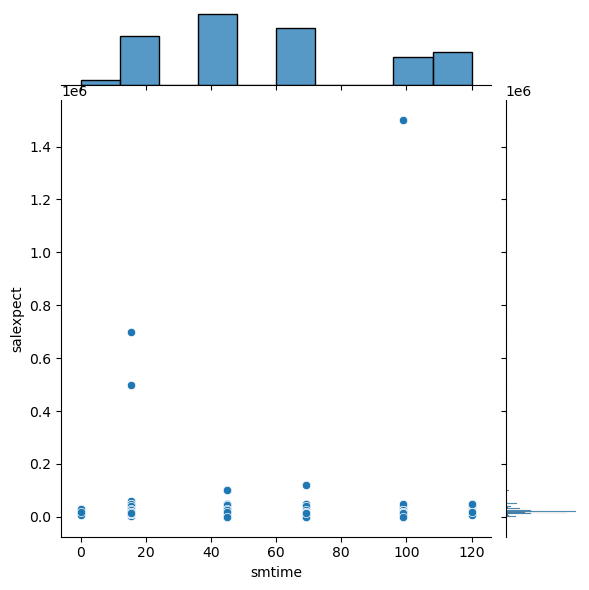

<Figure size 1500x800 with 0 Axes>

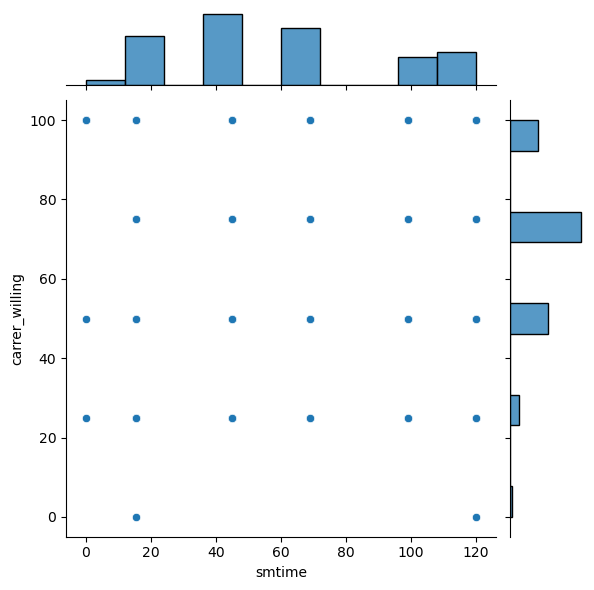

<Figure size 1500x800 with 0 Axes>

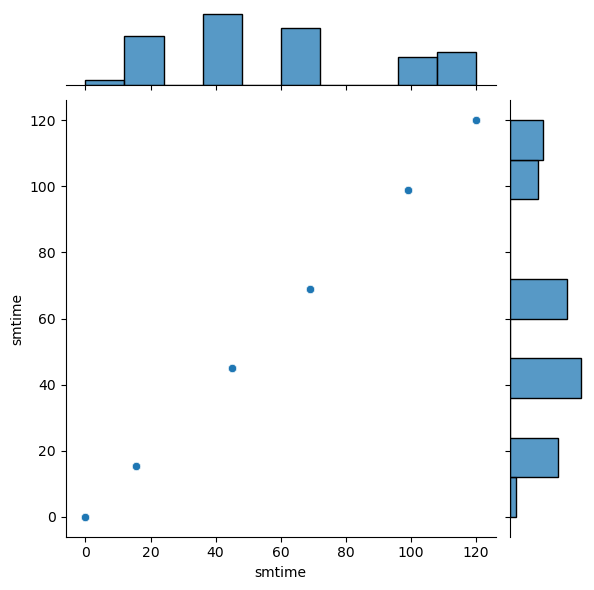

<Figure size 1500x800 with 0 Axes>

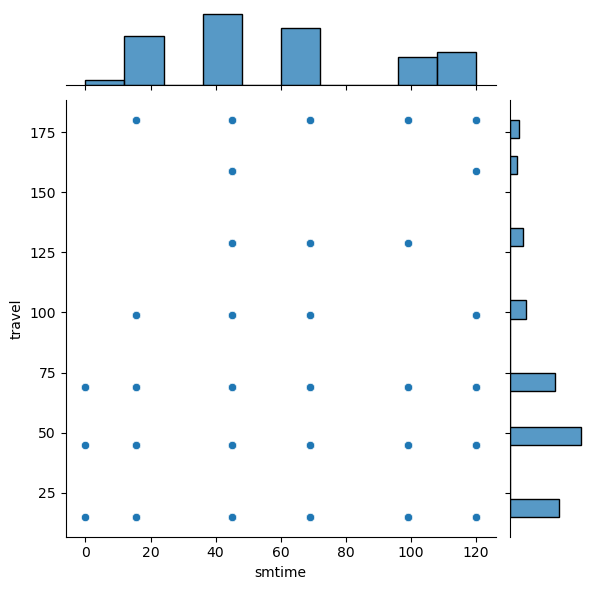

<Figure size 1500x800 with 0 Axes>

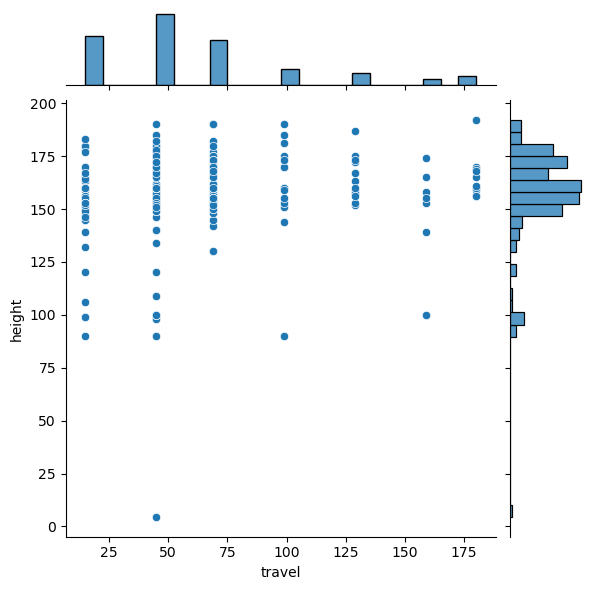

<Figure size 1500x800 with 0 Axes>

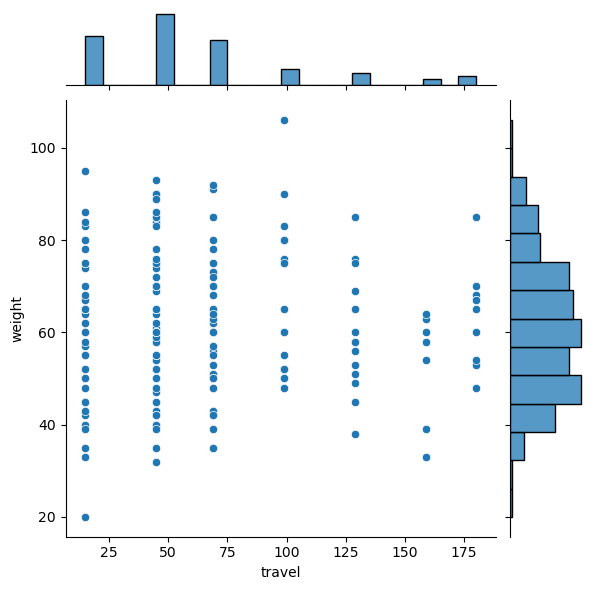

<Figure size 1500x800 with 0 Axes>

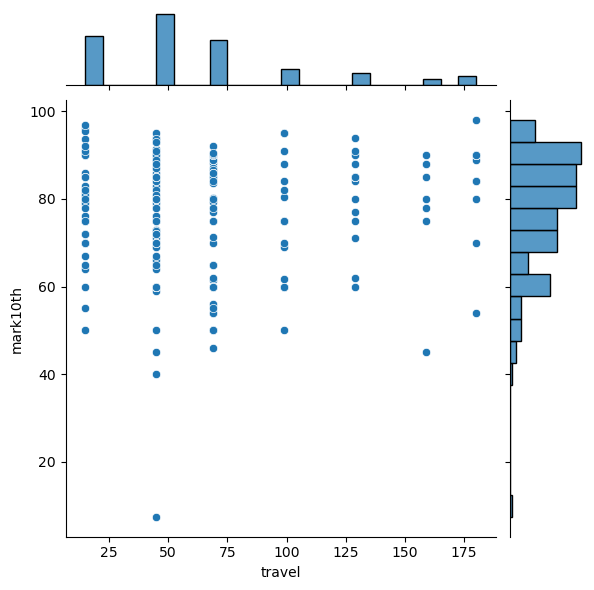

<Figure size 1500x800 with 0 Axes>

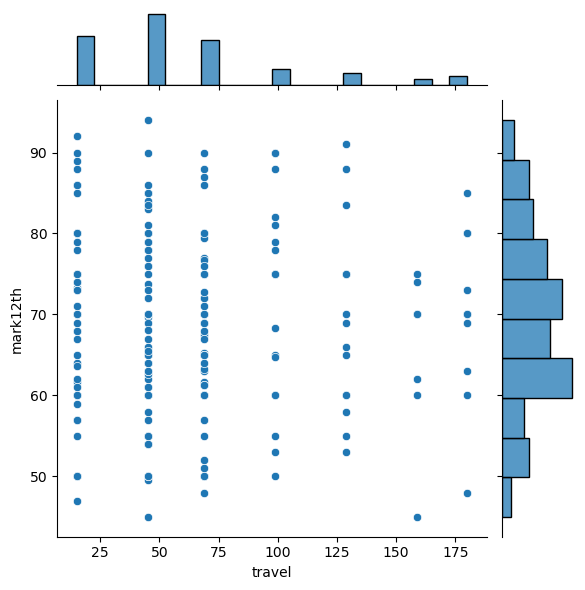

<Figure size 1500x800 with 0 Axes>

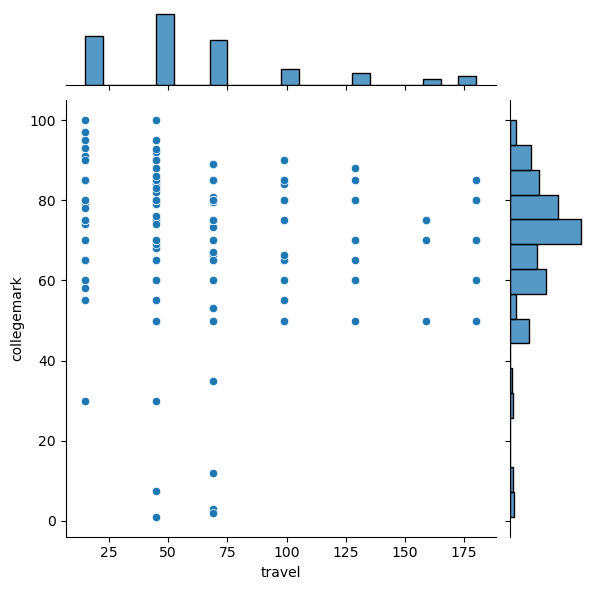

<Figure size 1500x800 with 0 Axes>

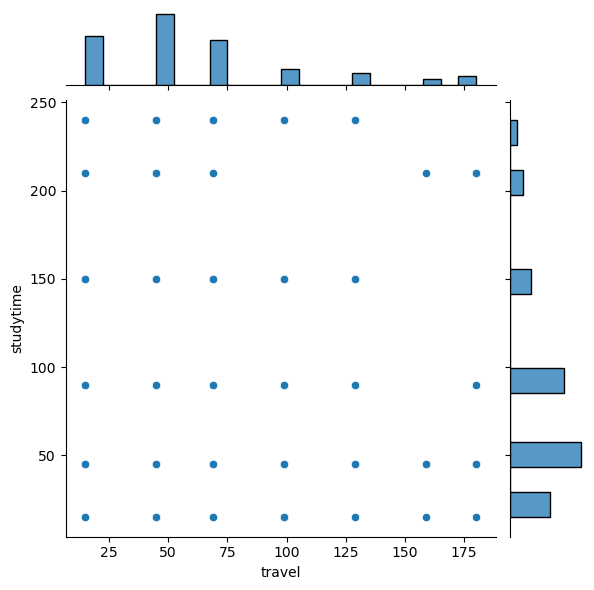

<Figure size 1500x800 with 0 Axes>

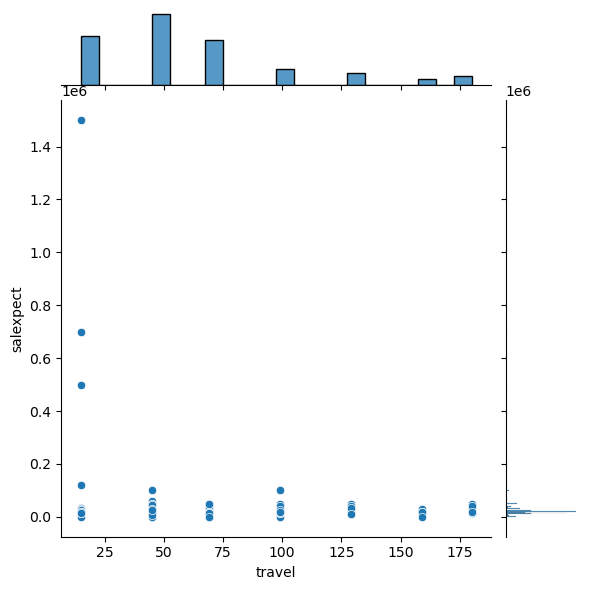

<Figure size 1500x800 with 0 Axes>

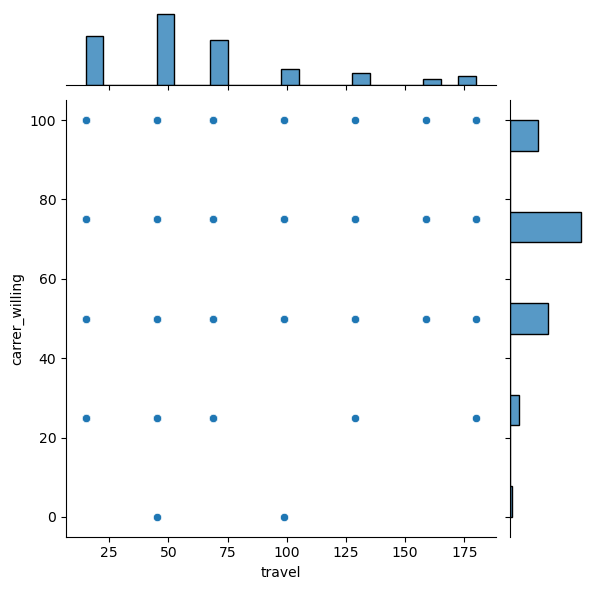

<Figure size 1500x800 with 0 Axes>

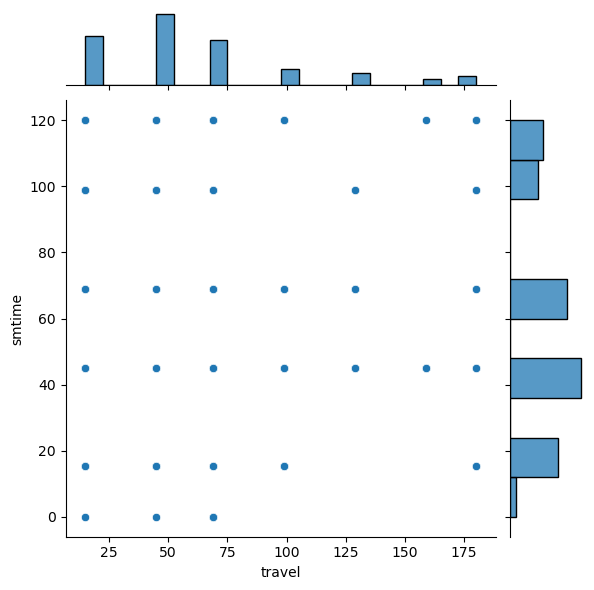

<Figure size 1500x800 with 0 Axes>

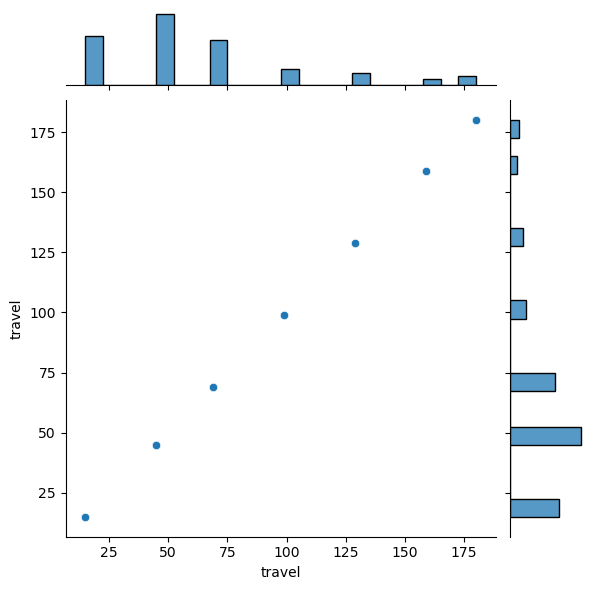

<Figure size 1500x800 with 0 Axes>

In [285]:
for column1 in numeric_columns:
    for column2 in numeric_columns:
        sns.jointplot(x=df[column1],y=df[column2])
        plt.figure(figsize=(15,8))
plt.show()

In [286]:
object_columns = df.select_dtypes(include=['object'])

In [287]:
object_columns

,certification,gender,dep,hobbies,prefertime,likedegree,stress,financial,parttime
0,No,Male,BCA,Video Games,Morning,No,Bad,Bad,No
1,No,Female,BCA,Cinema,Morning,Yes,Bad,Bad,No
2,Yes,Male,BCA,Cinema,Anytime,Yes,Awful,Bad,No
3,Yes,Female,BCA,Reading books,Anytime,No,Bad,good,No
4,No,Male,BCA,Video Games,Morning,Yes,Good,good,No
...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,Video Games,Morning,Yes,Bad,Bad,No
231,Yes,Male,B.com ISM,Cinema,Anytime,Yes,Good,good,No
232,Yes,Female,BCA,Cinema,Night,Yes,Bad,good,No
233,Yes,Female,Commerce,Cinema,Anytime,Yes,Awful,good,No


C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\h

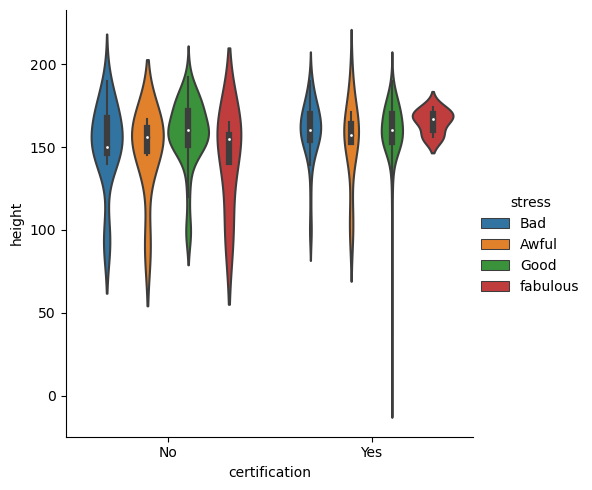

<Figure size 1500x800 with 0 Axes>

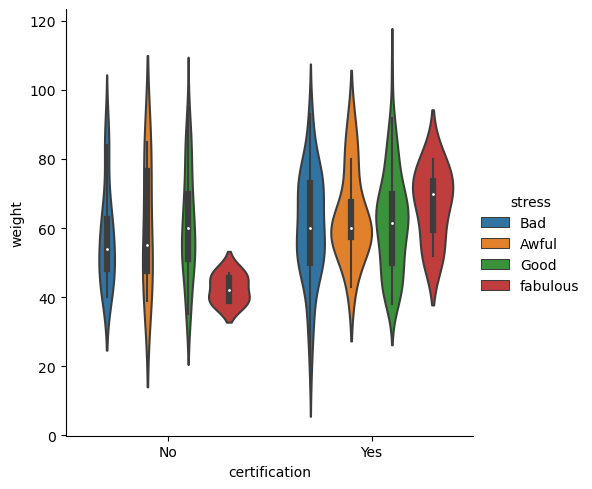

<Figure size 1500x800 with 0 Axes>

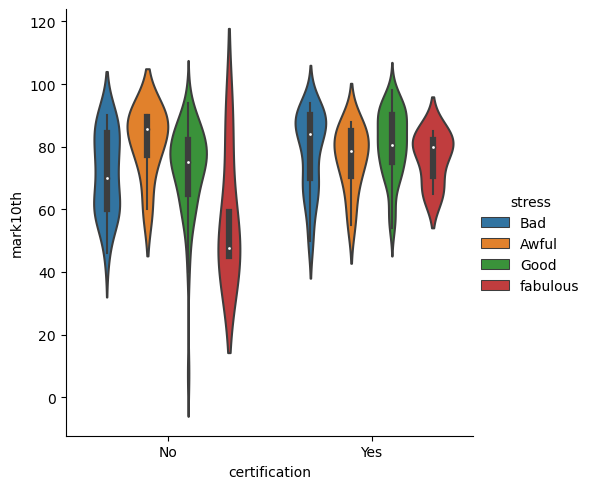

<Figure size 1500x800 with 0 Axes>

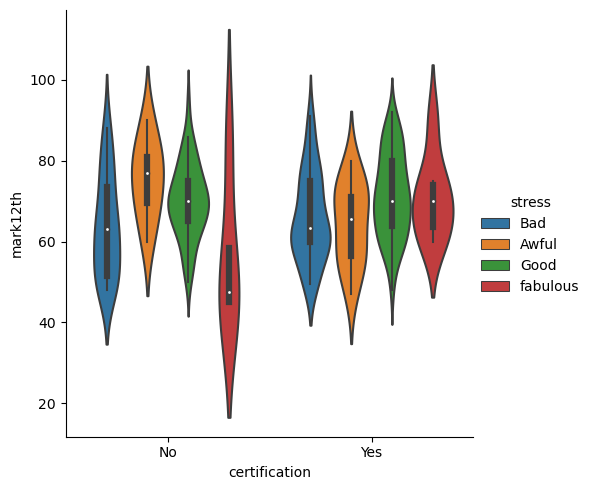

<Figure size 1500x800 with 0 Axes>

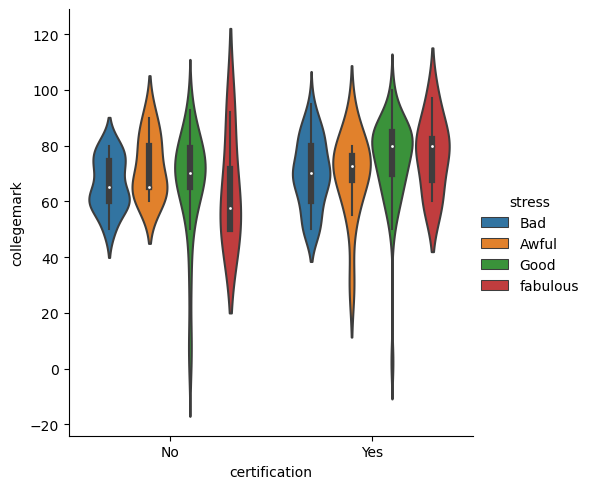

<Figure size 1500x800 with 0 Axes>

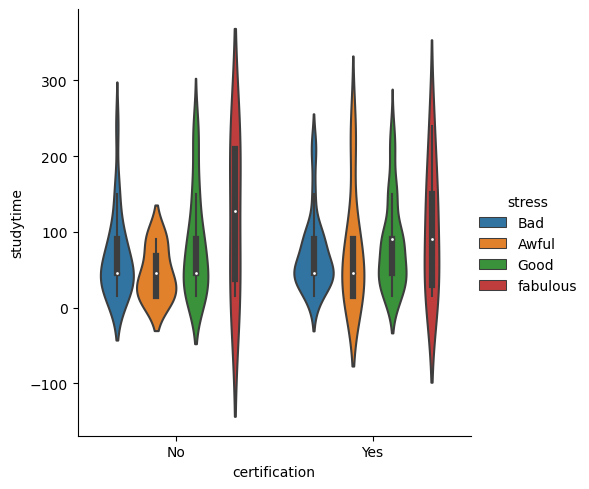

<Figure size 1500x800 with 0 Axes>

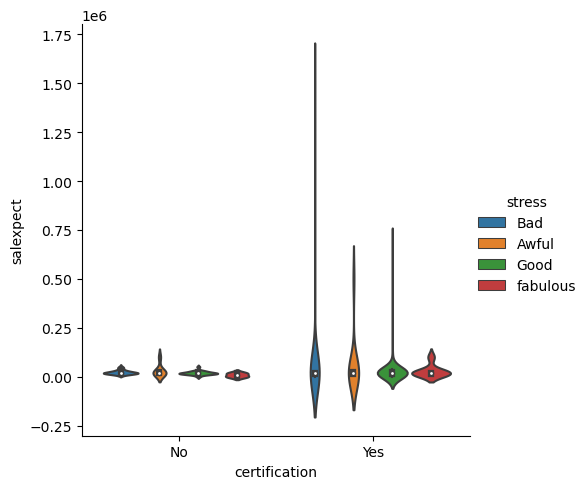

<Figure size 1500x800 with 0 Axes>

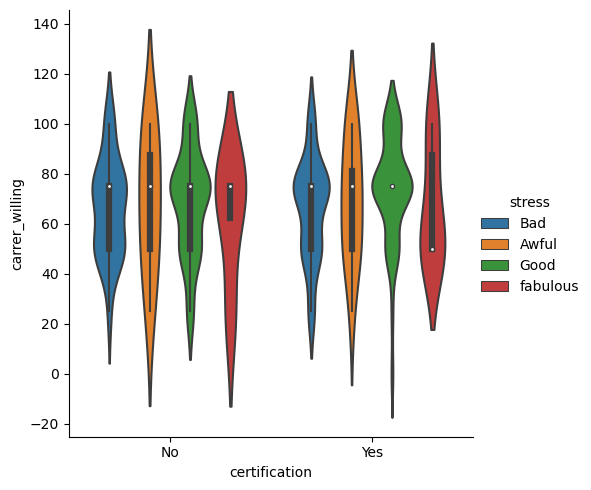

<Figure size 1500x800 with 0 Axes>

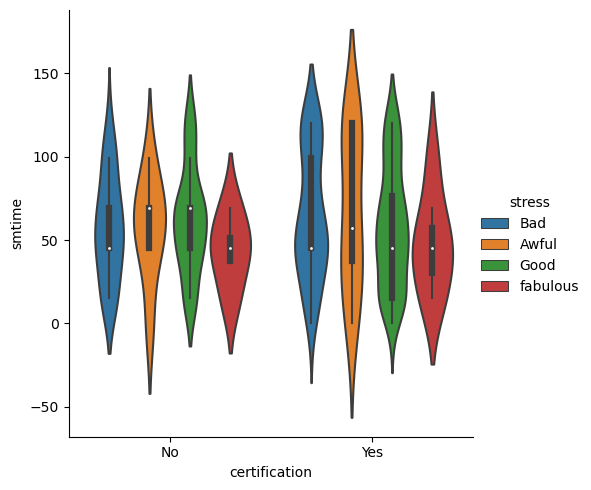

<Figure size 1500x800 with 0 Axes>

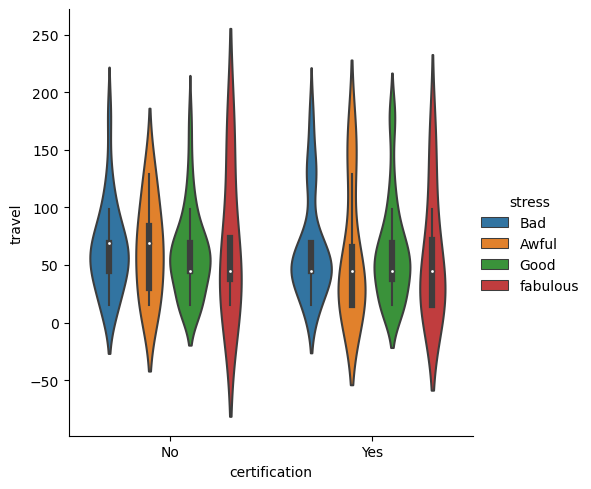

<Figure size 1500x800 with 0 Axes>

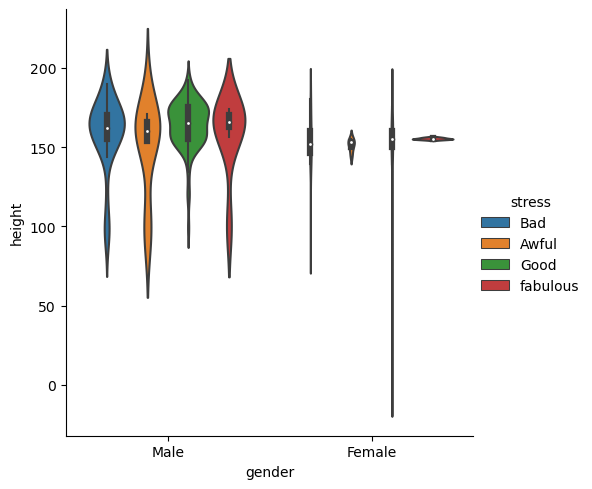

<Figure size 1500x800 with 0 Axes>

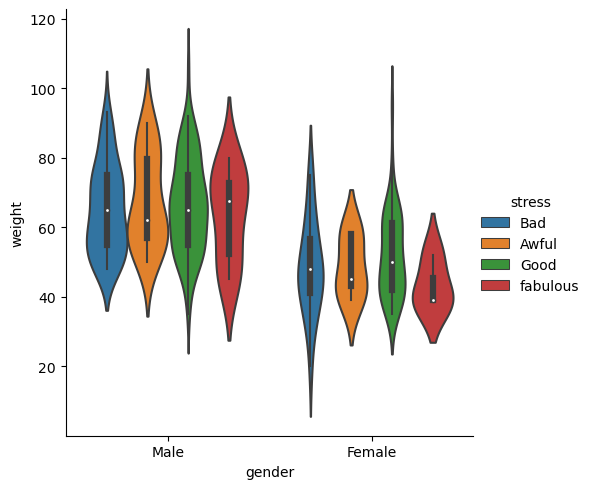

<Figure size 1500x800 with 0 Axes>

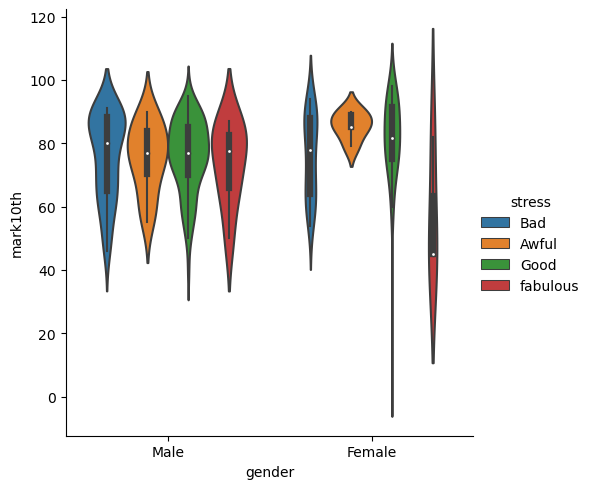

<Figure size 1500x800 with 0 Axes>

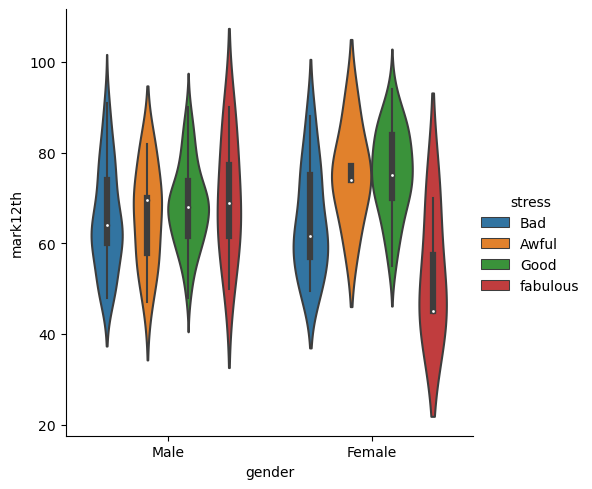

<Figure size 1500x800 with 0 Axes>

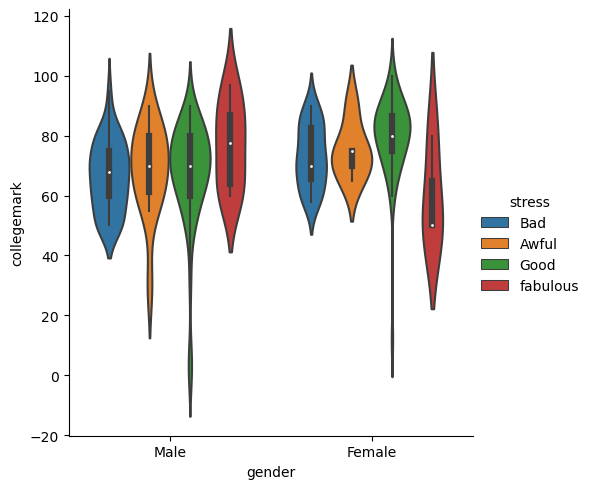

<Figure size 1500x800 with 0 Axes>

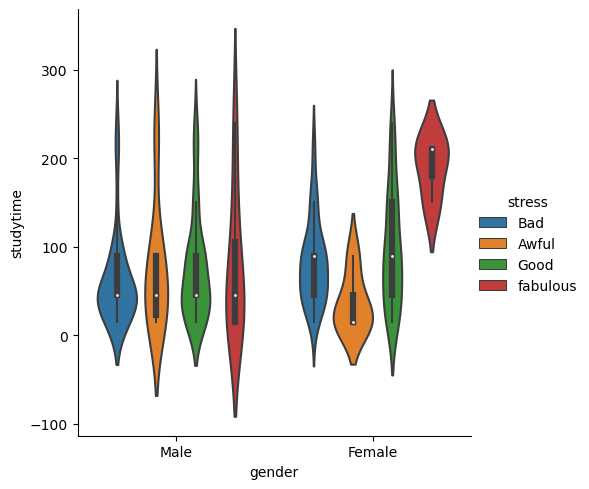

<Figure size 1500x800 with 0 Axes>

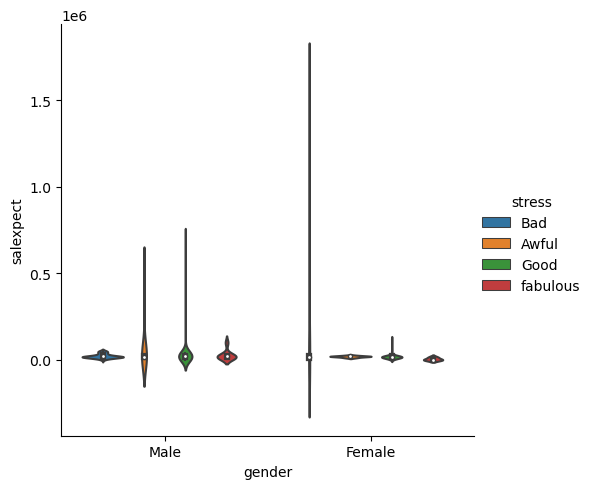

<Figure size 1500x800 with 0 Axes>

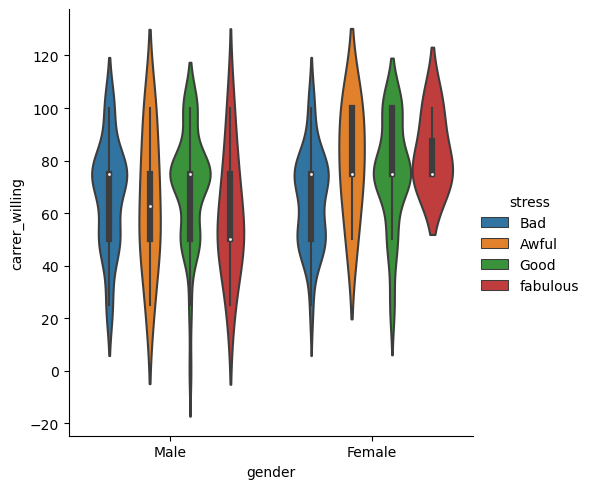

<Figure size 1500x800 with 0 Axes>

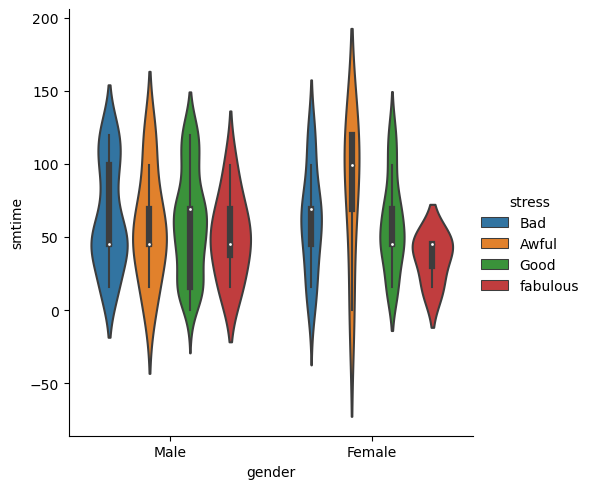

<Figure size 1500x800 with 0 Axes>

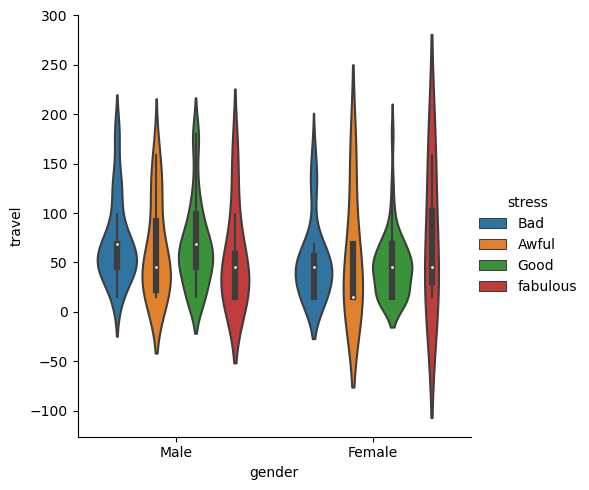

<Figure size 1500x800 with 0 Axes>

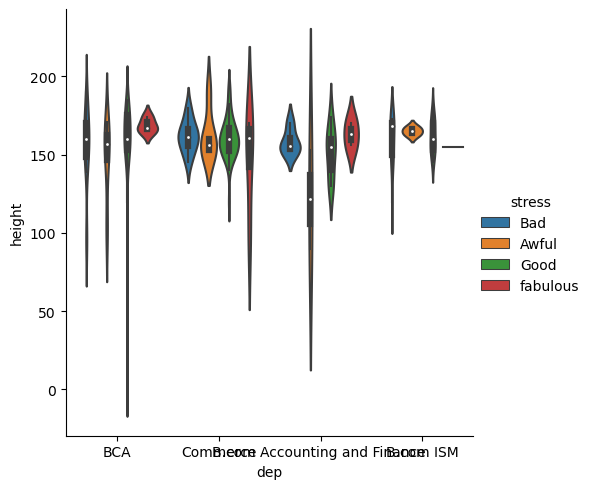

<Figure size 1500x800 with 0 Axes>

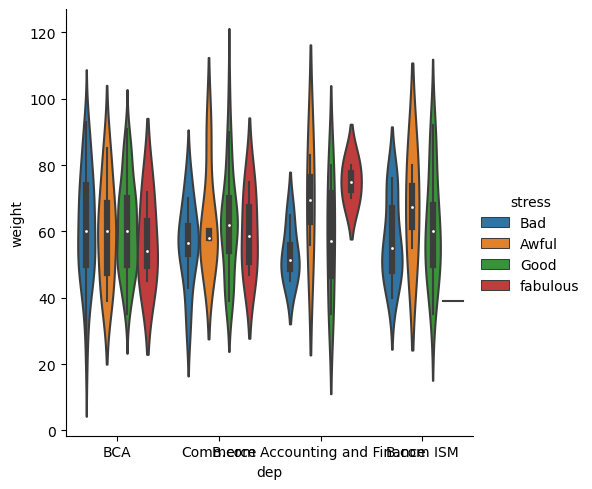

<Figure size 1500x800 with 0 Axes>

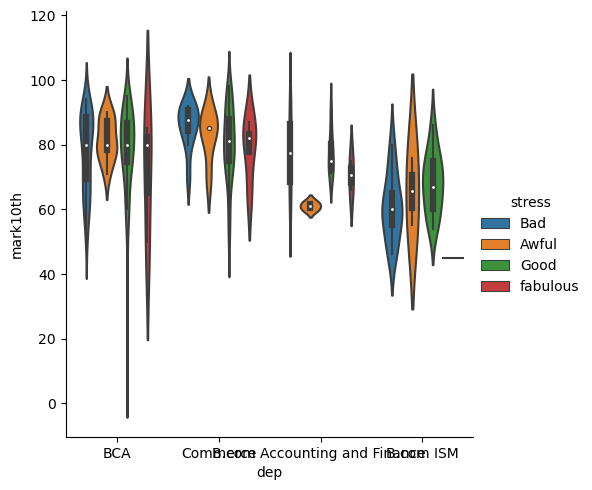

<Figure size 1500x800 with 0 Axes>

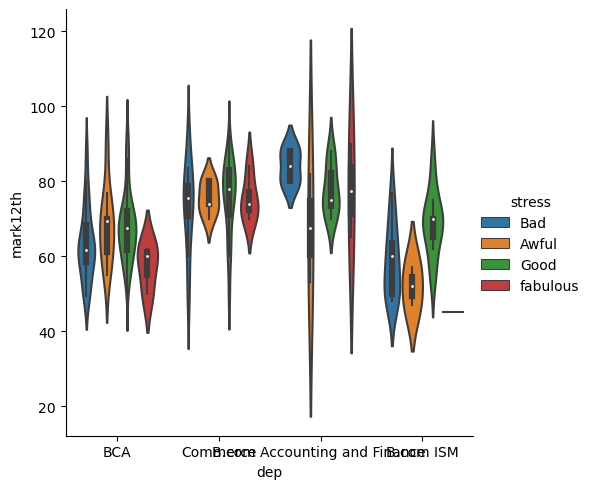

<Figure size 1500x800 with 0 Axes>

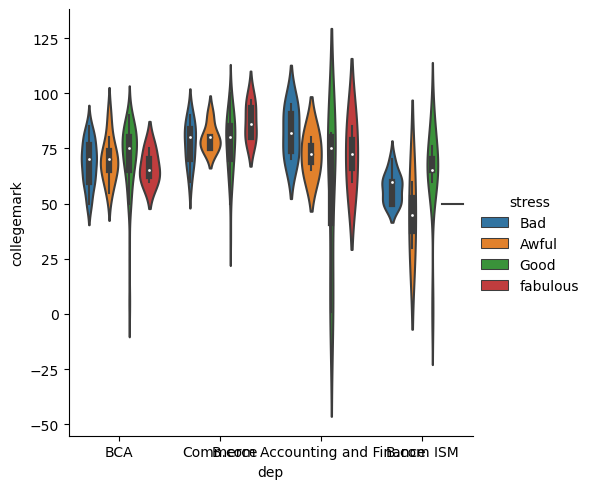

<Figure size 1500x800 with 0 Axes>

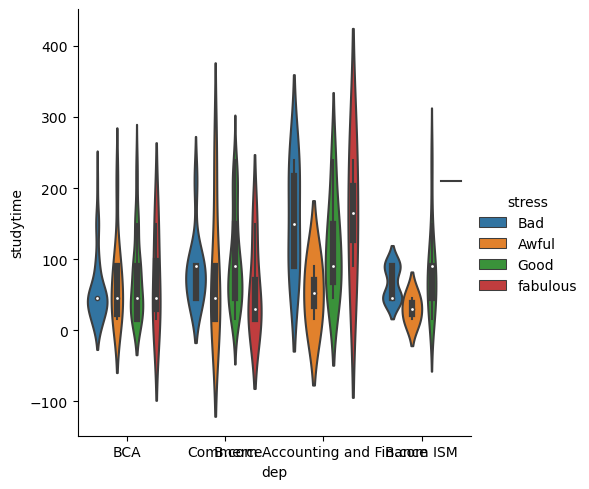

<Figure size 1500x800 with 0 Axes>

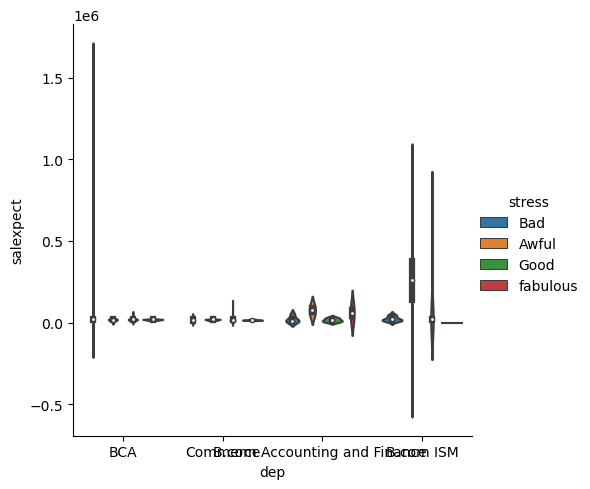

<Figure size 1500x800 with 0 Axes>

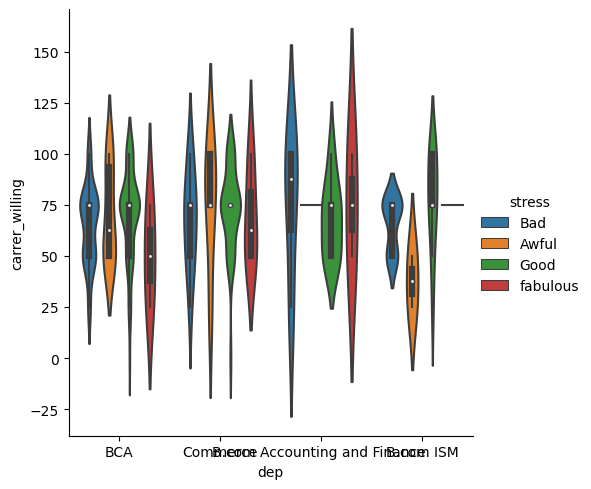

<Figure size 1500x800 with 0 Axes>

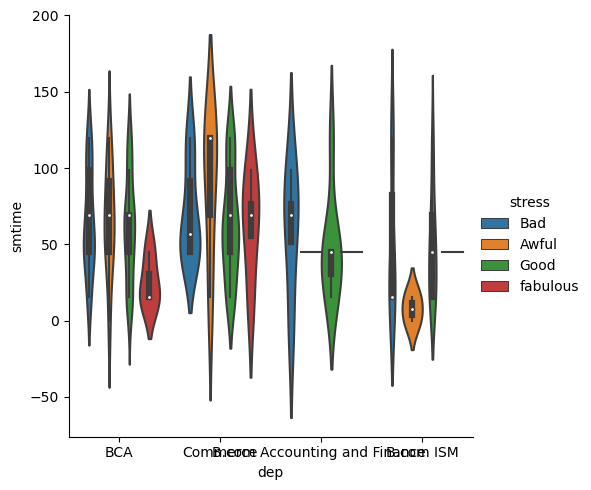

<Figure size 1500x800 with 0 Axes>

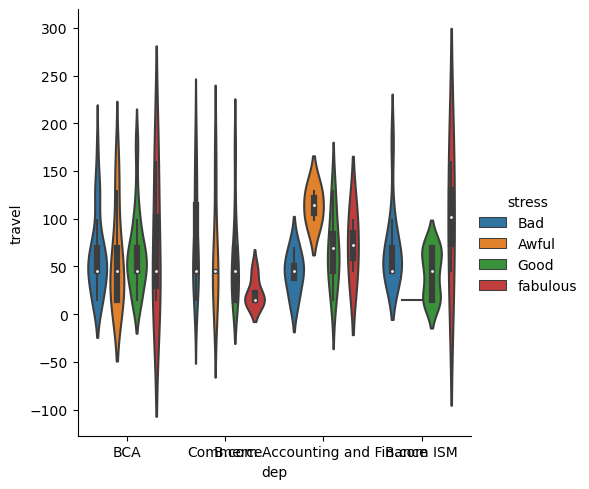

<Figure size 1500x800 with 0 Axes>

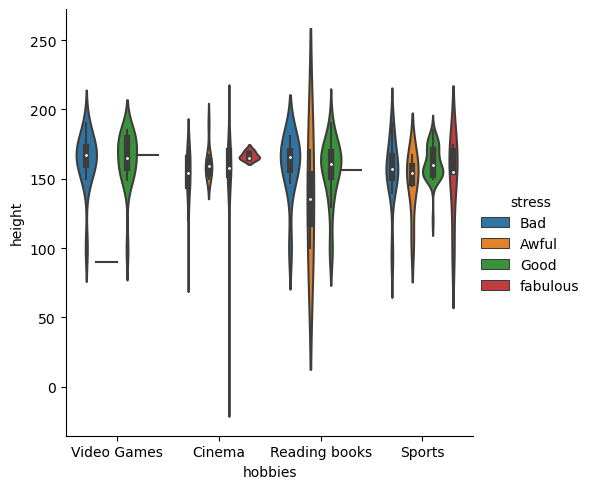

<Figure size 1500x800 with 0 Axes>

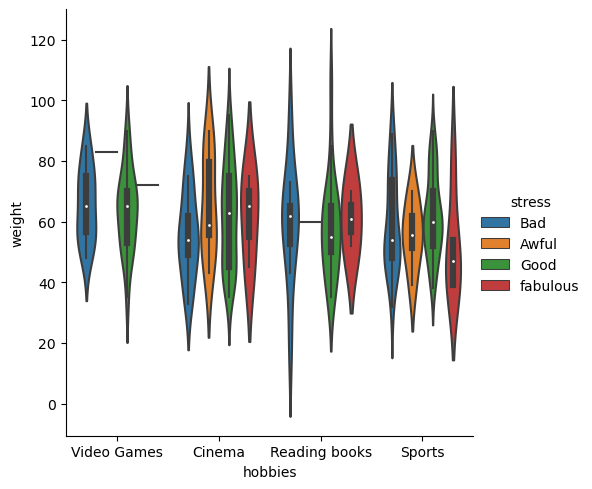

<Figure size 1500x800 with 0 Axes>

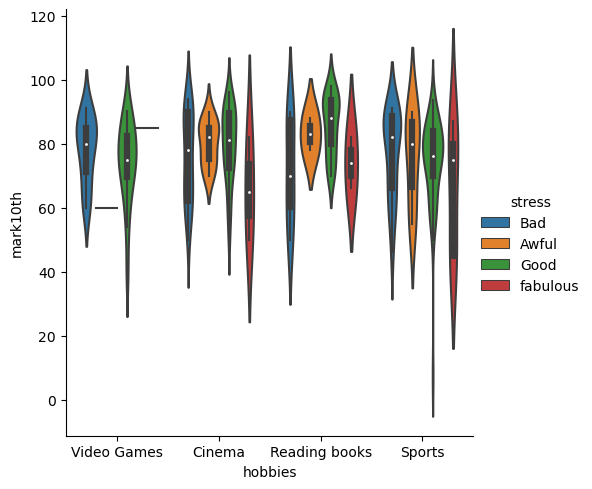

<Figure size 1500x800 with 0 Axes>

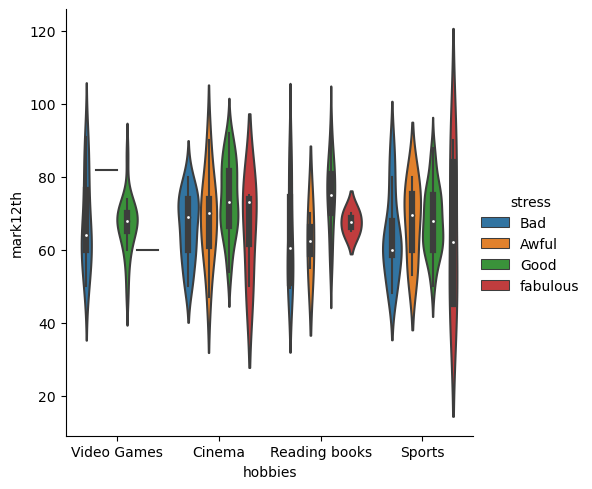

<Figure size 1500x800 with 0 Axes>

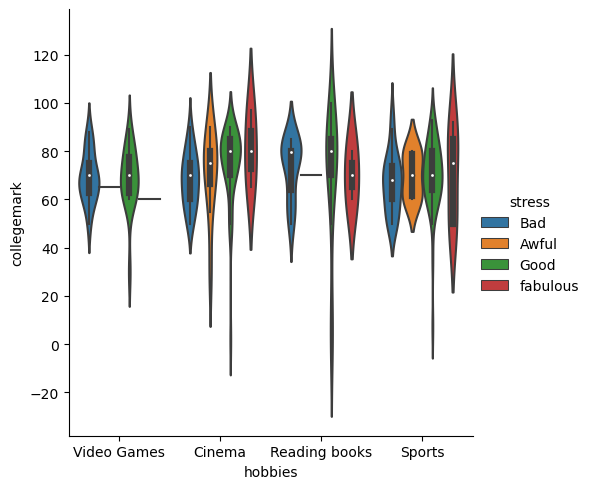

<Figure size 1500x800 with 0 Axes>

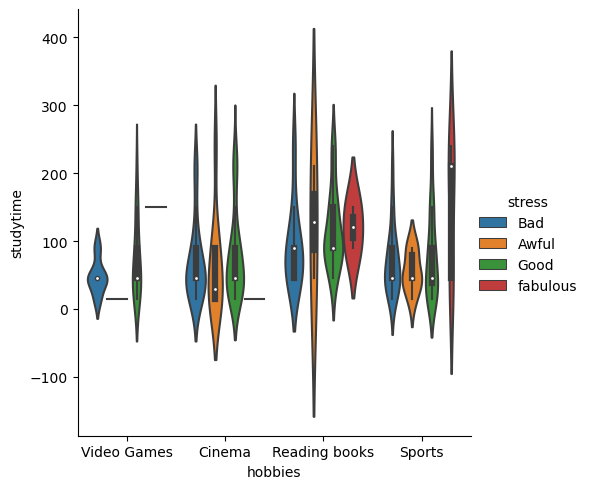

<Figure size 1500x800 with 0 Axes>

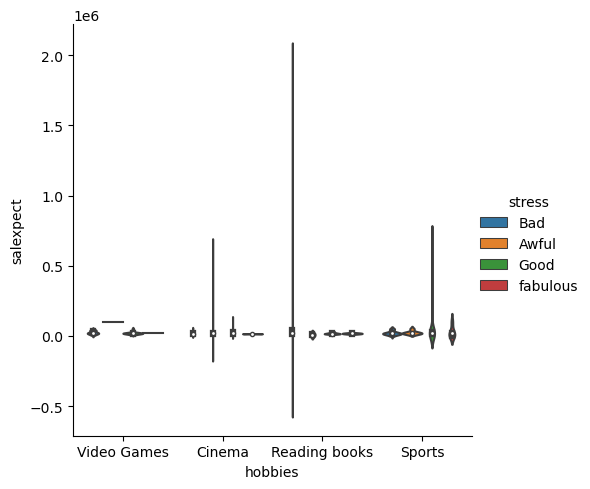

<Figure size 1500x800 with 0 Axes>

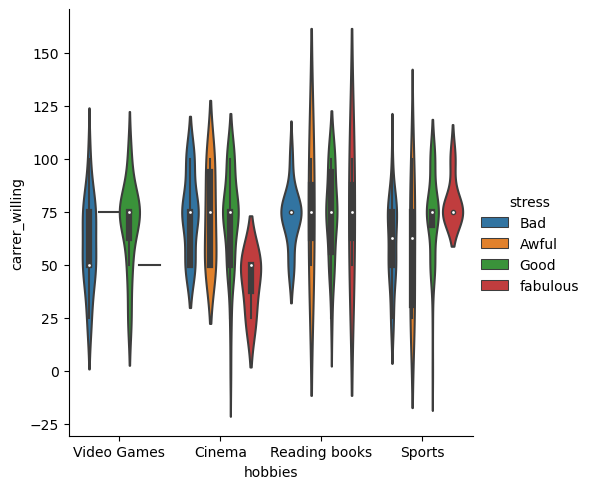

<Figure size 1500x800 with 0 Axes>

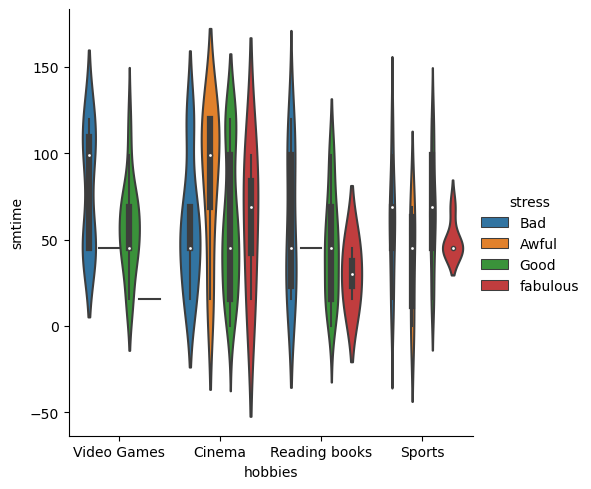

<Figure size 1500x800 with 0 Axes>

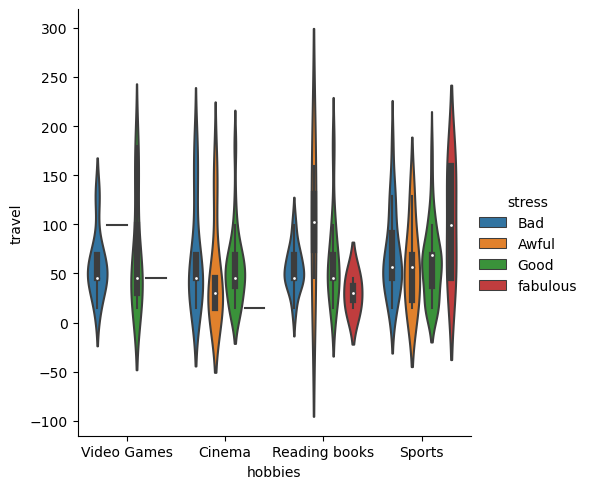

<Figure size 1500x800 with 0 Axes>

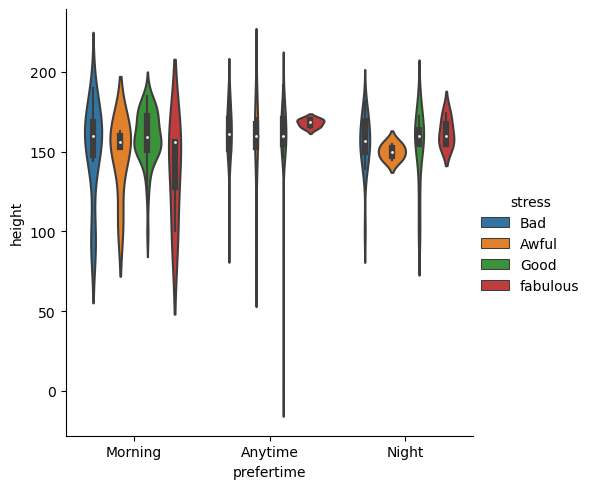

<Figure size 1500x800 with 0 Axes>

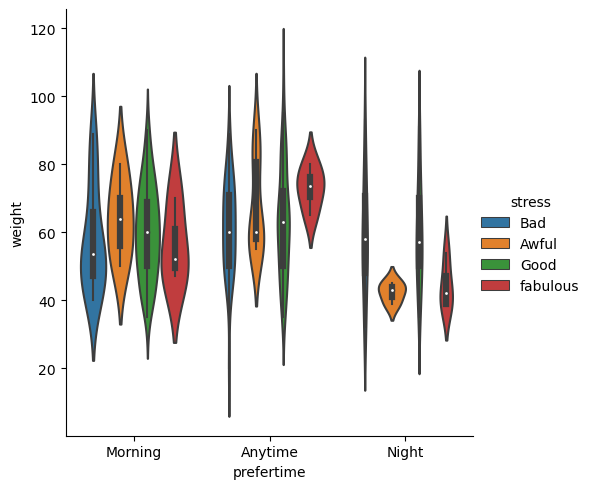

<Figure size 1500x800 with 0 Axes>

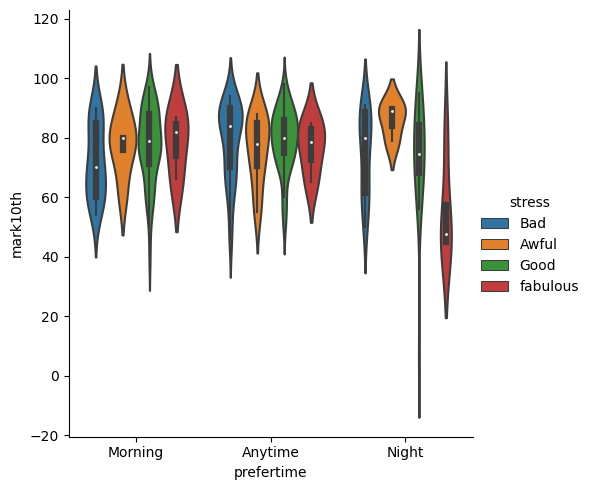

<Figure size 1500x800 with 0 Axes>

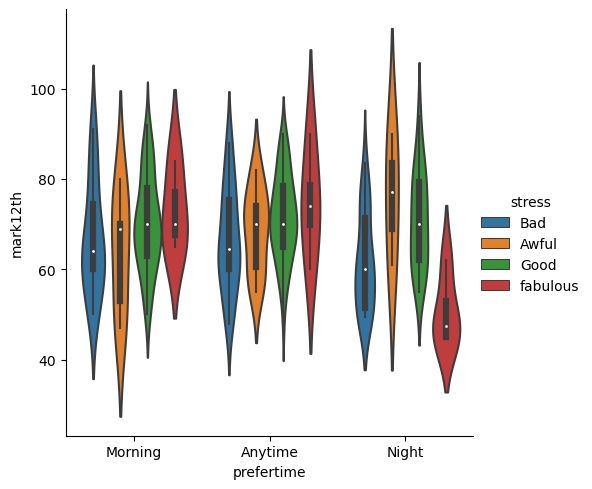

<Figure size 1500x800 with 0 Axes>

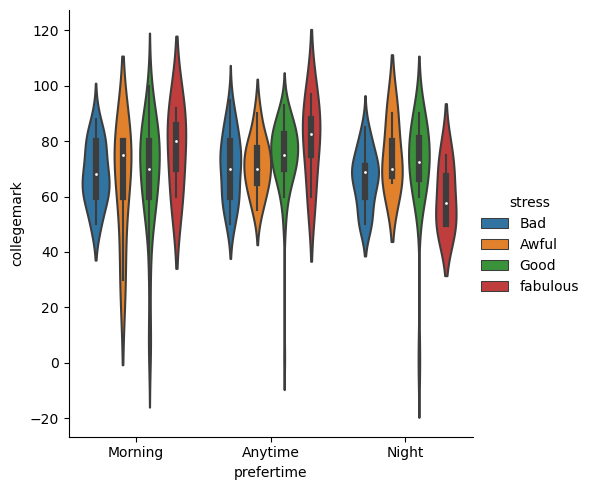

<Figure size 1500x800 with 0 Axes>

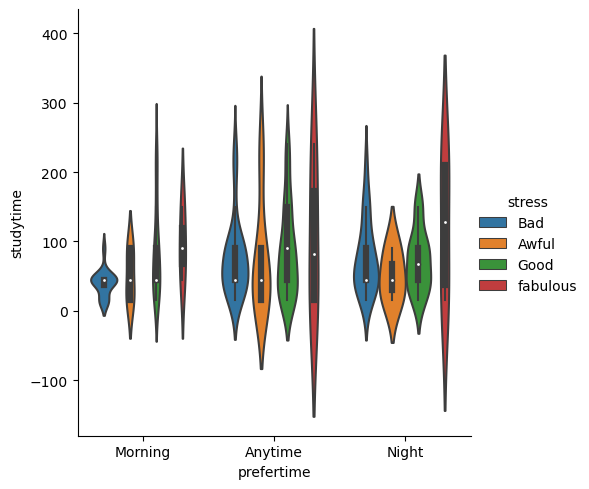

<Figure size 1500x800 with 0 Axes>

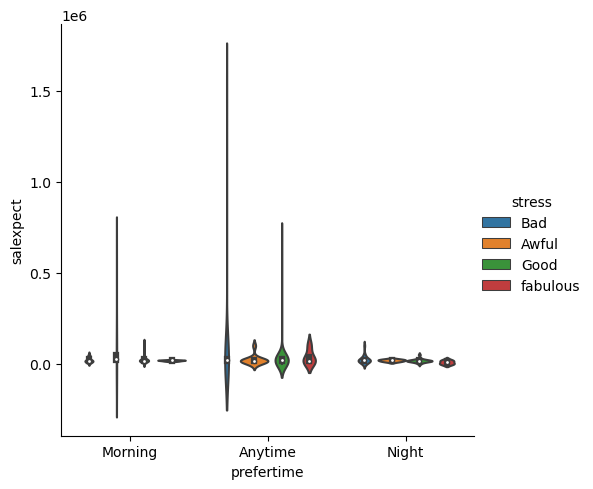

<Figure size 1500x800 with 0 Axes>

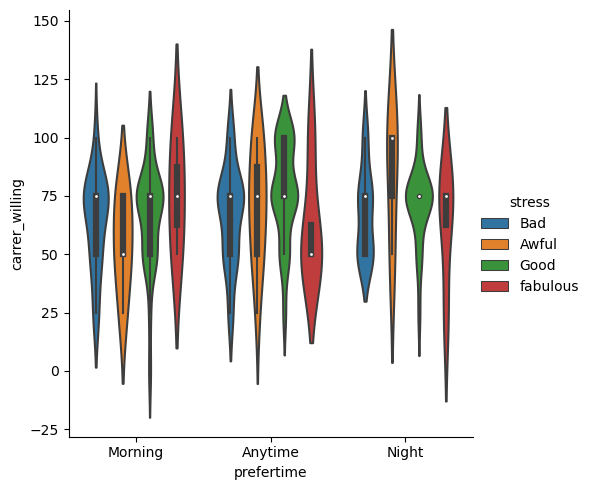

<Figure size 1500x800 with 0 Axes>

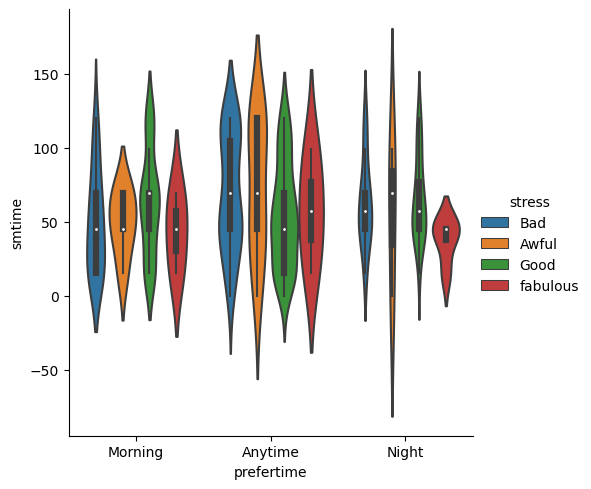

<Figure size 1500x800 with 0 Axes>

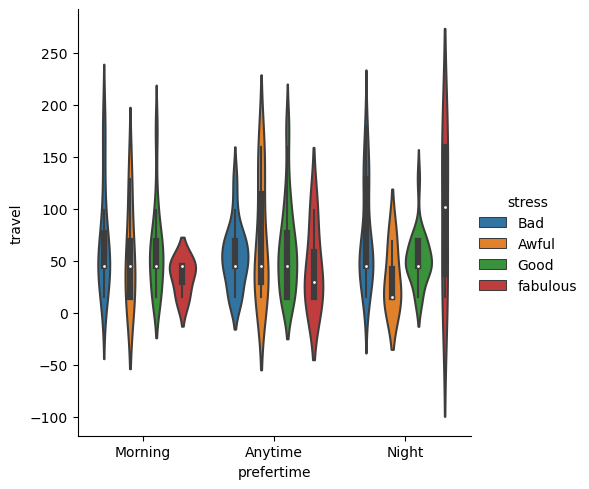

<Figure size 1500x800 with 0 Axes>

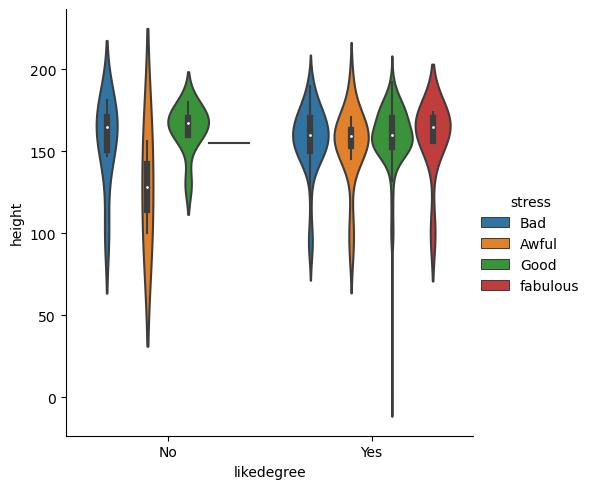

<Figure size 1500x800 with 0 Axes>

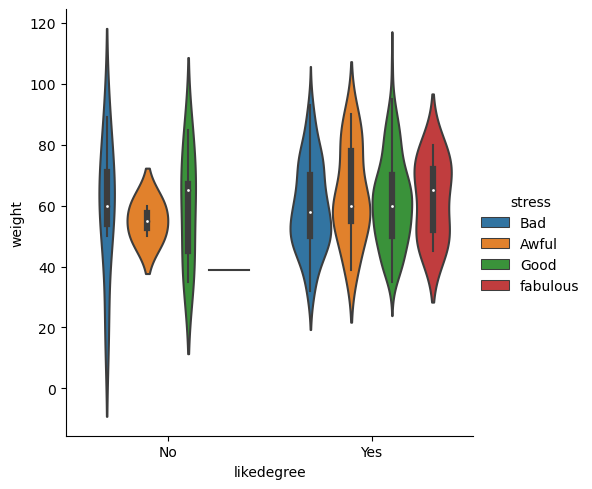

<Figure size 1500x800 with 0 Axes>

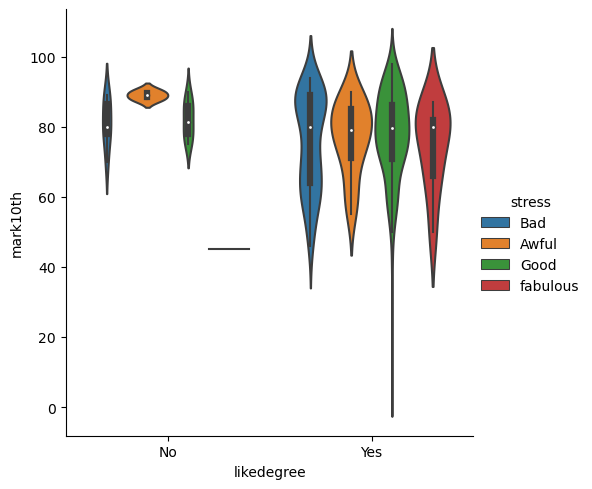

<Figure size 1500x800 with 0 Axes>

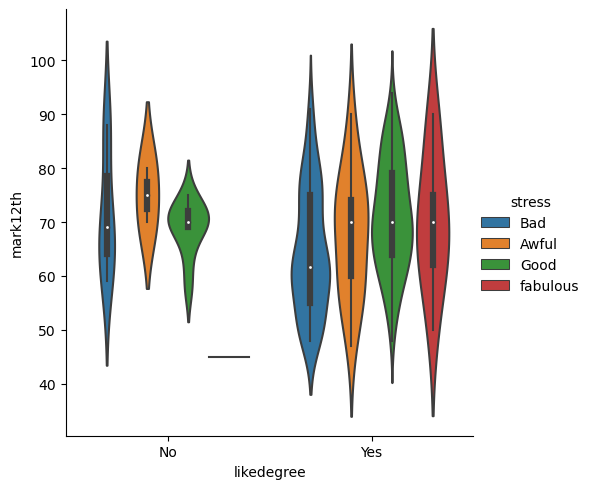

<Figure size 1500x800 with 0 Axes>

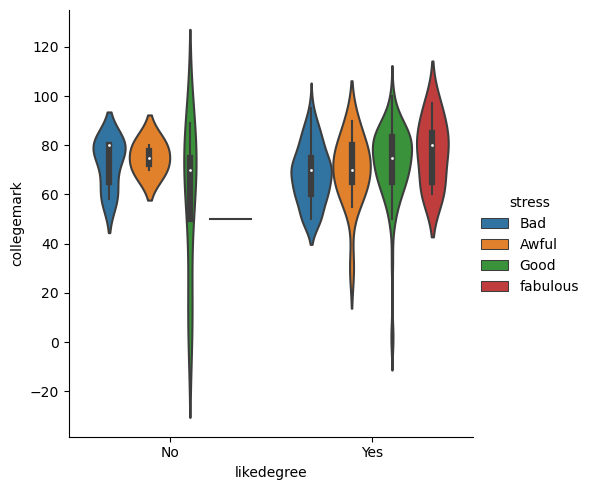

<Figure size 1500x800 with 0 Axes>

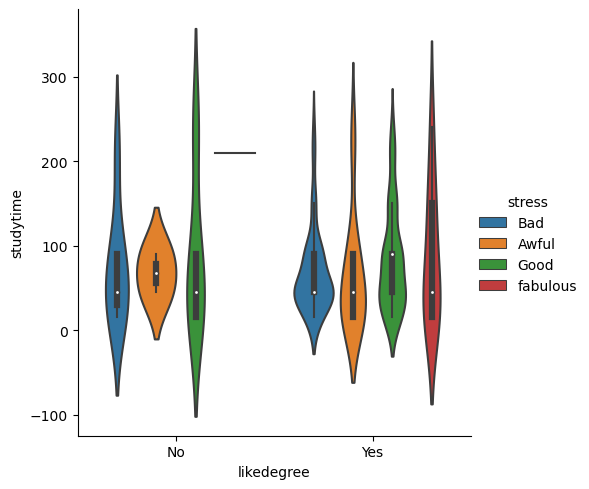

<Figure size 1500x800 with 0 Axes>

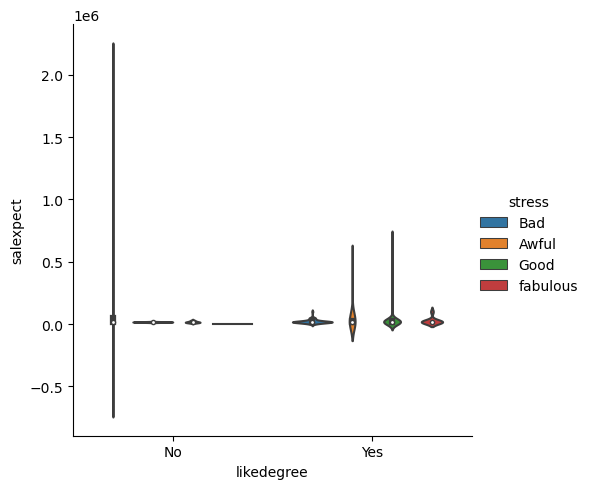

<Figure size 1500x800 with 0 Axes>

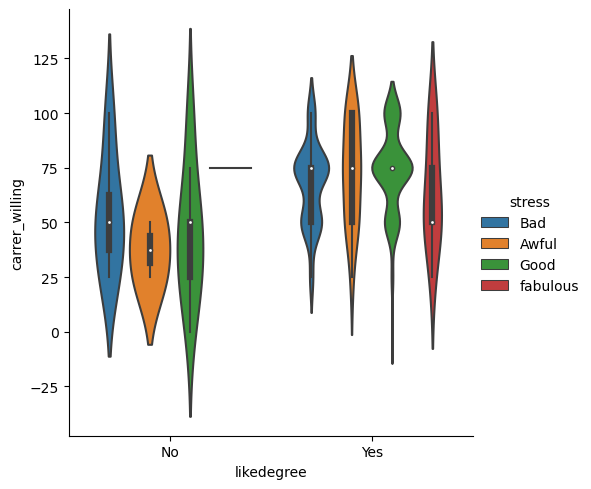

<Figure size 1500x800 with 0 Axes>

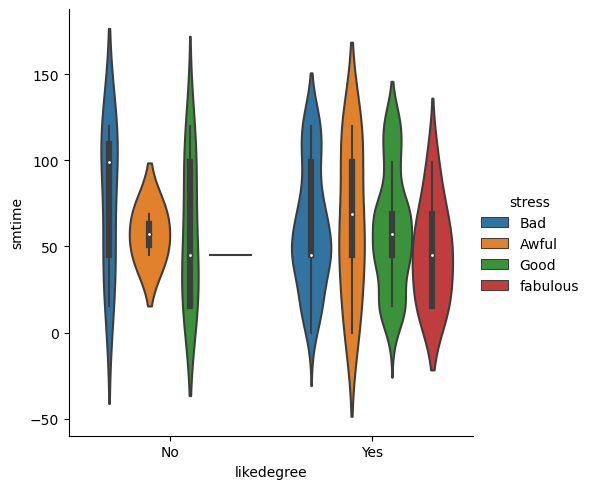

<Figure size 1500x800 with 0 Axes>

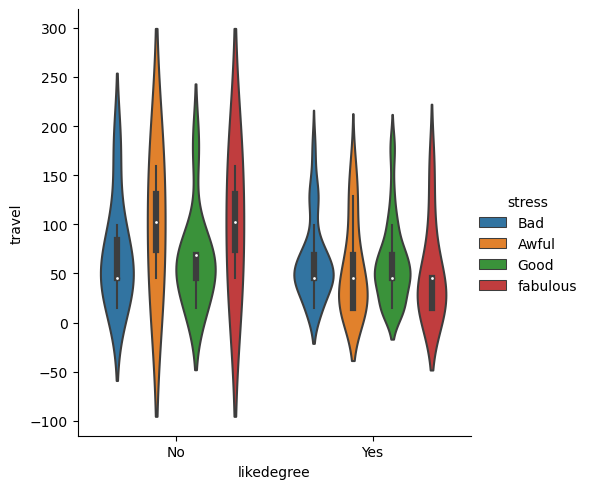

<Figure size 1500x800 with 0 Axes>

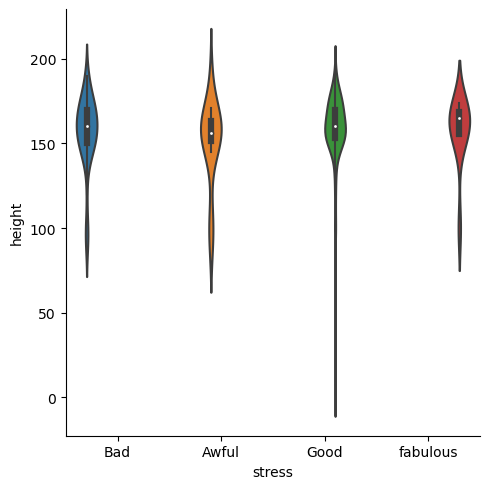

<Figure size 1500x800 with 0 Axes>

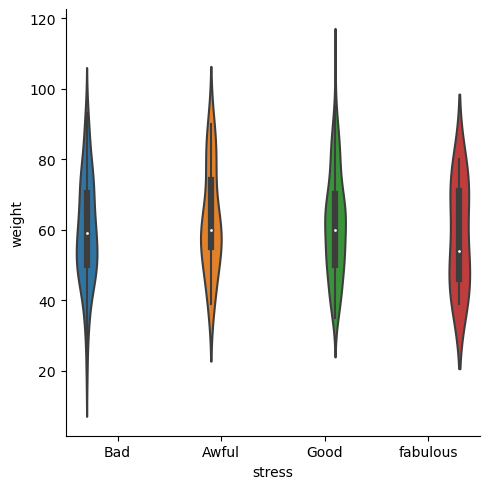

<Figure size 1500x800 with 0 Axes>

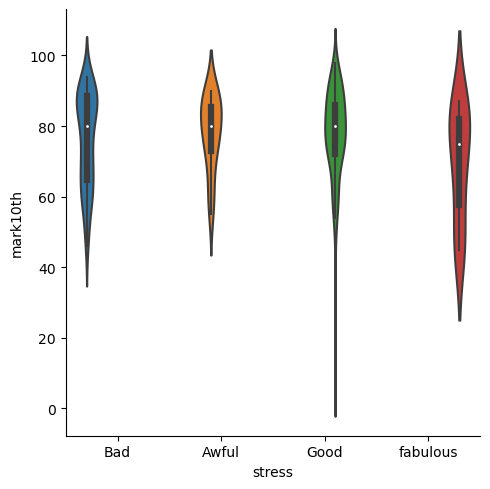

<Figure size 1500x800 with 0 Axes>

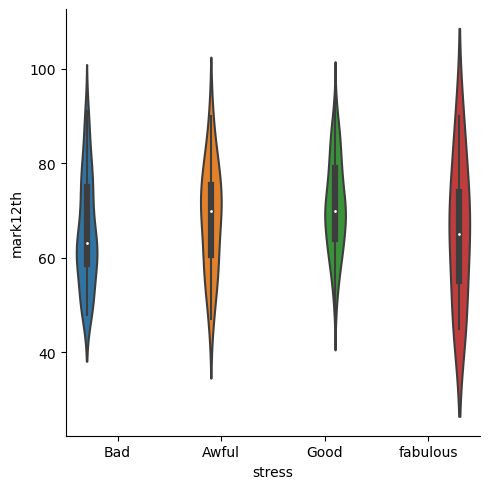

<Figure size 1500x800 with 0 Axes>

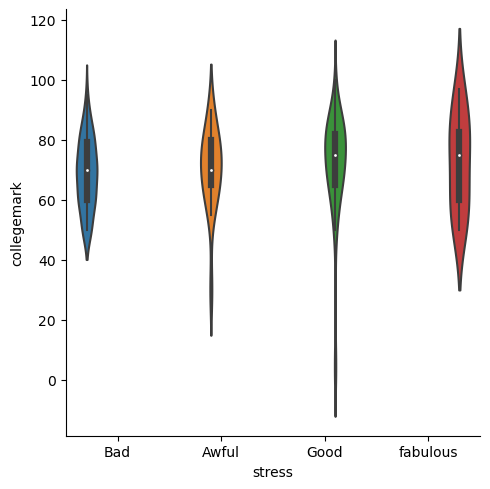

<Figure size 1500x800 with 0 Axes>

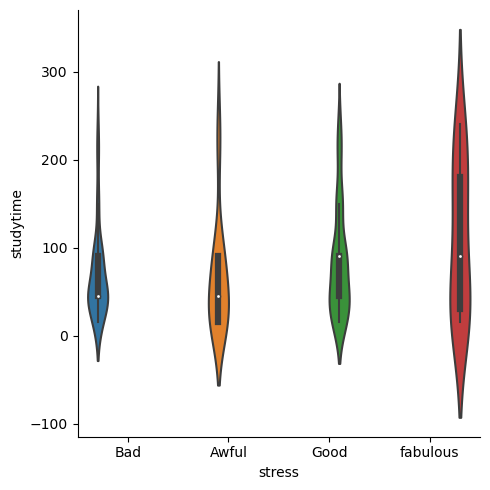

<Figure size 1500x800 with 0 Axes>

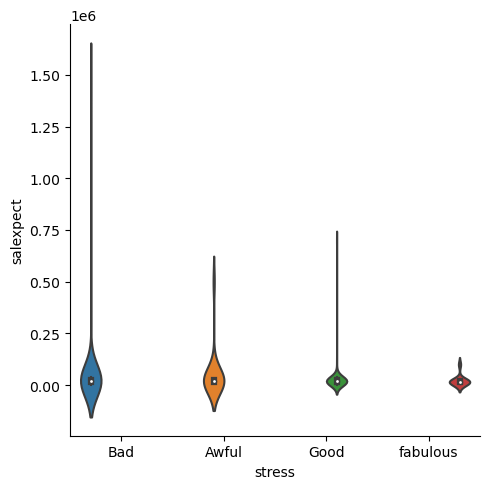

<Figure size 1500x800 with 0 Axes>

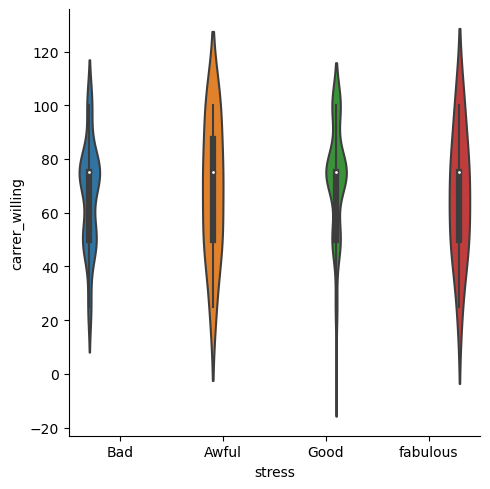

<Figure size 1500x800 with 0 Axes>

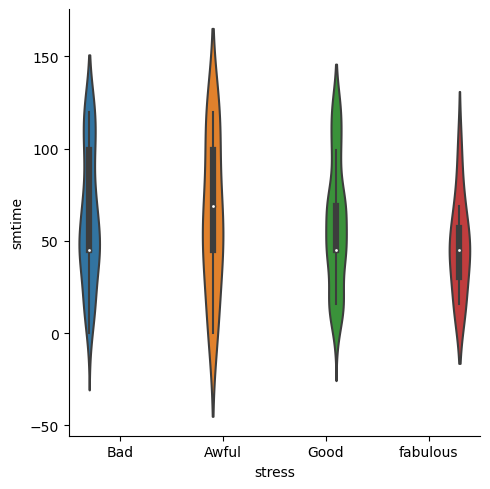

<Figure size 1500x800 with 0 Axes>

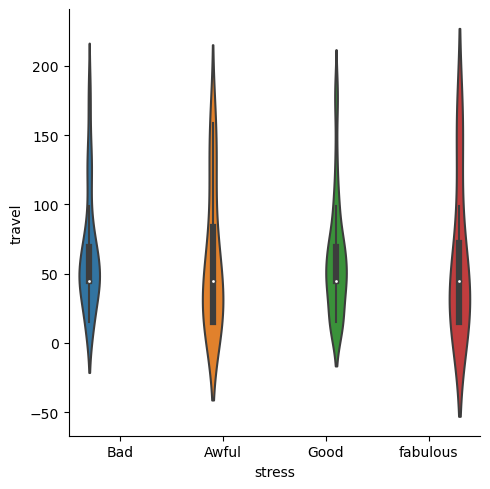

<Figure size 1500x800 with 0 Axes>

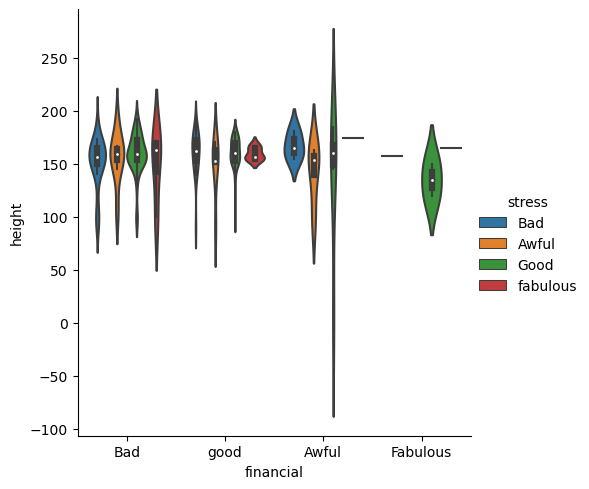

<Figure size 1500x800 with 0 Axes>

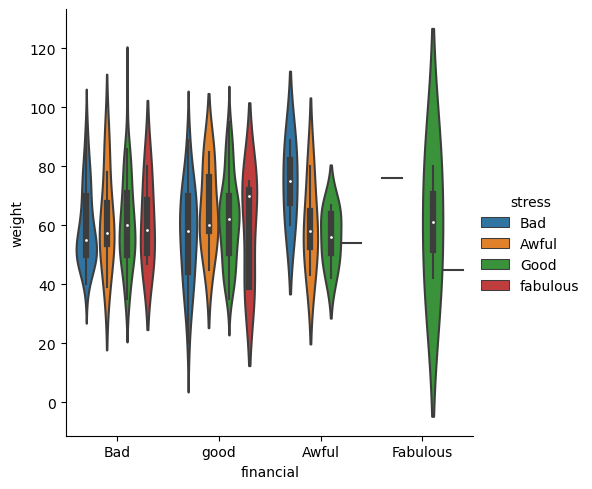

<Figure size 1500x800 with 0 Axes>

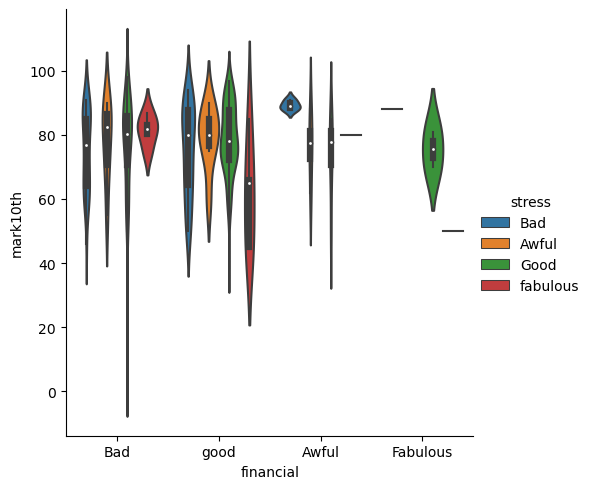

<Figure size 1500x800 with 0 Axes>

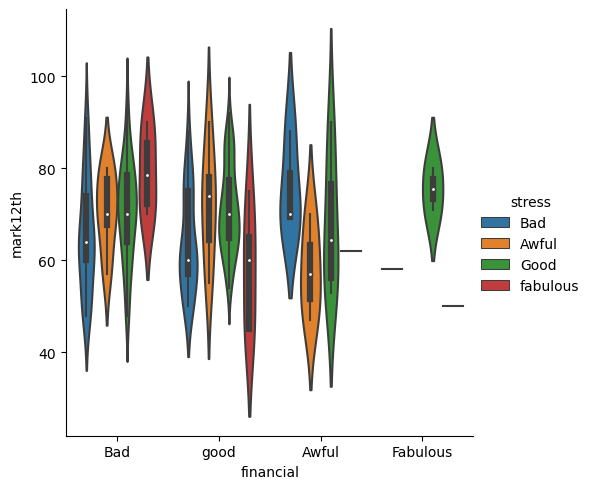

<Figure size 1500x800 with 0 Axes>

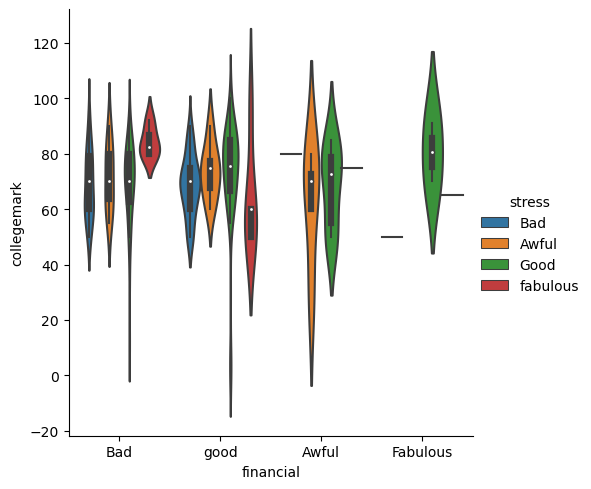

<Figure size 1500x800 with 0 Axes>

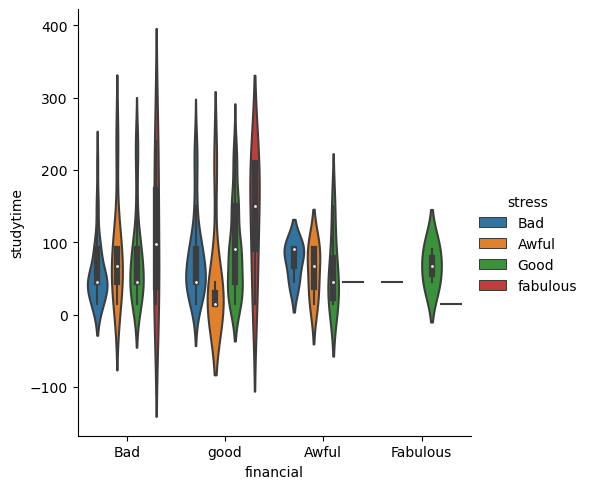

<Figure size 1500x800 with 0 Axes>

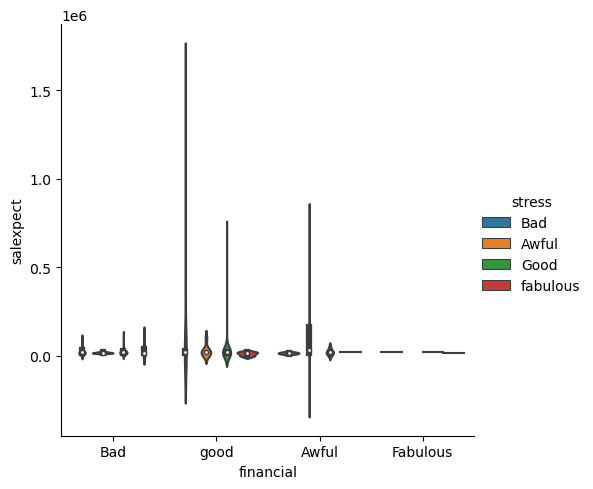

<Figure size 1500x800 with 0 Axes>

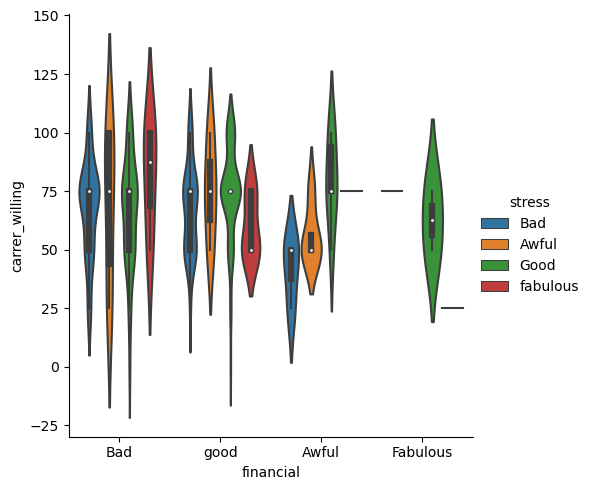

<Figure size 1500x800 with 0 Axes>

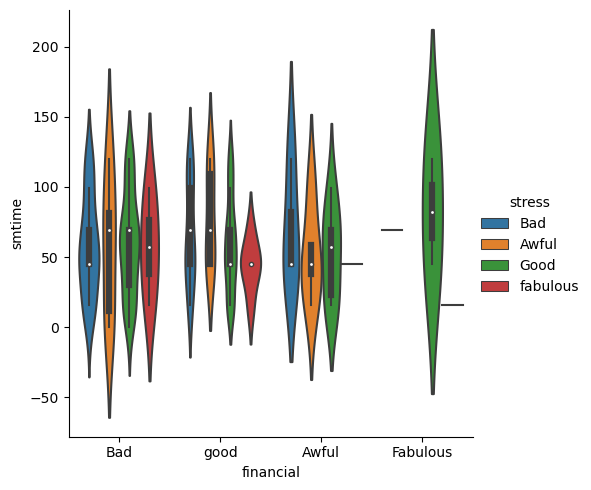

<Figure size 1500x800 with 0 Axes>

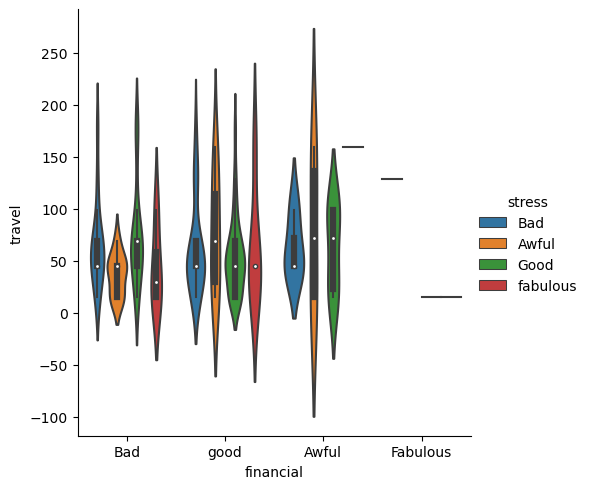

<Figure size 1500x800 with 0 Axes>

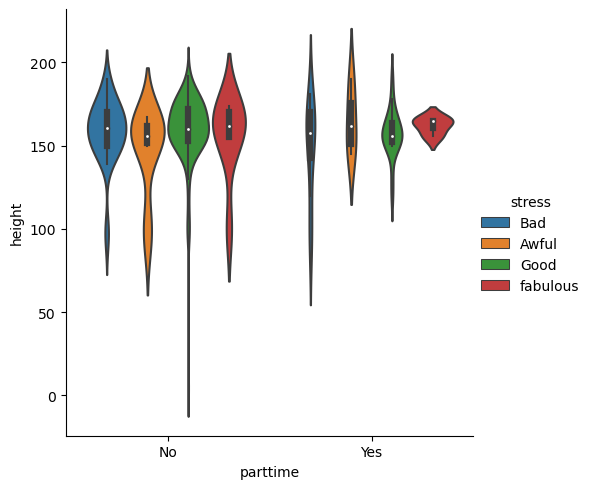

<Figure size 1500x800 with 0 Axes>

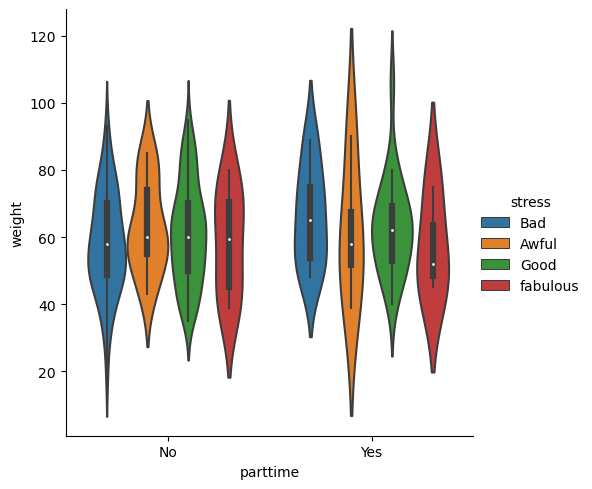

<Figure size 1500x800 with 0 Axes>

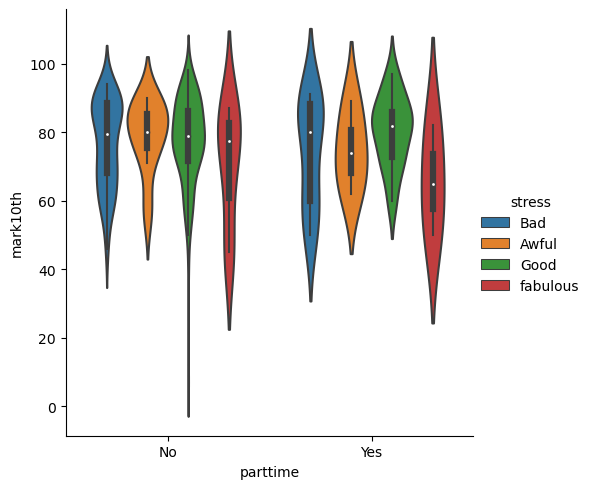

<Figure size 1500x800 with 0 Axes>

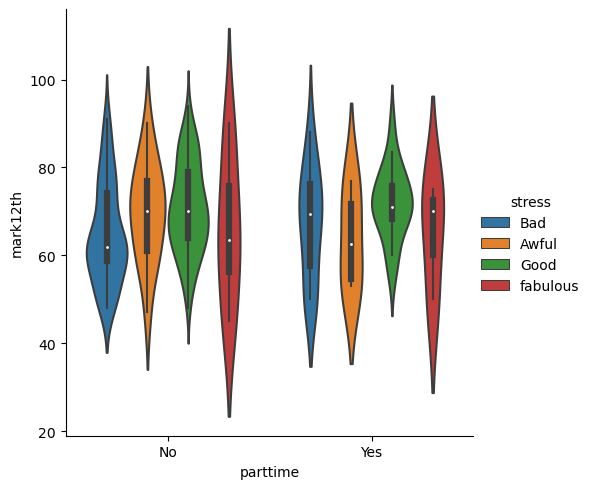

<Figure size 1500x800 with 0 Axes>

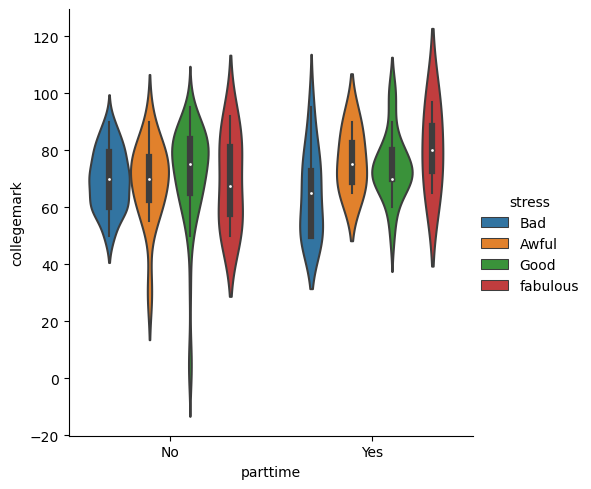

<Figure size 1500x800 with 0 Axes>

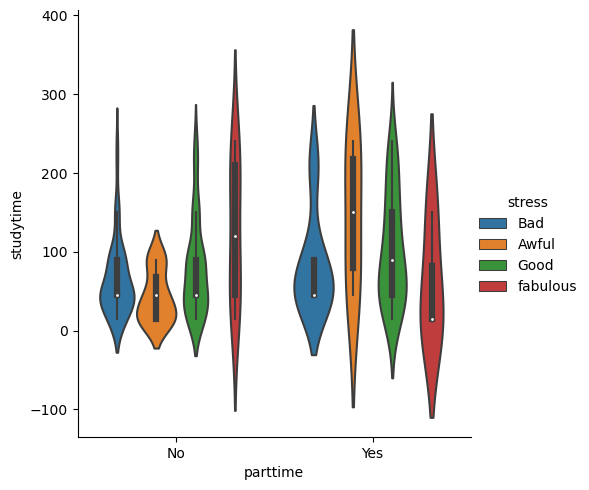

<Figure size 1500x800 with 0 Axes>

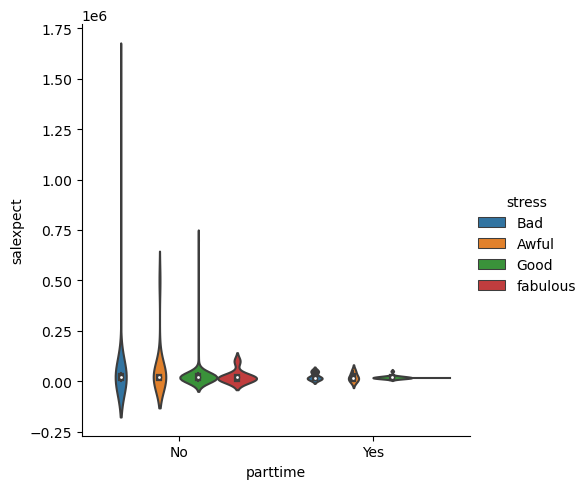

<Figure size 1500x800 with 0 Axes>

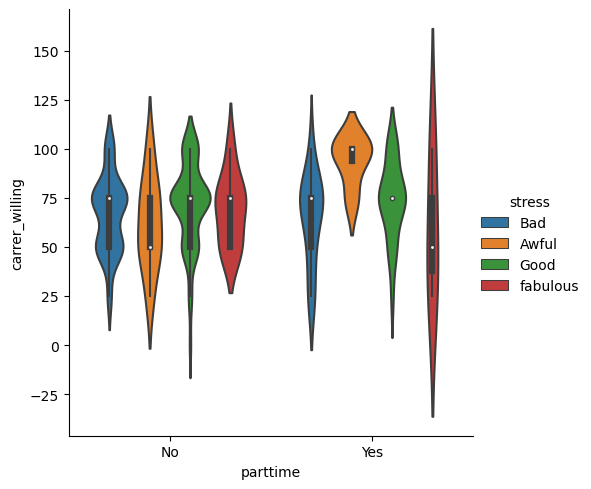

<Figure size 1500x800 with 0 Axes>

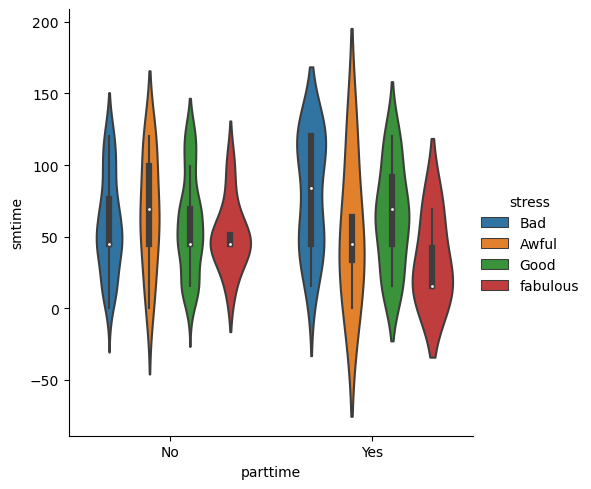

<Figure size 1500x800 with 0 Axes>

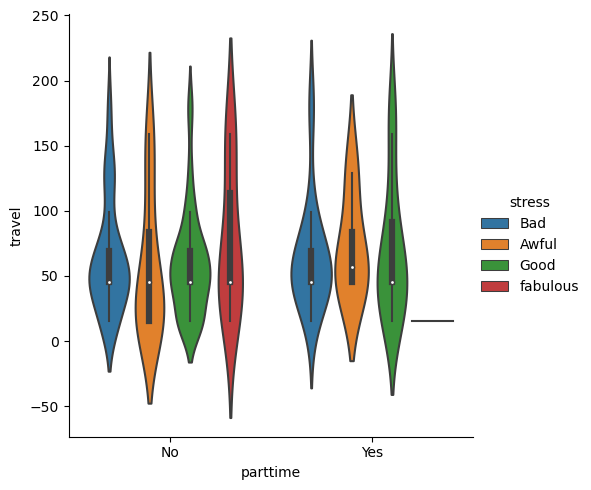

<Figure size 1500x800 with 0 Axes>

In [288]:
for column1 in object_columns:
    for column2 in numeric_columns:
        sns.catplot(data=df,x=column1,y=column2,kind='violin',hue='stress')
        plt.figure(figsize=(15,8))
plt.show()

C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\himan\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\h

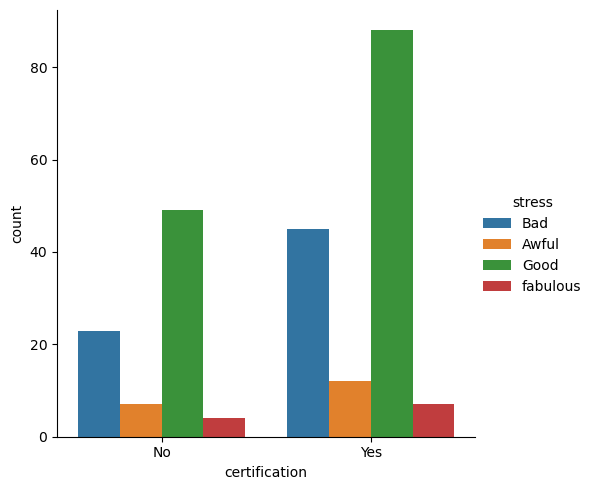

<Figure size 1500x800 with 0 Axes>

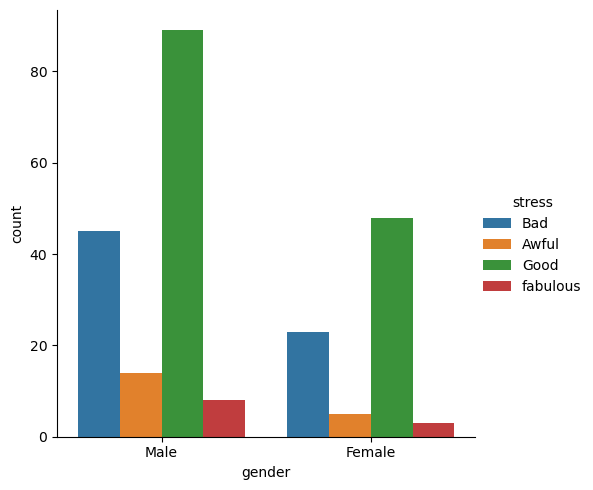

<Figure size 1500x800 with 0 Axes>

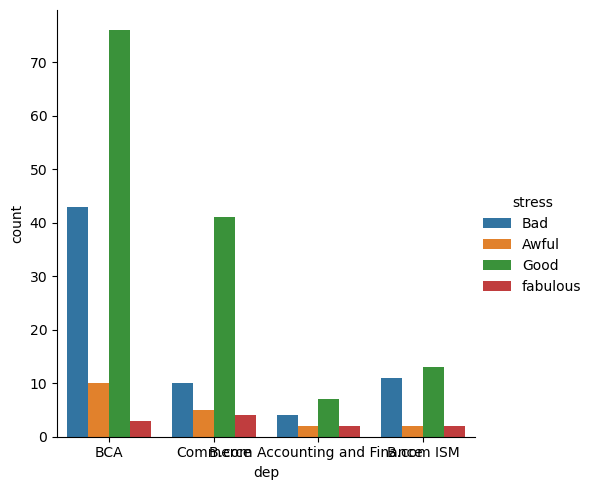

<Figure size 1500x800 with 0 Axes>

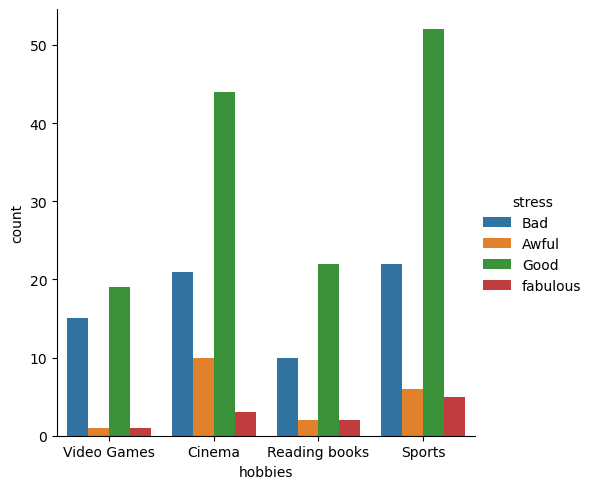

<Figure size 1500x800 with 0 Axes>

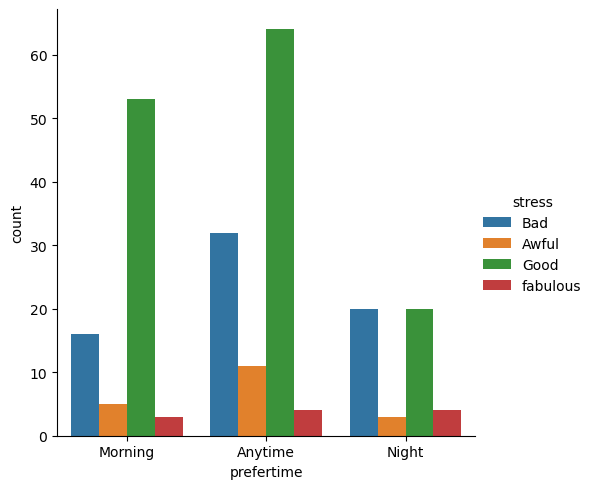

<Figure size 1500x800 with 0 Axes>

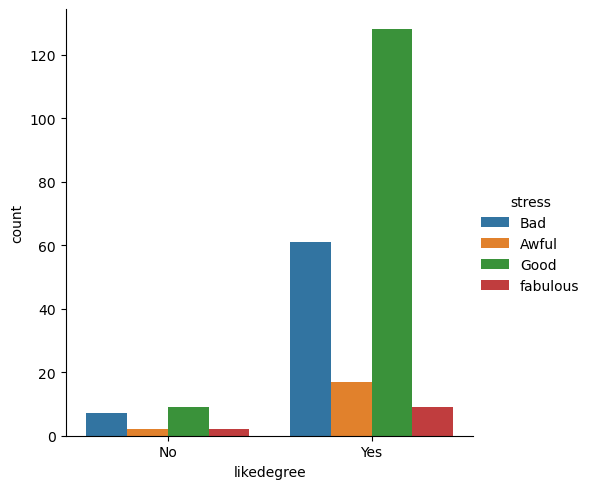

<Figure size 1500x800 with 0 Axes>

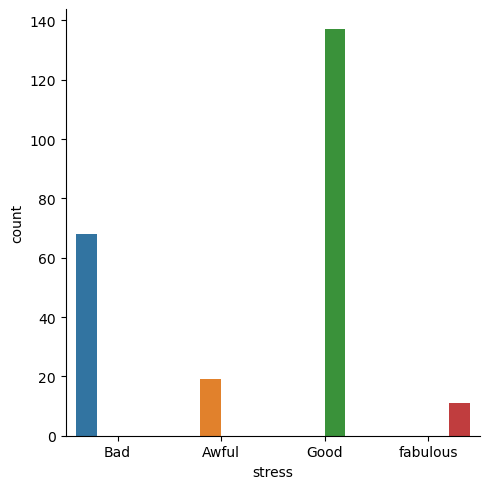

<Figure size 1500x800 with 0 Axes>

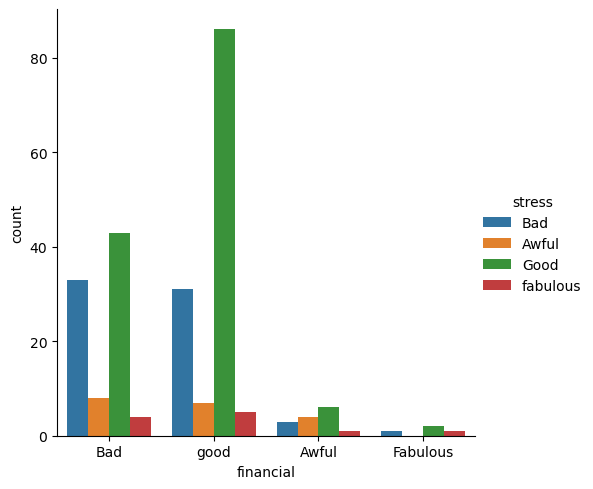

<Figure size 1500x800 with 0 Axes>

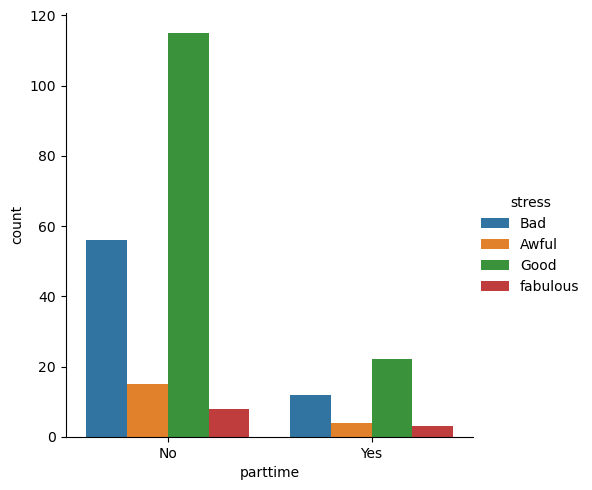

<Figure size 1500x800 with 0 Axes>

In [289]:
for column1 in object_columns:
    sns.catplot(data=df,x=column1,kind='count',hue='stress')
    plt.figure(figsize=(15,8))
plt.show()

In [290]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


C:\Users\himan\AppData\Local\Temp\ipykernel_15808\3544068584.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15,8))


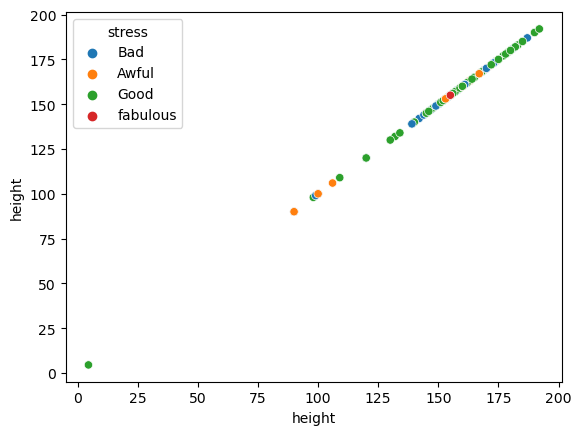

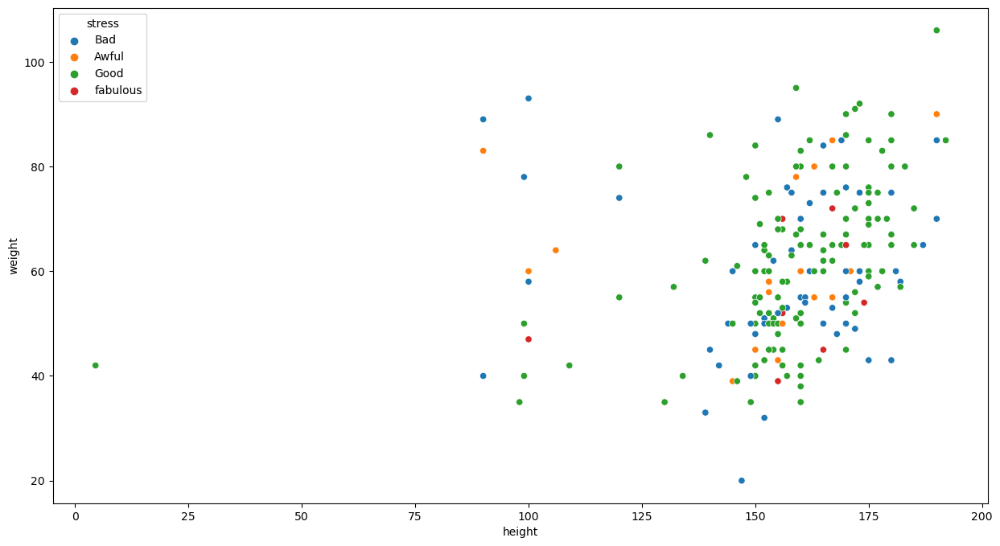

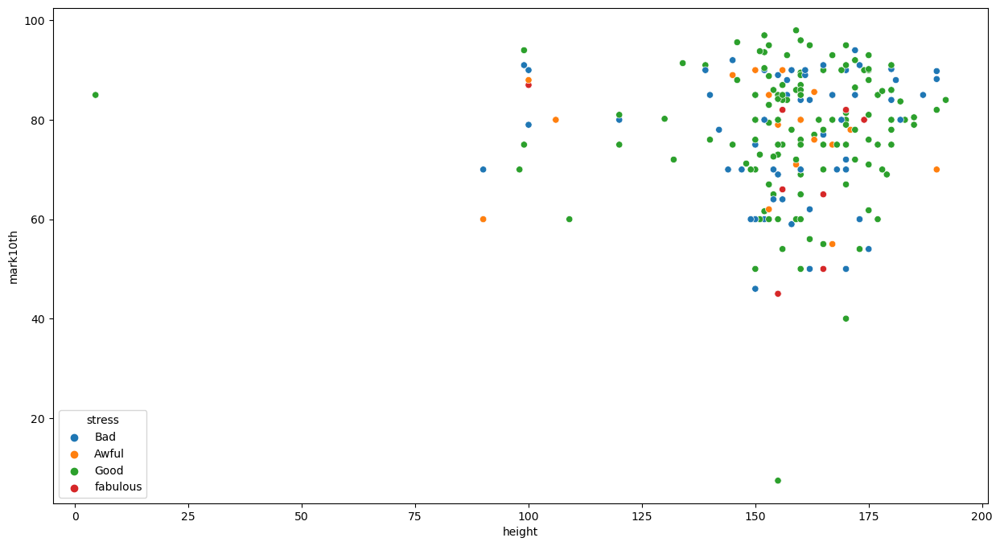

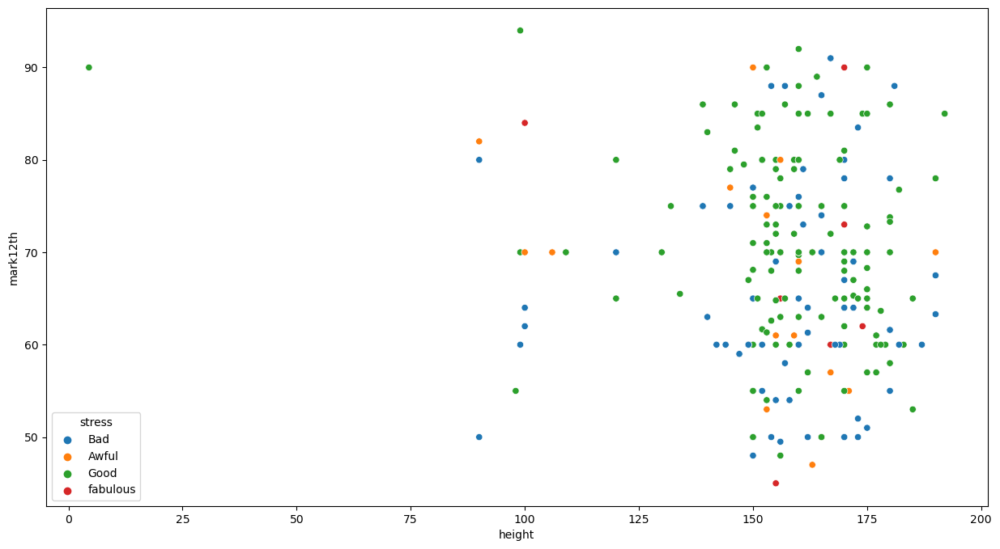

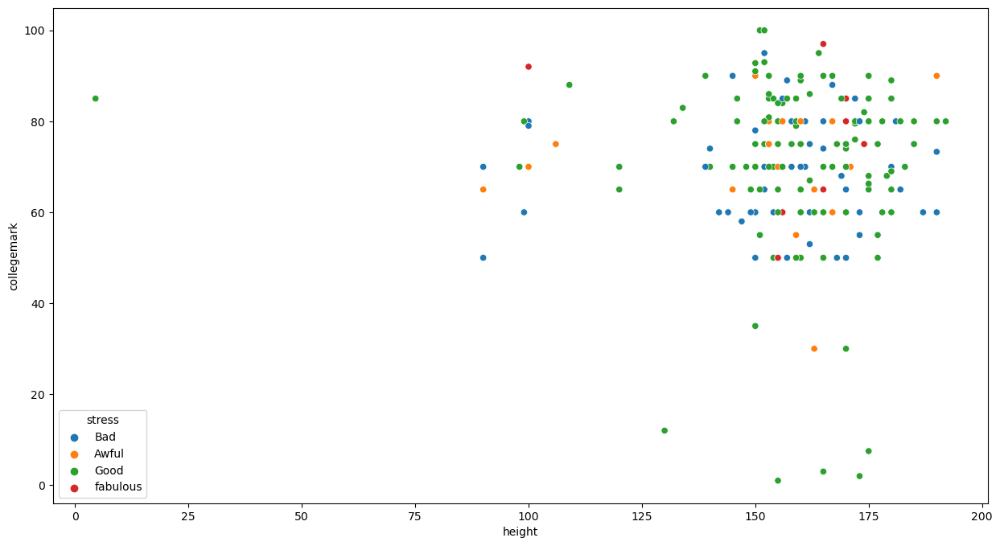

...

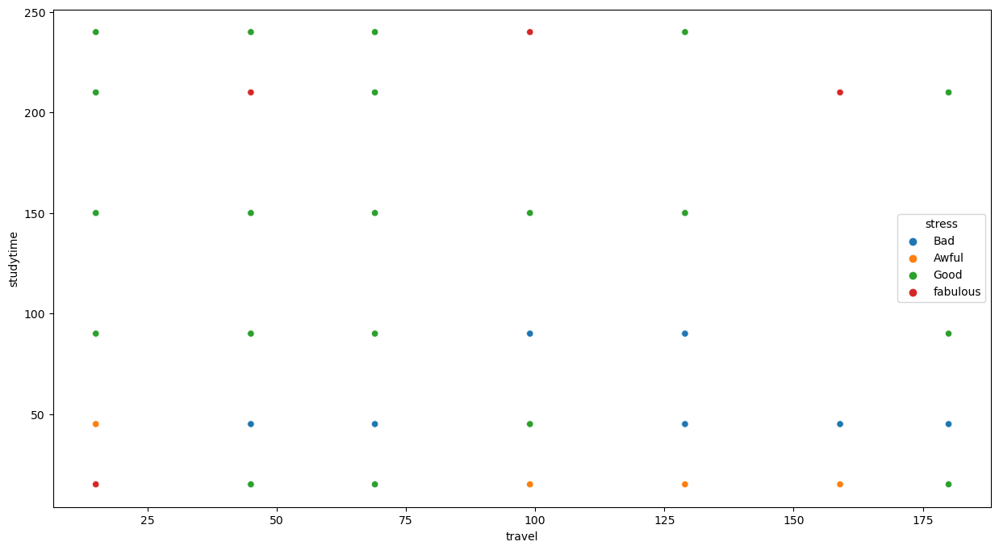

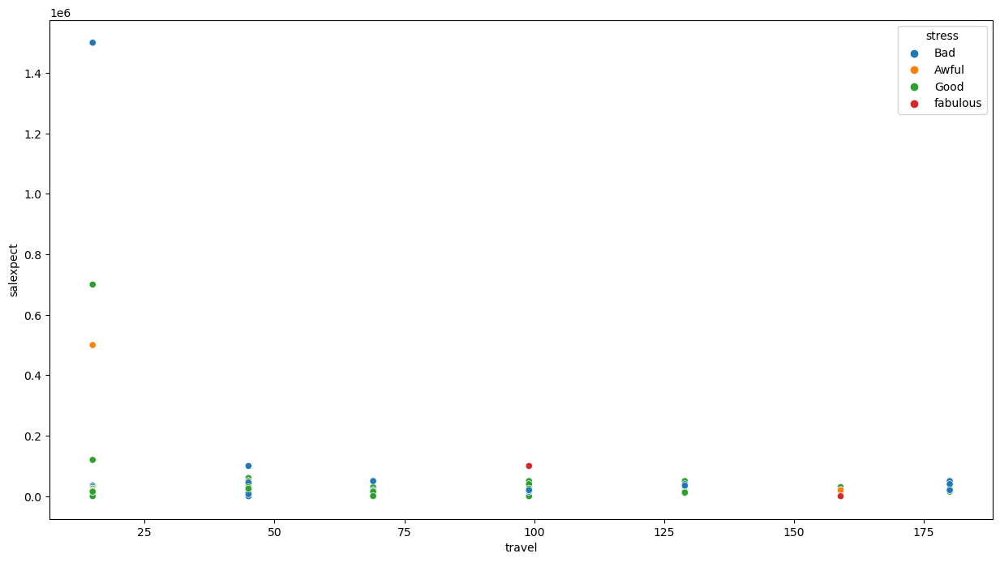

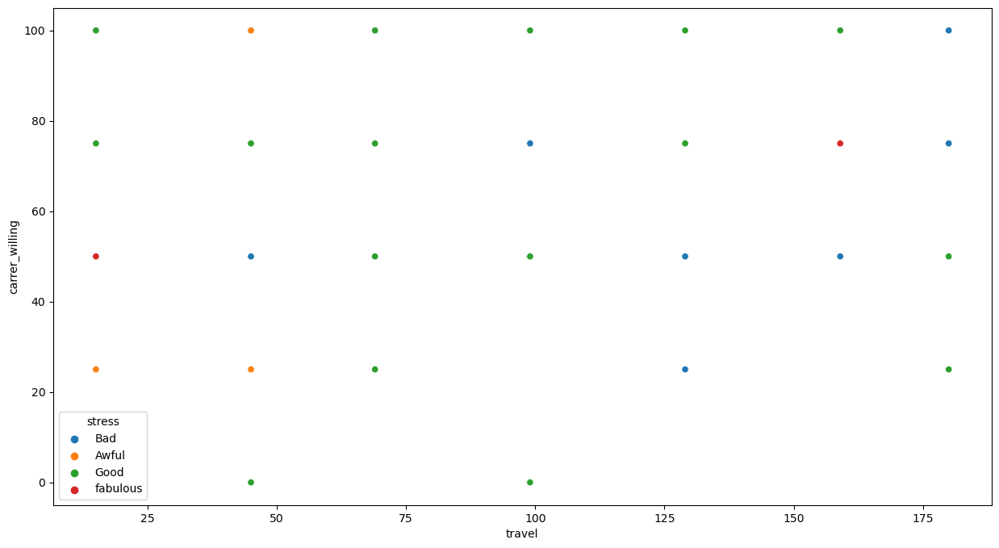

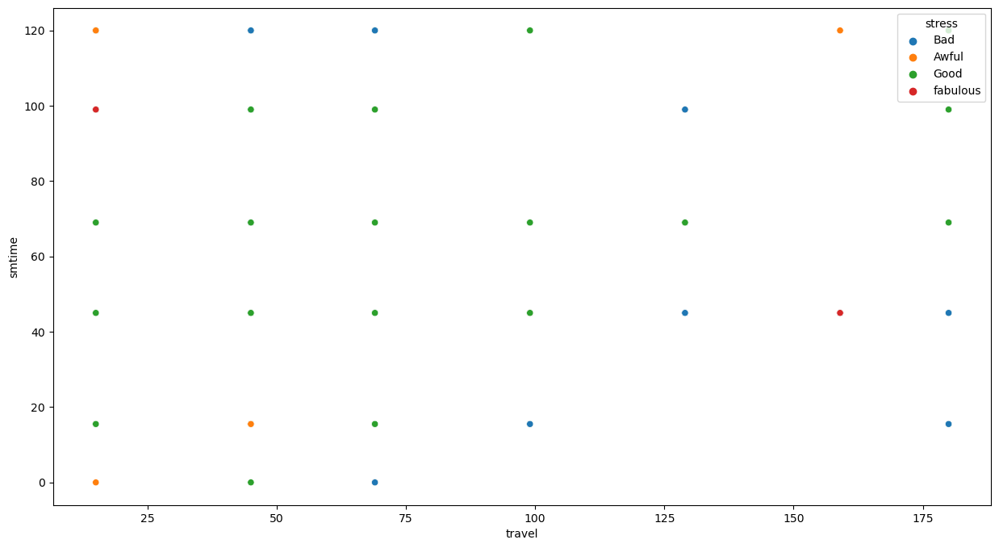

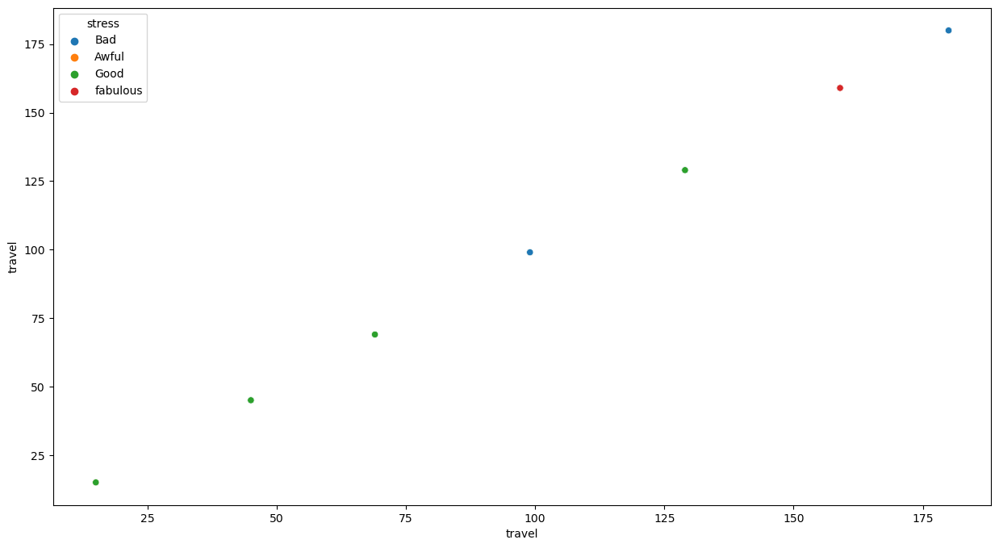

<Figure size 1500x800 with 0 Axes>

In [291]:
for column1 in numeric_columns:
    for column2 in numeric_columns:
        sns.scatterplot(x=df[column1],y=df[column2],hue=df['stress'])
        plt.figure(figsize=(15,8))
plt.show()

In [292]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
0,No,Male,BCA,100.0,58.0,79.0,64.0,80.0,Video Games,15.0,Morning,40000,No,50.0,99.0,45.0,Bad,Bad,No
1,No,Female,BCA,90.0,40.0,70.0,80.0,70.0,Cinema,45.0,Morning,15000,Yes,75.0,69.0,15.0,Bad,Bad,No
2,Yes,Male,BCA,159.0,78.0,71.0,61.0,55.0,Cinema,90.0,Anytime,13000,Yes,50.0,120.0,45.0,Awful,Bad,No
3,Yes,Female,BCA,147.0,20.0,70.0,59.0,58.0,Reading books,90.0,Anytime,1500000,No,50.0,99.0,15.0,Bad,good,No
4,No,Male,BCA,170.0,54.0,40.0,65.0,30.0,Video Games,45.0,Morning,50000,Yes,25.0,99.0,45.0,Good,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,Yes,Male,B.com ISM,170.0,76.0,72.0,67.0,65.0,Video Games,45.0,Morning,7000,Yes,50.0,120.0,45.0,Bad,Bad,No
231,Yes,Male,B.com ISM,172.0,52.0,72.0,70.0,76.0,Cinema,150.0,Anytime,25000,Yes,75.0,45.0,45.0,Good,good,No
232,Yes,Female,BCA,139.0,33.0,90.0,75.0,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,159.0,Bad,good,No
233,Yes,Female,Commerce,153.0,58.0,85.0,74.0,75.0,Cinema,15.0,Anytime,20000,Yes,75.0,120.0,159.0,Awful,good,No


In [293]:
df.describe()

,height,weight,mark10th,mark12th,collegemark,studytime,salexpect,carrer_willing,smtime,travel
count,235.000000,235.000000,235.000000,235.000000,235.000000,235.000000,2.350000e+02,235.000000,235.000000,235.000000
mean,157.402128,60.803830,76.848511,68.775872,70.660553,78.702128,3.248168e+04,69.574468,60.176596,61.468085
std,21.510805,14.895844,13.047560,11.018192,15.727446,61.156208,1.113146e+05,21.178671,35.040357,43.345093
min,4.500000,20.000000,7.400000,45.000000,1.000000,15.000000,0.000000e+00,0.000000,0.000000,15.000000
25%,152.000000,50.000000,70.000000,60.000000,60.000000,45.000000,1.500000e+04,50.000000,45.000000,45.000000
50%,160.000000,60.000000,80.000000,69.000000,70.000000,45.000000,2.000000e+04,75.000000,45.000000,45.000000
75%,170.000000,70.000000,86.250000,76.000000,80.000000,90.000000,2.500000e+04,75.000000,84.000000,69.000000
max,192.000000,106.000000,98.000000,94.000000,100.000000,240.000000,1.500000e+06,100.000000,120.000000,180.000000


In [294]:
# Apply outlier removal using IQR method to each numerical column
for col in numeric_columns:
    # Calculate Q1, Q3, and IQR for the current column
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    
    # Define the threshold
    threshold = 1.5
    
    # Define the lower and upper bounds for outliers
    lower_bound = Q1 - threshold * IQR
    upper_bound = Q3 + threshold * IQR
    
    # Identify outliers
    outliers = (df[col] < lower_bound) | (df[col] > upper_bound)
    
    # Remove outliers
    df = df[~outliers]

print("DataFrame after removing outliers:")
print(df)

DataFrame after removing outliers:
    certification  gender        dep  height  weight  mark10th  mark12th  \
5             Yes  Female        BCA   139.0    33.0      90.0     75.00   
7              No    Male        BCA   152.0    43.0      61.6     61.67   
8              No    Male        BCA   190.0    85.0      88.2     67.50   
9              No    Male        BCA   150.0    84.0      60.0     65.00   
12            Yes  Female        BCA   158.0    64.0      59.0     54.00   
..            ...     ...        ...     ...     ...       ...       ...   
225           Yes  Female   Commerce   164.0    43.0      80.0     89.00   
226           Yes  Female   Commerce   167.0    65.0      93.0     85.00   
228           Yes    Male  B.com ISM   155.0    68.0      75.0     75.00   
229            No  Female  B.com ISM   153.0    60.0      60.0     70.00   
231           Yes    Male  B.com ISM   172.0    52.0      72.0     70.00   

     collegemark        hobbies  studytime prefertim

In [295]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
5,Yes,Female,BCA,139.0,33.0,90.0,75.00,70.0,Cinema,45.0,Night,20000,Yes,50.0,45.0,15.0,Bad,good,No
7,No,Male,BCA,152.0,43.0,61.6,61.67,75.0,Sports,90.0,Morning,25000,Yes,50.0,69.0,69.0,Good,good,No
8,No,Male,BCA,190.0,85.0,88.2,67.50,60.0,Video Games,15.0,Morning,20000,Yes,75.0,99.0,69.0,Bad,Bad,No
9,No,Male,BCA,150.0,84.0,60.0,65.00,70.0,Video Games,15.0,Anytime,20000,Yes,75.0,45.0,45.0,Good,good,No
12,Yes,Female,BCA,158.0,64.0,59.0,54.00,80.0,Reading books,45.0,Morning,18000,Yes,75.0,15.5,45.0,Bad,good,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225,Yes,Female,Commerce,164.0,43.0,80.0,89.00,95.0,Reading books,150.0,Morning,15000,Yes,100.0,15.5,15.0,Good,good,No
226,Yes,Female,Commerce,167.0,65.0,93.0,85.00,90.0,Reading books,90.0,Night,15000,Yes,75.0,45.0,45.0,Good,good,No
228,Yes,Male,B.com ISM,155.0,68.0,75.0,75.00,65.0,Sports,90.0,Anytime,500,Yes,100.0,99.0,69.0,Good,good,No
229,No,Female,B.com ISM,153.0,60.0,60.0,70.00,70.0,Sports,90.0,Anytime,15000,Yes,75.0,69.0,15.0,Good,Bad,No


In [296]:
le=LabelEncoder()

In [297]:
for col in object_columns:
    df[col]=le.fit_transform(df[col])

In [298]:
df

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
5,1,0,2,139.0,33.0,90.0,75.00,70.0,0,45.0,2,20000,1,50.0,45.0,15.0,1,3,0
7,0,1,2,152.0,43.0,61.6,61.67,75.0,2,90.0,1,25000,1,50.0,69.0,69.0,2,3,0
8,0,1,2,190.0,85.0,88.2,67.50,60.0,3,15.0,1,20000,1,75.0,99.0,69.0,1,1,0
9,0,1,2,150.0,84.0,60.0,65.00,70.0,3,15.0,0,20000,1,75.0,45.0,45.0,2,3,0
12,1,0,2,158.0,64.0,59.0,54.00,80.0,1,45.0,1,18000,1,75.0,15.5,45.0,1,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225,1,0,3,164.0,43.0,80.0,89.00,95.0,1,150.0,1,15000,1,100.0,15.5,15.0,2,3,0
226,1,0,3,167.0,65.0,93.0,85.00,90.0,1,90.0,2,15000,1,75.0,45.0,45.0,2,3,0
228,1,1,1,155.0,68.0,75.0,75.00,65.0,2,90.0,0,500,1,100.0,99.0,69.0,2,3,0
229,0,0,1,153.0,60.0,60.0,70.00,70.0,2,90.0,0,15000,1,75.0,69.0,15.0,2,1,0


In [299]:
df.describe()

,certification,gender,dep,height,weight,mark10th,mark12th,collegemark,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,stress,financial,parttime
count,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000,125.000000
mean,0.632000,0.648000,2.048000,162.072000,60.184000,76.792800,68.335440,72.217360,1.368000,66.960000,0.728000,17653.232000,0.944000,69.200000,50.176000,48.312000,1.680000,2.144000,0.136000
std,0.484202,0.479516,0.749796,11.374261,13.482596,11.955928,10.712952,11.805979,1.089066,43.379867,0.786745,7014.780474,0.230847,19.607026,26.961685,25.631513,0.642575,1.067889,0.344168
min,0.000000,0.000000,0.000000,132.000000,32.000000,46.000000,48.000000,50.000000,0.000000,15.000000,0.000000,0.000000,0.000000,25.000000,15.500000,15.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,2.000000,153.000000,50.000000,69.000000,60.000000,60.000000,0.000000,45.000000,0.000000,15000.000000,1.000000,50.000000,15.500000,15.000000,1.000000,1.000000,0.000000
50%,1.000000,1.000000,2.000000,160.000000,60.000000,80.000000,68.000000,70.000000,2.000000,45.000000,1.000000,20000.000000,1.000000,75.000000,45.000000,45.000000,2.000000,3.000000,0.000000
75%,1.000000,1.000000,3.000000,170.000000,70.000000,86.000000,75.000000,80.000000,2.000000,90.000000,1.000000,20000.000000,1.000000,75.000000,69.000000,69.000000,2.000000,3.000000,0.000000
max,1.000000,1.000000,3.000000,190.000000,91.000000,95.600000,90.000000,100.000000,3.000000,150.000000,2.000000,40000.000000,1.000000,100.000000,99.000000,99.000000,3.000000,3.000000,1.000000


In [300]:
X=df.drop(['stress','mark10th','collegemark'],axis=1)

In [301]:
y=df['stress']

In [302]:
X

,certification,gender,dep,height,weight,mark12th,hobbies,studytime,prefertime,salexpect,likedegree,carrer_willing,smtime,travel,financial,parttime
5,1,0,2,139.0,33.0,75.00,0,45.0,2,20000,1,50.0,45.0,15.0,3,0
7,0,1,2,152.0,43.0,61.67,2,90.0,1,25000,1,50.0,69.0,69.0,3,0
8,0,1,2,190.0,85.0,67.50,3,15.0,1,20000,1,75.0,99.0,69.0,1,0
9,0,1,2,150.0,84.0,65.00,3,15.0,0,20000,1,75.0,45.0,45.0,3,0
12,1,0,2,158.0,64.0,54.00,1,45.0,1,18000,1,75.0,15.5,45.0,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225,1,0,3,164.0,43.0,89.00,1,150.0,1,15000,1,100.0,15.5,15.0,3,0
226,1,0,3,167.0,65.0,85.00,1,90.0,2,15000,1,75.0,45.0,45.0,3,0
228,1,1,1,155.0,68.0,75.00,2,90.0,0,500,1,100.0,99.0,69.0,3,0
229,0,0,1,153.0,60.0,70.00,2,90.0,0,15000,1,75.0,69.0,15.0,1,0


In [303]:
y

5      1
7      2
8      1
9      2
12     1
      ..
225    2
226    2
228    2
229    2
231    2
Name: stress, Length: 125, dtype: int32

In [304]:
rfr=RandomForestClassifier()


In [305]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [306]:
X_train.shape

(100, 16)

In [307]:
X_test.shape

(25, 16)

In [308]:
# Define hyperparameters and their values to be tuned
param_grid = {
    'n_estimators': [100, 200, 300],      # Number of trees in the forest
    'max_depth': [None, 10, 20, 30],       # Maximum depth of the trees
    'min_samples_split': [2, 5, 10],       # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4],         # Minimum number of samples required to be at a leaf node
    'bootstrap': [True, False]             # Whether bootstrap samples are used when building trees
}

# Initialize GridSearchCV with the Random Forest classifier and parameter grid
grid_search = GridSearchCV(estimator=rfr, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Perform grid search to find the best hyperparameters
grid_search.fit(X_train, y_train)

# Print the best hyperparameters found
print("Best Hyperparameters:", grid_search.best_params_)

# Evaluate the best model on the test set
best_model = grid_search.best_estimator_
test_score = best_model.score(X_test, y_test)
print("Test Score:", test_score)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Hyperparameters: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 100}
Test Score: 0.6
